In [1]:
import bioh2m as h2m
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import re
import requests
import time
from adjustText import adjust_text
import matplotlib.patheffects as PathEffects
import seaborn as sns
plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.sans-serif'] = ['Arial']

/Users/kexindong/Documents/GitHub/h2m-public/.conda/lib/python3.10/site-packages/Bio/pairwise2.py:278: BiopythonDeprecationWarning: Bio.pairwise2 has been deprecated, and we intend to remove it in a future release of Biopython. As an alternative, please consider using Bio.Align.PairwiseAligner as a replacement, and contact the Biopython developers if you still need the Bio.pairwise2 module.
  warnings.warn(


In [348]:
df_binded = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/h2m_database/database-output-final/df_result_cleaned_v3.csv')

In [470]:
df_binded[df_binded['expanded']==True]

,gene_name_h,gene_id_h,tx_id_h,chr_h,exon_num_h,strand_h,match,start_h,end_h,ref_seq_h,...,ID_human,ID_mouse,Database,ID_db,pe_human,pe_mouse,be_human,be_mouse,expanded,flank_size
24268,ABL1,ENSG00000097007.13,ENST00000318560.5,chr9,11,+,True,133759490,133759492,AAG,...,AACR-H0003120,AACR-H0003120-M01-V01,AACR,NaN,True,True,False,False,True,13
24333,ABL1,ENSG00000097007.13,ENST00000318560.5,chr9,11,+,True,133760024,133760024,C,...,AACR-H0002060,AACR-H0002060-M01-V01,AACR,NaN,True,True,False,False,True,12
24334,ABL1,ENSG00000097007.13,ENST00000318560.5,chr9,11,+,True,133759623,133759623,C,...,AACR-H0003013,AACR-H0003013-M01-V01,AACR,NaN,True,True,False,False,True,0
24377,ABL1,ENSG00000097007.13,ENST00000318560.5,chr9,11,+,True,133711046,133711050,CTCTT,...,AACR-H0000129,NaN,AACR,NaN,True,False,False,False,True,0
26837,ABL1,ENSG00000097007.13,ENST00000318560.5,chr9,11,+,True,133760617,133760617,C,...,AACR-H0001054,AACR-H0001054-M01-V01,AACR,NaN,True,True,True,False,True,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3907806,ZRSR2,ENSG00000169249.8,ENST00000307771.7,chrX,11,+,True,15841230,15841231,-,...,AACR-H0001583,NaN,AACR,NaN,True,False,False,False,True,0
3908422,ZRSR2,ENSG00000169249.8,ENST00000307771.7,chrX,11,+,True,15838411,15838411,C,...,AACR-H0003086,AACR-H0003086-M01-V01,AACR,NaN,True,True,True,False,True,29
3908751,ZRSR2,ENSG00000169249.8,ENST00000307771.7,chrX,11,+,True,15836648,15836648,T,...,AACR-H0000226,AACR-H0000226-M01-V01,AACR,NaN,True,True,False,False,True,2
3909626,ZSWIM4,ENSG00000132003.5,ENST00000254323.2,chr19,13,+,True,13934296,13934296,A,...,AACR-H0001758,AACR-H0001758-M01-V01,AACR,NaN,True,True,True,True,True,36


In [473]:
len(df_binded['ID_human'].value_counts())

3384385

In [472]:
len(df_binded[df_binded['status']==True]['ID_mouse'].value_counts())

3171709

In [9]:
df_be = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/h2m_database/BEGG/be_result_all.csv')
df_pe = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/h2m_database/PEGG/pe_result_all.csv')

In [10]:
len(df_be)

25488

In [11]:
len(df_pe)

49420

# H2M Database  
## Initial input count  

In [20]:
n_aacr, n_cosmic, n_clinvar = 851088, 1771601, 2353138

In [24]:
sum([n_aacr, n_cosmic, n_clinvar])

4975827

## Gene mapped proportion  

In [63]:
17428+793

18221

In [99]:
793/18221

0.043521211788595575

In [98]:
521/18221

0.02859338126337742

In [102]:
17430-521

16909

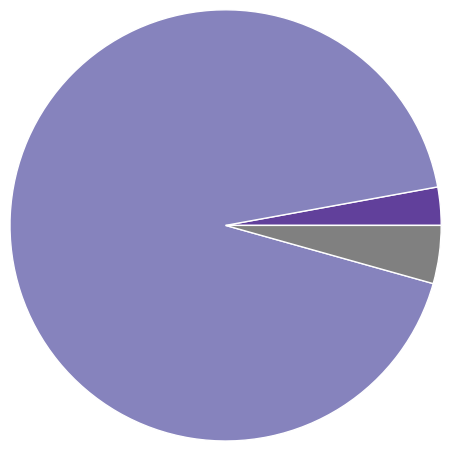

In [101]:
fig, ax = plt.subplots(figsize=(5,5), nrows = 1, ncols = 1)
ax.axis('equal')
mypie2, _ = ax.pie([521,17430-521,793], radius=1.4, colors=[plt.cm.Purples(0.8),plt.cm.Purples(0.6),'grey'], startangle=0)
plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/database/pie_plot_for_gene_all_binded.svg', bbox_inches='tight')
plt.setp(mypie2, edgecolor='white')
plt.show()

In [39]:
import pickle
with open('/Users/kexindong/Documents/GitHub/Output/h2m_database/gene_mapped.pkl', 'rb') as file:
    set_gene_mapped = pickle.load(file)

In [82]:
df_for_dict = df_binded[df_binded['gene_name_h'].isin(set_gene_mapped)]

In [83]:
dict_of_h = dict(zip(df_for_dict['gene_name_m'], df_for_dict['gene_name_h']))
del df_for_dict

In [84]:
dict_of_h

{'A1bg': 'A1BG',
 'A1cf': 'A1CF',
 'A2m': 'A2M',
 'A3galt2': 'A3GALT2',
 'A4galt': 'A4GALT',
 'A4gnt': 'A4GNT',
 'Aaas': 'AAAS',
 'Aacs': 'AACS',
 'Aadac': 'AADAC',
 'Aadacl2': 'AADACL2',
 'Aadacl3': 'AADACL3',
 'AAdacl4fm3': 'AADACL4',
 'Aadacl4': 'AADACL4',
 'Aadacl4fm1': 'AADACL4',
 'Aadacl4fm2': 'AADACL4',
 'Aadacl4fm4': 'AADACL4',
 'Aadacl4fm5': 'AADACL4',
 'Aadat': 'AADAT',
 'Aagab': 'AAGAB',
 'Aak1': 'AAK1',
 'Aamdc': 'AAMDC',
 'Aamp': 'AAMP',
 'Aanat': 'AANAT',
 'Aar2': 'AAR2',
 'Aard': 'AARD',
 'Aarsd1': 'AARSD1',
 'Aasdh': 'AASDH',
 'Aasdhppt': 'AASDHPPT',
 'Aass': 'AASS',
 'Aatf': 'AATF',
 'Aatk': 'AATK',
 'Abat': 'ABAT',
 'Abca1': 'ABCA1',
 'Abca12': 'ABCA12',
 'Abca13': 'ABCA13',
 'Abca2': 'ABCA2',
 'Abca3': 'ABCA3',
 'Abca4': 'ABCA4',
 'Abca5': 'ABCA5',
 'Abca6': 'ABCA6',
 'Abca7': 'ABCA7',
 'Abca8a': 'ABCA8',
 'Abca8b': 'ABCA8',
 'Abca9': 'ABCA9',
 'Abcb1a': 'ABCB1',
 'Abcb1b': 'ABCB1',
 'Abcb10': 'ABCB10',
 'Abcb11': 'ABCB11',
 'Abcb4': 'ABCB4',
 'Abcb5': 'ABCB5',
 'Abc

In [85]:
value_counts = {}
for value in dict_of_h.values():
    if value in value_counts:
        value_counts[value] += 1
    else:
        value_counts[value] = 1

repeated_values = [value for value, count in value_counts.items() if count > 1]

print("重复出现的值:", repeated_values)

重复出现的值: ['AADACL4', 'ABCA8', 'ABCB1', 'ABCG2', 'ACAA1', 'ACAD10', 'ACAT2', 'ACOT2', 'ACOT9', 'ADAM20', 'ADRM1', 'AGTR1', 'AHCY', 'AKR1B15', 'AKR1C4', 'ALDH1A1', 'ALDH3B2', 'ALPP', 'ALYREF', 'ZNF93', 'AMD1', 'AMY2B', 'ANAPC15', 'ANG', 'ANKRD62', 'POTEM', 'AOC1', 'APH1B', 'APOC2', 'APOL4', 'ATG4A', 'BCL2A1', 'BEX2', 'BEX4', 'BGLAP', 'BHMT', 'BMP8B', 'BPIFA1', 'BRCC3', 'BTF3L4', 'C1R', 'C1S', 'C2orf78', 'C4BPA', 'HAVCR1', 'CALCB', 'CALML5', 'CAPZA1', 'CATSPERG', 'CBR1', 'CCDC121', 'KRTAP13-4', 'CCDC7', 'CCL2', 'CCL23', 'CCL19', 'CYP2J2', 'RPL29', 'CCL21', 'CCL27', 'CCR1', 'CD1D', 'CD200R1L', 'LGALSL', 'CLEC4M', 'CD300C', 'CD300LD', 'CD55', 'CD59', 'CDC34', 'CDC5L', 'SSX7', 'CDK2AP1', 'PSG9', 'CEACAM21', 'PSG5', 'CELA3B', 'CES1', 'CES2', 'CES3', 'CFH', 'CHIA', 'SP110', 'CISD3', 'CLCA4', 'CLCNKB', 'CLDN4', 'CLEC10A', 'CLEC2D', 'ZNF705A', 'MTCP1', 'CMTM2', 'CNTNAP5', 'PZP', 'CRYGD', 'CS', 'CSF2RB', 'CSTA', 'CWC22', 'KRTAP20-1', 'CXCL3', 'FAM90A26', 'CYP11B2', 'CYP2A7', 'CYP2B6', 'CYP2C9', 'L

In [90]:
df = pd.DataFrame(repeated_values)

In [86]:
len(repeated_values)

521

In [94]:
target_value = 'SLC5A4'
[key for key, value in dict_of_h.items() if value == target_value]

['Slc5a4a', 'Slc5a4b']

In [93]:
target_value = 'SLC6A20'
[key for key, value in dict_of_h.items() if value == target_value]

['Slc6a20a', 'Slc6a20b']

## Flank size histgram

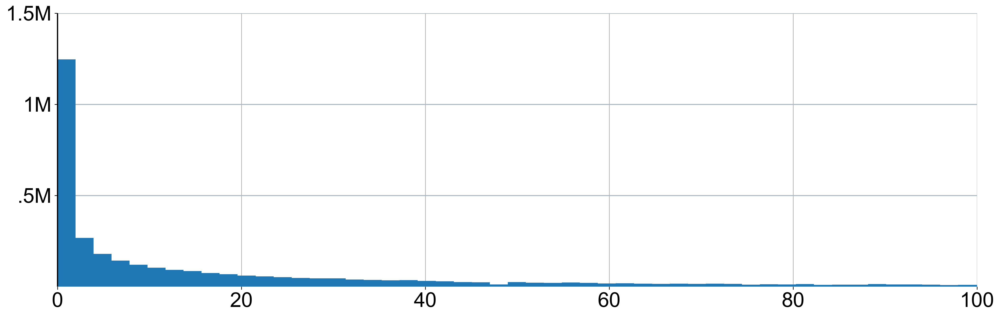

In [303]:
df_binded['flank_size_left'] = df_binded['flank_size_left'].fillna('0aa')
df_binded['flank_size_right'] = df_binded['flank_size_right'].fillna('0aa')
df_binded['flank_size'] = [int(x[:-2])+int(y[:-2]) for x,y in zip(df_binded['flank_size_left'], df_binded['flank_size_right'])]

fig, ax = plt.subplots(figsize=(20,6), dpi = 300)
# Assuming df_binded is your DataFrame
df_binded['flank_size'].hist(bins=1000)
# Set the x-axis limit to show only 0 to 750
plt.xlim(0, 100)
ax.set_ylim((0,1))
ax.yaxis.set_ticks([x*10000 for x in [50,100,150]])
ax.yaxis.set_ticklabels(['.5M', '1M', '1.5M'], size=25, fontfamily="Arial", fontweight=100)
ax.xaxis.set_ticks([0,20,40,60,80,100])
ax.xaxis.set_ticklabels([0,20,40,60,80,100], size=25, fontfamily="Arial", fontweight=100)
# ax.yaxis.set_tick_params(labelbottom=False, labeltop=True, length=0)
ax.set_axisbelow(True)
ax.grid(axis = "y", color="#A8BAC4", lw=1.2)
ax.spines["right"].set_visible(False)
ax.spines["top"].set_visible(False)
ax.spines["bottom"].set_visible(False)
ax.spines["left"].set_lw(1.5)
ax.spines["left"].set_capstyle("butt")
plt.yticks(fontsize = 25)
# Display the plot
plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/database/hist_flank_size.svg', bbox_inches='tight')
plt.show()

In [304]:
len(df_binded[df_binded['flank_size']>=0])

3910910

In [305]:
len(df_binded[df_binded['flank_size']>20])

1500277

In [306]:
1500277/3910910

0.3836132767054215

## Main Figue statistics  

### Pie  

In [307]:
name_list = ['AACR','COSMIC','CLINVAR']
list_of_n = []
list_of_fs = []
list_of_input = []
list_of_output = []
list_of_class_0 = []
list_of_class_1 = []
list_of_class_2 = []
list_of_class_3 = []

for x in [0,1,2]:
    name = name_list[x]
    df = df_binded[df_binded['Database']==name].reset_index(drop=True)
    l_1 = len(df['ID_human'].unique())
    for fs in [0]:
        df = df[df['flank_size'] >= fs] 
        list_of_n.append(name)
        list_of_fs.append(fs)
        df_sub = df[df['status']==True]
        l_2 = len(df_sub['ID_human'].unique())
        print(f'{name} with {fs}: {l_2} out of {l_1} ({l_2/l_1* 100:.2f}%) mutations can be modeled.\n')
        list_of_output.append(l_2)
        list_of_input.append(l_1)
        list_of_class_0.append(len(df[df['class']==0]['ID_human'].unique()))
        list_of_class_1.append(len(df[df['class']==1]['ID_human'].unique()))
        list_of_class_2.append(len(df[df['class']==2]['ID_human'].unique()))
        list_of_class_3.append(len(df[df['class']==3]['ID_human'].unique()))

AACR with 0: 703261 out of 818409 (85.93%) mutations can be modeled.

COSMIC with 0: 436656 out of 527503 (82.78%) mutations can be modeled.

CLINVAR with 0: 1643037 out of 2038473 (80.60%) mutations can be modeled.



In [308]:
df = pd.DataFrame(zip(list_of_n, list_of_fs,
list_of_input,
list_of_output,
list_of_class_0,
list_of_class_1,
list_of_class_2,
list_of_class_3))
df.columns = ['Database','Flank_Size','Num_Input','Num_Output','Class_0','Class_1','Class_2','Class_3']

In [309]:
df

,Database,Flank_Size,Num_Input,Num_Output,Class_0,Class_1,Class_2,Class_3
0,AACR,0,818409,703261,569932,36846,97163,0
1,COSMIC,0,527503,436656,326165,21350,89546,0
2,CLINVAR,0,2038473,1643037,1278140,82406,284263,0


In [125]:
df.to_csv('/Users/kexindong/Documents/GitHub/Output/h2m_database/database-output-final/fs_stat.csv',index=False)

In [310]:
df_main = df

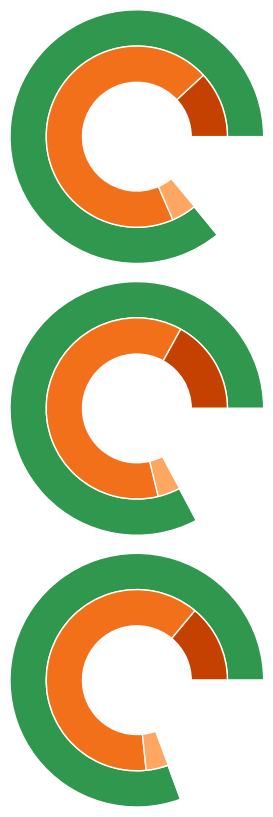

In [311]:
fig, ax = plt.subplots(figsize=(3,10), nrows = 3, ncols = 1)
for i, x in df_main.iterrows():
    name = x[0]
    fs, input, output, n_0,n_1,n_2,n_3 = [int(t) for t in x[1:]] #x[1:]
    ax[i].axis('equal')
    mypie2, _ = ax[i].pie([output+n_3, input-output-n_3], radius=1.4, colors=[plt.cm.Greens(0.7),'white'], startangle=0)
    plt.setp(mypie2, width=0.4, edgecolor='white')

    mypie3, _ = ax[i].pie([n_2,n_0,n_1,n_3,input-(n_0+n_1+n_2+n_3)], radius=1, colors=[plt.cm.Oranges(0.8), plt.cm.Oranges(0.6),plt.cm.Oranges(0.4),'grey','white'], startangle=0)
    plt.setp(mypie3, width=0.4, edgecolor='white')
    ax[i].margins(0,0)

plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/database/pie_plot_fs_0.svg', bbox_inches='tight')
plt.show()

In [312]:
df_main['percet_modelable'] = df_main['Num_Output']/df_main['Num_Input']
df_main['percet_non_extension'] = df_main['Class_3']/df_main['Num_Input']
df_main.to_csv('/Users/kexindong/Documents/GitHub/Output/h2m_database/database-output-final/fs_stat.csv', index = False)
df_main

,Database,Flank_Size,Num_Input,Num_Output,Class_0,Class_1,Class_2,Class_3,percet_modelable,percet_non_extension
0,AACR,0,818409,703261,569932,36846,97163,0,0.859303,0.0
1,COSMIC,0,527503,436656,326165,21350,89546,0,0.827779,0.0
2,CLINVAR,0,2038473,1643037,1278140,82406,284263,0,0.806014,0.0


#### Types  

In [313]:
fs = 0
list_of_n = []
list_of_fs = []
list_of_input = []
list_of_output = []
list_of_class_0 = []
list_of_class_1 = []
list_of_class_2 = []
list_of_class_3 = []
list_of_region = []
for x in [0,1,2]:
    name = name_list[x]
    df = df_binded[df_binded['Database']==name].reset_index(drop=True)
    for i,type_list in enumerate([['SNP','DNP','ONP','TNP'],['INS'],['DEL']]):
        list_of_region.append(['Substitution','Insertion','Deletion'][i])
        list_of_n.append(name)
        list_of_fs.append(fs)
        df_sub = df[[x in type_list for x in df['type_h']]].reset_index(drop=True)
        l_1 = len(df_sub['ID_human'].unique())
        df_sub_2 = df_sub[df_sub['status']==True]
        l_2 = len(df_sub_2['ID_human'].unique())
        print(f'{name} in {list_of_region[i]}: {l_2} out of {l_1} ({l_2/l_1* 100:.2f}%) mutations can be modeled.\n')
        list_of_output.append(l_2)
        list_of_input.append(l_1)
        list_of_class_0.append(len(df_sub[df_sub['class']==0]['ID_human'].unique()))
        list_of_class_1.append(len(df_sub[df_sub['class']==1]['ID_human'].unique()))
        list_of_class_2.append(len(df_sub[df_sub['class']==2]['ID_human'].unique()))
        list_of_class_3.append(len(df_sub[df_sub['class']==3]['ID_human'].unique()))

AACR in Substitution: 630828 out of 723322 (87.21%) mutations can be modeled.

AACR in Insertion: 23034 out of 27960 (82.38%) mutations can be modeled.

AACR in Deletion: 49399 out of 67127 (73.59%) mutations can be modeled.

COSMIC in Substitution: 435394 out of 525827 (82.80%) mutations can be modeled.

COSMIC in Insertion: 364 out of 469 (77.61%) mutations can be modeled.

COSMIC in Deletion: 898 out of 1207 (74.40%) mutations can be modeled.

CLINVAR in Substitution: 1535671 out of 1875913 (81.86%) mutations can be modeled.

CLINVAR in Insertion: 35073 out of 54457 (64.40%) mutations can be modeled.

CLINVAR in Deletion: 72293 out of 108103 (66.87%) mutations can be modeled.



In [314]:
df = pd.DataFrame(zip(list_of_n, list_of_fs,list_of_region,
list_of_input,
list_of_output,
list_of_class_0,
list_of_class_1,
list_of_class_2,
list_of_class_3))
df.columns = ['Database','Flank_Size','Mutation_Type','Num_Input','Num_Output','Class_0','Class_1','Class_2','Class_3']
df

,Database,Flank_Size,Mutation_Type,Num_Input,Num_Output,Class_0,Class_1,Class_2,Class_3
0,AACR,0,Substitution,723322,630828,558529,36721,36255,0
1,AACR,0,Insertion,27960,23034,3105,57,19874,0
2,AACR,0,Deletion,67127,49399,8298,68,41034,0
3,COSMIC,0,Substitution,525827,435394,325743,21343,88713,0
4,COSMIC,0,Insertion,469,364,90,1,273,0
5,COSMIC,0,Deletion,1207,898,332,6,560,0
6,CLINVAR,0,Substitution,1875913,1535671,1262372,82259,192812,0
7,CLINVAR,0,Insertion,54457,35073,5023,101,29949,0
8,CLINVAR,0,Deletion,108103,72293,10745,46,61502,0


In [315]:
df['percet_modelable'] = df['Num_Output']/df['Num_Input']
df.to_csv('/Users/kexindong/Documents/GitHub/Output/h2m_database/database-output-final/fs_stat_3.csv', index = False)
df

,Database,Flank_Size,Mutation_Type,Num_Input,Num_Output,Class_0,Class_1,Class_2,Class_3,percet_modelable
0,AACR,0,Substitution,723322,630828,558529,36721,36255,0,0.872126
1,AACR,0,Insertion,27960,23034,3105,57,19874,0,0.823820
2,AACR,0,Deletion,67127,49399,8298,68,41034,0,0.735904
3,COSMIC,0,Substitution,525827,435394,325743,21343,88713,0,0.828018
4,COSMIC,0,Insertion,469,364,90,1,273,0,0.776119
5,COSMIC,0,Deletion,1207,898,332,6,560,0,0.743993
6,CLINVAR,0,Substitution,1875913,1535671,1262372,82259,192812,0,0.818626
7,CLINVAR,0,Insertion,54457,35073,5023,101,29949,0,0.644049
8,CLINVAR,0,Deletion,108103,72293,10745,46,61502,0,0.668742


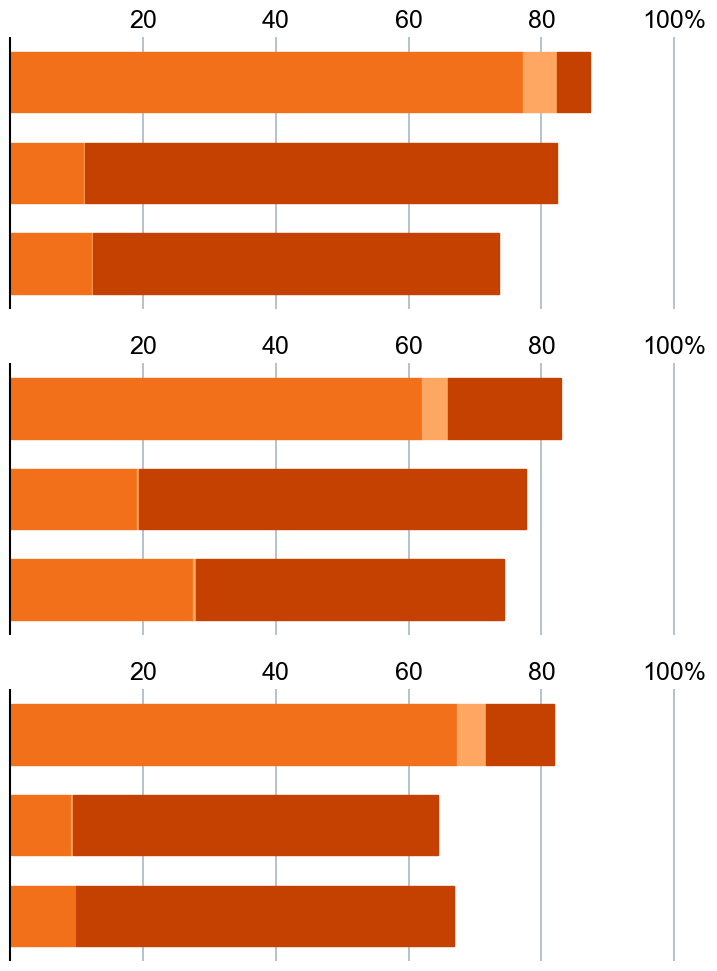

In [316]:
fig, ax = plt.subplots(nrows = 3, ncols = 1,figsize=(9, 12), sharex=True)
for t in [0,1,2]:
    name = name_list[t]
    x,y,z = df.iloc[3*t,3:9],df.iloc[3*t+1,3:9], df.iloc[3*t+2,3:9]
    x = x/x[0]
    y = y/y[0]
    z = z/z[0]
    bars = ax[t].barh([0.9,0.6, 0.3], [1,1,1], height = 0.2, color = 'white',alpha=0,edgecolor = 'black')
    for bar in bars:
        bar.set_linestyle('--')
        bar.set_linewidth(1)
    ax[t].barh([0.9,0.6, 0.3], [x[2],y[2],z[2]], height = 0.2, color = plt.cm.Oranges(0.6) , edgecolor = plt.cm.Oranges(0.6))
    ax[t].barh([0.9,0.6, 0.3], [x[3],y[3],z[3]], left = [x[2],y[2],z[2]], height = 0.2, color = plt.cm.Oranges(0.4), edgecolor = plt.cm.Oranges(0.4))
    ax[t].barh([0.9,0.6, 0.3], [x[4],y[4],z[4]], left = [x[2]+x[3],y[2]+y[3],z[2]+z[3]], height = 0.2, color = plt.cm.Oranges(0.8), edgecolor = plt.cm.Oranges(0.8))
    ax[t].xaxis.set_ticks([.2,.4,.6,.8,1])
    ax[t].xaxis.set_ticklabels(['20','40','60','80','100%'], size=18, fontfamily="Arial", fontweight=100)
    ax[t].xaxis.set_tick_params(labelbottom=False, labeltop=True, length=0)
    ax[t].set_ylim((.15, 1.05))
    ax[t].set_axisbelow(True)
    ax[t].grid(axis = "x", color="#A8BAC4", lw=1.2)
    ax[t].spines["right"].set_visible(False)
    ax[t].spines["top"].set_visible(False)
    ax[t].spines["bottom"].set_visible(False)
    ax[t].spines["left"].set_lw(1.5)
    ax[t].spines["left"].set_capstyle("butt")
    ax[t].yaxis.set_visible(False)

plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/database/bar_plot_type_fs_0.svg', bbox_inches='tight')
plt.show()

#### classifications  

In [317]:
fs = 0
name_list = ['AACR','COSMIC','CLINVAR']
list_of_n = []
list_of_fs = []
list_of_input = []
list_of_output = []
list_of_class_0 = []
list_of_class_1 = []
list_of_class_2 = []
list_of_class_3 = []
list_of_region = []

# df = df_binded[df_binded['type_h']=='SNP'].reset_index(drop=True)
for x in [0,1,2]:
    name = name_list[x]
    # SNV-only
    df_k = df_binded[df_binded['Database']==name].reset_index(drop=True)
    # exonic muts
    df_sub = df_k[[('E' in str(x)) for x in df_k['exon_h']]].reset_index(drop=True)
    list_of_region.append('Exonic')
    list_of_n.append(name)
    list_of_fs.append(fs)
    l_1 = len(df_sub['ID_human'].unique())
    df_sub_2 = df_sub[df_sub['status']==True]
    l_2 = len(df_sub_2['ID_human'].unique())
    print(f'{name} in Exonic Region: {l_2} out of {l_1} ({l_2/l_1* 100:.2f}%) mutations can be modeled.\n')
    list_of_output.append(l_2)
    list_of_input.append(l_1)
    list_of_class_0.append(len(df_sub[df_sub['class']==0]['ID_human'].unique()))
    list_of_class_1.append(len(df_sub[df_sub['class']==1]['ID_human'].unique()))
    list_of_class_2.append(len(df_sub[df_sub['class']==2]['ID_human'].unique()))
    list_of_class_3.append(len(df_sub[df_sub['class']==3]['ID_human'].unique()))

    # splicing muts
    df_sub= df_k[[('splice' in str(x)) for x in df_k['HGVSp_h']]].reset_index(drop=True)
    list_of_region.append('Splice_Site')
    list_of_n.append(name)
    list_of_fs.append(fs)
    l_1 = len(df_sub['ID_human'].unique())
    df_sub_2 = df_sub[df_sub['status']==True]
    l_2 = len(df_sub_2['ID_human'].unique())
    print(f'{name} in Splice Site: {l_2} out of {l_1} ({l_2/l_1* 100:.2f}%) mutations can be modeled.\n')
    list_of_output.append(l_2)
    list_of_input.append(l_1)
    list_of_class_0.append(len(df_sub[df_sub['class']==0]['ID_human'].unique()))
    list_of_class_1.append(len(df_sub[df_sub['class']==1]['ID_human'].unique()))
    list_of_class_2.append(len(df_sub[df_sub['class']==2]['ID_human'].unique()))
    list_of_class_3.append(len(df_sub[df_sub['class']==3]['ID_human'].unique()))
    
    # deep intronic muts
    list_a = [('I' in str(x)) for x in df_k['exon_h']]
    list_b = [('splice' not in str(x)) for x in df_k['HGVSp_h']]
    list_bind = [(x and y) for x,y in zip(list_a,list_b)]
    df_sub = df_k[list_bind].reset_index(drop=True)
    list_of_region.append('Deep_Intronic')
    list_of_n.append(name)
    list_of_fs.append(fs)
    l_1 = len(df_sub['ID_human'].unique())
    df_sub_2 = df_sub[df_sub['status']==True]
    l_2 = len(df_sub_2['ID_human'].unique())
    print(f'{name} in Deep Intronic Region: {l_2} out of {l_1} ({l_2/l_1* 100:.2f}%) mutations can be modeled.\n')
    list_of_output.append(l_2)
    list_of_input.append(l_1)
    list_of_class_0.append(len(df_sub[df_sub['class']==0]['ID_human'].unique()))
    list_of_class_1.append(len(df_sub[df_sub['class']==1]['ID_human'].unique()))
    list_of_class_2.append(len(df_sub[df_sub['class']==2]['ID_human'].unique()))
    list_of_class_3.append(len(df_sub[df_sub['class']==3]['ID_human'].unique()))

AACR in Exonic Region: 663997 out of 760385 (87.32%) mutations can be modeled.

AACR in Splice Site: 13619 out of 19159 (71.08%) mutations can be modeled.

AACR in Deep Intronic Region: 23554 out of 37400 (62.98%) mutations can be modeled.

COSMIC in Exonic Region: 347744 out of 391416 (88.84%) mutations can be modeled.

COSMIC in Splice Site: 6464 out of 7926 (81.55%) mutations can be modeled.

COSMIC in Deep Intronic Region: 72686 out of 114144 (63.68%) mutations can be modeled.

CLINVAR in Exonic Region: 1435486 out of 1709245 (83.98%) mutations can be modeled.

CLINVAR in Splice Site: 22999 out of 29764 (77.27%) mutations can be modeled.

CLINVAR in Deep Intronic Region: 165706 out of 268838 (61.64%) mutations can be modeled.



In [318]:
df = pd.DataFrame(zip(list_of_n, list_of_fs,list_of_region,
list_of_input,
list_of_output,
list_of_class_0,
list_of_class_1,
list_of_class_2,
list_of_class_3))
df.columns = ['Database','Flank_Size','Mutation_Type','Num_Input','Num_Output','Class_0','Class_1','Class_2','Class_3']
df

,Database,Flank_Size,Mutation_Type,Num_Input,Num_Output,Class_0,Class_1,Class_2,Class_3
0,AACR,0,Exonic,760385,663997,569230,36846,58601,0
1,AACR,0,Splice_Site,19159,13619,0,0,13619,0
2,AACR,0,Deep_Intronic,37400,23554,0,0,23554,0
3,COSMIC,0,Exonic,391416,347744,325952,21350,847,0
4,COSMIC,0,Splice_Site,7926,6464,0,0,6464,0
5,COSMIC,0,Deep_Intronic,114144,72686,0,0,72686,0
6,CLINVAR,0,Exonic,1709245,1435486,1277170,82406,77682,0
7,CLINVAR,0,Splice_Site,29764,22999,0,0,22999,0
8,CLINVAR,0,Deep_Intronic,268838,165706,0,0,165706,0


In [319]:
df['percet_modelable'] = df['Num_Output']/df['Num_Input']
df.to_csv('/Users/kexindong/Documents/GitHub/Output/h2m_database/database-output-final/fs_stat_2.csv', index = False)
df

,Database,Flank_Size,Mutation_Type,Num_Input,Num_Output,Class_0,Class_1,Class_2,Class_3,percet_modelable
0,AACR,0,Exonic,760385,663997,569230,36846,58601,0,0.873238
1,AACR,0,Splice_Site,19159,13619,0,0,13619,0,0.710841
2,AACR,0,Deep_Intronic,37400,23554,0,0,23554,0,0.629786
3,COSMIC,0,Exonic,391416,347744,325952,21350,847,0,0.888426
4,COSMIC,0,Splice_Site,7926,6464,0,0,6464,0,0.815544
5,COSMIC,0,Deep_Intronic,114144,72686,0,0,72686,0,0.636792
6,CLINVAR,0,Exonic,1709245,1435486,1277170,82406,77682,0,0.839836
7,CLINVAR,0,Splice_Site,29764,22999,0,0,22999,0,0.772712
8,CLINVAR,0,Deep_Intronic,268838,165706,0,0,165706,0,0.616379


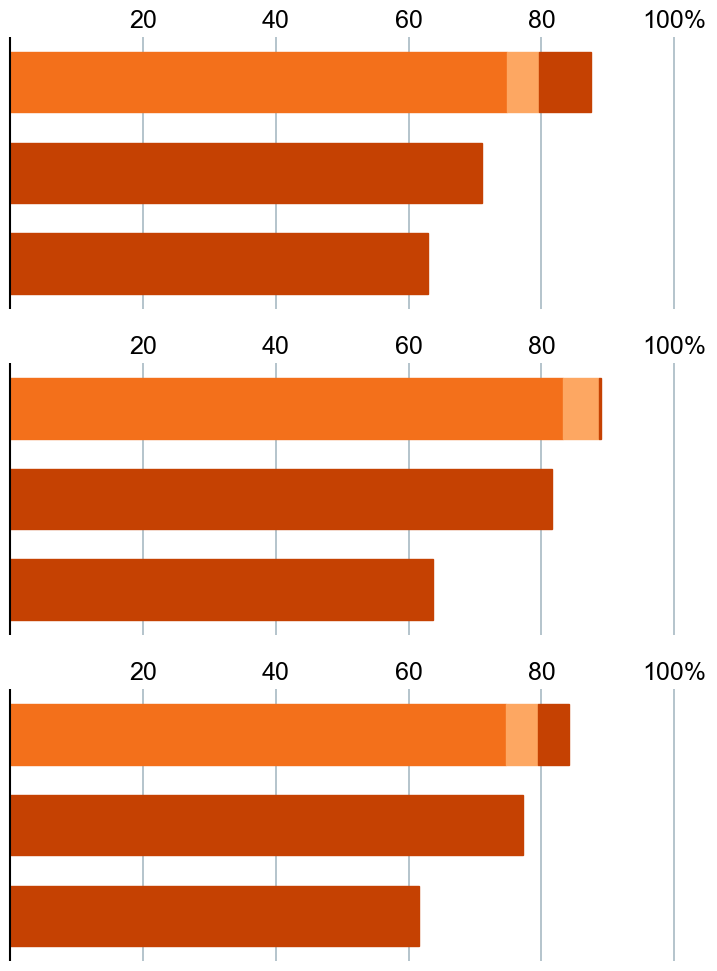

In [320]:
fig, ax = plt.subplots(nrows = 3, ncols = 1,figsize=(9, 12), sharex=True)
for t in [0,1,2]:
    name = name_list[t]
    x,y,z = df.iloc[3*t,3:9],df.iloc[3*t+1,3:9], df.iloc[3*t+2,3:9]
    x = x/x[0]
    y = y/y[0]
    z = z/z[0]
    bars = ax[t].barh([0.9,0.6, 0.3], [1,1,1], height = 0.2, color = 'white',alpha=0,edgecolor = 'black')
    for bar in bars:
        bar.set_linestyle('--')
        bar.set_linewidth(1)
    ax[t].barh([0.9,0.6, 0.3], [x[2],y[2],z[2]], height = 0.2, color = plt.cm.Oranges(0.6) , edgecolor = plt.cm.Oranges(0.6))
    ax[t].barh([0.9,0.6, 0.3], [x[3],y[3],z[3]], left = [x[2],y[2],z[2]], height = 0.2, color = plt.cm.Oranges(0.4), edgecolor = plt.cm.Oranges(0.4))
    ax[t].barh([0.9,0.6, 0.3], [x[4],y[4],z[4]], left = [x[2]+x[3],y[2]+y[3],z[2]+z[3]], height = 0.2, color = plt.cm.Oranges(0.8), edgecolor = plt.cm.Oranges(0.8))
    ax[t].xaxis.set_ticks([.2,.4,.6,.8,1])
    ax[t].xaxis.set_ticklabels(['20','40','60','80','100%'], size=18, fontfamily="Arial", fontweight=100)
    ax[t].xaxis.set_tick_params(labelbottom=False, labeltop=True, length=0)
    ax[t].set_ylim((.15, 1.05))
    ax[t].set_axisbelow(True)
    ax[t].grid(axis = "x", color="#A8BAC4", lw=1.2)
    ax[t].spines["right"].set_visible(False)
    ax[t].spines["top"].set_visible(False)
    ax[t].spines["bottom"].set_visible(False)
    ax[t].spines["left"].set_lw(1.5)
    ax[t].spines["left"].set_capstyle("butt")
    ax[t].yaxis.set_visible(False)

plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/database/bar_plot_classification_fs_0.svg', bbox_inches='tight')
plt.show()

## Supp figure polar plot  

In [321]:
list_of_n = []
list_of_fs = []
list_of_input = []
list_of_output = []
list_of_class_0 = []
list_of_class_1 = []
list_of_class_2 = []
list_of_class_3 = []


l_1 = len(df_binded['ID_human'].unique())
for fs in [0,2,4,6,8,10,20,30,40,50,100,200]:
    df = df_binded[df_binded['flank_size'] >= fs].reset_index(drop=True)
    list_of_n.append(name)
    list_of_fs.append(fs)
    df_sub = df[df['status']==True]
    l_2 = len(df_sub['ID_human'].unique())
    print(f'All with {fs}: {l_2} out of {l_1} ({l_2/l_1* 100:.2f}%) mutations can be modeled.\n')
    list_of_output.append(l_2)
    list_of_input.append(l_1)
    list_of_class_0.append(len(df[df['class']==0]['ID_human'].unique()))
    list_of_class_1.append(len(df[df['class']==1]['ID_human'].unique()))
    list_of_class_2.append(len(df[df['class']==2]['ID_human'].unique()))
    list_of_class_3.append(len(df[df['class']==3]['ID_human'].unique()))
    
df = pd.DataFrame(zip(list_of_n, list_of_fs,
list_of_input,
list_of_output,
list_of_class_0,
list_of_class_1,
list_of_class_2,
list_of_class_3))
df.columns = ['Database','Flank_Size','Num_Input','Num_Output','Class_0','Class_1','Class_2','Class_3']

All with 0: 2782954 out of 3384385 (82.23%) mutations can be modeled.

All with 2: 2401013 out of 3384385 (70.94%) mutations can be modeled.

All with 4: 2173546 out of 3384385 (64.22%) mutations can be modeled.

All with 6: 2019938 out of 3384385 (59.68%) mutations can be modeled.

All with 8: 1896967 out of 3384385 (56.05%) mutations can be modeled.

All with 10: 1791106 out of 3384385 (52.92%) mutations can be modeled.

All with 20: 1408442 out of 3384385 (41.62%) mutations can be modeled.

All with 30: 1168152 out of 3384385 (34.52%) mutations can be modeled.

All with 40: 994254 out of 3384385 (29.38%) mutations can be modeled.

All with 50: 870467 out of 3384385 (25.72%) mutations can be modeled.

All with 100: 533546 out of 3384385 (15.76%) mutations can be modeled.

All with 200: 259937 out of 3384385 (7.68%) mutations can be modeled.



In [322]:
df['percet_modelable'] = df['Num_Output']/df['Num_Input']
df['Database'] = 'All'
df.to_csv('/Users/kexindong/Documents/GitHub/Output/h2m_database/database-output-final/fs_stat_fs_all.csv', index = False)

In [323]:
df

,Database,Flank_Size,Num_Input,Num_Output,Class_0,Class_1,Class_2,Class_3,percet_modelable
0,All,0,3384385,2782954,2174237,140602,470972,0,0.822292
1,All,2,3384385,2401013,1990010,115012,297198,0,0.709438
2,All,4,3384385,2173546,1860627,106612,207180,0,0.642228
3,All,6,3384385,2019938,1749766,99874,170969,0,0.596840
4,All,8,3384385,1896967,1652993,93932,150574,0,0.560506
5,All,10,3384385,1791106,1567108,88715,135737,0,0.529226
6,All,20,3384385,1408442,1244829,69041,94844,0,0.416159
7,All,30,3384385,1168152,1036797,56492,75086,0,0.345159
8,All,40,3384385,994254,884848,47286,62306,0,0.293777
9,All,50,3384385,870467,775191,40948,54507,0,0.257201


In [324]:
coor_y = [0.3*(x+1) for x in range(len(df))]

In [325]:
width = 2*np.pi / len(df.index)
indexes = list(range(1, len(df.index)+1))
angles = [element * width for element in indexes]
angles = angles[1:] + angles[:1]

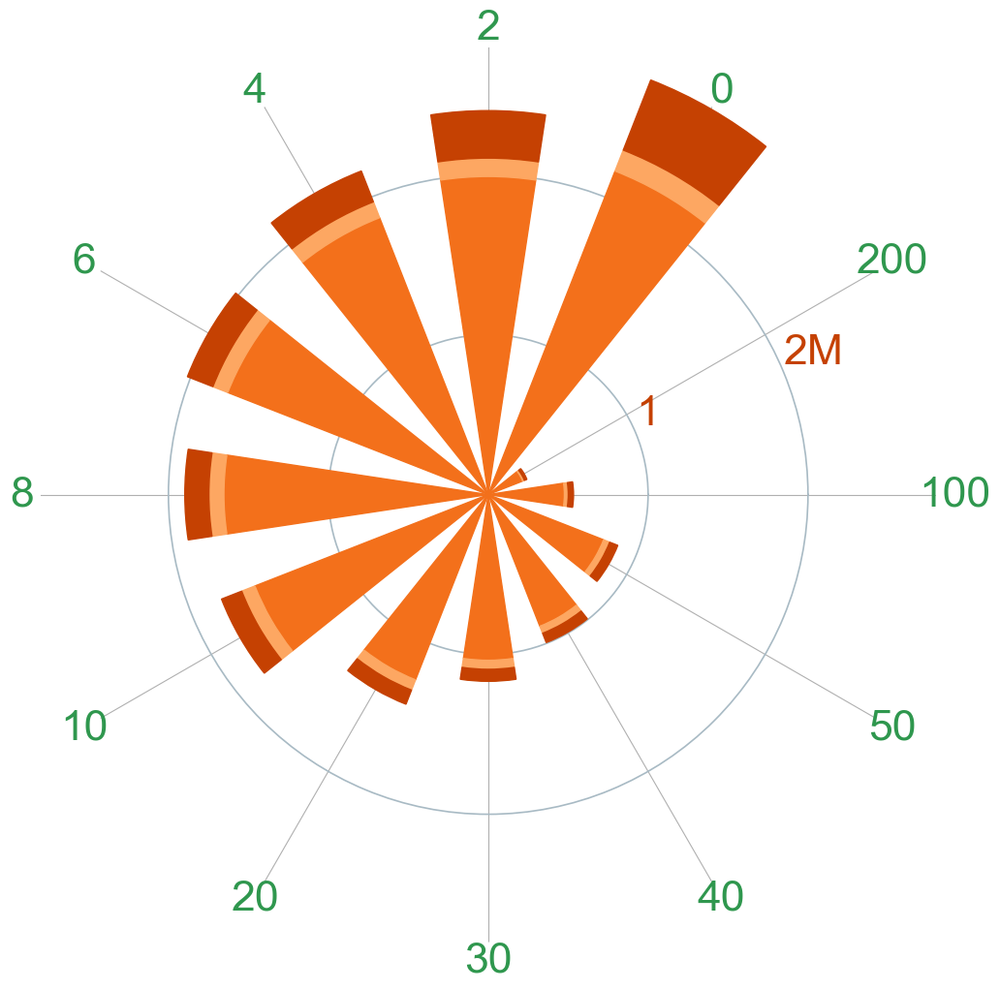

In [339]:
fig, ax = plt.subplots(nrows = 1, ncols = 1,figsize=(12, 12), 
                       subplot_kw={'polar': True}
                       )
x,y,z = df['Class_0'], df['Class_1'], df['Class_2']

bars = ax.barh([0.9,0.6, 0.3], [1,1,1], height = 0.2, color = 'white',alpha=0,edgecolor = 'black')
for bar in bars:
    bar.set_linestyle('--')
    bar.set_linewidth(1)
ax.bar(angles, x, width = 0.3, color = plt.cm.Oranges(0.6) , edgecolor = plt.cm.Oranges(0.6))
ax.bar(angles, y, bottom = x, width = 0.3, color = plt.cm.Oranges(0.4), edgecolor = plt.cm.Oranges(0.4))
ax.bar(angles, z, bottom = [(x1+y1) for (x1,y1) in zip(x,y)], width = 0.3, color = plt.cm.Oranges(0.8), edgecolor = plt.cm.Oranges(0.8))
ax.set_ylim(0, 2800000)
ax.yaxis.set_ticks([x*1000000 for x in range(1,3)])
ax.yaxis.set_ticklabels(['1','2M'], size=32, fontfamily="Arial", fontweight=100, color = plt.cm.Oranges(0.8))
ax.xaxis.set_ticks(angles)
ax.xaxis.set_ticklabels(list(df['Flank_Size']), size=32, fontfamily="Arial", fontweight=100, color = plt.cm.Greens(0.7))
ax.set_axisbelow(True)
ax.grid(axis = "y", color="#A8BAC4", lw=1.2)
ax.spines['polar'].set_visible(False)
# ax.xaxis.set_visible(False)
plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/database/polar_plot_classification_fs_0.svg', bbox_inches='tight')
plt.show()

In [197]:
len(coor_y)

12

## Alanine Scanning for the grant  
##### X->A mutation recorded in AACR-GENIE, ClinVar & COSMIC  

#### P53

In [103]:
df_p53 = df_am[df_am['uniprot_id']=='P04637'].reset_index(drop=True)
df_p53 = df_p53.drop('uniprot_id',axis=1)
df_p53.columns=['HGVSp_h','am_pathogenicity','am_class']
df_h2m = df_binded[df_binded['gene_name_h']=='TP53'].drop_duplicates(subset='ID_human').reset_index(drop=True)
df_h2m = df_h2m[df_h2m['classification_h'] == 'Missense'].reset_index(drop=True)
df_h2m = df_h2m.drop_duplicates(subset=['gene_name_h',
 'gene_id_h',
 'tx_id_h',
 'chr_h',
 'exon_num_h',
 'strand_h',
 'match',
 'start_h',
 'end_h',
 'ref_seq_h',
 'alt_seq_h',
 'HGVSc_h',
 'HGVSp_h',
 'classification_h',
 'exon_h',
 'type_h',
 'status',
 'class',
 'statement',
 'flank_size_left',
 'flank_size_right',
 'gene_name_m',
 'gene_id_m',
 'tx_id_m',
 'chr_m',
 'exon_num_m',
 'strand_m',
 'type_m',
 'classification_m',
 'exon_m',
 'start_m_ori',
 'end_m_ori',
 'ref_seq_m_ori',
 'alt_seq_m_ori',
 'HGVSc_m_ori',
 'HGVSp_m_ori',
 'start_m',
 'end_m',
 'ref_seq_m',
 'alt_seq_m',
 'HGVSc_m',
 'HGVSp_m',
 'flank_size'])
df_merged_all = pd.merge(df_h2m, df_p53, how='left').dropna(subset='am_class').reset_index(drop=True)
df_merged_all = df_merged_all[[x[-1]=='A' for x in df_merged_all['HGVSp_h']]].reset_index(drop=True)

In [104]:
def search_loc(s):
    match = re.search(r'(\d+)', s)
    if match:
        number = match.group(1)
        return int(number)
    else:
        return None
    
df_merged_all['loc_h'] = [search_loc(s) for s in  df_merged_all['HGVSp_h']]

In [105]:
df_merged_all['color'] = [color_dict[x] for x in df_merged_all['am_class']]
df_merged_all['color_h2m'] = [color_dict_h2m[x] for x in df_merged_all['class']]

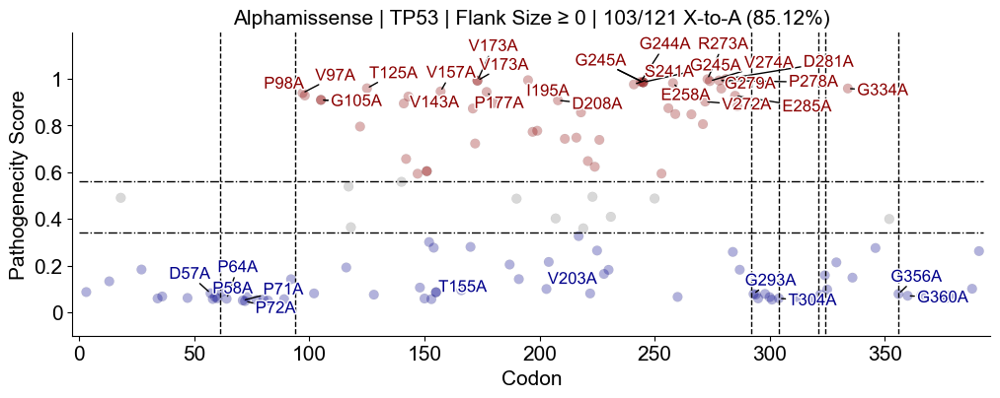

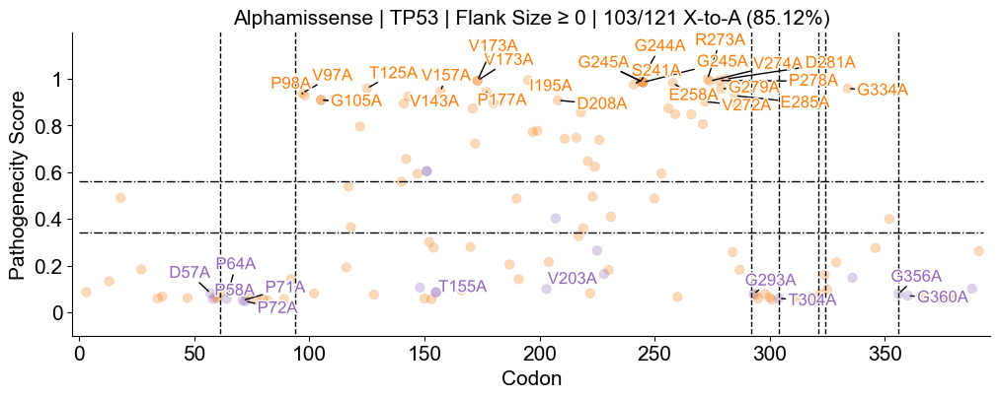

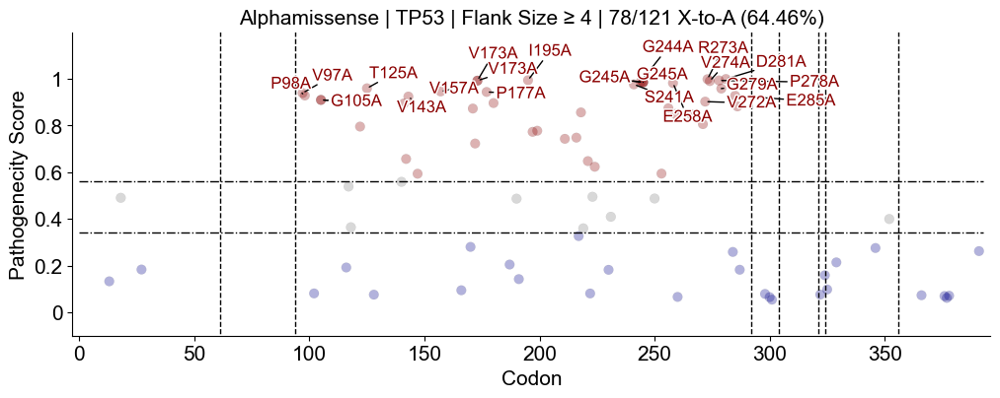

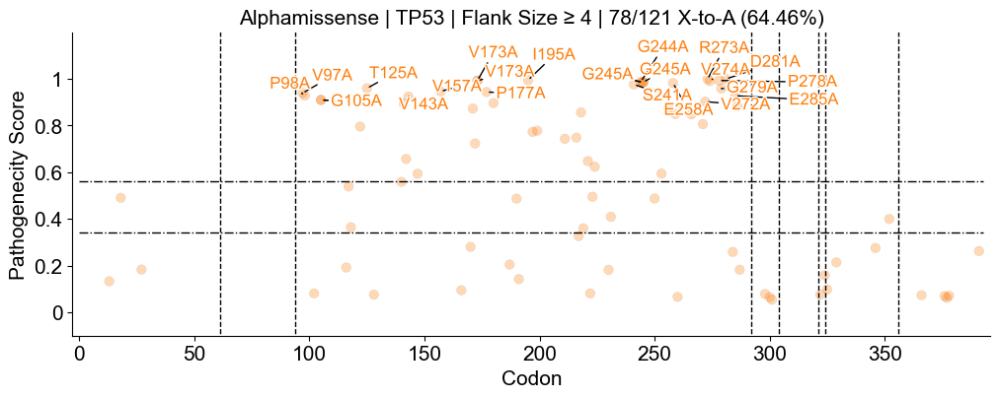

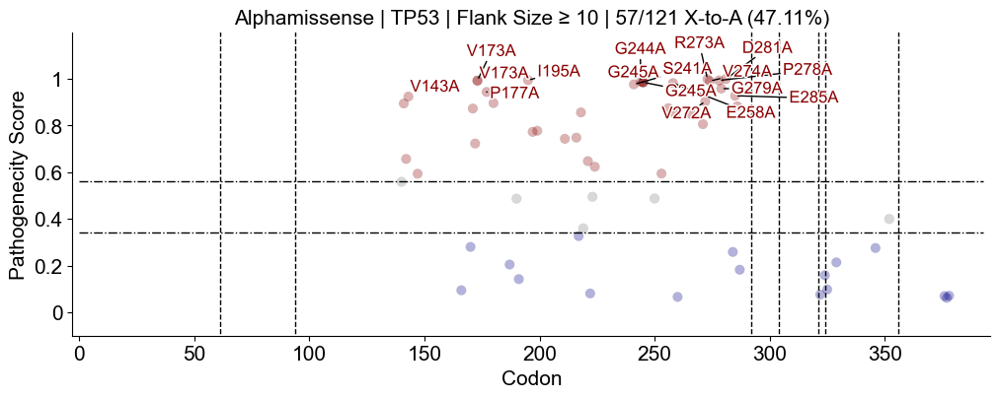

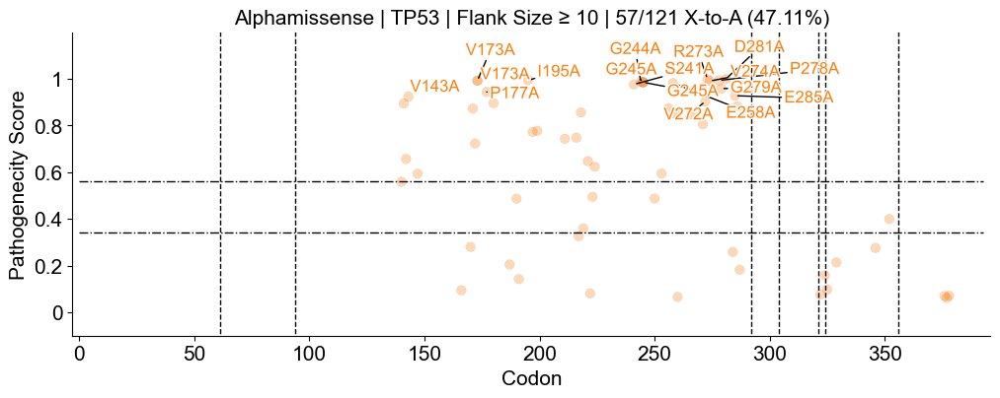

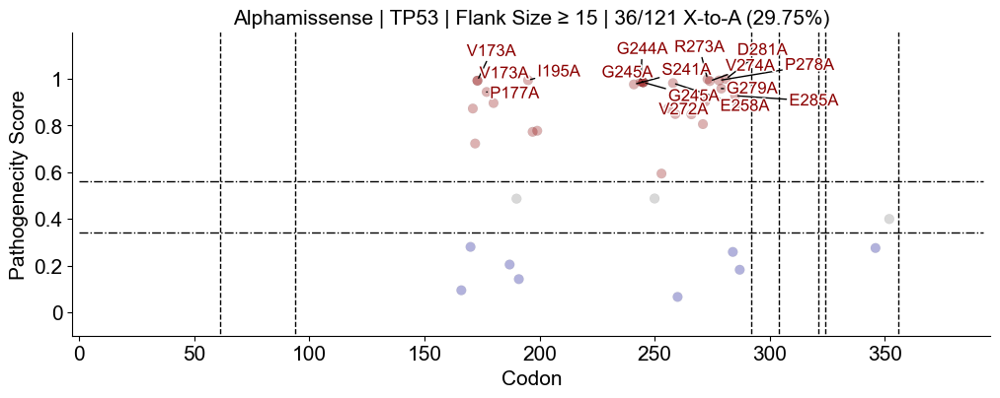

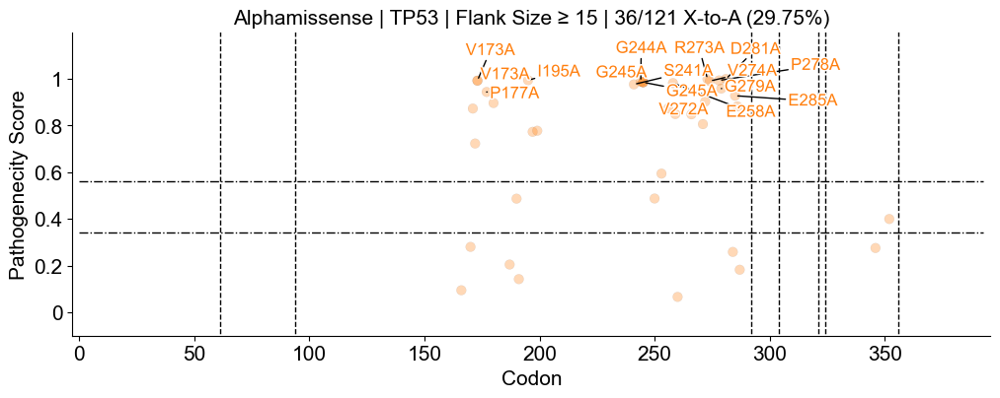

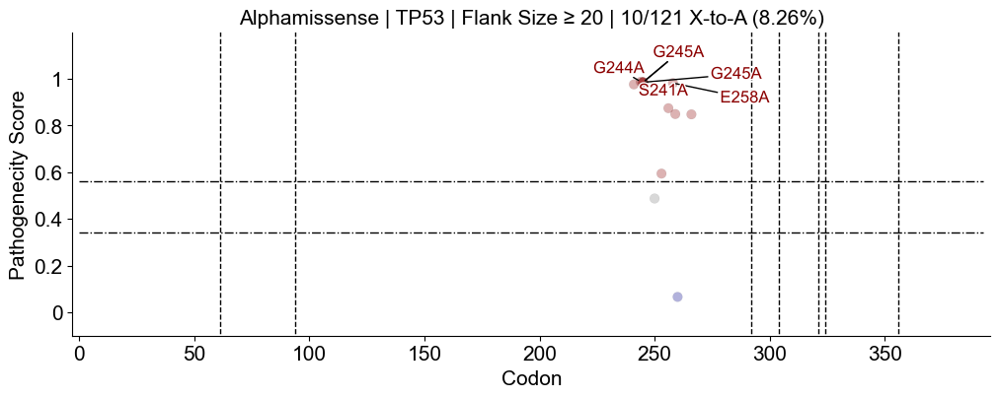

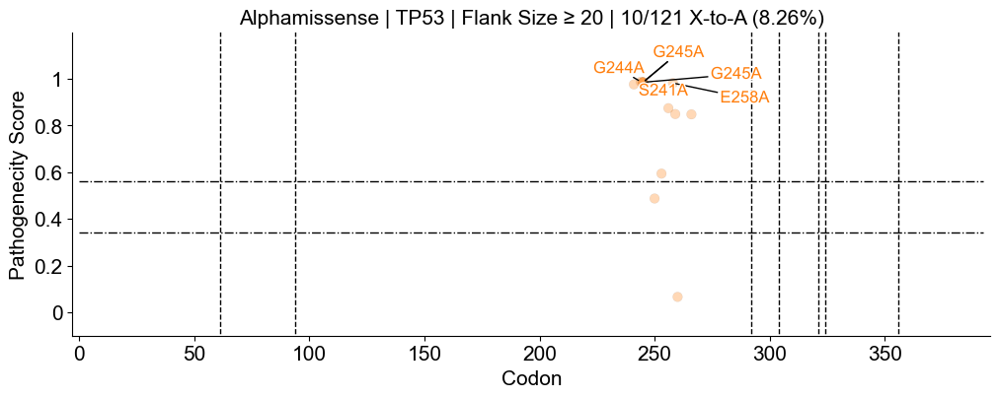

In [115]:
for fs in [0,4,10,15,20]:
    df_merged = df_merged_all[df_merged_all['flank_size'] >= fs].reset_index(drop=True)
    
    l1 = len(df_merged_all['HGVSp_h'].drop_duplicates())
    l2 = len(df_merged[df_merged['status']==True]['HGVSp_h'].drop_duplicates())
    percent = 100*l2/l1
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs} | {l2}/{l1} X-to-A ({percent:.2f}%)", fontsize=15)
    
    gene = 'TP53'

    bbb1 = df_merged[(df_merged['am_pathogenicity'] >= .9) & (df_merged['status'] == True)]
    bbb2 = df_merged[(df_merged['am_pathogenicity'] <= .1) & (df_merged['status'] == False)]
    bbb3 = df_merged[(df_merged['class'] == 1) & (df_merged['am_pathogenicity'] <= .8) & (df_merged['am_pathogenicity'] >= .6)]
    # top_2 = df_merged['HGVSp_h'].value_counts().index.to_list()[:2]
    # bbb3 = df_merged[df_merged['HGVSp_h'].isin(top_2)]
    bb2 = pd.concat((bbb1, bbb2,bbb3))

    t = list(bb2['HGVSp_h'])
    x = list(bb2['loc_h'])
    y = list(bb2['am_pathogenicity'])
    c = list(bb2['color'])


    fig, ax = plt.subplots(figsize=(12, 4))
    # 绘制散点图
    g = ax.scatter(data=df_merged, x='loc_h', y='am_pathogenicity',  c = 'color', alpha=.3, s=50, edgecolor='black', linewidths=.1)

    # 绘制参考线
    ax.plot([0, 393], [0.56, 0.56], linewidth=1, linestyle='-.', color='black')
    ax.plot([0, 393], [0.34, 0.34], linewidth=1, linestyle='-.', color='black')
    # ax.set_ylim(-6, 6)
    ax.set_xlim(-3, 396)
    ax.set_ylim(-.1, 1.2)
    ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
    ax.set_xlabel("Codon", fontsize=15)
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs} | {l2}/{l1} X-to-A ({percent:.2f}%)", fontsize=15)
    boundaries = [61, 94, 292, 304, 321, 324, 356]
    for bound in boundaries:
        ax.plot([bound, bound], [-6, 6], linewidth=1, linestyle='dashed', color='black')

    texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
    ax.yaxis.set_ticks([0,.2,.4,.6,.8,1])
    ax.yaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
    adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='x', which='major', labelsize=15)
    plt.show()


    c = list(bb2['color_h2m'])
    fig, ax = plt.subplots(figsize=(12, 4))
    # 绘制散点图
    g = ax.scatter(data=df_merged, x='loc_h', y='am_pathogenicity',  c = 'color_h2m', alpha=.3, s=50, edgecolor='black', linewidths=.1)

    # 绘制参考线
    ax.plot([0, 393], [0.56, 0.56], linewidth=1, linestyle='-.', color='black')
    ax.plot([0, 393], [0.34, 0.34], linewidth=1, linestyle='-.', color='black')
    # ax.set_ylim(-6, 6)
    ax.set_xlim(-3, 396)
    ax.set_ylim(-.1, 1.2)
    ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
    ax.set_xlabel("Codon", fontsize=15)
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs} | {l2}/{l1} X-to-A ({percent:.2f}%)", fontsize=15)
    boundaries = [61, 94, 292, 304, 321, 324, 356]
    for bound in boundaries:
        ax.plot([bound, bound], [-6, 6], linewidth=1, linestyle='dashed', color='black')

    texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
    ax.yaxis.set_ticks([0,.2,.4,.6,.8,1])
    ax.yaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
    adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='x', which='major', labelsize=15)
    plt.show()

### KRAS  

In [116]:
df_p53 = df_am[df_am['uniprot_id']=='P01116'].reset_index(drop=True)
df_p53 = df_p53.drop('uniprot_id',axis=1)
df_p53.columns=['HGVSp_h','am_pathogenicity','am_class']
df_h2m = df_binded[df_binded['gene_name_h']=='KRAS'].drop_duplicates(subset='ID_human').reset_index(drop=True)
df_h2m = df_h2m[df_h2m['classification_h'] == 'Missense'].reset_index(drop=True)
df_h2m = df_h2m.drop_duplicates(subset=['gene_name_h',
 'gene_id_h',
 'tx_id_h',
 'chr_h',
 'exon_num_h',
 'strand_h',
 'match',
 'start_h',
 'end_h',
 'ref_seq_h',
 'alt_seq_h',
 'HGVSc_h',
 'HGVSp_h',
 'classification_h',
 'exon_h',
 'type_h',
 'status',
 'class',
 'statement',
 'flank_size_left',
 'flank_size_right',
 'gene_name_m',
 'gene_id_m',
 'tx_id_m',
 'chr_m',
 'exon_num_m',
 'strand_m',
 'type_m',
 'classification_m',
 'exon_m',
 'start_m_ori',
 'end_m_ori',
 'ref_seq_m_ori',
 'alt_seq_m_ori',
 'HGVSc_m_ori',
 'HGVSp_m_ori',
 'start_m',
 'end_m',
 'ref_seq_m',
 'alt_seq_m',
 'HGVSc_m',
 'HGVSp_m',
 'flank_size'])
df_merged_all = pd.merge(df_h2m, df_p53, how='left').dropna(subset='am_class').reset_index(drop=True)
def search_loc(s):
    match = re.search(r'(\d+)', s)
    if match:
        number = match.group(1)
        return int(number)
    else:
        return None
    
df_merged_all['loc_h'] = [search_loc(s) for s in  df_merged_all['HGVSp_h']]
df_merged_all['color'] = [color_dict[x] for x in df_merged_all['am_class']]
df_merged_all['color_h2m'] = [color_dict_h2m[x] for x in df_merged_all['class']]

In [118]:
df_merged_all = df_merged_all[[x[-1]=='A' for x in df_merged_all['HGVSp_h']]].reset_index(drop=True)

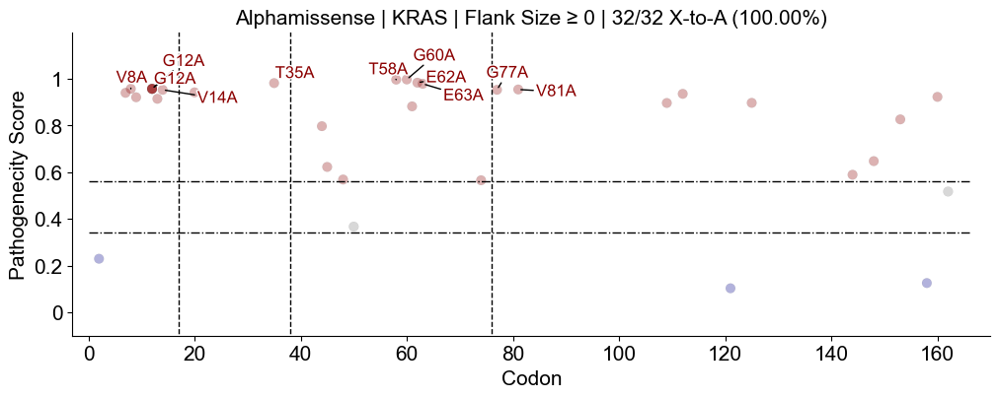

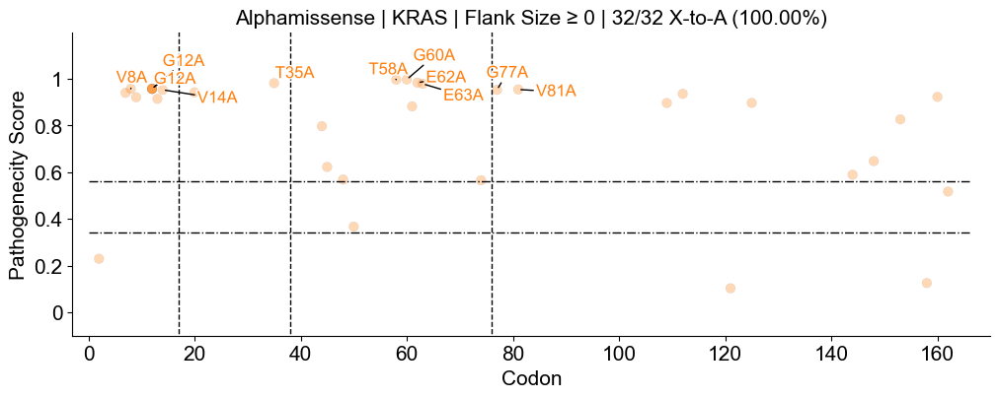

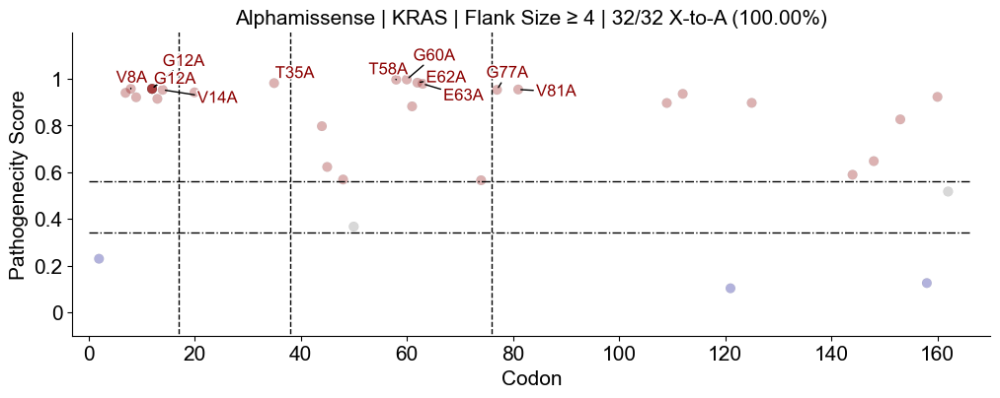

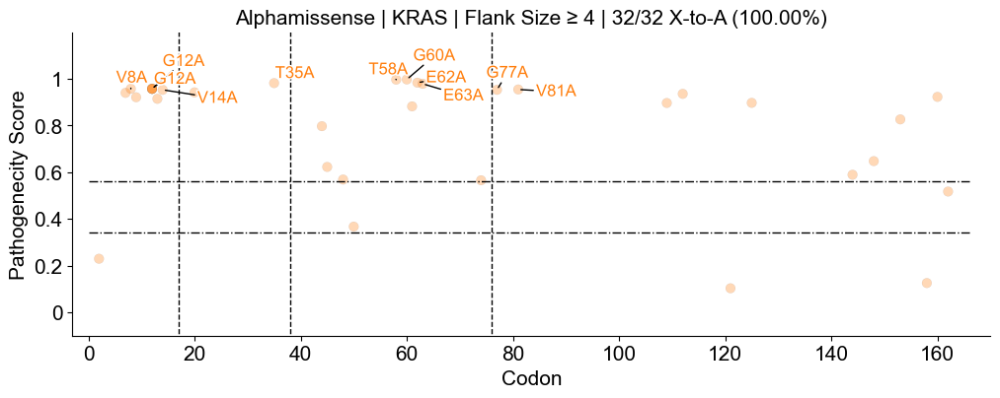

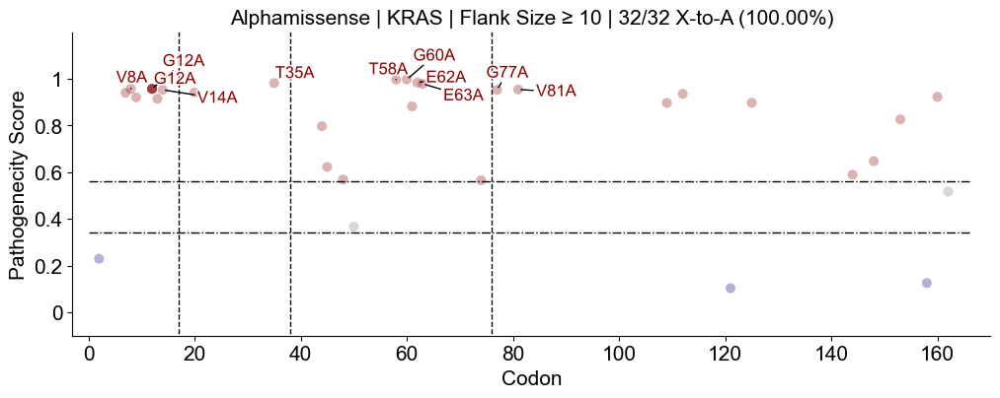

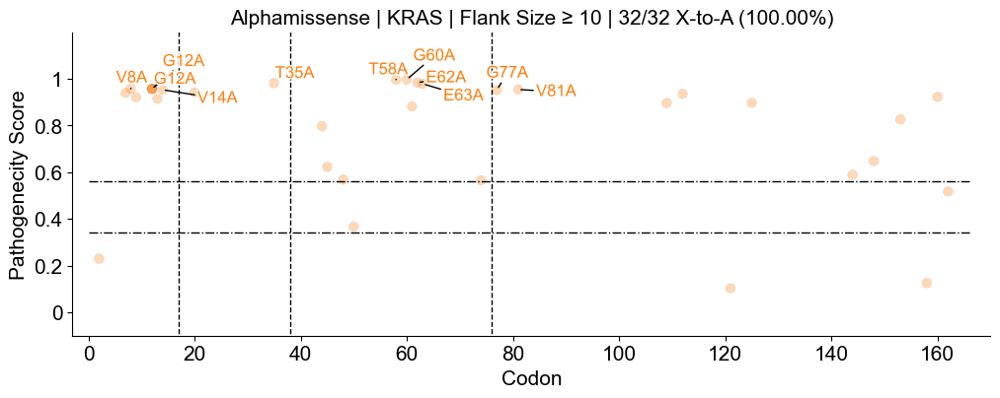

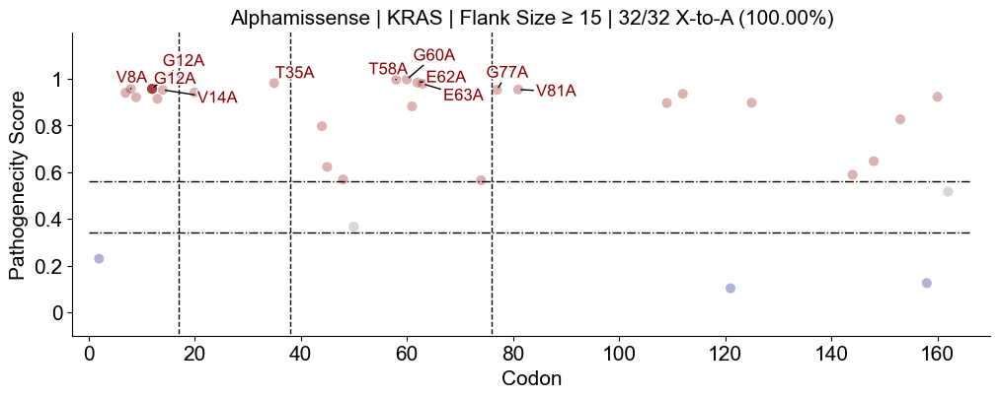

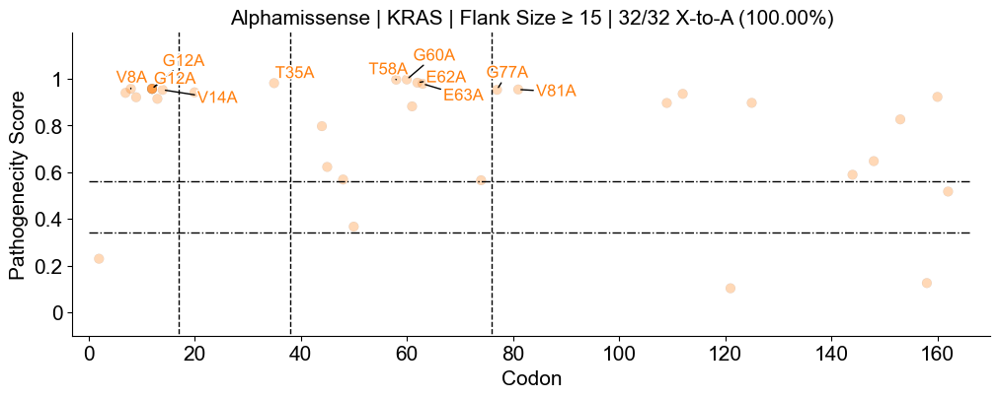

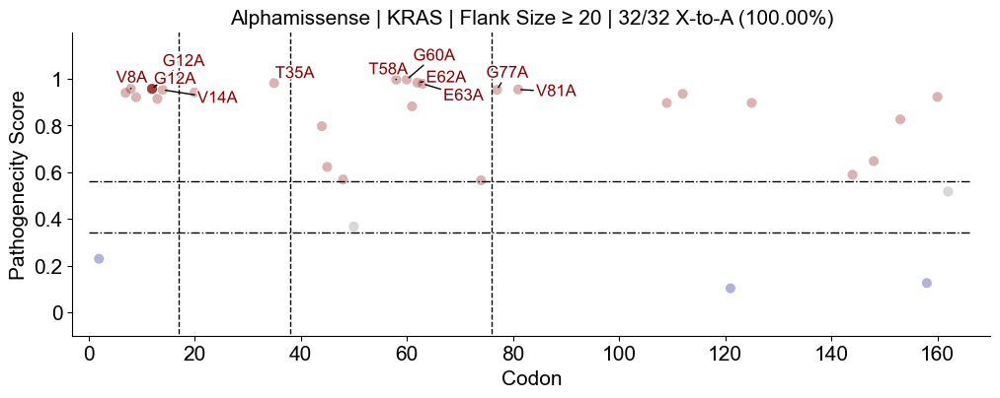

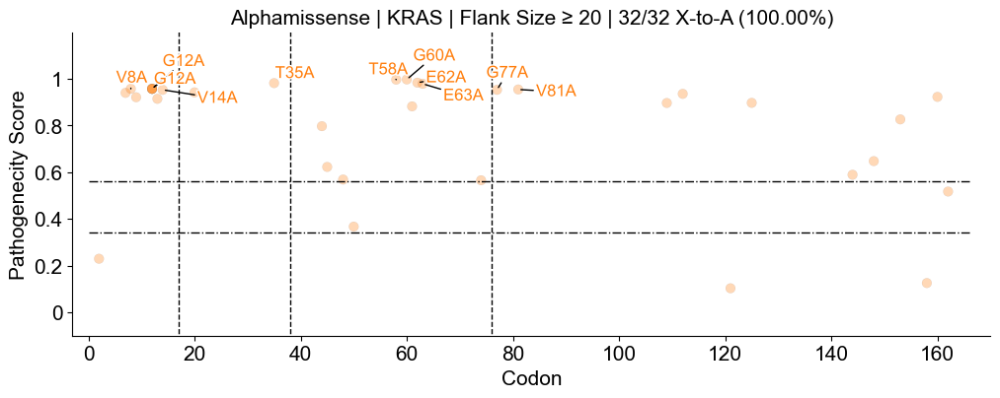

In [121]:
for fs in [0,4,10,15,20]:
    df_merged = df_merged_all[df_merged_all['flank_size'] >= fs].reset_index(drop=True)
    
    l1 = len(df_merged_all['HGVSp_h'].drop_duplicates())
    l2 = len(df_merged[df_merged['status']==True]['HGVSp_h'].drop_duplicates())
    percent = 100*l2/l1

    gene = 'KRAS'

    bbb1 = df_merged[(df_merged['am_pathogenicity'] >= .95) & (df_merged['status'] == True)]
    bbb2 = df_merged[(df_merged['am_pathogenicity'] <= .04) & (df_merged['status'] == True)]
    bbb3 = df_merged[(df_merged['class'] == 1)]
    # top_2 = df_merged['HGVSp_h'].value_counts().index.to_list()[:2]
    # bbb3 = df_merged[df_merged['HGVSp_h'].isin(top_2)]
    bb2 = pd.concat((bbb1, bbb2,bbb3))

    t = list(bb2['HGVSp_h'])
    x = list(bb2['loc_h'])
    y = list(bb2['am_pathogenicity'])
    c = list(bb2['color'])

    fig, ax = plt.subplots(figsize=(12, 4))
    # 绘制散点图
    g = ax.scatter(data=df_merged, x='loc_h', y='am_pathogenicity',  c = 'color', alpha=.3, s=50, edgecolor='black', linewidths=.1)

    # 绘制参考线
    ax.plot([0, 166], [0.56, 0.56], linewidth=1, linestyle='-.', color='black')
    ax.plot([0, 166], [0.34, 0.34], linewidth=1, linestyle='-.', color='black')
    # ax.set_ylim(-6, 6)
    ax.set_xlim(-3, 170)
    ax.set_ylim(-.1, 1.2)
    ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
    ax.set_xlabel("Codon", fontsize=15)
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs} | {l2}/{l1} X-to-A ({percent:.2f}%)", fontsize=15)
    boundaries = [17, 38, 76]
    for bound in boundaries:
        ax.plot([bound, bound], [-6, 6], linewidth=1, linestyle='dashed', color='black')

    texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
    ax.yaxis.set_ticks([0,.2,.4,.6,.8,1])
    ax.yaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
    adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='x', which='major', labelsize=15)
    plt.show()

    c = list(bb2['color_h2m'])

    fig, ax = plt.subplots(figsize=(12, 4))
    # 绘制散点图
    g = ax.scatter(data=df_merged, x='loc_h', y='am_pathogenicity',  c = 'color_h2m', alpha=.3, s=50, edgecolor='black', linewidths=.1)

    # 绘制参考线
    ax.plot([0, 166], [0.56, 0.56], linewidth=1, linestyle='-.', color='black')
    ax.plot([0, 166], [0.34, 0.34], linewidth=1, linestyle='-.', color='black')
    # ax.set_ylim(-6, 6)
    ax.set_xlim(-3, 170)
    ax.set_ylim(-.1, 1.2)
    ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
    ax.set_xlabel("Codon", fontsize=15)
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs} | {l2}/{l1} X-to-A ({percent:.2f}%)", fontsize=15)
    boundaries = [17, 38, 76]
    for bound in boundaries:
        ax.plot([bound, bound], [-6, 6], linewidth=1, linestyle='dashed', color='black')

    texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
    ax.yaxis.set_ticks([0,.2,.4,.6,.8,1])
    ax.yaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
    adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='x', which='major', labelsize=15)
    plt.show()

## Provean  

## Alphamissense  

Pathogenic: 0.56-1  
Ambiguous: 0.34-0.56  
Benign: 0.04-0.34  

### Uniprot ID/ Gene Symbol mapping  

In [319]:
file_path = '/Users/kexindong/Documents/GitHub/Database/Pathogenecity/AlphaMIssense/AlphaMissense_aa_substitutions.tsv'
df_am = pd.read_csv(file_path, sep = '\t',comment='#')

In [320]:
cols_to_drop_duplicate = ['gene_name_h',
 'gene_id_h',
 'tx_id_h',
 'chr_h',
 'exon_num_h',
 'strand_h',
 'match',
 'start_h',
 'end_h',
 'ref_seq_h',
 'alt_seq_h',
 'HGVSc_h',
 'HGVSp_h',
 'classification_h',
 'exon_h',
 'type_h',
 'status',
 'class',
 'statement',
 'flank_size_left',
 'flank_size_right',
 'gene_name_m',
 'gene_id_m',
 'tx_id_m',
 'chr_m',
 'exon_num_m',
 'strand_m',
 'type_m',
 'classification_m',
 'exon_m',
 'start_m_ori',
 'end_m_ori',
 'ref_seq_m_ori',
 'alt_seq_m_ori',
 'HGVSc_m_ori',
 'HGVSp_m_ori',
 'start_m',
 'end_m',
 'ref_seq_m',
 'alt_seq_m',
 'HGVSc_m',
 'HGVSp_m',
 'flank_size']

In [602]:
color_dict = dict({
    'pathogenic':'darkred',
    'benign':'darkblue',
    'ambiguous':'grey'
})

color_dict_h2m = dict({0:'tab:orange',
                  1:'tab:green',
                  4:'tab:purple'})

def search_loc(s):
    match = re.search(r'(\d+)', s)
    if match:
        number = match.group(1)
        return int(number)
    else:
        return None

In [34]:
df_am

,uniprot_id,protein_variant,am_pathogenicity,am_class
0,A0A024R1R8,M1A,0.4673,ambiguous
1,A0A024R1R8,M1C,0.3828,ambiguous
2,A0A024R1R8,M1D,0.8267,pathogenic
3,A0A024R1R8,M1E,0.5236,ambiguous
4,A0A024R1R8,M1F,0.2753,benign
...,...,...,...,...
216175346,X6R8D5,S127R,0.6837,pathogenic
216175347,X6R8D5,S127T,0.0885,benign
216175348,X6R8D5,S127V,0.4471,ambiguous
216175349,X6R8D5,S127W,0.5592,ambiguous


In [151]:
def get_uniprot_ids_from_gene_symbols(gene_symbols):
    base_url = "https://rest.uniprot.org/uniprotkb/search"
    uniprot_ids = {}

    for gene_symbol in gene_symbols:
        query = f"query=gene_exact:{gene_symbol}&fields=accession"
        url = f"{base_url}?{query}"
        headers = {
            'Content-Type': 'application/json',
            'Accept': 'application/json'
        }

        response = requests.get(url, headers=headers)
        if response.status_code == 200:
            data = response.json()
            results = data.get('results', [])
            if results:
                uniprot_id = results[0].get('primaryAccession', None)
                uniprot_ids[gene_symbol] = uniprot_id
            else:
                uniprot_ids[gene_symbol] = None
        else:
            print(f"Failed to retrieve data for gene symbol: {gene_symbol}")
        
        # 添加延迟以避免速率限制
        time.sleep(1)

    return uniprot_ids

In [37]:
# 示例基因符号列表
gene_symbols = ["TP53", "EGFR", "BRCA1",'KIT', 'APC','KARS','ATM','KMT2D', 'SMARCA2', 'SMARCA4','IDH1', 'IDH2']

uniprot_ids = get_uniprot_ids_from_gene_symbols(gene_symbols)
for gene_symbol, uniprot_id in uniprot_ids.items():
    print(f"Gene Symbol: {gene_symbol}, UniProt ID: {uniprot_id}")

Gene Symbol: TP53, UniProt ID: P04637
Gene Symbol: EGFR, UniProt ID: P00533
Gene Symbol: BRCA1, UniProt ID: P38398
Gene Symbol: KIT, UniProt ID: P10721
Gene Symbol: APC, UniProt ID: P25054
Gene Symbol: KARS, UniProt ID: Q15046
Gene Symbol: ATM, UniProt ID: Q13315
Gene Symbol: KMT2D, UniProt ID: O14686
Gene Symbol: SMARCA2, UniProt ID: P51531
Gene Symbol: SMARCA4, UniProt ID: P51532
Gene Symbol: IDH1, UniProt ID: O75874
Gene Symbol: IDH2, UniProt ID: P48735


In [275]:
def get_gene_symbols_from_uniprot(uniprot_ids):
    base_url = "https://rest.uniprot.org/uniprotkb/search"
    gene_symbols = {}

    for uniprot_id in uniprot_ids:
        query = f"query={uniprot_id}&fields=accession%2Cgene_names"
        url = f"{base_url}?{query}"
        headers = {
            'Content-Type': 'application/json',
            'Accept': 'application/json'
        }

        response = requests.get(url, headers=headers)
        if response.status_code == 200:
            data = response.json()
            results = data.get('results', [])
            if results:
                entry = results[0]
                gene_names = entry.get('genes', [])
                if gene_names:
                    gene_symbol = gene_names[0].get('geneName', {}).get('value', None)
                    gene_symbols[uniprot_id] = gene_symbol
                else:
                    gene_symbols[uniprot_id] = None
            else:
                gene_symbols[uniprot_id] = None
        else:
            print(f"Failed to retrieve data for UniProt ID: {uniprot_id}")

    return gene_symbols

In [278]:

# 示例UniProt ID列表
uniprot_ids = ["A0A024R1R8", "P31749", "P15056"]

gene_symbols = get_gene_symbols_from_uniprot(uniprot_ids)
for uniprot_id, gene_symbol in gene_symbols.items():
    print(f"UniProt ID: {uniprot_id}, Gene Symbol: {gene_symbol}")


UniProt ID: A0A024R1R8, Gene Symbol: TMA7B
UniProt ID: P31749, Gene Symbol: AKT1
UniProt ID: P15056, Gene Symbol: BRAF


### P53

In [204]:
df_binded = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/h2m_database/database-output-final/df_result_cleaned_v3.csv')
df_h2m = df_binded[df_binded['gene_name_h']=='TP53'].drop_duplicates(subset='ID_human').reset_index(drop=True)
df_h2m = df_h2m[df_h2m['classification_h'] == 'Missense'].reset_index(drop=True)

In [124]:
df_p53 = df_am[df_am['uniprot_id']=='P04637'].reset_index(drop=True)
df_p53 = df_p53.drop('uniprot_id',axis=1)
df_p53.columns=['HGVSp_h','am_pathogenicity','am_class']
df_h2m = df_binded[df_binded['gene_name_h']=='TP53'].drop_duplicates(subset='ID_human').reset_index(drop=True)
df_h2m = df_h2m[df_h2m['classification_h'] == 'Missense'].reset_index(drop=True)
df_h2m = df_h2m.drop_duplicates(subset=cols_to_drop_duplicate)
df_merged_all = pd.merge(df_h2m, df_p53, how='left').dropna(subset='am_class').reset_index(drop=True)
df_merged_all['loc_h'] = [search_loc(s) for s in  df_merged_all['HGVSp_h']]
df_merged_all['color'] = [color_dict[x] for x in df_merged_all['am_class']]
df_merged_all['color_h2m'] = [color_dict_h2m[x] for x in df_merged_all['class']]

In [515]:
list_density = []
for fs in [20,10,4,0]:
    df_merged = df_merged_all[df_merged_all['flank_size'] >= fs].reset_index(drop=True)
    df_merged = df_merged[df_merged['status']==True]
    df_merged = df_merged[['ID_human','HGVSp_h','am_pathogenicity','am_class','loc_h']]
    df_merged['fs'] = f'FS={fs}'
    list_density.append(df_merged)
df_density = pd.concat(list_density)

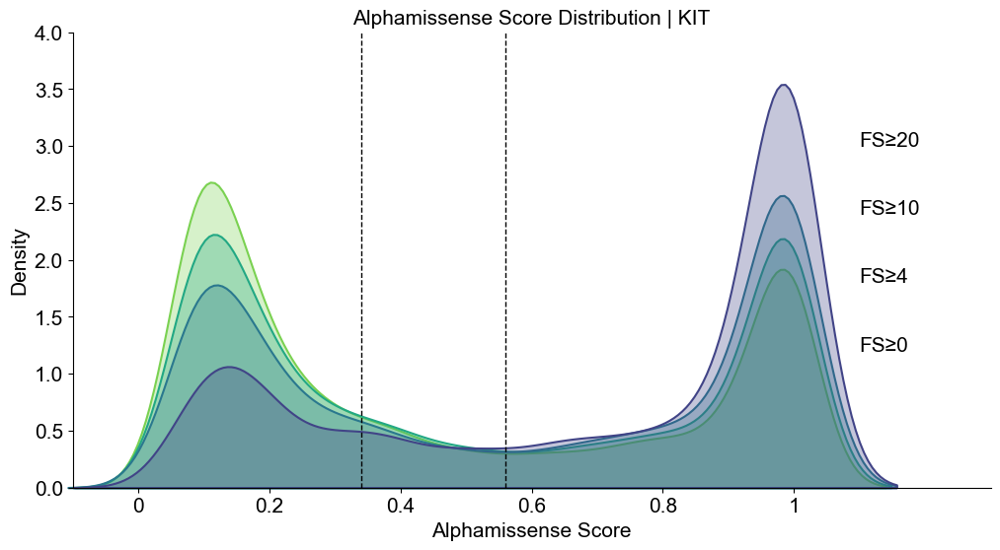

In [522]:
fig, ax = plt.subplots(figsize=(12, 6))
gene = 'KIT'
p = sns.kdeplot(data=df_density, x="am_pathogenicity", hue="fs", fill=True, common_norm=False, alpha=0.3, palette="viridis",  
                ax=ax, bw_adjust=.6,
                clip_on=False,
                linewidth=1.5)
p.legend(loc='upper left', frameon=False)
# control x limit
plt.xlim(-.1, 1.3)
plt.ylim(0, 4)
boundaries = [.34,.56]
for bound in boundaries:
    ax.plot([bound, bound], [0, 6], linewidth=1, linestyle='dashed', color='black')
# add axis names        
ax.set_xlabel("Alphamissense Score",fontsize=15)
ax.set_ylabel("Density",fontsize=15)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(axis='y', which='major', labelsize=15)
ax.xaxis.set_ticks([0,.2,.4,.6,.8,1])
ax.xaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
annot = pd.DataFrame({
'x': [1.1]*4,
'y': [3,2.4,1.8,1.2],
'text': list([f'FS≥{fs}' for fs in [20,10,4,0]])
})

# add annotations one by one with a loop
for point in range(0,len(annot)):
    p.text(annot.x[point], annot.y[point], annot.text[point], horizontalalignment='left', size=15)
ax.set_title(f"Alphamissense Score Distribution | {gene}", fontsize=15)
plt.savefig('/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/database/fs_stratified.pdf',bbox_inches='tight')
plt.show()

Text(0.5, 0.98, 'Daily average temperature in Seattle per month')

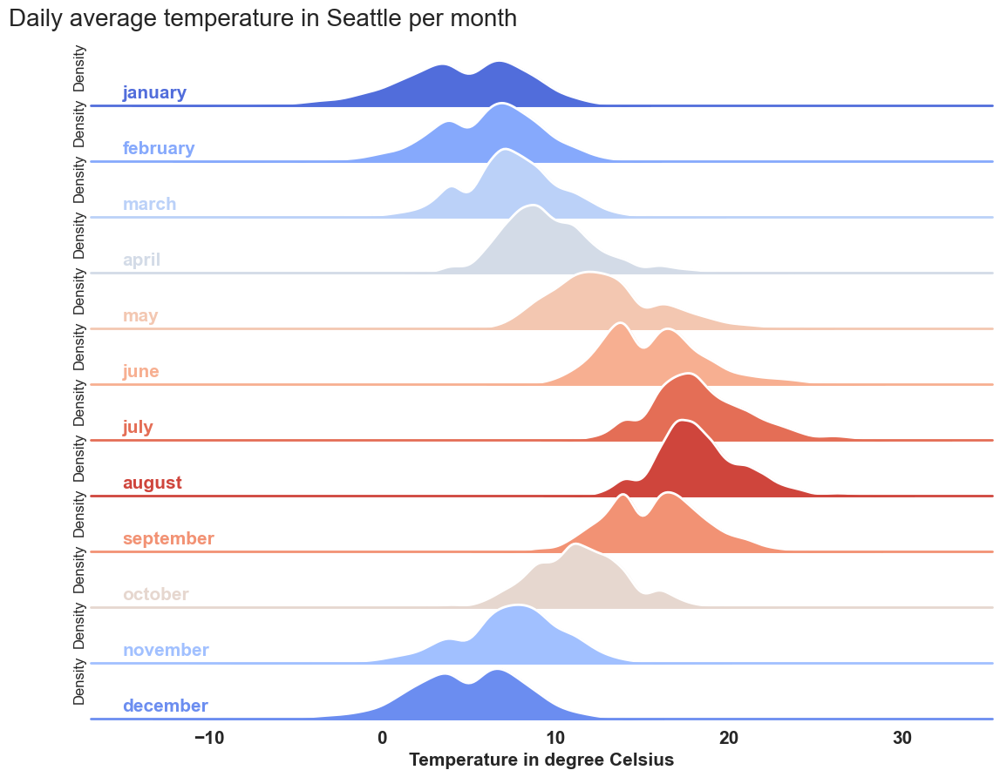

In [268]:
# getting necessary libraries
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})

# getting the data
temp = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/2016-weather-data-seattle.csv') # we retrieve the data from plotly's GitHub repository
temp['month'] = pd.to_datetime(temp['Date']).dt.month # we store the month in a separate column

# we define a dictionnary with months that we'll use later
month_dict = {1: 'january',
              2: 'february',
              3: 'march',
              4: 'april',
              5: 'may',
              6: 'june',
              7: 'july',
              8: 'august',
              9: 'september',
              10: 'october',
              11: 'november',
              12: 'december'}

# we create a 'month' column
temp['month'] = temp['month'].map(month_dict)

# we generate a pd.Serie with the mean temperature for each month (used later for colors in the FacetGrid plot), and we create a new column in temp dataframe
month_mean_serie = temp.groupby('month')['Mean_TemperatureC'].mean()
temp['mean_month'] = temp['month'].map(month_mean_serie)# we generate a color palette with Seaborn.color_palette()
pal = sns.color_palette(palette='coolwarm', n_colors=12)

# in the sns.FacetGrid class, the 'hue' argument is the one that is the one that will be represented by colors with 'palette'
g = sns.FacetGrid(temp, row='month', hue='mean_month', aspect=15, height=0.75, palette=pal)

# then we add the densities kdeplots for each month
g.map(sns.kdeplot, 'Mean_TemperatureC',
      bw_adjust=1, clip_on=False,
      fill=True, alpha=1, linewidth=1.5)

# here we add a white line that represents the contour of each kdeplot
g.map(sns.kdeplot, 'Mean_TemperatureC', 
      bw_adjust=1, clip_on=False, 
      color="w", lw=2)

# here we add a horizontal line for each plot
g.map(plt.axhline, y=0,
      lw=2, clip_on=False)

# we loop over the FacetGrid figure axes (g.axes.flat) and add the month as text with the right color
# notice how ax.lines[-1].get_color() enables you to access the last line's color in each matplotlib.Axes
for i, ax in enumerate(g.axes.flat):
    ax.text(-15, 0.02, month_dict[i+1],
            fontweight='bold', fontsize=15,
            color=ax.lines[-1].get_color())
    
# we use matplotlib.Figure.subplots_adjust() function to get the subplots to overlap
g.fig.subplots_adjust(hspace=-0.3)

# eventually we remove axes titles, yticks and spines
g.set_titles("")
g.set(yticks=[])
g.despine(bottom=True, left=True)

plt.setp(ax.get_xticklabels(), fontsize=15, fontweight='bold')
plt.xlabel('Temperature in degree Celsius', fontweight='bold', fontsize=15)
g.fig.suptitle('Daily average temperature in Seattle per month',
               ha='right',
               fontsize=20,
               fontweight=20)


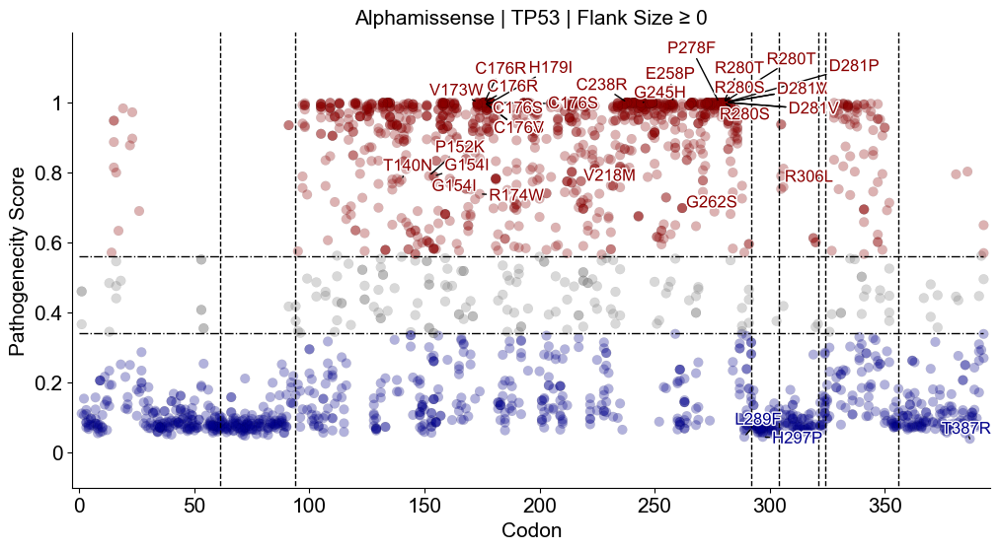

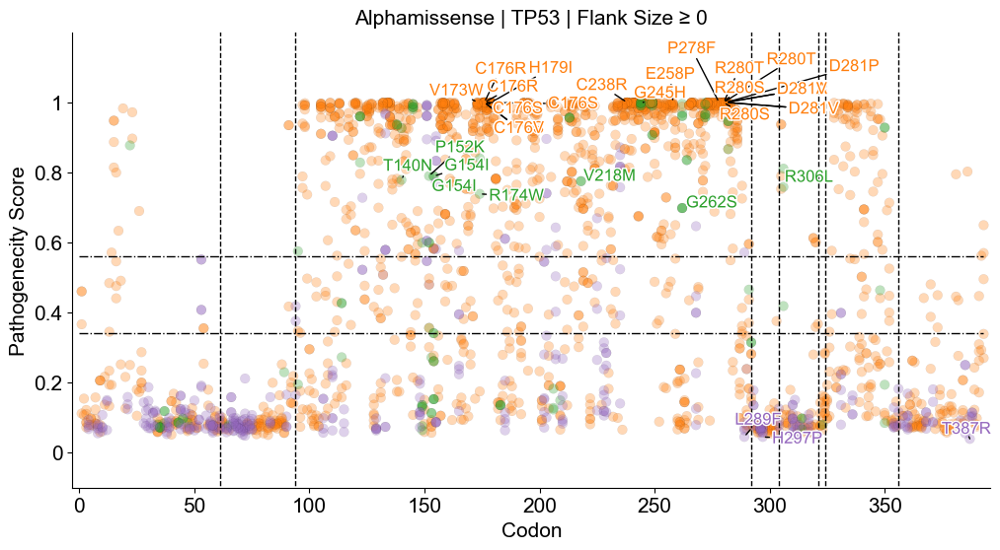

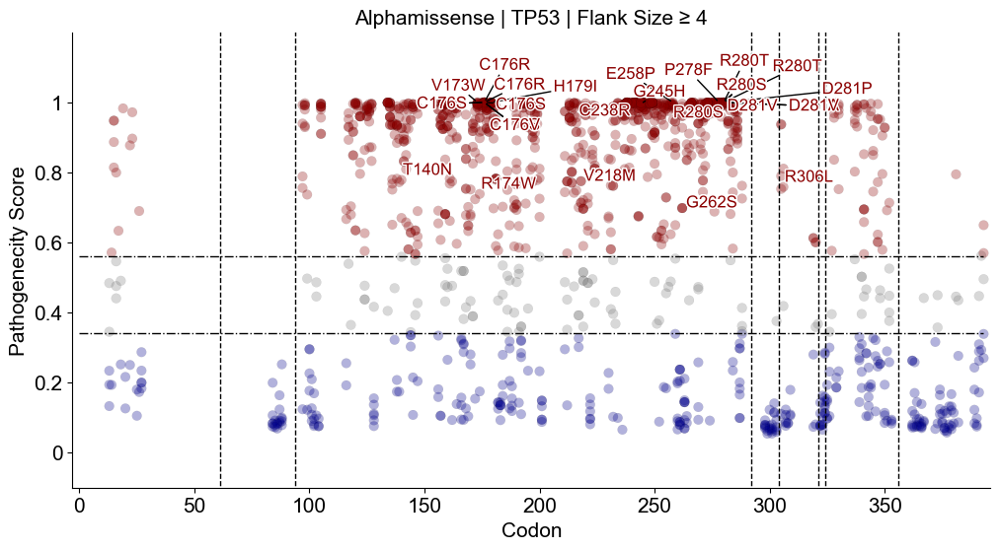

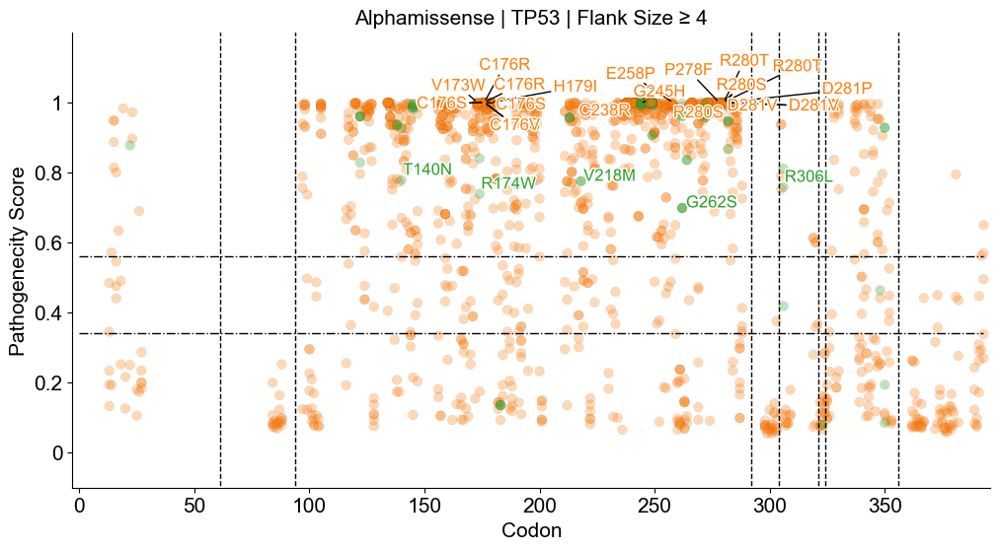

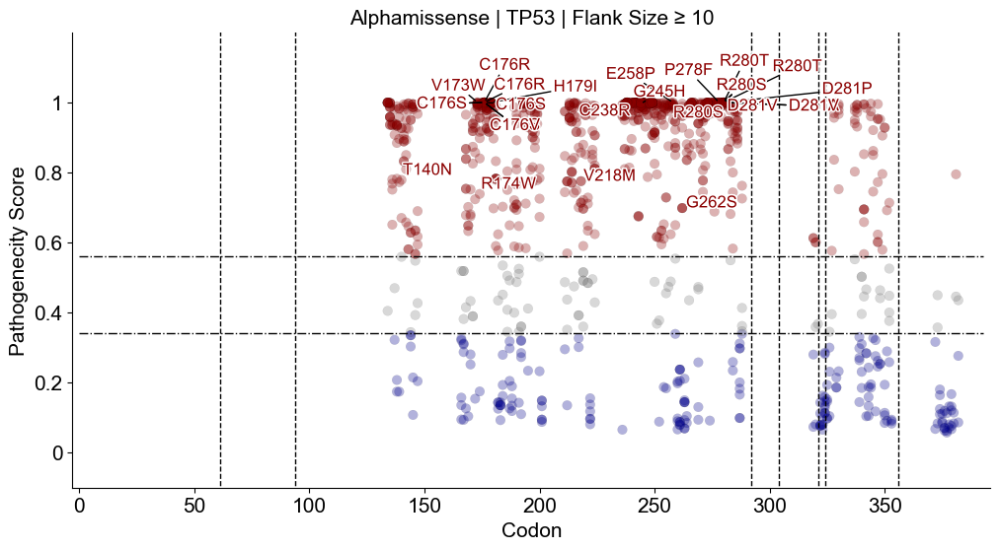

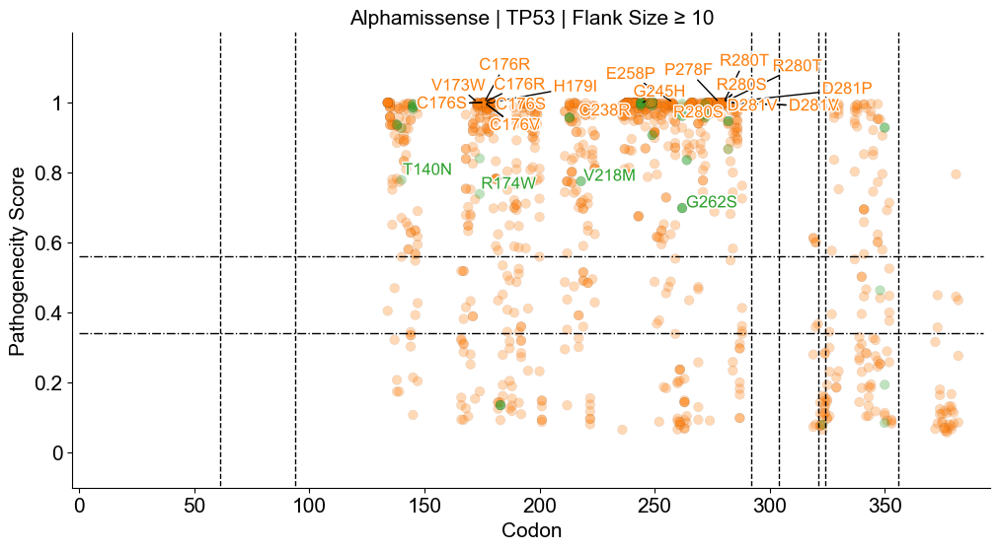

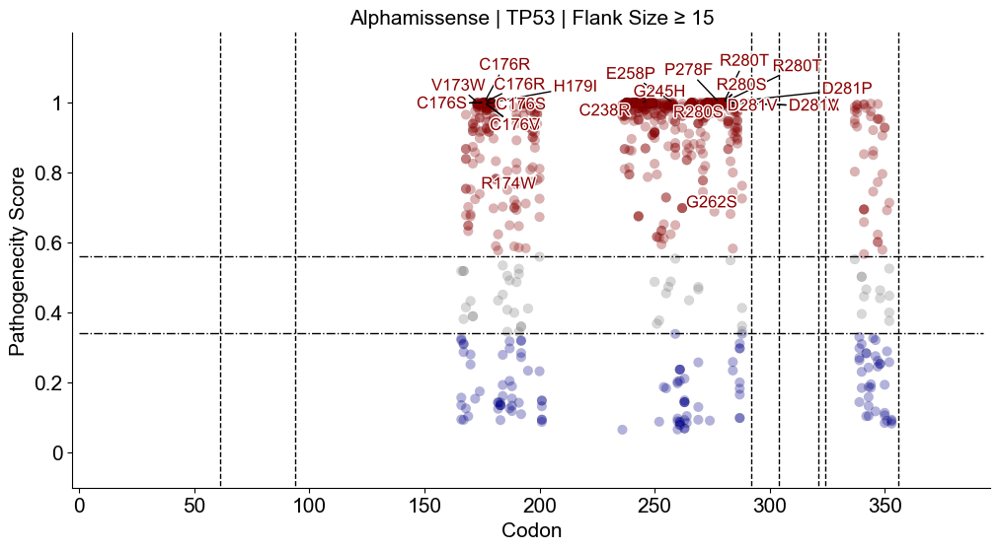

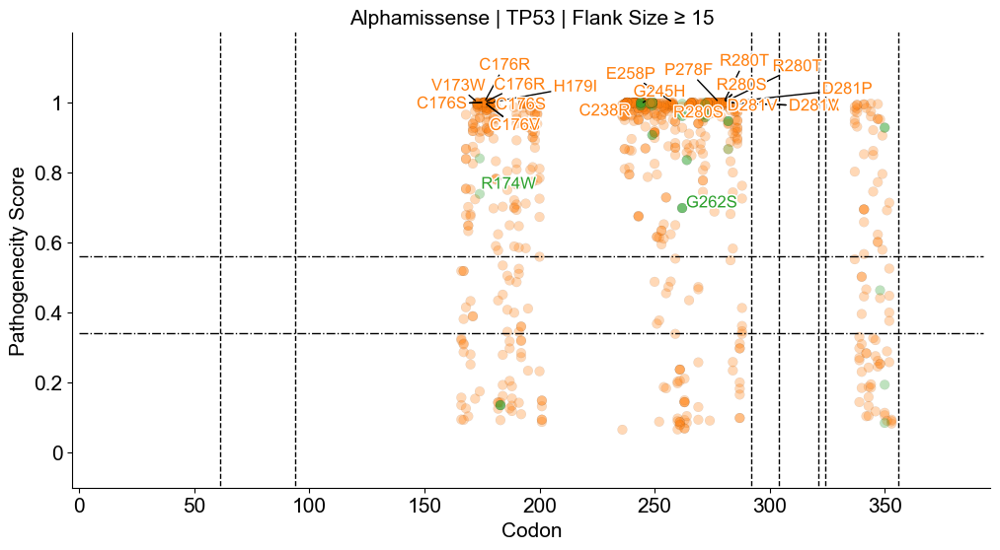

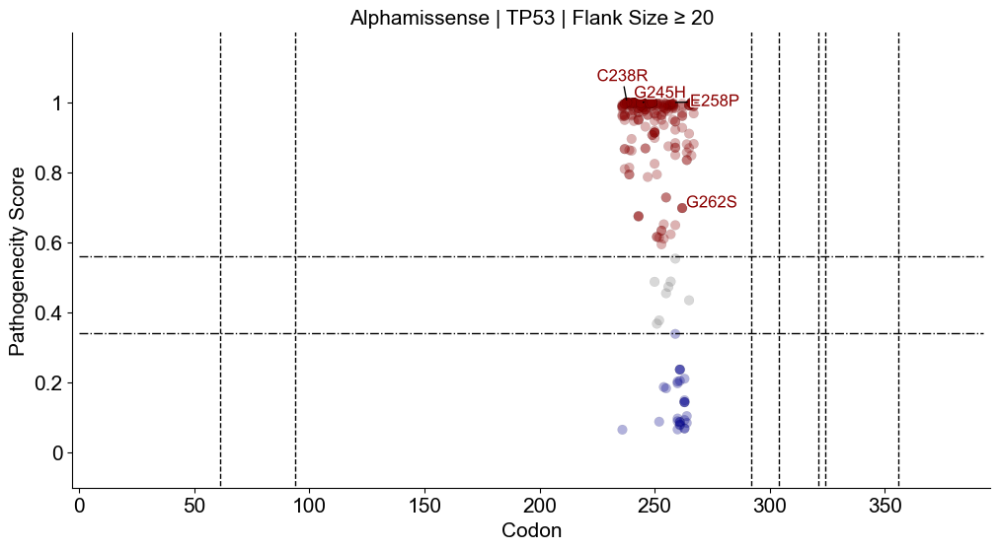

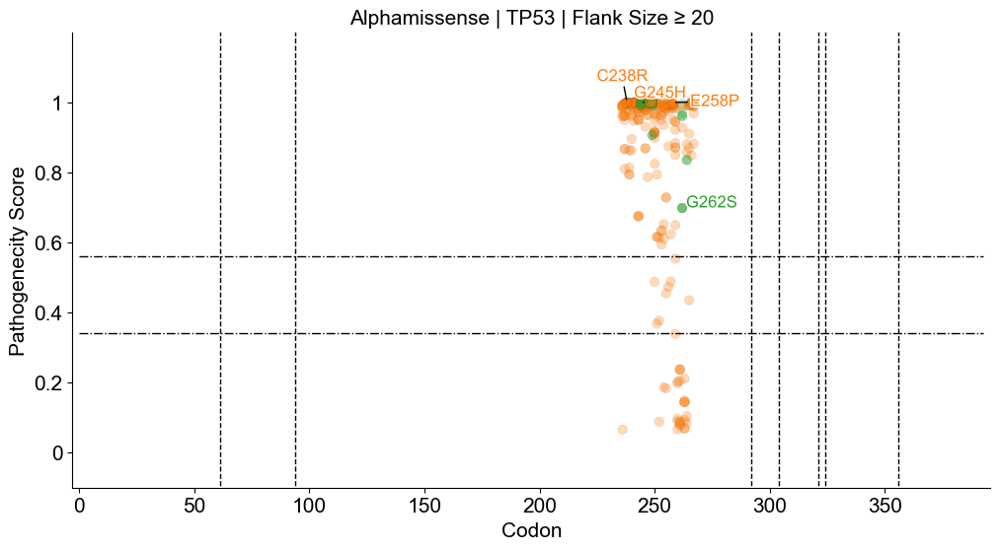

In [37]:
for fs in [0,4,10,15,20]:
    df_merged = df_merged_all[df_merged_all['flank_size'] >= fs].reset_index(drop=True)
    
    gene = 'TP53'

    bbb1 = df_merged[(df_merged['am_pathogenicity'] >= .9997) & (df_merged['status'] == True)]
    bbb2 = df_merged[(df_merged['am_pathogenicity'] <= .045) & (df_merged['status'] == False)]
    bbb3 = df_merged[(df_merged['class'] == 1) & (df_merged['am_pathogenicity'] <= .8) & (df_merged['am_pathogenicity'] >= .6)]
    # top_2 = df_merged['HGVSp_h'].value_counts().index.to_list()[:2]
    # bbb3 = df_merged[df_merged['HGVSp_h'].isin(top_2)]
    bb2 = pd.concat((bbb1, bbb2,bbb3))

    t = list(bb2['HGVSp_h'])
    x = list(bb2['loc_h'])
    y = list(bb2['am_pathogenicity'])
    c = list(bb2['color'])


    fig, ax = plt.subplots(figsize=(12, 6))
    # 绘制散点图
    g = ax.scatter(data=df_merged, x='loc_h', y='am_pathogenicity',  c = 'color', alpha=.3, s=50, edgecolor='black', linewidths=.1)

    # 绘制参考线
    ax.plot([0, 393], [0.56, 0.56], linewidth=1, linestyle='-.', color='black')
    ax.plot([0, 393], [0.34, 0.34], linewidth=1, linestyle='-.', color='black')
    # ax.set_ylim(-6, 6)
    ax.set_xlim(-3, 396)
    ax.set_ylim(-.1, 1.2)
    ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
    ax.set_xlabel("Codon", fontsize=15)
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs}", fontsize=15)
    boundaries = [61, 94, 292, 304, 321, 324, 356]
    for bound in boundaries:
        ax.plot([bound, bound], [-6, 6], linewidth=1, linestyle='dashed', color='black')

    texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
    ax.yaxis.set_ticks([0,.2,.4,.6,.8,1])
    ax.yaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
    adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='x', which='major', labelsize=15)
    plt.show()


    c = list(bb2['color_h2m'])
    fig, ax = plt.subplots(figsize=(12, 6))
    # 绘制散点图
    g = ax.scatter(data=df_merged, x='loc_h', y='am_pathogenicity',  c = 'color_h2m', alpha=.3, s=50, edgecolor='black', linewidths=.1)

    # 绘制参考线
    ax.plot([0, 393], [0.56, 0.56], linewidth=1, linestyle='-.', color='black')
    ax.plot([0, 393], [0.34, 0.34], linewidth=1, linestyle='-.', color='black')
    # ax.set_ylim(-6, 6)
    ax.set_xlim(-3, 396)
    ax.set_ylim(-.1, 1.2)
    ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
    ax.set_xlabel("Codon", fontsize=15)
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs}", fontsize=15)
    boundaries = [61, 94, 292, 304, 321, 324, 356]
    for bound in boundaries:
        ax.plot([bound, bound], [-6, 6], linewidth=1, linestyle='dashed', color='black')

    texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
    ax.yaxis.set_ticks([0,.2,.4,.6,.8,1])
    ax.yaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
    adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='x', which='major', labelsize=15)
    plt.show()

In [ ]:
# 生成文本标签
texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], 
                 path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]



### KIT  

In [402]:
df_p53 = df_am[df_am['uniprot_id']=='P10721'].reset_index(drop=True)
df_p53 = df_p53.drop('uniprot_id',axis=1)
df_p53.columns=['HGVSp_h','am_pathogenicity','am_class']

In [403]:
df_h2m = df_binded[df_binded['gene_name_h']=='KIT'].drop_duplicates(subset='ID_human').reset_index(drop=True)

In [380]:
df_merged_all = df_freq
df_merged_all = df_merged_all[df_merged_all['classification_h'] == 'Missense'].reset_index(drop=True)
df_merged_all['loc_h'] = [search_loc(s) for s in  df_merged_all['HGVSp_h']]
# df_merged_all['color'] = [color_dict[x] for x in df_merged_all['am_class']]
df_merged_all['color_h2m'] = [color_dict_h2m[x] for x in df_merged_all['class']]

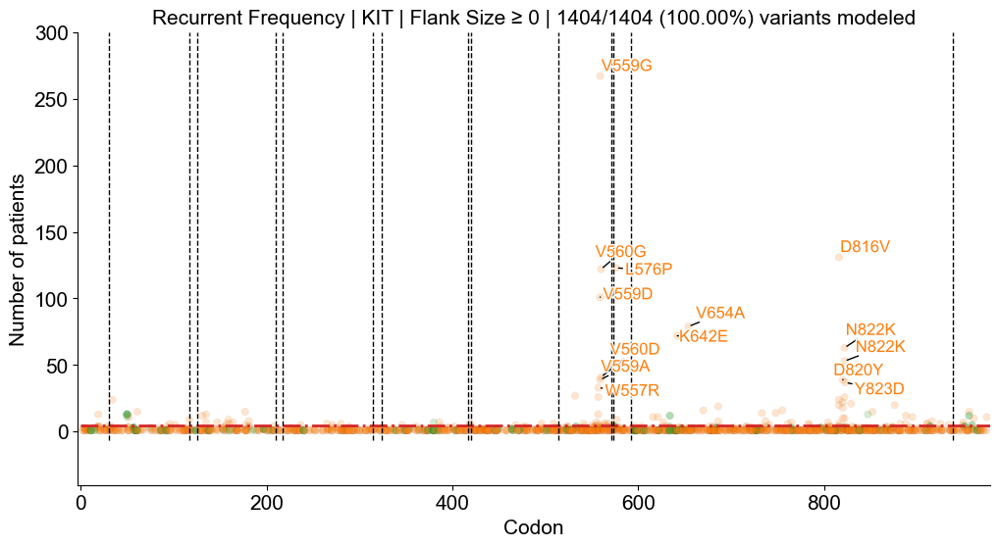

In [401]:
fs = 0
df_merged = df_merged_all[df_merged_all['flank_size'] >= fs].reset_index(drop=True)
gene = 'KIT'
l1 = len(df_merged_all['HGVSp_h'].drop_duplicates())
l2 = len(df_merged[df_merged['status']==True]['HGVSp_h'].drop_duplicates())
percent = 100*l2/l1
bbb1 = df_merged[(df_merged['count'] >= 30) ]

bb2 = bbb1

t = list(bb2['HGVSp_h'])
x = list(bb2['loc_h'])
y = list(bb2['count'])
c= list(bb2['color_h2m'])

fig, ax = plt.subplots(figsize=(12, 6))
# 绘制散点图
g = ax.scatter(data=df_merged, x='loc_h', y='count',  c = 'color_h2m', alpha=.2, s=30, edgecolor='black', linewidths=.1)

# 绘制参考线
ax.plot([0, 979], [5, 5], linewidth=2, linestyle='-.', color='tab:red')
# ax.set_ylim(-6, 6)
ax.set_xlim(-3, 979)
ax.set_ylim(-40, 300)
ax.set_ylabel(f"Number of patients", fontsize=15)
ax.set_xlabel("Codon", fontsize=15)
ax.set_title(f"Recurrent Frequency | {gene} | Flank Size ≥ {fs} | {l2}/{l1} ({percent:.2f}%) variants modeled", fontsize=15)
boundaries = [31,117,126,210,217,315,324,417,420,514,571,573,592,939]
for bound in boundaries:
    ax.plot([bound, bound], [-6, 300], linewidth=1, linestyle='dashed', color='black')

texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]

adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(axis='both', which='major', labelsize=15)
plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/flank_size/kit_h_freq_{fs}_h2m_colored.pdf', bbox_inches='tight')
plt.show()

In [404]:
df_h2m = df_h2m[df_h2m['classification_h'] == 'Missense'].reset_index(drop=True)
df_h2m = df_h2m.drop_duplicates(subset=['gene_name_h',
 'gene_id_h',
 'tx_id_h',
 'chr_h',
 'exon_num_h',
 'strand_h',
 'match',
 'start_h',
 'end_h',
 'ref_seq_h',
 'alt_seq_h',
 'HGVSc_h',
 'HGVSp_h',
 'classification_h',
 'exon_h',
 'type_h',
 'status',
 'class',
 'statement',
 'flank_size_left',
 'flank_size_right',
 'gene_name_m',
 'gene_id_m',
 'tx_id_m',
 'chr_m',
 'exon_num_m',
 'strand_m',
 'type_m',
 'classification_m',
 'exon_m',
 'start_m_ori',
 'end_m_ori',
 'ref_seq_m_ori',
 'alt_seq_m_ori',
 'HGVSc_m_ori',
 'HGVSp_m_ori',
 'start_m',
 'end_m',
 'ref_seq_m',
 'alt_seq_m',
 'HGVSc_m',
 'HGVSp_m',
 'flank_size'])

In [405]:
df_merged_all = pd.merge(df_h2m, df_p53, how='left').dropna(subset='am_class').reset_index(drop=True)

In [406]:
def search_loc(s):
    match = re.search(r'(\d+)', s)
    if match:
        number = match.group(1)
        return int(number)
    else:
        return None
    
df_merged_all['loc_h'] = [search_loc(s) for s in  df_merged_all['HGVSp_h']]

In [407]:
df_merged_all['color'] = [color_dict[x] for x in df_merged_all['am_class']]
df_merged_all['color_h2m'] = [color_dict_h2m[x] for x in df_merged_all['class']]

In [453]:
t = ['IG','Trans-/Juxta-membrane','Kinase']
def get_class_region(x):
    t = ['IG','Trans-/Juxta-membrane','Kinase']
    if x <= 507:
        return t[0]
    elif x<= 589:
        return t[1]
    else:
        return t[2]
df_merged_all['region'] = [get_class_region(x) for x in df_merged_all['loc_h']]
color_dict_region = dict(zip(t, ['tab:green','tab:orange','tab:purple']))
df_merged_all['color_region'] = [color_dict_region[x] for x in df_merged_all['region']]

In [455]:

list_group, list_percentage, list_fs = [],[],[]
for fs in range(119):
    for group in t:
        list_fs.append(fs)
        list_group.append(group)
        df_merged_temp = df_merged_all[df_merged_all['region'] == group].reset_index(drop=True)
        df_merged = df_merged_temp[df_merged_temp['flank_size'] >= fs].reset_index(drop=True)
        l1 = len(df_merged_temp['HGVSp_h'].drop_duplicates())
        l2 = len(df_merged[df_merged['status']==True]['HGVSp_h'].drop_duplicates())
        percent = 100*l2/l1
        list_percentage.append(percent)
df_to_plot = pd.DataFrame(zip(list_group, list_percentage, list_fs),columns=['region', 'percent','fs'])

In [457]:
df_to_plot.to_csv('/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/flank_size/line_plot.csv',index=False)

In [459]:
df_to_plot['color'] = [color_dict_region[x] for x in df_to_plot['region']]

#### line plot

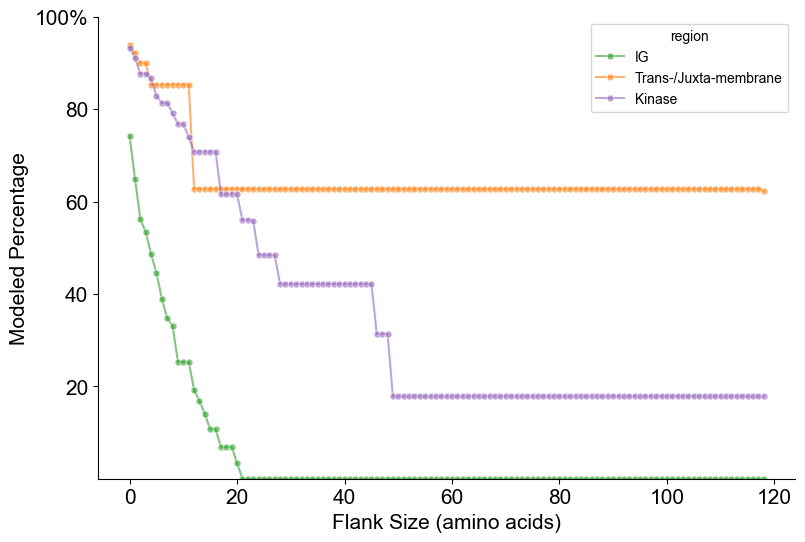

In [487]:
fig, ax = plt.subplots(figsize=(9, 6), ncols=1, nrows=1)
sns.lineplot(x='fs',
             y='percent',
             hue='region', # Create 2 line plots according to labels in 'z'
             data=df_to_plot,
             marker='o', # Style used to mark the join between 2 points
             palette=color_dict_region,
             markersize=5,
             ax = ax,
             alpha=.6
            )
ax.set_ylim(0, 100)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(axis='x', which='major', labelsize=15)
ax.yaxis.set_ticks([20,40,60,80,100])
ax.yaxis.set_ticklabels(['20','40','60','80','100%'], size=15, fontweight=100)
ax.set_ylabel(f"Modeled Percentage", fontsize=15)
ax.set_xlabel("Flank Size (amino acids)", fontsize=15)
plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/flank_size/line.pdf', bbox_inches='tight')
plt.show() # Display the graph

In [489]:
df_merged_all

,gene_name_h,gene_id_h,tx_id_h,chr_h,exon_num_h,strand_h,match,start_h,end_h,ref_seq_h,...,be_mouse,expanded,flank_size,am_pathogenicity,am_class,loc_h,color,color_h2m,region,color_region
0,KIT,ENSG00000157404.11,ENST00000288135.5,chr4,21,+,True,55593613,55593614,TT,...,False,False,118,0.9715,pathogenic,560,darkred,tab:orange,Trans-/Juxta-membrane,tab:orange
1,KIT,ENSG00000157404.11,ENST00000288135.5,chr4,21,+,True,55595518,55595519,AC,...,False,False,27,0.9981,pathogenic,670,darkred,tab:orange,Kinase,tab:purple
2,KIT,ENSG00000157404.11,ENST00000288135.5,chr4,21,+,True,55599321,55599322,AC,...,False,False,48,0.9989,pathogenic,816,darkred,tab:orange,Kinase,tab:purple
3,KIT,ENSG00000157404.11,ENST00000288135.5,chr4,21,+,True,55603375,55603376,CC,...,False,False,16,0.9325,pathogenic,911,darkred,tab:orange,Kinase,tab:purple
4,KIT,ENSG00000157404.11,ENST00000288135.5,chr4,21,+,True,55593384,55593385,AG,...,False,False,11,0.1330,benign,514,darkblue,tab:orange,Trans-/Juxta-membrane,tab:orange
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2719,KIT,ENSG00000157404.11,ENST00000288135.5,chr4,21,+,True,55594233,55594235,TAC,...,False,False,118,0.9906,pathogenic,646,darkred,tab:orange,Kinase,tab:purple
2720,KIT,ENSG00000157404.11,ENST00000288135.5,chr4,21,+,True,55595518,55595520,ACA,...,False,False,27,0.9642,pathogenic,670,darkred,tab:orange,Kinase,tab:purple
2721,KIT,ENSG00000157404.11,ENST00000288135.5,chr4,21,+,True,55599320,55599322,GAC,...,False,False,48,0.9993,pathogenic,816,darkred,tab:orange,Kinase,tab:purple
2722,KIT,ENSG00000157404.11,ENST00000288135.5,chr4,21,+,True,55593609,55593611,GTT,...,False,False,118,0.9890,pathogenic,559,darkred,tab:orange,Trans-/Juxta-membrane,tab:orange


In [513]:
df_merged_all.to_csv('/Users/kexindong/Documents/GitHub/Output/df_merged_all',index=False)

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04



AttributeError: module 'seaborn.categorical' has no attribute '_BoxPlotter'

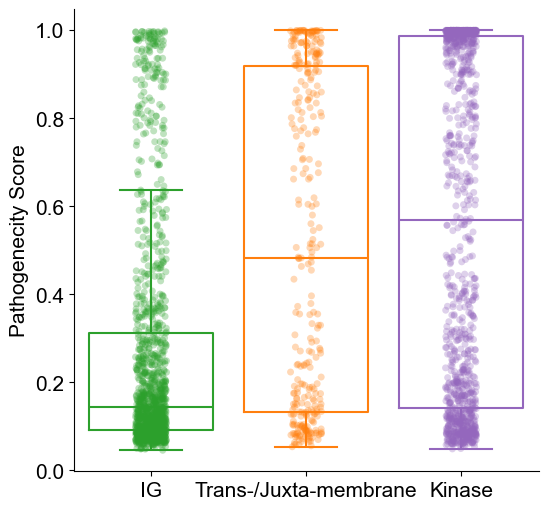

In [514]:
fig, ax = plt.subplots(figsize=(6, 6))
g = sns.boxplot(data=df_merged_all, x='region', y='am_pathogenicity', ax=ax, palette=color_dict_region, order=t,showfliers=False, fill = False)
g1 = sns.stripplot(data=df_merged_all, x='region', y='am_pathogenicity', ax=ax, alpha=.3, palette=color_dict_region)#edgecolor='black', linewidth=.5)
#ax.set_xticklabels(['Mis-\nsense', 'Non-\nsense', 'INS', 'DEL', 'Silent'])
#ax.set_xlabel('')
#ax.set_ylabel('LFC D34-Nutlin', fontsize=15)

ax.tick_params(axis='both', which='major', labelsize=15)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
ax.set_xlabel("", fontsize=15)
statannot.add_stat_annotation(
    ax,
    data=df_merged_all,
    x='region',
    y='am_pathogenicity',
    #hue=hue,
    box_pairs=[
        ((t[0]), (t[1])),
        ((t[0]), (t[2])),
        ((t[1]), (t[2]))
    ],
    test="t-test_ind",
    text_format="star",
    loc="outside",
)
plt.show()

#### human and mouse regions  

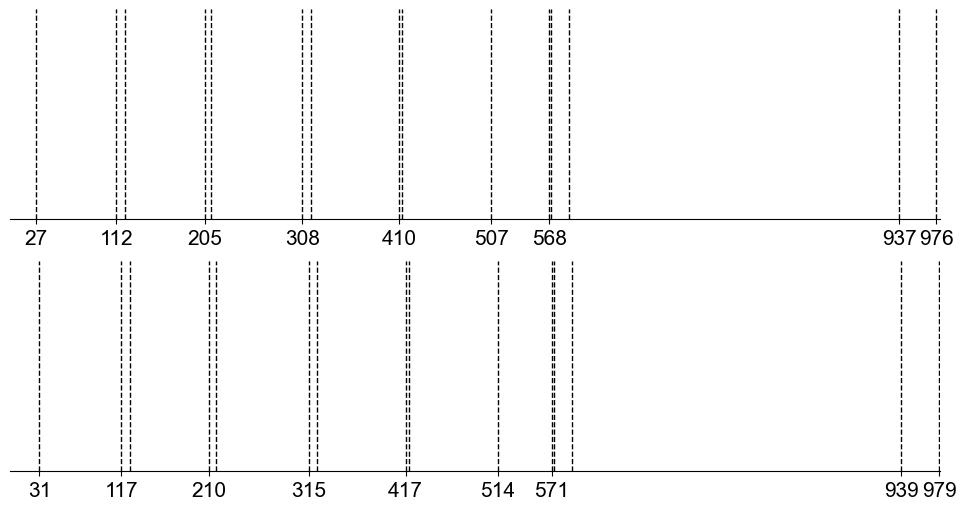

In [473]:
fig, ax = plt.subplots(figsize=(12, 6), ncols=1, nrows=2)
boundaries = [27,112,121,205,212,308,317,410,413,507,568,570,589,937,976]
boundaries_ = [27,112,205,308,410,507,568,937,976]

for bound in boundaries:
    ax[0].plot([bound, bound], [0, 1], linewidth=1, linestyle='dashed', color='black')
ax[0].xaxis.set_ticks(boundaries_)
ax[0].xaxis.set_ticklabels(boundaries_, size=15, fontweight=100)
ax[0].set_xlim(0, 980)
ax[0].set_ylim(0, 1)
ax[0].spines['top'].set_visible(False)
ax[0].spines['right'].set_visible(False)
ax[0].yaxis.set_ticks([])
ax[0].spines['left'].set_visible(False)
boundaries = [31,117,126,210,217,315,324,417,420,514,571,573,592,939, 979]
for bound in boundaries:
    ax[1].plot([bound, bound], [0, 1], linewidth=1, linestyle='dashed', color='black')
boundaries_ = [31,117,210,315,417,514,571,939, 979]
ax[1].xaxis.set_ticks(boundaries_)
ax[1].xaxis.set_ticklabels(boundaries_, size=15, fontweight=100)
ax[1].set_xlim(0, 980)
ax[1].set_ylim(0, 1)
ax[1].spines['top'].set_visible(False)
ax[1].spines['right'].set_visible(False)
ax[1].spines['left'].set_visible(False)
ax[1].yaxis.set_ticks([])
plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/flank_size/region_h_m.svg', bbox_inches='tight')
plt.show()

In [ ]:
plt.figure(figsize=(8, 6)) # Width and Height of the chart
sns.lineplot(x='x',
             y='y',
             hue='z', # Create 2 line plots according to labels in 'z'
             data=df,
             marker='o', # Style used to mark the join between 2 points
             palette={'Group1':'red',
                      'Group2':'purple'}, # Colors of the lines
            )
plt.xlabel('X-axis') # x-axis name
plt.ylabel('Y-axis') # y-axis name
plt.title('Customized Connected Scatter Plot') # Add a title
plt.show() # Display the graph

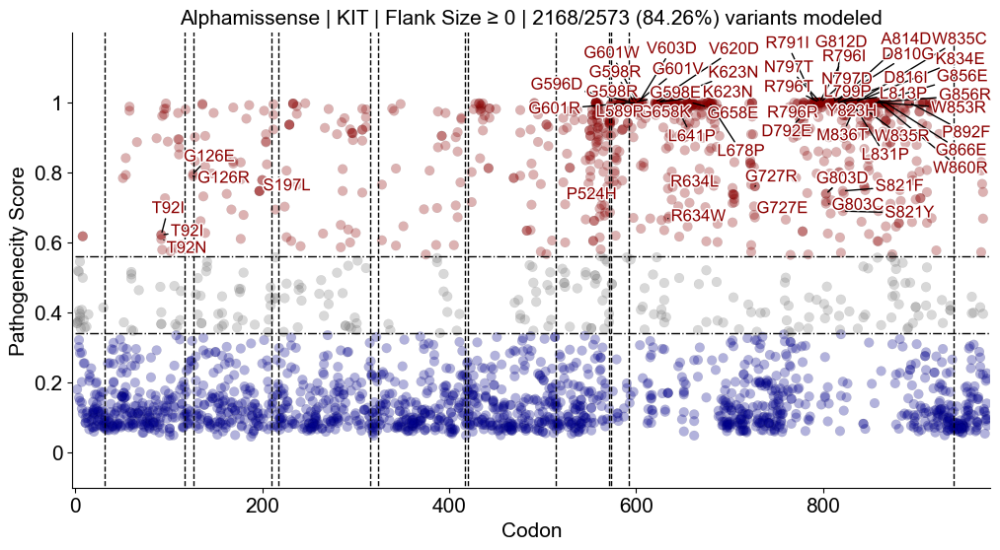

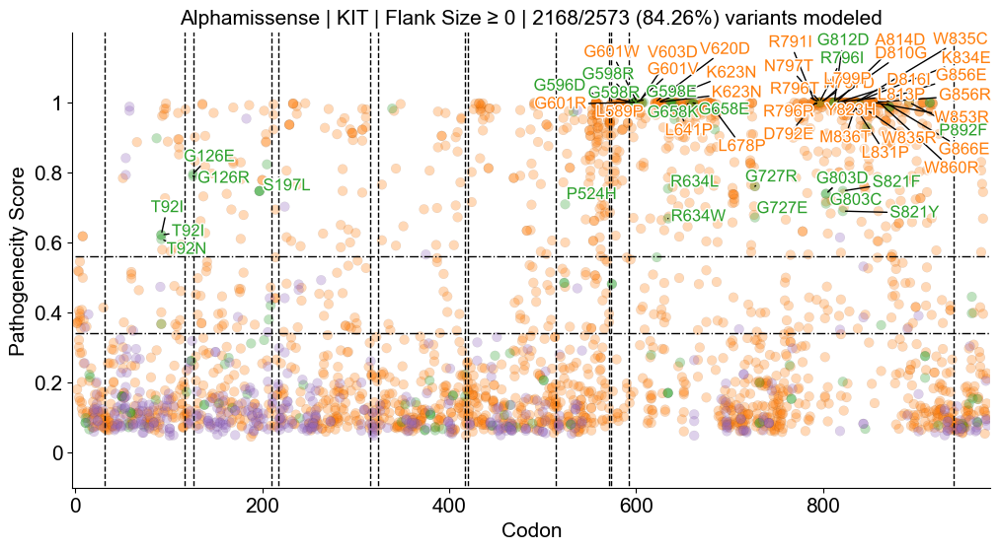

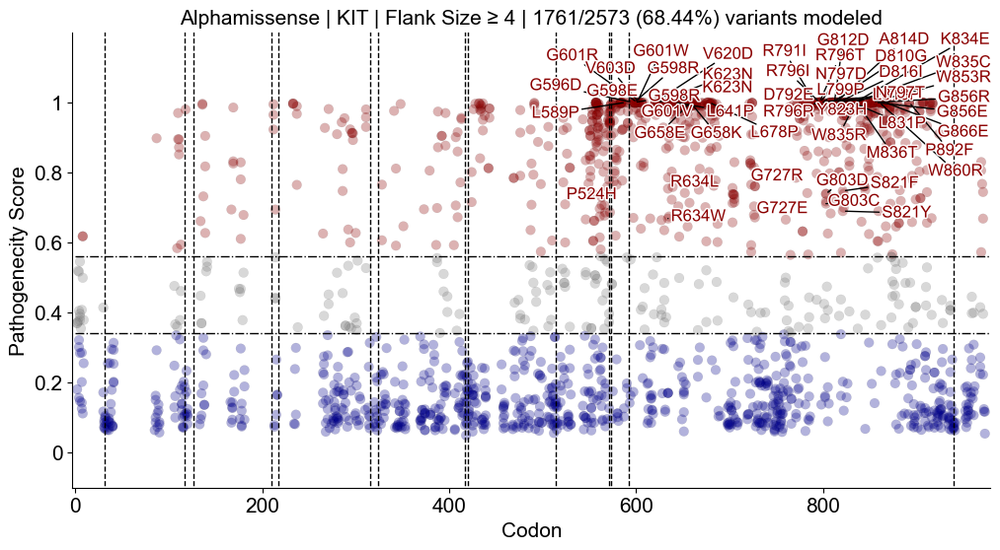

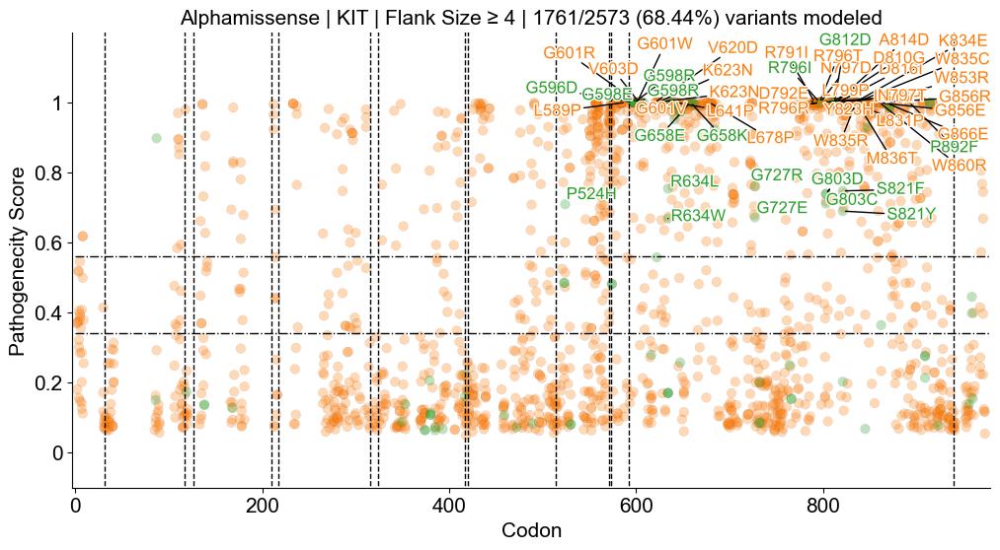

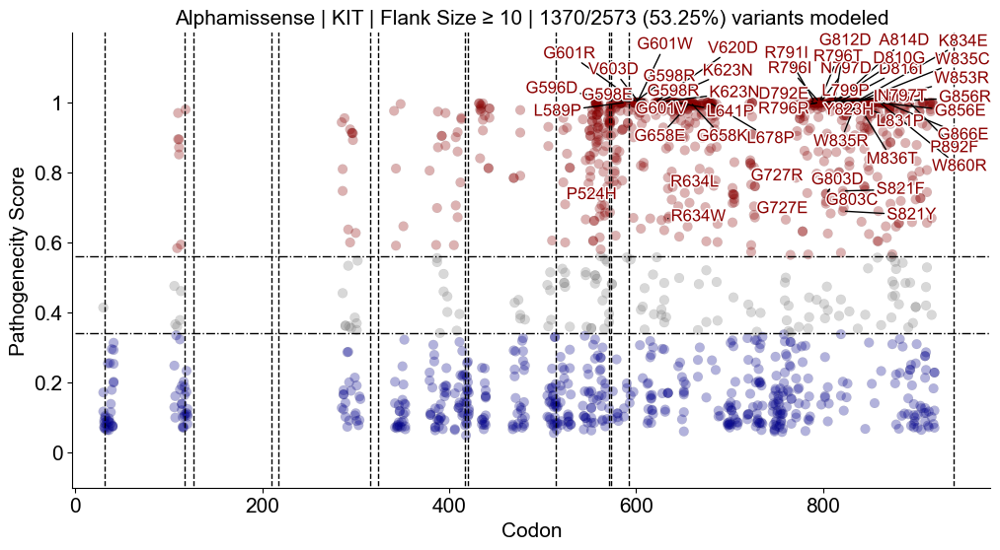

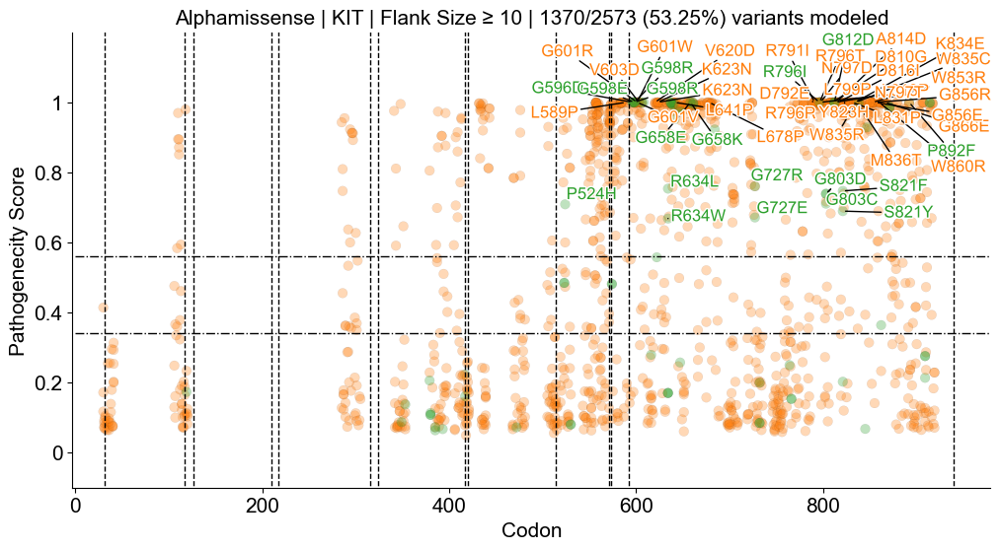

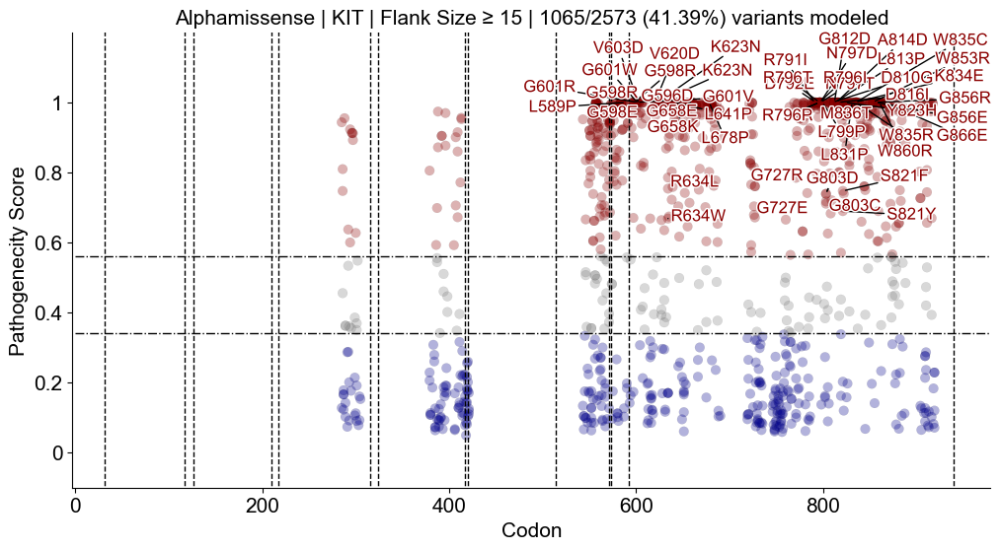

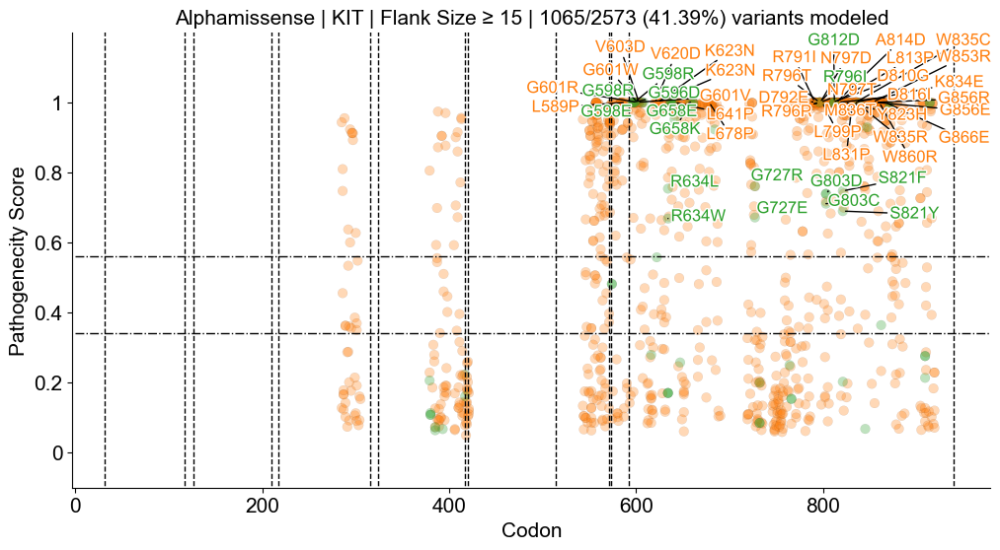

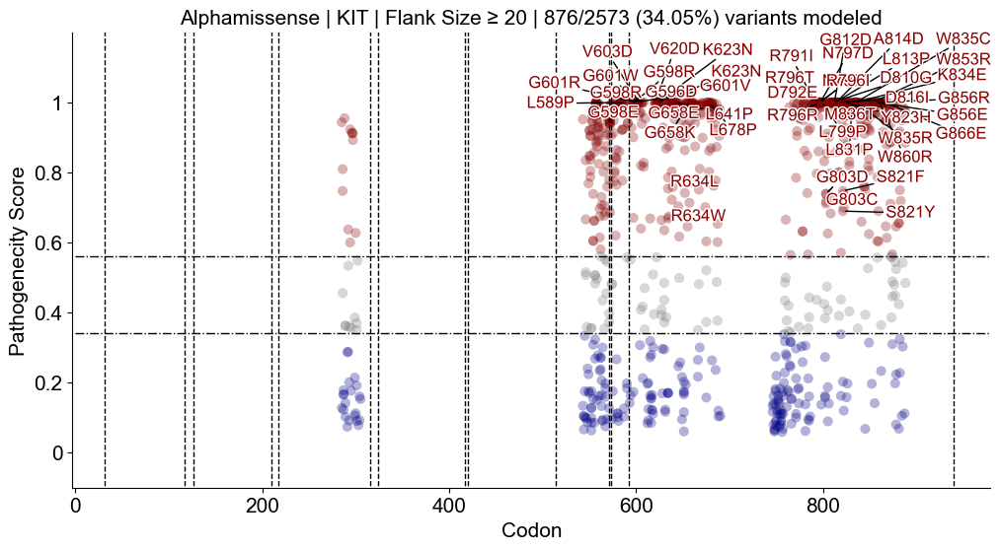

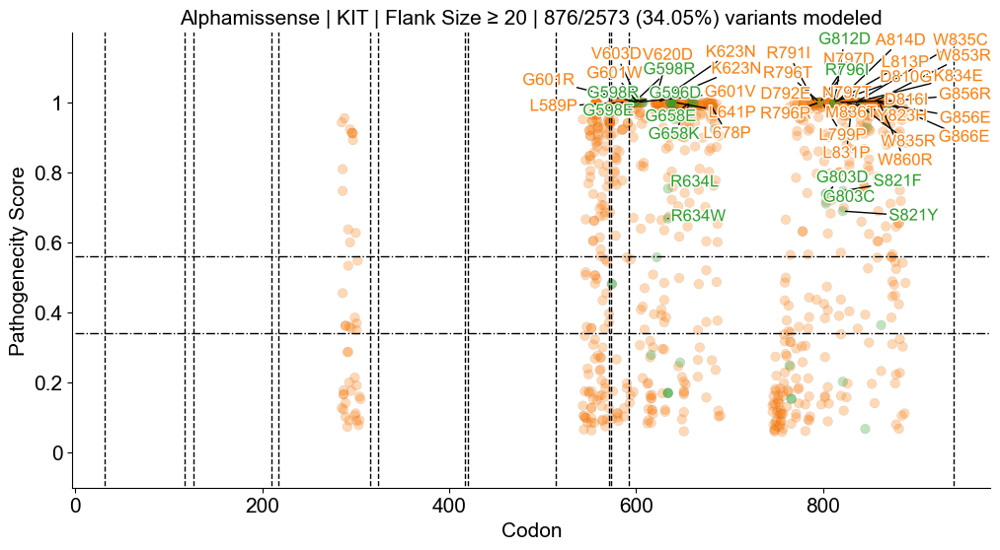

In [360]:
for fs in [0,4,10,15,20]:
    df_merged = df_merged_all[df_merged_all['flank_size'] >= fs].reset_index(drop=True)
    gene = 'KIT'
    l1 = len(df_merged_all['HGVSp_h'].drop_duplicates())
    l2 = len(df_merged[df_merged['status']==True]['HGVSp_h'].drop_duplicates())
    percent = 100*l2/l1
    bbb1 = df_merged[(df_merged['am_pathogenicity'] >= .99984) & (df_merged['status'] == True)]
    bbb2 = df_merged[(df_merged['am_pathogenicity'] <= .045) & (df_merged['status'] == False)]
    bbb3 = df_merged[(df_merged['class'] == 1) & (df_merged['am_pathogenicity'] <= .8) & (df_merged['am_pathogenicity'] >= .6)]
    # top_2 = df_merged['HGVSp_h'].value_counts().index.to_list()[:2]
    # bbb3 = df_merged[df_merged['HGVSp_h'].isin(top_2)]
    bb2 = pd.concat((bbb1, bbb2,bbb3))

    t = list(bb2['HGVSp_h'])
    x = list(bb2['loc_h'])
    y = list(bb2['am_pathogenicity'])
    c = list(bb2['color'])

    t = list(bb2['HGVSp_h'])
    x = list(bb2['loc_h'])
    y = list(bb2['am_pathogenicity'])
    c = list(bb2['color'])


    fig, ax = plt.subplots(figsize=(12, 6))
    # 绘制散点图
    g = ax.scatter(data=df_merged, x='loc_h', y='am_pathogenicity',  c = 'color', alpha=.3, s=50, edgecolor='black', linewidths=.1)

    # 绘制参考线
    ax.plot([0, 979], [0.56, 0.56], linewidth=1, linestyle='-.', color='black')
    ax.plot([0, 979], [0.34, 0.34], linewidth=1, linestyle='-.', color='black')
    # ax.set_ylim(-6, 6)
    ax.set_xlim(-3, 979)
    ax.set_ylim(-.1, 1.2)
    ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
    ax.set_xlabel("Codon", fontsize=15)
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs} | {l2}/{l1} ({percent:.2f}%) variants modeled", fontsize=15)
    boundaries = [31,117,126,210,217,315,324,417,420,514,571,573,592,939]
    for bound in boundaries:
        ax.plot([bound, bound], [-6, 6], linewidth=1, linestyle='dashed', color='black')

    texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
    ax.yaxis.set_ticks([0,.2,.4,.6,.8,1])
    ax.yaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
    adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='x', which='major', labelsize=15)
    plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/flank_size/kit_h_fs_{fs}_af_colored.pdf', bbox_inches='tight')
    plt.show()


    c = list(bb2['color_h2m'])

    fig, ax = plt.subplots(figsize=(12, 6))
    # 绘制散点图
    g = ax.scatter(data=df_merged, x='loc_h', y='am_pathogenicity',  c = 'color_h2m', alpha=.3, s=50, edgecolor='black', linewidths=.1)

    # 绘制参考线
    ax.plot([0, 979], [0.56, 0.56], linewidth=1, linestyle='-.', color='black')
    ax.plot([0, 979], [0.34, 0.34], linewidth=1, linestyle='-.', color='black')
    # ax.set_ylim(-6, 6)
    ax.set_xlim(-3, 979)
    ax.set_ylim(-.1, 1.2)
    ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
    ax.set_xlabel("Codon", fontsize=15)
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs} | {l2}/{l1} ({percent:.2f}%) variants modeled", fontsize=15)
    boundaries = [31,117,126,210,217,315,324,417,420,514,571,573,592,939]
    for bound in boundaries:
        ax.plot([bound, bound], [-6, 6], linewidth=1, linestyle='dashed', color='black')

    texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
    ax.yaxis.set_ticks([0,.2,.4,.6,.8,1])
    ax.yaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
    adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='x', which='major', labelsize=15)
    plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/flank_size/kit_h_fs_{fs}_h2m_colored.pdf', bbox_inches='tight')
    plt.show()

In [332]:
sift_m = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/h2m_database/SIFT/sift_m.txt',sep='\t', comment = '#')
sift_h = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/h2m_database/SIFT/sift_h.txt',sep='\t', comment = '#')

In [208]:
import seaborn as sns

In [333]:
sift_m_result = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/h2m_database/SIFT/sift_m_SIFT_kit.csv')
sift_m.columns = ['CHROM',	'start_m',	'ID_human',	'ref_seq_m',	'alt_seq_m',	'QUAL',	'FILTER',	'INFO',	'FORMAT',	'MP96-Ripoll-MRC-Harwell']
sift_h.columns = ['CHROM',	'start_h',	'ID_human',	'ref_seq_h',	'alt_seq_h',	'QUAL',	'FILTER',	'INFO',	'FORMAT',	'MP96-Ripoll-MRC-Harwell']
# df_binded = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/h2m_database/database-output-final/df_result_cleaned_v3.csv')
sub_result_m = sift_m_result[['POS','REF_ALLELE','ALT_ALLELE','SIFT_SCORE','SIFT_PREDICTION']]
sub_result_m.columns = ['start_m','ref_seq_m','alt_seq_m','SIFT_SCORE','SIFT_PREDICTION']
sub_result_m = pd.merge(sift_m,sub_result_m, how='outer',on = ['start_m','ref_seq_m','alt_seq_m'])

In [334]:
sift_h_result = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/h2m_database/SIFT/sift_h_SIFT_kit.csv')
sub_result_h = sift_h_result[['POS','REF_ALLELE','ALT_ALLELE','SIFT_SCORE','SIFT_PREDICTION']]
sub_result_h.columns = ['start_h','ref_seq_h','alt_seq_h','SIFT_SCORE','SIFT_PREDICTION']
sift_h_result = pd.merge(sift_h,sub_result_h, how='outer',on = ['start_h','ref_seq_h','alt_seq_h'])

sift_h_result_plot = sift_h_result[['ID_human','SIFT_SCORE','SIFT_PREDICTION']]
sift_h_result_plot.columns = ['ID_human','SIFT_SCORE_h','SIFT_PREDICTION_h']
sift_m_result_plot = sub_result_m[['ID_human','SIFT_SCORE','SIFT_PREDICTION']]
sift_m_result_plot.columns = ['ID_human','SIFT_SCORE_m','SIFT_PREDICTION_m']

In [335]:
df_SIFT_kit = pd.merge(sift_h_result_plot, sift_m_result_plot, on = 'ID_human').dropna()
df_kit = df_binded[(df_binded['gene_name_h']=='KIT') & (df_binded['status']==True) & (df_binded['type_h']=='SNP') & (df_binded['Database']=='AACR')]
del df_binded

In [362]:
df_kit = df_binded[(df_binded['gene_name_h']=='KIT') & (df_binded['status']==True) & (df_binded['type_h']=='SNP') & (df_binded['Database']=='AACR')]

In [364]:
df_kit['HGVSp_h'].value_counts()

1808200          D876N
1808201          D816H
1808202          R686C
1808203          D820G
1808204          T670I
              ...     
1812888            NaN
1812889    X112_splice
1813478            NaN
1813479            NaN
1813480            NaN
Name: HGVSp_h, Length: 2067, dtype: object

In [368]:
df_input_sub = df_input[(df_input['gene_name_h']=='KIT')]
df_freq = pd.merge(df_input_sub, df_kit, on='ID_human', how = 'left')

In [371]:
df_input_sub = df_input_sub[['count','ID']]
df_input_sub.columns = ['count','ID_human']

In [336]:
df_input = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/h2m_database/aacr_input_original.csv')
df_input_sub = df_input[(df_input['gene_name_h']=='KIT') & (df_input['count']>=5)]
df_kit = df_kit[df_kit['ID_human'].isin(df_input_sub['ID'])]
df_kit = df_kit.reset_index(drop=True)

In [337]:
df_SIFT_kit = pd.merge(df_SIFT_kit, df_kit[['ID_human','HGVSp_h','HGVSp_m','class']], on = 'ID_human').drop_duplicates()
df_SIFT_kit = pd.merge(df_SIFT_kit, df_kit[['ID_human','flank_size_left','flank_size_right']], on = 'ID_human').drop_duplicates()
df_SIFT_kit['flank_size'] = [1+int(x[:-2])+int(y[:-2]) for x,y in zip(df_SIFT_kit['flank_size_left'], df_SIFT_kit['flank_size_right'])]
df_SIFT_kit = pd.merge(df_SIFT_kit, df_kit[['ID_human','classification_h']], on = 'ID_human').drop_duplicates()
df_SIFT_kit = df_SIFT_kit[df_SIFT_kit['classification_h']!='Silent']

In [338]:
df_SIFT_kit['SIFT_PREDICTION_h'].value_counts()

SIFT_PREDICTION_h
DELETERIOUS    55
TOLERATED      42
Name: count, dtype: int64

In [339]:
color_dict = color_dict.update({
    'DELETERIOUS':'darkred',
    'TOLERATED':'tab:blue'
})

In [529]:
df_h2m = df_SIFT_kit

In [531]:
import matplotlib.colors as mcolors
import numpy as np

# Define the initial color dictionary
color_dict = {
    'DELETERIOUS':'darkred',
    'TOLERATED':'tab:blue'
}

# Function to blend two colors
def blend_colors(color1, color2):
    # Convert color names to RGBA
    rgb1 = np.array(mcolors.to_rgb(color1))
    rgb2 = np.array(mcolors.to_rgb(color2))
    # Calculate the average of the RGB components
    blended_rgb = (rgb1 + rgb2) / 2
    # Convert the blended RGB back to hex color code
    return mcolors.to_hex(blended_rgb)

# Create a combined color dictionary
combined_color_dict = {}
for key1 in color_dict:
    for key2 in color_dict:
        # Blend each pair of colors
        combined_color_dict[(key1, key2)] = blend_colors(color_dict[key1], color_dict[key2])

In [532]:
df_h2m['color_class'] = [color_dict_h2m[x] for x in df_h2m['class']]
df_h2m['color_score'] = df_h2m.apply(lambda row: combined_color_dict[(row['SIFT_PREDICTION_h'], row['SIFT_PREDICTION_m'])], axis=1)
df_h2m['loc_h'] = [search_loc(s) for s in  df_h2m['HGVSp_h']]
df_h2m['loc_m'] = [search_loc(s) for s in  df_h2m['HGVSp_m']]
df_h2m['color_h2m_h'] = [color_dict[x] for x in df_h2m['SIFT_PREDICTION_h']]
df_h2m['color_h2m_m'] = [color_dict[x] for x in df_h2m['SIFT_PREDICTION_m']]

In [533]:
import scipy.stats

In [535]:
corr, p_value = scipy.stats.spearmanr(df_h2m['SIFT_SCORE_h'], df_h2m['SIFT_SCORE_m'])

print("Spearman Correlation Coefficient: {:.4f}".format(corr))
print("P-value: {:.4f}".format(p_value))

Spearman Correlation Coefficient: 0.9679
P-value: 0.0000


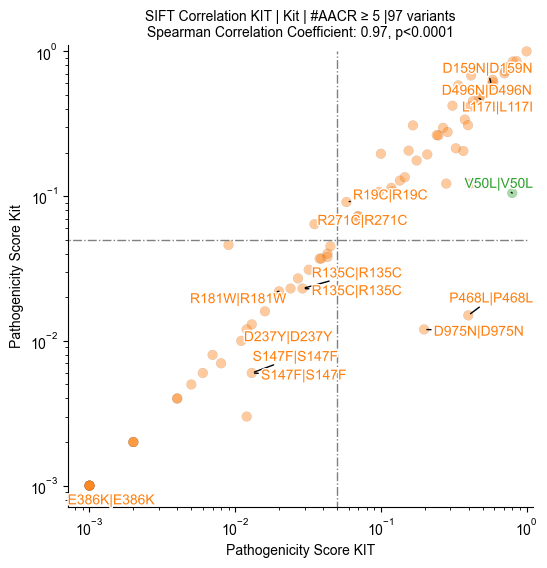

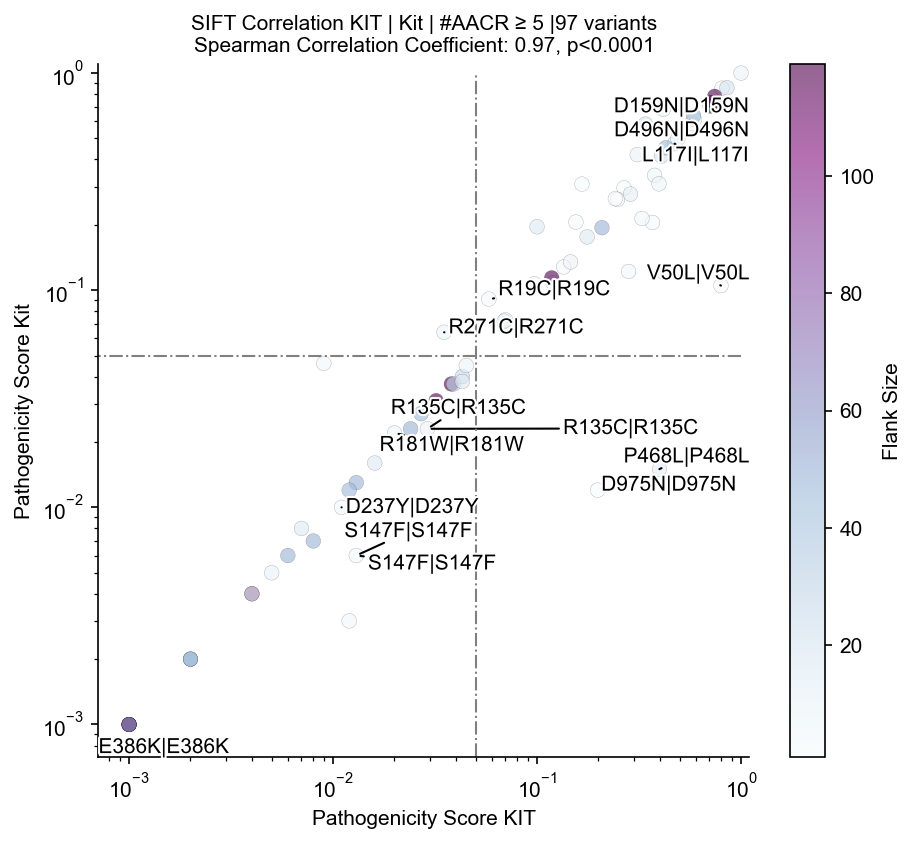

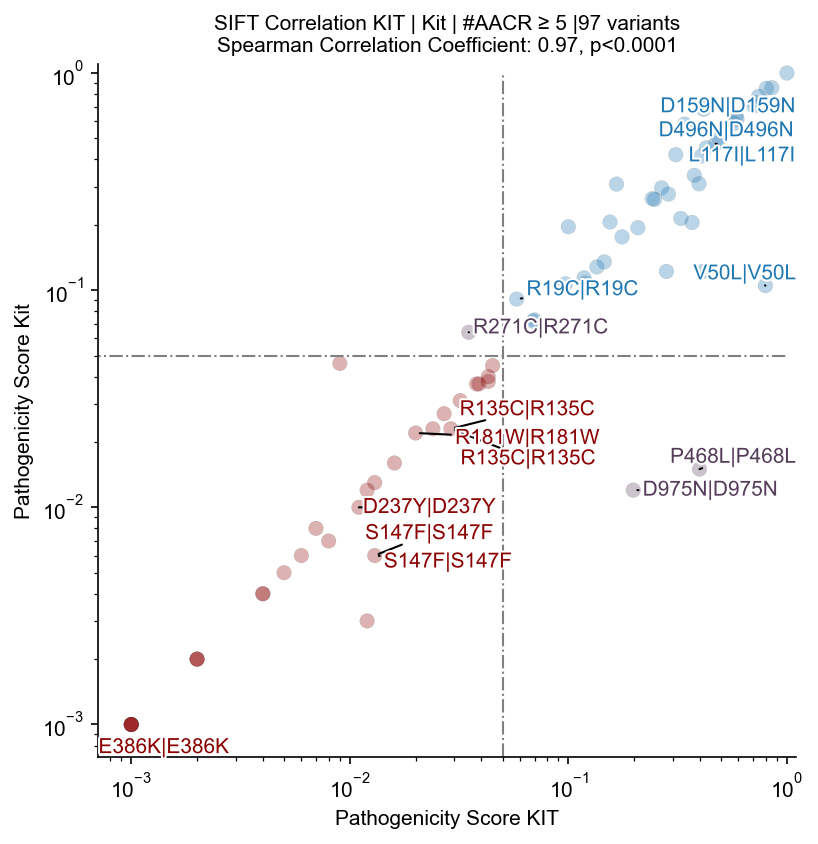

In [536]:
fig, ax = plt.subplots(figsize=(6, 6))
gene_1 = 'KIT'
gene_2 = 'Kit'

bbb1 = df_h2m[(df_h2m['SIFT_SCORE_h'] <= 0.05) & (df_h2m['SIFT_SCORE_m']<=.05)].iloc[:5,:]
bbb2 = df_h2m[(df_h2m['SIFT_SCORE_h'] >= .4) & (df_h2m['SIFT_SCORE_m'] <= .6) & (df_h2m['SIFT_SCORE_m'] <= .6) & (df_h2m['SIFT_SCORE_m'] >= .4)].iloc[:3,:]
bbb3 = df_h2m[(df_h2m['SIFT_SCORE_h'] <= .097) & (df_h2m['SIFT_SCORE_m'] <= .097) ].iloc[:3,:]
bbb4 = df_h2m[(df_h2m['SIFT_SCORE_h'] <= 0.05) & (df_h2m['SIFT_SCORE_m'] >= .05) ].iloc[:3,:]
bbb5 = df_h2m[(df_h2m['SIFT_SCORE_h'] >= 0.05) & (df_h2m['SIFT_SCORE_m'] <= 0.05) ].iloc[:3,:]
bbb6 = df_h2m[df_h2m['class']==1]

bb2 = pd.concat((bbb1, bbb2,bbb3, bbb4, bbb5,bbb6))

t = [f'{x}|{y}' for x,y in zip(bb2['HGVSp_h'], bb2['HGVSp_h'])]
x = list(bb2['SIFT_SCORE_h'])
y = list(bb2['SIFT_SCORE_m'])
c = list(bb2['color_class'])


ax.plot([0, 1], [0.05, 0.05], linewidth=1, linestyle='-.', color='grey')
ax.plot( [0.05, 0.05], [0, 1],linewidth=1, linestyle='-.', color='grey')

plt.xscale('log')
plt.yscale('log')
# ax.plot( [0,1], [0, 1],linewidth=1, linestyle='-', color='grey')
ax.scatter(data=df_h2m, x='SIFT_SCORE_h', y='SIFT_SCORE_m', c = 'color_class', alpha=.4, s=50, edgecolor='black', linewidths=.1)

ax.set_xlim(-.03, 1.1)
ax.set_ylim(-.03, 1.1)
ax.set_ylabel(f"Pathogenicity Score {gene_2}", fontsize=10)
ax.set_xlabel(f"Pathogenicity Score {gene_1}", fontsize=10)
ax.set_title(f"SIFT Correlation {gene_1} | {gene_2} | #AACR ≥ 5 |{len(df_h2m)} variants\nSpearman Correlation Coefficient: {corr:.2f}, p<0.0001", fontsize=10)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(axis='both', which='major', labelsize=10)
texts = [ax.text(x[i], y[i], t[i], fontsize=10, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/flank_size/kit_sift_h2m_colored.pdf', bbox_inches='tight')
plt.show()


fig, ax = plt.subplots(figsize=(7, 6), dpi=150)

ax.plot([0, 1], [0.05, 0.05], linewidth=1, linestyle='-.', color='grey')
ax.plot( [0.05, 0.05], [0, 1],linewidth=1, linestyle='-.', color='grey')

# ax.plot( [0,1], [0, 1],linewidth=1, linestyle='-', color='grey')
g = ax.scatter(data=df_h2m, x='SIFT_SCORE_h', y='SIFT_SCORE_m', c = 'flank_size', alpha=.6, s=50, edgecolor='black', linewidths=.1, 
            cmap = plt.cm.BuPu)
plt.colorbar(g, label='Flank Size')

plt.xscale('log')
plt.yscale('log')
ax.set_xlim(-.03, 1.1) 
ax.set_ylim(-.03, 1.1)
ax.set_ylabel(f"Pathogenicity Score {gene_2}", fontsize=10)
ax.set_xlabel(f"Pathogenicity Score {gene_1}", fontsize=10)
ax.set_title(f"SIFT Correlation {gene_1} | {gene_2} | #AACR ≥ 5 |{len(df_h2m)} variants\nSpearman Correlation Coefficient: {corr:.2f}, p<0.0001", fontsize=10)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(axis='both', which='major', labelsize=10)
texts = [ax.text(x[i], y[i], t[i], fontsize=10, color='black', path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/flank_size/kit_sift_flank_colored.pdf', bbox_inches='tight')
plt.show()


fig, ax = plt.subplots(figsize=(6, 6), dpi=150)

ax.plot([0, 1], [0.05, 0.05], linewidth=1, linestyle='-.', color='grey')
ax.plot( [0.05, 0.05], [0, 1],linewidth=1, linestyle='-.', color='grey')

c = list(bb2['color_score'])
# ax.plot( [0,1], [0, 1],linewidth=1, linestyle='-', color='grey')
ax.scatter(data=df_h2m, x='SIFT_SCORE_h', y='SIFT_SCORE_m', c = 'color_score', alpha=.3, s=50, edgecolor='black', linewidths=.1)
plt.xscale('log')
plt.yscale('log')
ax.set_xlim(-.03, 1.1)
ax.set_ylim(-.03, 1.1)
ax.set_ylabel(f"Pathogenicity Score {gene_2}", fontsize=10)
ax.set_xlabel(f"Pathogenicity Score {gene_1}", fontsize=10)
ax.set_title(f"SIFT Correlation {gene_1} | {gene_2} | #AACR ≥ 5 |{len(df_h2m)} variants\nSpearman Correlation Coefficient: {corr:.2f}, p<0.0001", fontsize=10)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(axis='both', which='major', labelsize=10)
texts = [ax.text(x[i], y[i], t[i], fontsize=10, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/flank_size/kit_sift_sift_colored.pdf', bbox_inches='tight')
plt.show()

### APC  

In [95]:
df_p53 = df_am[df_am['uniprot_id']=='P25054'].reset_index(drop=True)
df_p53 = df_p53.drop('uniprot_id',axis=1)
df_p53.columns=['HGVSp_h','am_pathogenicity','am_class']

In [96]:
df_h2m = df_binded[df_binded['gene_name_h']=='APC'].drop_duplicates(subset='ID_human').reset_index(drop=True)
df_h2m = df_h2m[df_h2m['classification_h'] == 'Missense'].reset_index(drop=True)
df_h2m = df_h2m.drop_duplicates(subset=['gene_name_h',
 'gene_id_h',
 'tx_id_h',
 'chr_h',
 'exon_num_h',
 'strand_h',
 'match',
 'start_h',
 'end_h',
 'ref_seq_h',
 'alt_seq_h',
 'HGVSc_h',
 'HGVSp_h',
 'classification_h',
 'exon_h',
 'type_h',
 'status',
 'class',
 'statement',
 'flank_size_left',
 'flank_size_right',
 'gene_name_m',
 'gene_id_m',
 'tx_id_m',
 'chr_m',
 'exon_num_m',
 'strand_m',
 'type_m',
 'classification_m',
 'exon_m',
 'start_m_ori',
 'end_m_ori',
 'ref_seq_m_ori',
 'alt_seq_m_ori',
 'HGVSc_m_ori',
 'HGVSp_m_ori',
 'start_m',
 'end_m',
 'ref_seq_m',
 'alt_seq_m',
 'HGVSc_m',
 'HGVSp_m',
 'flank_size'])
df_merged_all = pd.merge(df_h2m, df_p53, how='left').dropna(subset='am_class').reset_index(drop=True)
def search_loc(s):
    match = re.search(r'(\d+)', s)
    if match:
        number = match.group(1)
        return int(number)
    else:
        return None
    
df_merged_all['loc_h'] = [search_loc(s) for s in  df_merged_all['HGVSp_h']]
df_merged_all['color'] = [color_dict[x] for x in df_merged_all['am_class']]
df_merged_all['color_h2m'] = [color_dict_h2m[x] for x in df_merged_all['class']]

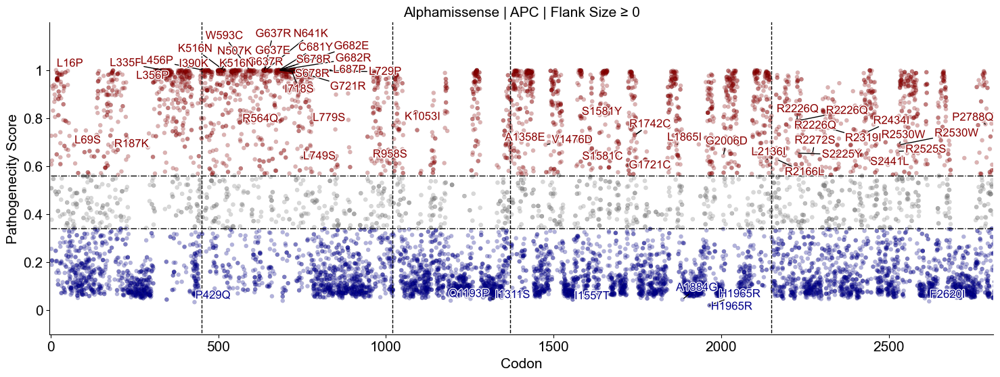

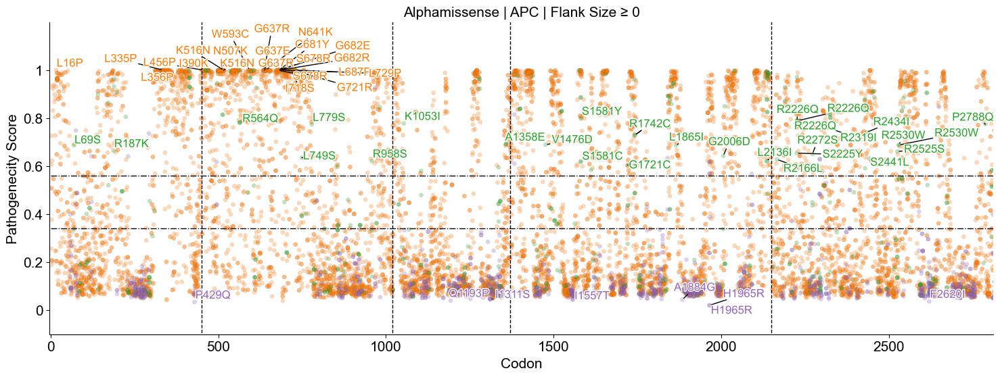

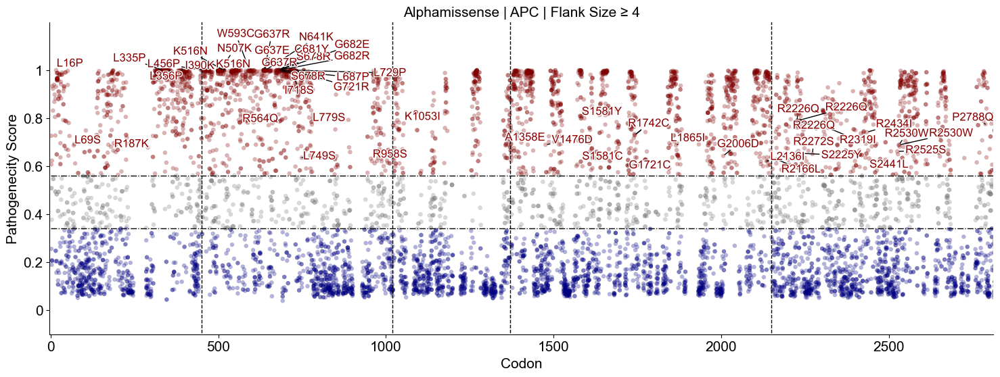

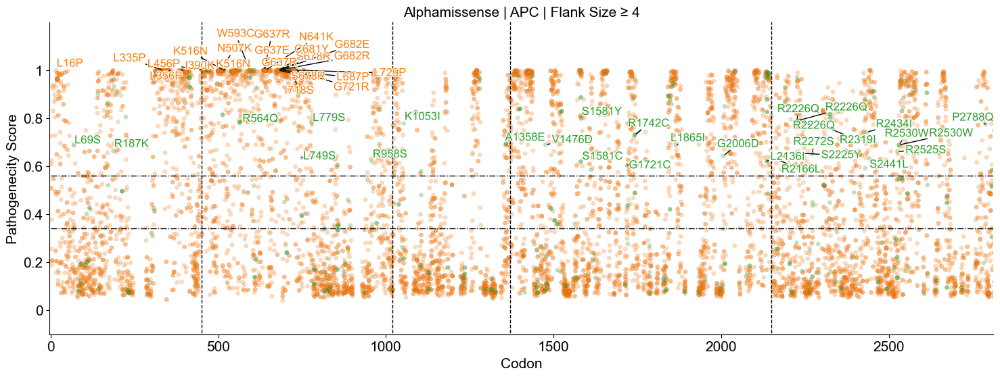

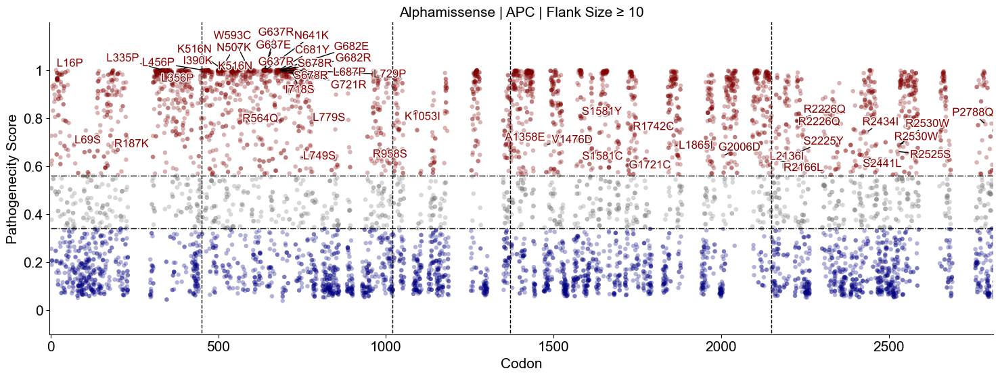

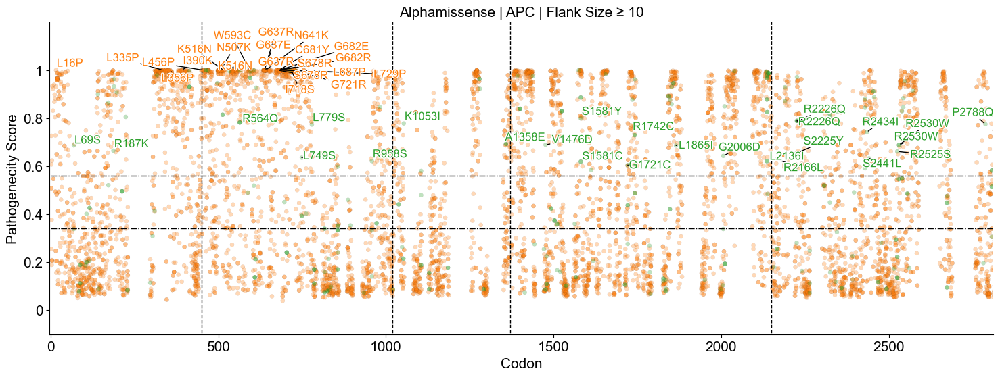

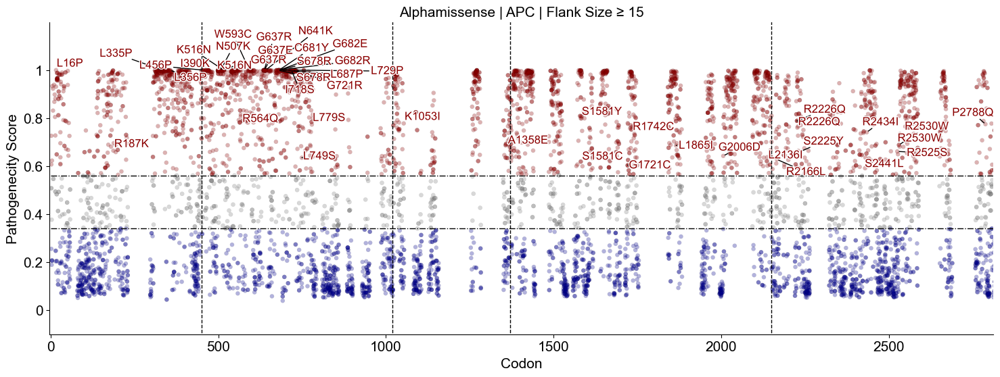

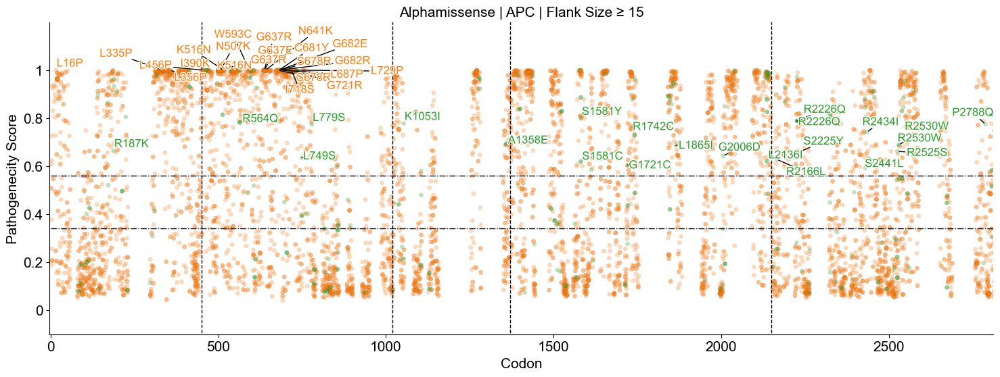

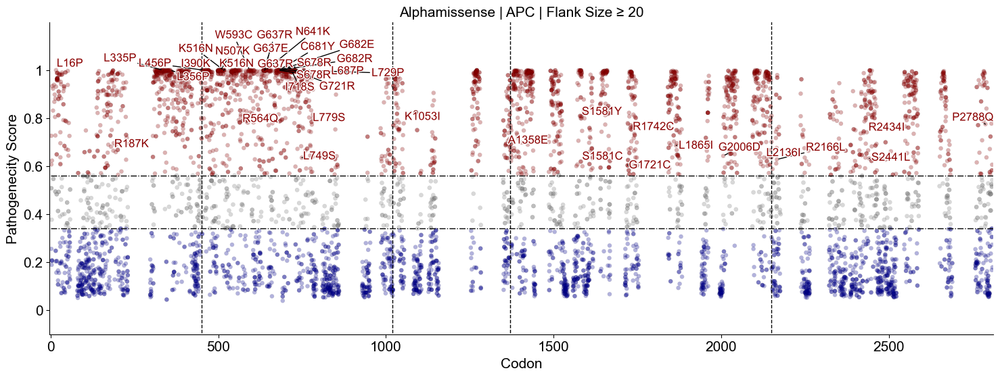

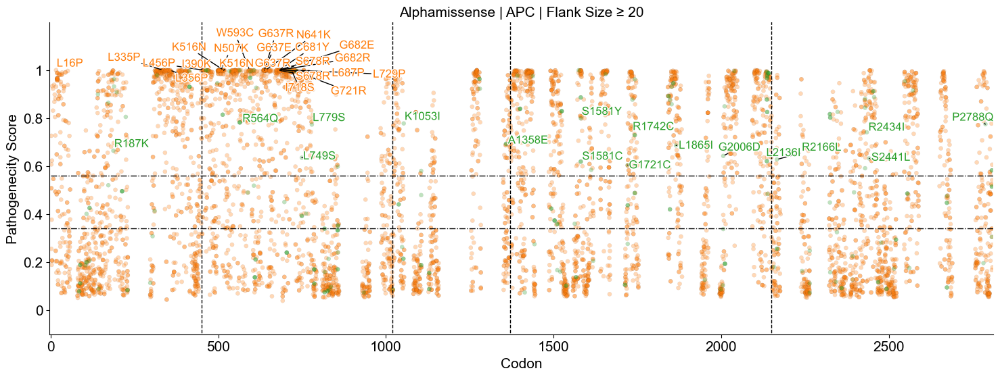

In [98]:
for fs in [0,4,10,15,20]:
    df_merged = df_merged_all[df_merged_all['flank_size'] >= fs].reset_index(drop=True)
    

    gene = 'APC'

    bbb1 = df_merged[(df_merged['am_pathogenicity'] >= .99984) & (df_merged['status'] == True)]
    bbb2 = df_merged[(df_merged['am_pathogenicity'] <= .045) & (df_merged['status'] == False)]
    bbb3 = df_merged[(df_merged['class'] == 1) & (df_merged['am_pathogenicity'] <= .8) & (df_merged['am_pathogenicity'] >= .6)]
    # top_2 = df_merged['HGVSp_h'].value_counts().index.to_list()[:2]
    # bbb3 = df_merged[df_merged['HGVSp_h'].isin(top_2)]
    bb2 = pd.concat((bbb1, bbb2,bbb3))

    t = list(bb2['HGVSp_h'])
    x = list(bb2['loc_h'])
    y = list(bb2['am_pathogenicity'])
    c = list(bb2['color'])

    t = list(bb2['HGVSp_h'])
    x = list(bb2['loc_h'])
    y = list(bb2['am_pathogenicity'])
    c = list(bb2['color'])


    fig, ax = plt.subplots(figsize=(18, 6))
    # 绘制散点图
    g = ax.scatter(data=df_merged, x='loc_h', y='am_pathogenicity',  c = 'color', alpha=.3, s=20, edgecolor='black', linewidths=.1)

    # 绘制参考线
    ax.plot([0, 2812], [0.56, 0.56], linewidth=1, linestyle='-.', color='black')
    ax.plot([0, 2812], [0.34, 0.34], linewidth=1, linestyle='-.', color='black')
    # ax.set_ylim(-6, 6)
    ax.set_xlim(-3, 2812)
    ax.set_ylim(-.1, 1.2)
    ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
    ax.set_xlabel("Codon", fontsize=15)
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs}", fontsize=15)
    boundaries = [451, 1020, 1370, 2150]
    for bound in boundaries:
        ax.plot([bound, bound], [-6, 6], linewidth=1, linestyle='dashed', color='black')

    texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
    ax.yaxis.set_ticks([0,.2,.4,.6,.8,1])
    ax.yaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
    adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='x', which='major', labelsize=15)
    plt.show()


    c = list(bb2['color_h2m'])

    fig, ax = plt.subplots(figsize=(18, 6))
    # 绘制散点图
    g = ax.scatter(data=df_merged, x='loc_h', y='am_pathogenicity',  c = 'color_h2m', alpha=.3, s=20, edgecolor='black', linewidths=.1)

    # 绘制参考线
    ax.plot([0, 2812], [0.56, 0.56], linewidth=1, linestyle='-.', color='black')
    ax.plot([0, 2812], [0.34, 0.34], linewidth=1, linestyle='-.', color='black')
    # ax.set_ylim(-6, 6)
    ax.set_xlim(-3, 2812)
    ax.set_ylim(-.1, 1.2)
    ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
    ax.set_xlabel("Codon", fontsize=15)
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs}", fontsize=15)
    boundaries = [451, 1020, 1370, 2150, 2844]
    for bound in boundaries:
        ax.plot([bound, bound], [-6, 6], linewidth=1, linestyle='dashed', color='black')

    texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
    ax.yaxis.set_ticks([0,.2,.4,.6,.8,1])
    ax.yaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
    adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='x', which='major', labelsize=15)
    plt.show()

In [11]:
df_class_1 = df_binded[(df_binded['class']==1) & (df_binded['classification_h']=='Missense')]

In [17]:
df_view  = df_class_1['gene_name_h'].value_counts()

### ATM   

In [100]:
df_p53 = df_am[df_am['uniprot_id']=='Q13315'].reset_index(drop=True)
df_p53 = df_p53.drop('uniprot_id',axis=1)
df_p53.columns=['HGVSp_h','am_pathogenicity','am_class']
df_h2m = df_binded[df_binded['gene_name_h']=='ATM'].drop_duplicates(subset='ID_human').reset_index(drop=True)
df_h2m = df_h2m[df_h2m['classification_h'] == 'Missense'].reset_index(drop=True)
df_h2m = df_h2m.drop_duplicates(subset=['gene_name_h',
 'gene_id_h',
 'tx_id_h',
 'chr_h',
 'exon_num_h',
 'strand_h',
 'match',
 'start_h',
 'end_h',
 'ref_seq_h',
 'alt_seq_h',
 'HGVSc_h',
 'HGVSp_h',
 'classification_h',
 'exon_h',
 'type_h',
 'status',
 'class',
 'statement',
 'flank_size_left',
 'flank_size_right',
 'gene_name_m',
 'gene_id_m',
 'tx_id_m',
 'chr_m',
 'exon_num_m',
 'strand_m',
 'type_m',
 'classification_m',
 'exon_m',
 'start_m_ori',
 'end_m_ori',
 'ref_seq_m_ori',
 'alt_seq_m_ori',
 'HGVSc_m_ori',
 'HGVSp_m_ori',
 'start_m',
 'end_m',
 'ref_seq_m',
 'alt_seq_m',
 'HGVSc_m',
 'HGVSp_m',
 'flank_size'])
df_merged_all = pd.merge(df_h2m, df_p53, how='left').dropna(subset='am_class').reset_index(drop=True)
def search_loc(s):
    match = re.search(r'(\d+)', s)
    if match:
        number = match.group(1)
        return int(number)
    else:
        return None
    
df_merged_all['loc_h'] = [search_loc(s) for s in  df_merged_all['HGVSp_h']]
df_merged_all['color'] = [color_dict[x] for x in df_merged_all['am_class']]
df_merged_all['color_h2m'] = [color_dict_h2m[x] for x in df_merged_all['class']]

In [ ]:
l1 = len(df_merged_all)
l2 = len(df_merged)
percent = 100*l2/l1
ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs} | {l2}/{l1} variants ({percent:.2f}%)", fontsize=15)

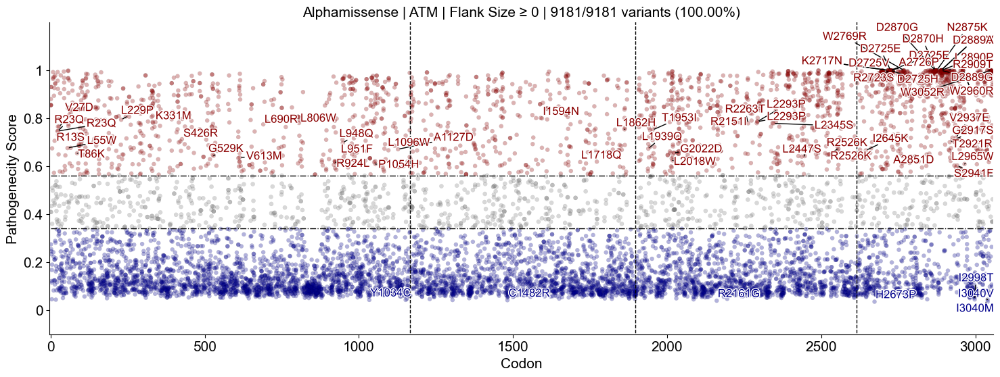

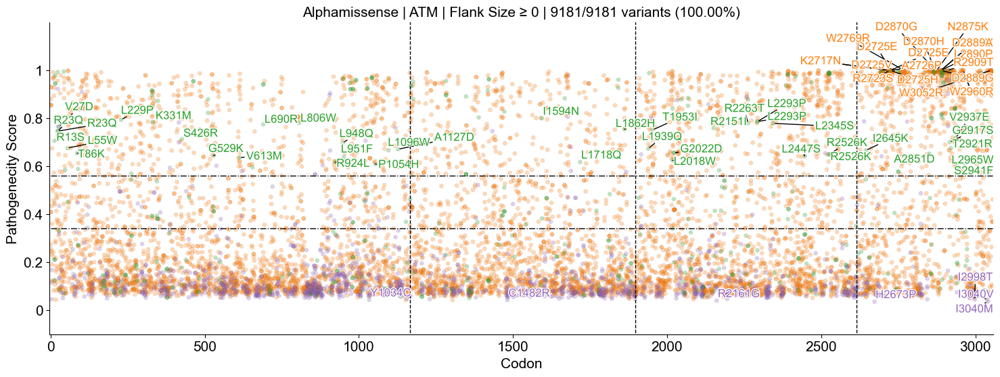

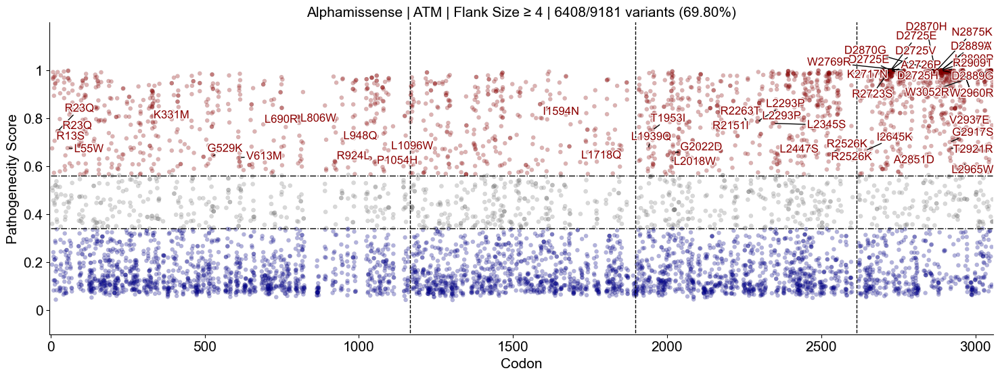

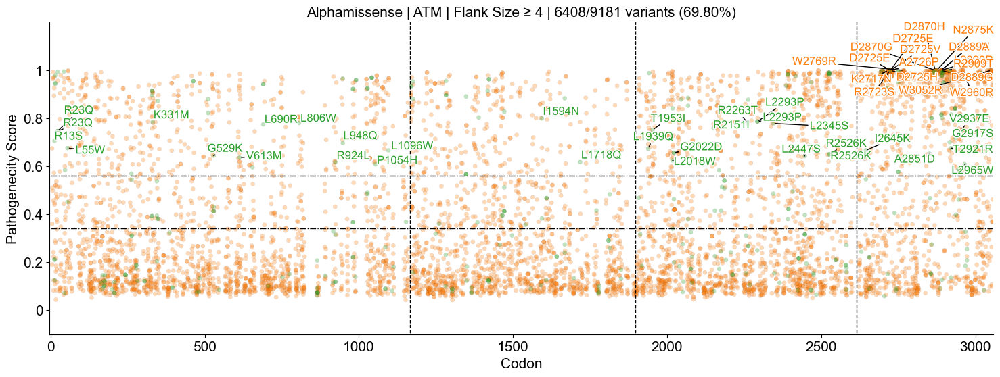

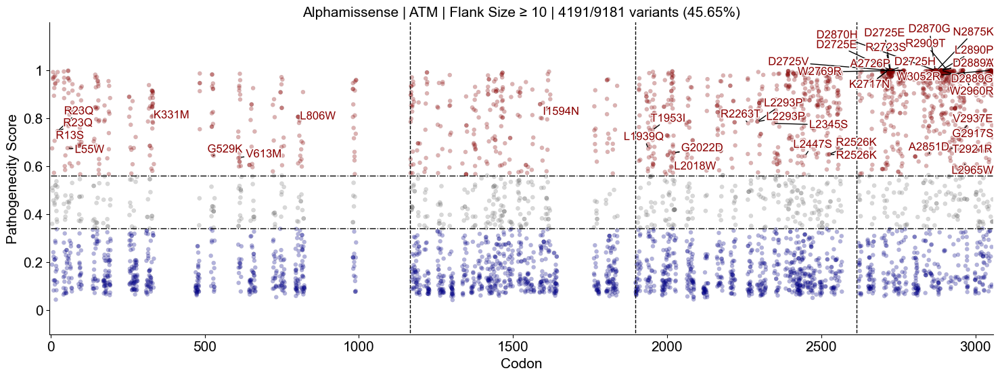

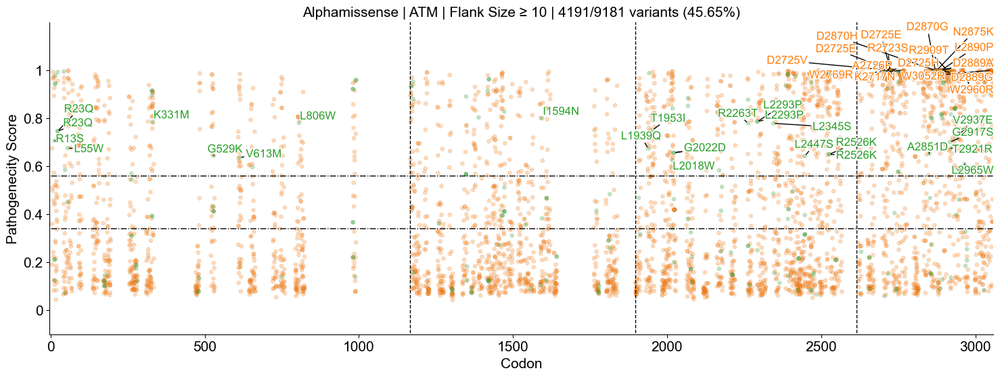

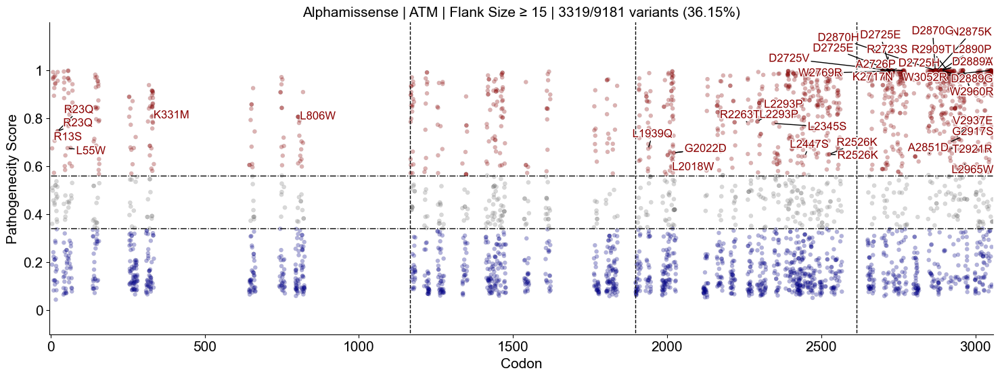

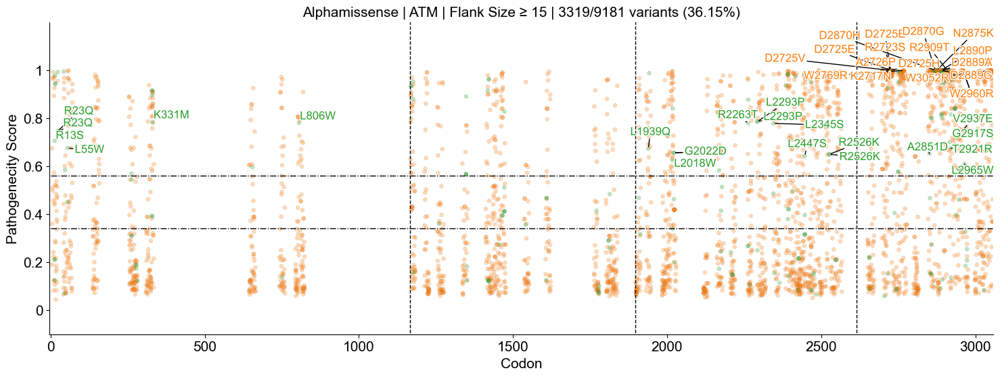

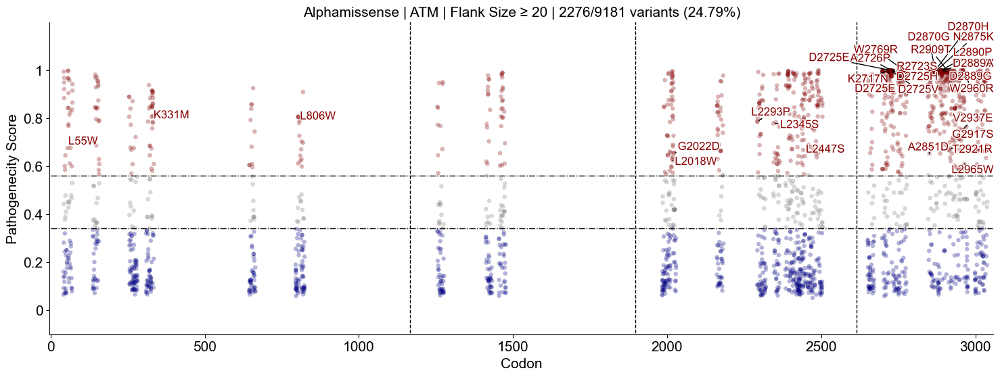

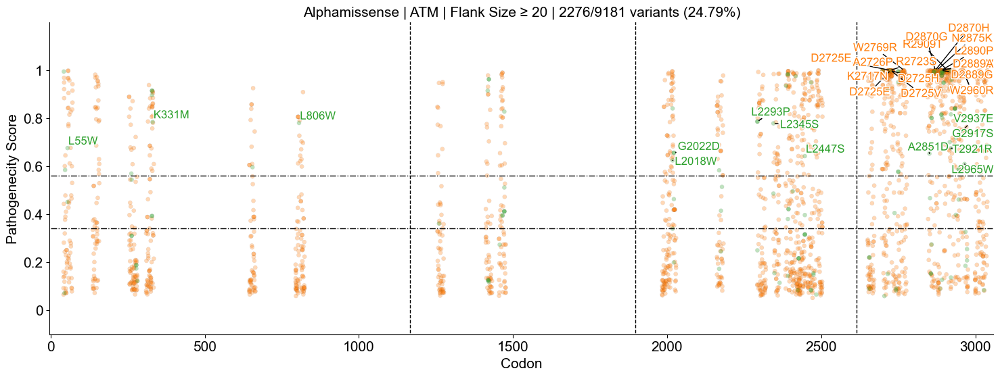

In [102]:
l1 = len(df_merged_all)
for fs in [0,4,10,15,20]:

    df_merged = df_merged_all[df_merged_all['flank_size'] >= fs].reset_index(drop=True)
    l2 = len(df_merged)
    percent = 100*l2/l1
    gene = 'ATM'
    
    bbb1 = df_merged[(df_merged['am_pathogenicity'] >= .999) & (df_merged['status'] == True)]
    bbb2 = df_merged[(df_merged['am_pathogenicity'] <= .045) & (df_merged['status'] == False)]
    bbb3 = df_merged[(df_merged['class'] == 1) & (df_merged['am_pathogenicity'] <= .8) & (df_merged['am_pathogenicity'] >= .6)]
    # top_2 = df_merged['HGVSp_h'].value_counts().index.to_list()[:2]
    # bbb3 = df_merged[df_merged['HGVSp_h'].isin(top_2)]
    bb2 = pd.concat((bbb1, bbb2,bbb3))

    t = list(bb2['HGVSp_h'])
    x = list(bb2['loc_h'])
    y = list(bb2['am_pathogenicity'])
    c = list(bb2['color'])

    t = list(bb2['HGVSp_h'])
    x = list(bb2['loc_h'])
    y = list(bb2['am_pathogenicity'])
    c = list(bb2['color'])


    fig, ax = plt.subplots(figsize=(18, 6))
    # 绘制散点图
    g = ax.scatter(data=df_merged, x='loc_h', y='am_pathogenicity',  c = 'color', alpha=.3, s=20, edgecolor='black', linewidths=.1)

    # 绘制参考线
    ax.plot([0, 3056], [0.56, 0.56], linewidth=1, linestyle='-.', color='black')
    ax.plot([0, 3056], [0.34, 0.34], linewidth=1, linestyle='-.', color='black')
    # ax.set_ylim(-6, 6)
    ax.set_xlim(-3, 3059)
    ax.set_ylim(-.1, 1.2)
    ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
    ax.set_xlabel("Codon", fontsize=15)
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs} | {l2}/{l1} variants ({percent:.2f}%)", fontsize=15)
    boundaries = [1166, 1898, 2614]
    for bound in boundaries:
        ax.plot([bound, bound], [-6, 6], linewidth=1, linestyle='dashed', color='black')

    texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
    ax.yaxis.set_ticks([0,.2,.4,.6,.8,1])
    ax.yaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
    adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='x', which='major', labelsize=15)
    plt.show()


    c = list(bb2['color_h2m'])

    fig, ax = plt.subplots(figsize=(18, 6))
    # 绘制散点图
    g = ax.scatter(data=df_merged, x='loc_h', y='am_pathogenicity',  c = 'color_h2m', alpha=.3, s=20, edgecolor='black', linewidths=.1)

    # 绘制参考线
    ax.plot([0, 3056], [0.56, 0.56], linewidth=1, linestyle='-.', color='black')
    ax.plot([0, 3056], [0.34, 0.34], linewidth=1, linestyle='-.', color='black')
    # ax.set_ylim(-6, 6)
    ax.set_xlim(-3, 3059)
    ax.set_ylim(-.1, 1.2)
    ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
    ax.set_xlabel("Codon", fontsize=15)
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs} | {l2}/{l1} variants ({percent:.2f}%)", fontsize=15)
    boundaries = [1166, 1898, 2614]
    for bound in boundaries:
        ax.plot([bound, bound], [-6, 6], linewidth=1, linestyle='dashed', color='black')

    texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
    ax.yaxis.set_ticks([0,.2,.4,.6,.8,1])
    ax.yaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
    adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='x', which='major', labelsize=15)
    plt.show()

### KRAS     

In [70]:
df_p53 = df_am[df_am['uniprot_id']=='P01116'].reset_index(drop=True)
df_p53 = df_p53.drop('uniprot_id',axis=1)
df_p53.columns=['HGVSp_h','am_pathogenicity','am_class']
df_h2m = df_binded[df_binded['gene_name_h']=='KRAS'].drop_duplicates(subset='ID_human').reset_index(drop=True)
df_h2m = df_h2m[df_h2m['classification_h'] == 'Missense'].reset_index(drop=True)
df_h2m = df_h2m.drop_duplicates(subset=['gene_name_h',
 'gene_id_h',
 'tx_id_h',
 'chr_h',
 'exon_num_h',
 'strand_h',
 'match',
 'start_h',
 'end_h',
 'ref_seq_h',
 'alt_seq_h',
 'HGVSc_h',
 'HGVSp_h',
 'classification_h',
 'exon_h',
 'type_h',
 'status',
 'class',
 'statement',
 'flank_size_left',
 'flank_size_right',
 'gene_name_m',
 'gene_id_m',
 'tx_id_m',
 'chr_m',
 'exon_num_m',
 'strand_m',
 'type_m',
 'classification_m',
 'exon_m',
 'start_m_ori',
 'end_m_ori',
 'ref_seq_m_ori',
 'alt_seq_m_ori',
 'HGVSc_m_ori',
 'HGVSp_m_ori',
 'start_m',
 'end_m',
 'ref_seq_m',
 'alt_seq_m',
 'HGVSc_m',
 'HGVSp_m',
 'flank_size'])
df_merged_all = pd.merge(df_h2m, df_p53, how='left').dropna(subset='am_class').reset_index(drop=True)
def search_loc(s):
    match = re.search(r'(\d+)', s)
    if match:
        number = match.group(1)
        return int(number)
    else:
        return None
    
df_merged_all['loc_h'] = [search_loc(s) for s in  df_merged_all['HGVSp_h']]
df_merged_all['color'] = [color_dict[x] for x in df_merged_all['am_class']]
df_merged_all['color_h2m'] = [color_dict_h2m[x] for x in df_merged_all['class']]

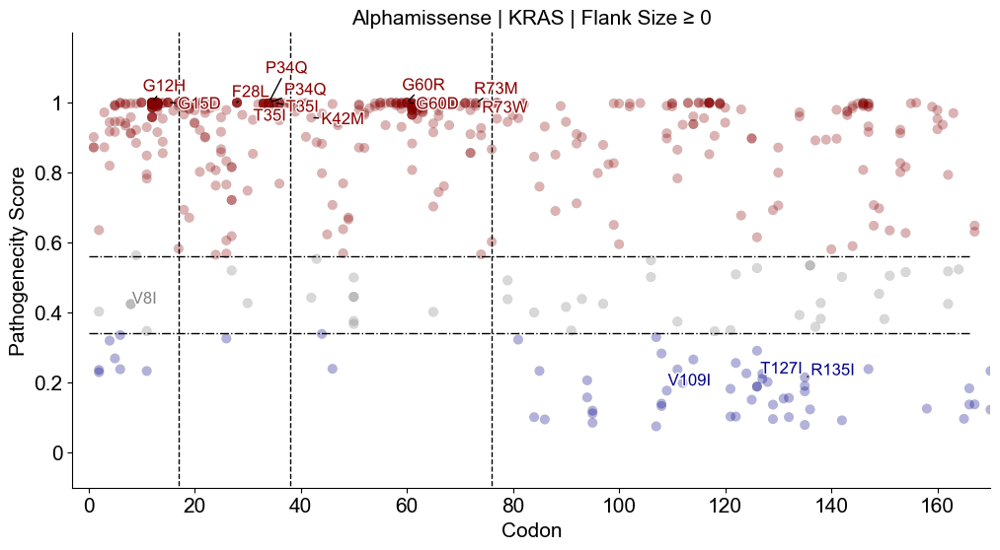

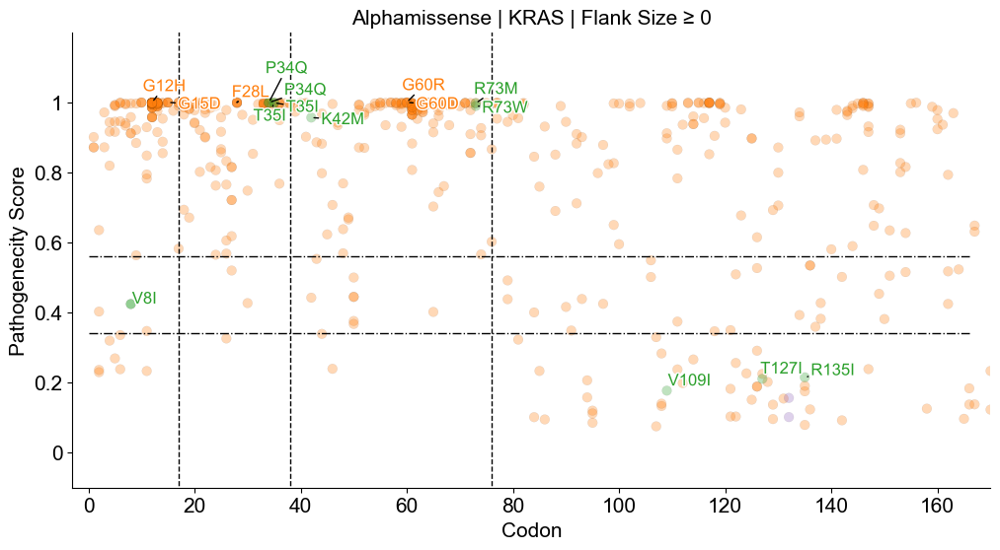

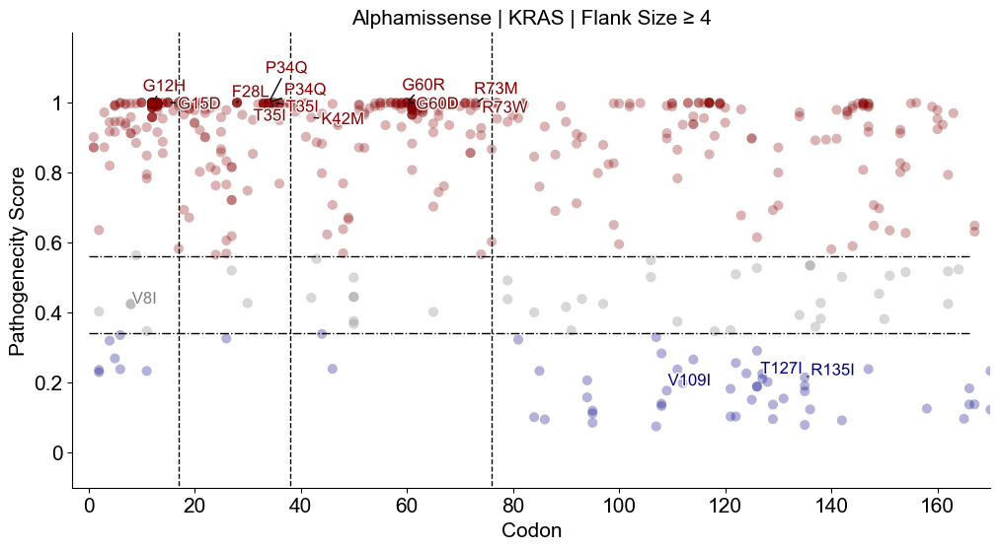

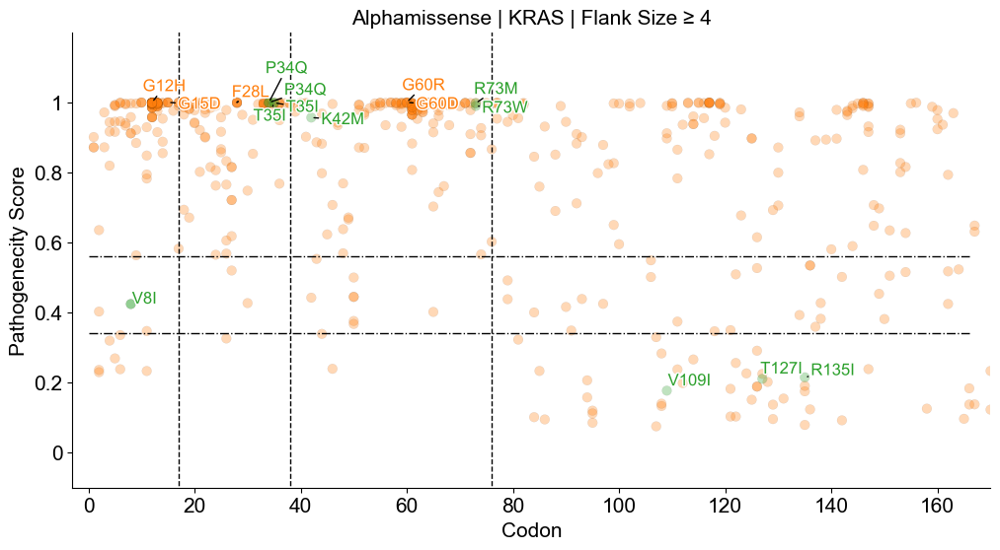

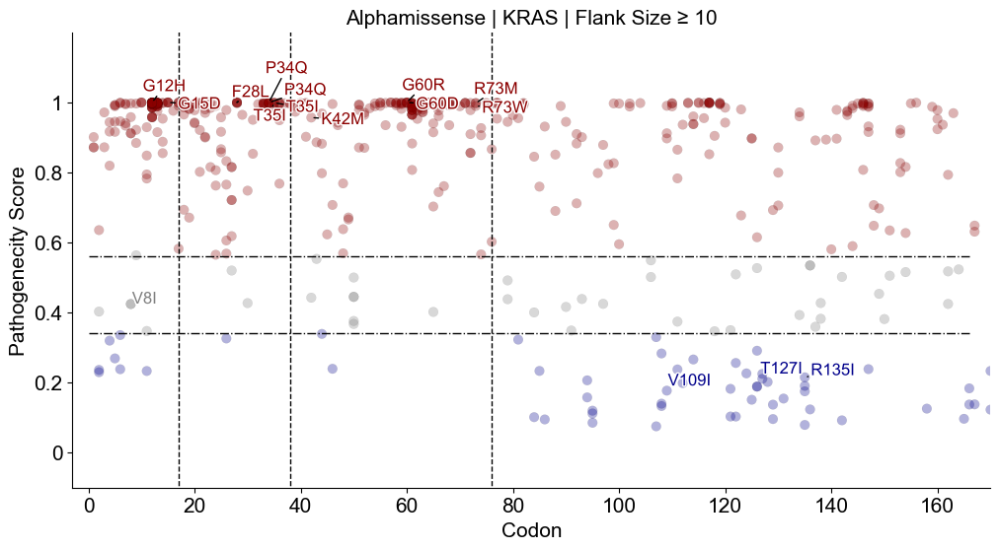

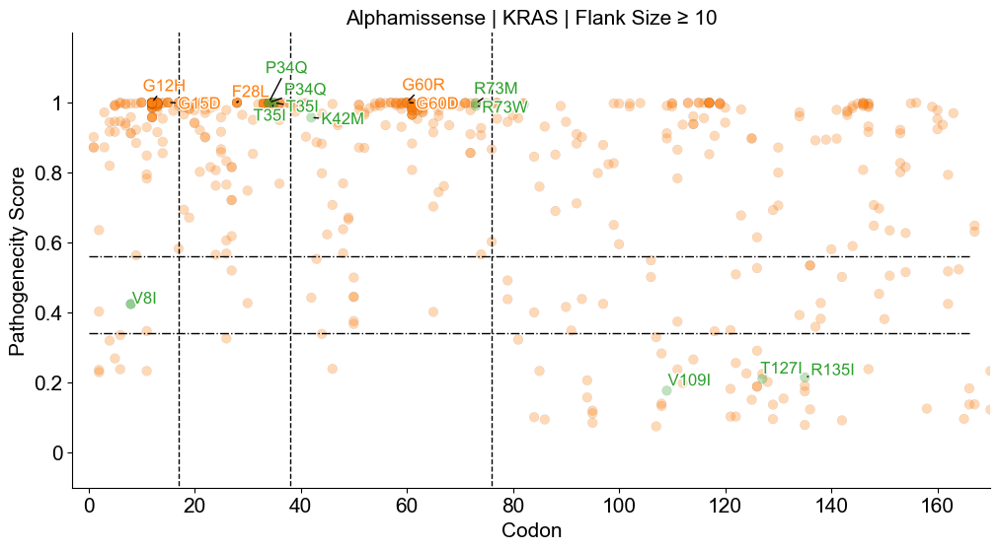

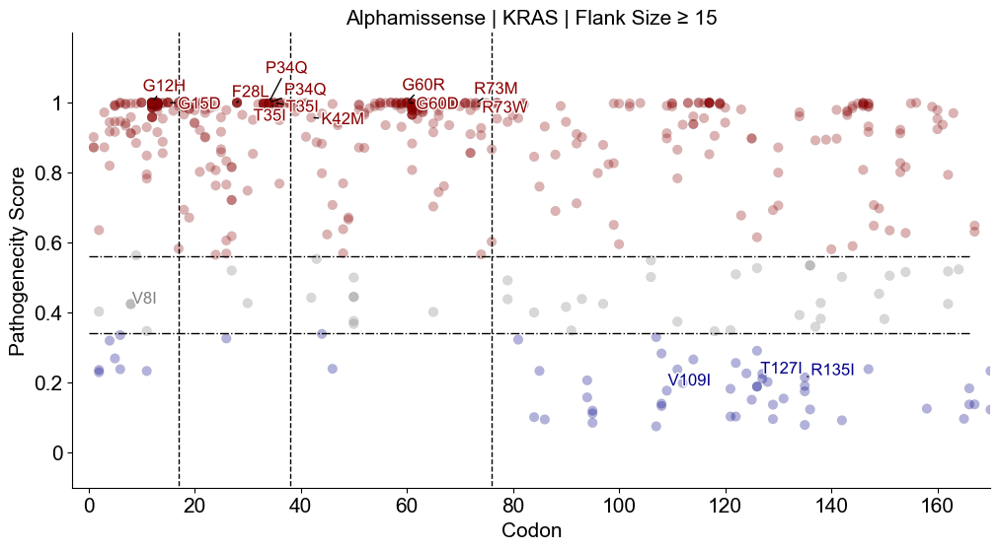

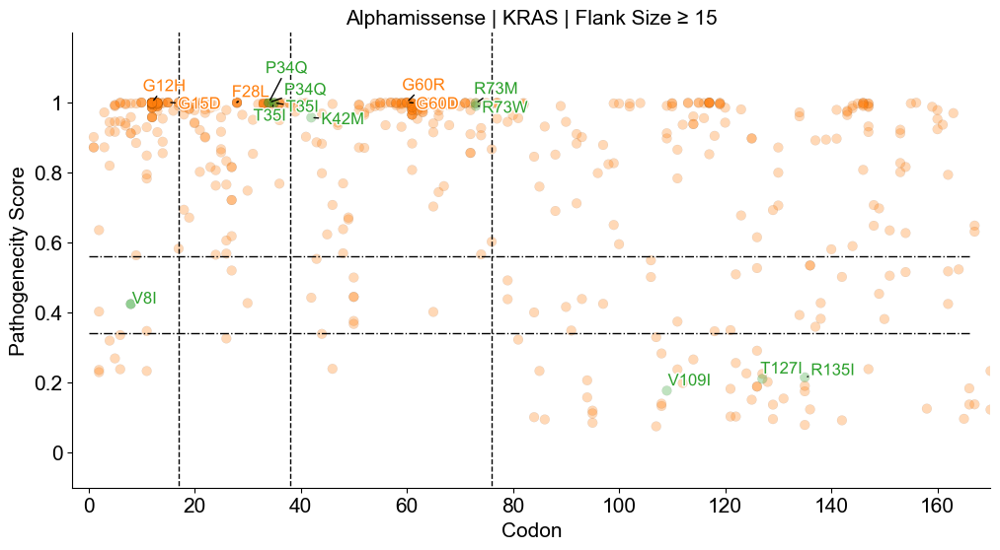

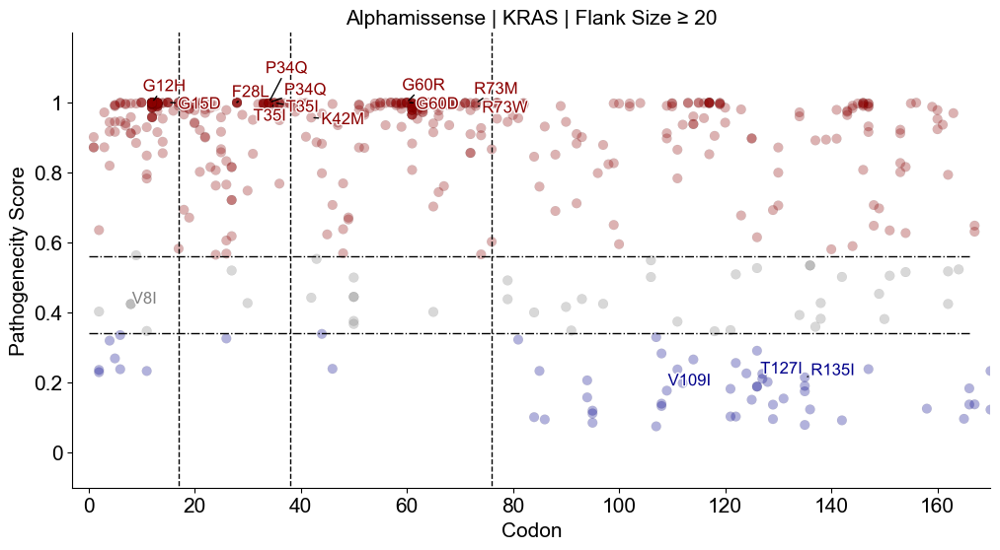

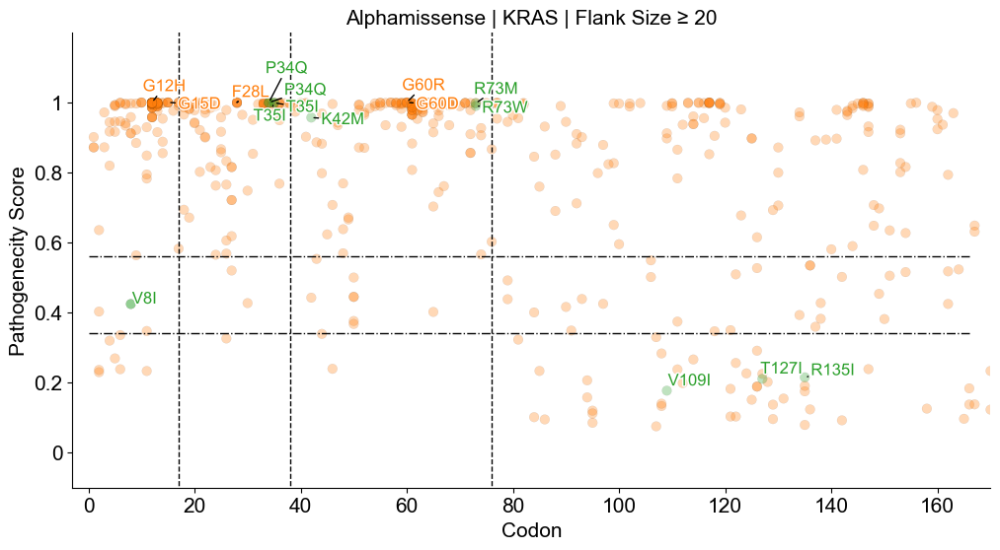

In [82]:
for fs in [0,4,10,15,20]:
    df_merged = df_merged_all[df_merged_all['flank_size'] >= fs].reset_index(drop=True)
    

    gene = 'KRAS'

    bbb1 = df_merged[(df_merged['am_pathogenicity'] >= .9997) & (df_merged['status'] == True)]
    bbb2 = df_merged[(df_merged['am_pathogenicity'] <= .03) & (df_merged['status'] == True)]
    bbb3 = df_merged[(df_merged['class'] == 1)]
    # top_2 = df_merged['HGVSp_h'].value_counts().index.to_list()[:2]
    # bbb3 = df_merged[df_merged['HGVSp_h'].isin(top_2)]
    bb2 = pd.concat((bbb1, bbb2,bbb3))

    t = list(bb2['HGVSp_h'])
    x = list(bb2['loc_h'])
    y = list(bb2['am_pathogenicity'])
    c = list(bb2['color'])

    fig, ax = plt.subplots(figsize=(12, 6))
    # 绘制散点图
    g = ax.scatter(data=df_merged, x='loc_h', y='am_pathogenicity',  c = 'color', alpha=.3, s=50, edgecolor='black', linewidths=.1)

    # 绘制参考线
    ax.plot([0, 166], [0.56, 0.56], linewidth=1, linestyle='-.', color='black')
    ax.plot([0, 166], [0.34, 0.34], linewidth=1, linestyle='-.', color='black')
    # ax.set_ylim(-6, 6)
    ax.set_xlim(-3, 170)
    ax.set_ylim(-.1, 1.2)
    ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
    ax.set_xlabel("Codon", fontsize=15)
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs}", fontsize=15)
    boundaries = [17, 38, 76]
    for bound in boundaries:
        ax.plot([bound, bound], [-6, 6], linewidth=1, linestyle='dashed', color='black')

    texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
    ax.yaxis.set_ticks([0,.2,.4,.6,.8,1])
    ax.yaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
    adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='x', which='major', labelsize=15)
    plt.show()

    c = list(bb2['color_h2m'])

    fig, ax = plt.subplots(figsize=(12, 6))
    # 绘制散点图
    g = ax.scatter(data=df_merged, x='loc_h', y='am_pathogenicity',  c = 'color_h2m', alpha=.3, s=50, edgecolor='black', linewidths=.1)

    # 绘制参考线
    ax.plot([0, 166], [0.56, 0.56], linewidth=1, linestyle='-.', color='black')
    ax.plot([0, 166], [0.34, 0.34], linewidth=1, linestyle='-.', color='black')
    # ax.set_ylim(-6, 6)
    ax.set_xlim(-3, 170)
    ax.set_ylim(-.1, 1.2)
    ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
    ax.set_xlabel("Codon", fontsize=15)
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs}", fontsize=15)
    boundaries = [17, 38, 76]
    for bound in boundaries:
        ax.plot([bound, bound], [-6, 6], linewidth=1, linestyle='dashed', color='black')

    texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
    ax.yaxis.set_ticks([0,.2,.4,.6,.8,1])
    ax.yaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
    adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='x', which='major', labelsize=15)
    plt.show()

### KMT2D      

In [83]:
df_p53 = df_am[df_am['uniprot_id']=='O14686'].reset_index(drop=True)
df_p53 = df_p53.drop('uniprot_id',axis=1)
df_p53.columns=['HGVSp_h','am_pathogenicity','am_class']

In [84]:
df_h2m = df_binded[df_binded['gene_name_h']=='KMT2D'].drop_duplicates(subset='ID_human').reset_index(drop=True)

In [85]:
df_h2m = df_h2m[df_h2m['classification_h'] == 'Missense'].reset_index(drop=True)
df_h2m = df_h2m.drop_duplicates(subset=['gene_name_h',
 'gene_id_h',
 'tx_id_h',
 'chr_h',
 'exon_num_h',
 'strand_h',
 'match',
 'start_h',
 'end_h',
 'ref_seq_h',
 'alt_seq_h',
 'HGVSc_h',
 'HGVSp_h',
 'classification_h',
 'exon_h',
 'type_h',
 'status',
 'class',
 'statement',
 'flank_size_left',
 'flank_size_right',
 'gene_name_m',
 'gene_id_m',
 'tx_id_m',
 'chr_m',
 'exon_num_m',
 'strand_m',
 'type_m',
 'classification_m',
 'exon_m',
 'start_m_ori',
 'end_m_ori',
 'ref_seq_m_ori',
 'alt_seq_m_ori',
 'HGVSc_m_ori',
 'HGVSp_m_ori',
 'start_m',
 'end_m',
 'ref_seq_m',
 'alt_seq_m',
 'HGVSc_m',
 'HGVSp_m',
 'flank_size'])

In [86]:
df_merged_all = pd.merge(df_h2m, df_p53, how='left').dropna(subset='am_class').reset_index(drop=True)

In [528]:
list_of_num_modeled = list(df_binded['ID_human'].value_counts().index)[:20]
k = df_binded[df_binded['ID_human'].isin(list_of_num_modeled)]

In [87]:
def search_loc(s):
    match = re.search(r'(\d+)', s)
    if match:
        number = match.group(1)
        return int(number)
    else:
        return None
    
df_merged_all['loc_h'] = [search_loc(s) for s in  df_merged_all['HGVSp_h']]

In [88]:
df_merged_all['color'] = [color_dict[x] for x in df_merged_all['am_class']]
df_merged_all['color_h2m'] = [color_dict_h2m[x] for x in df_merged_all['class']]

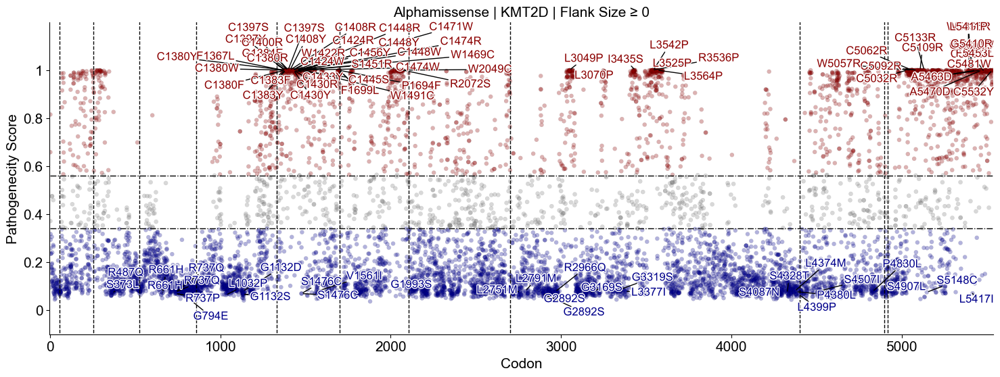

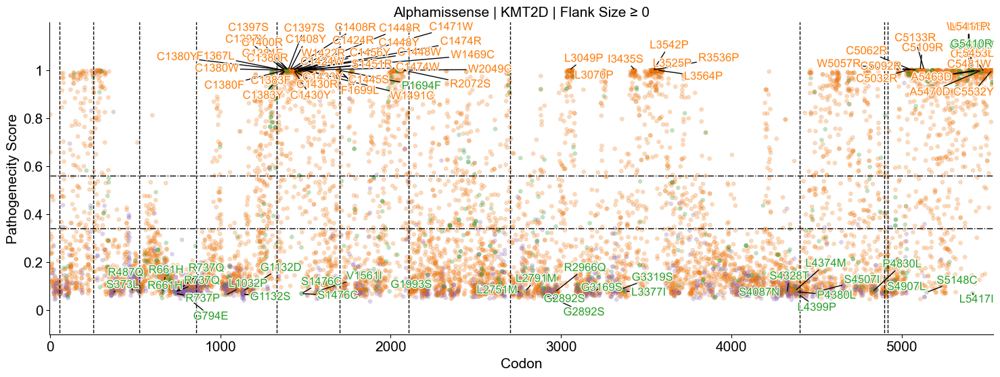

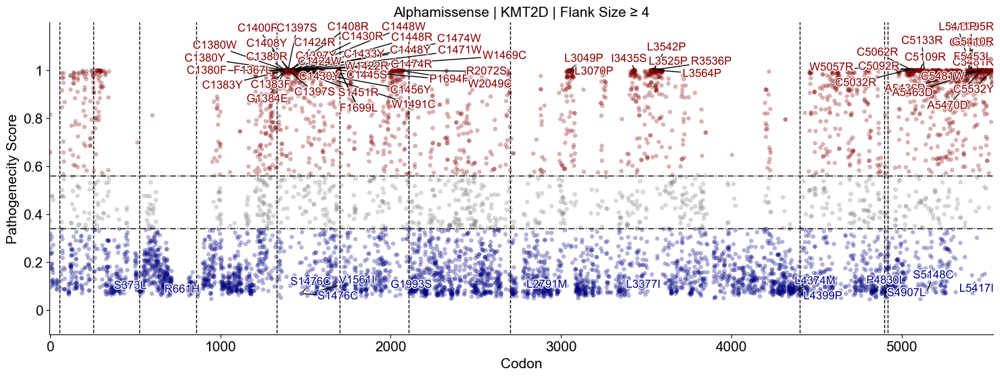

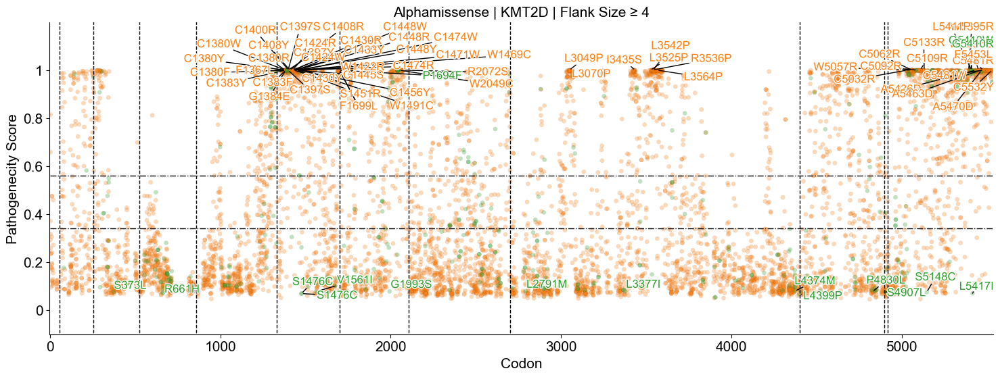

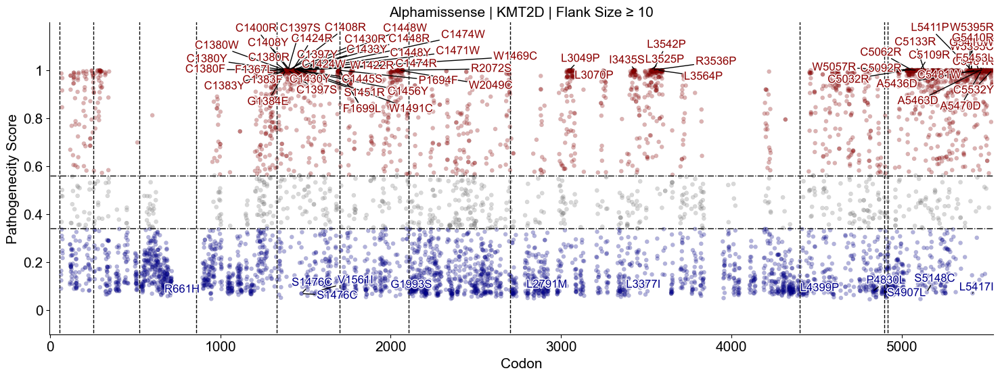

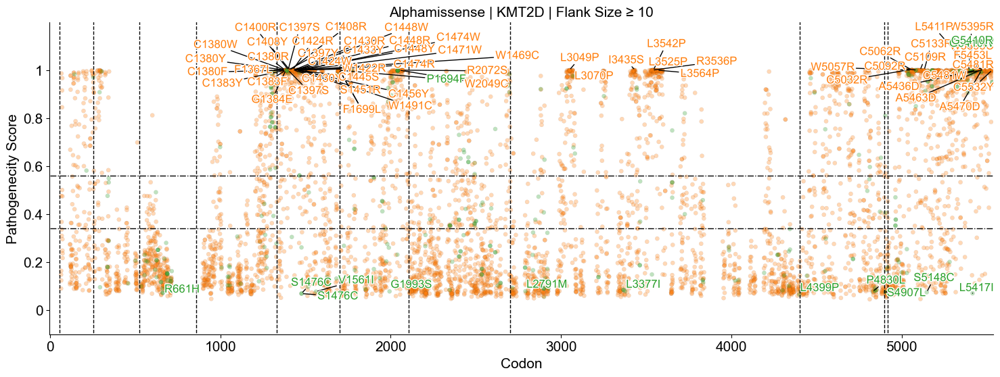

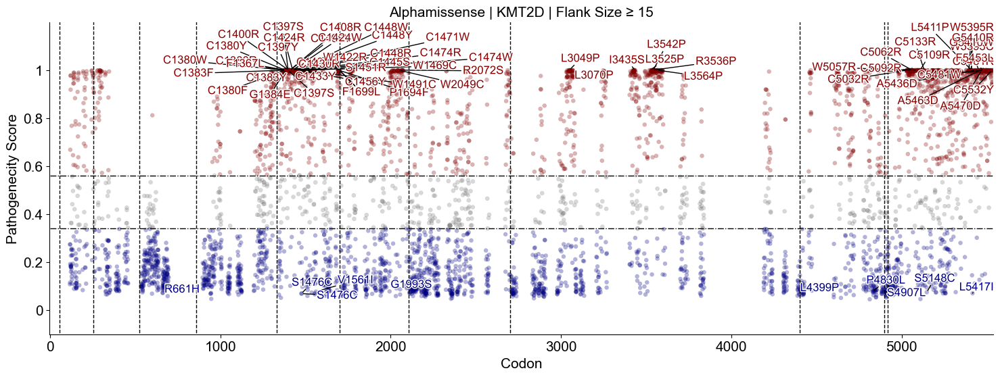

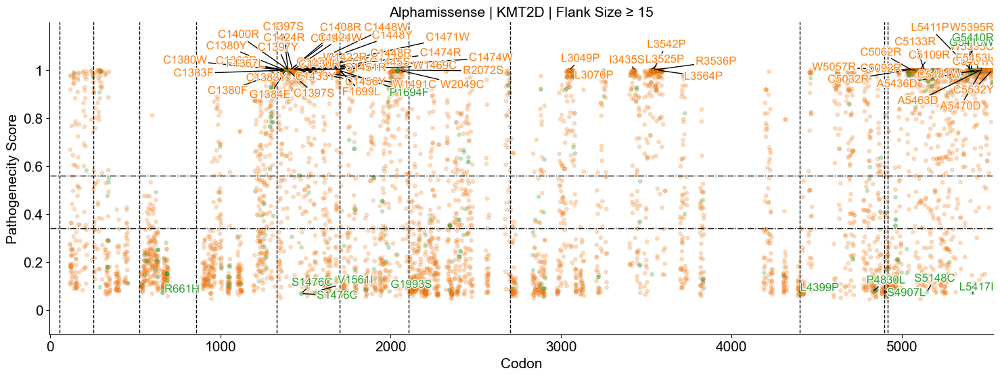

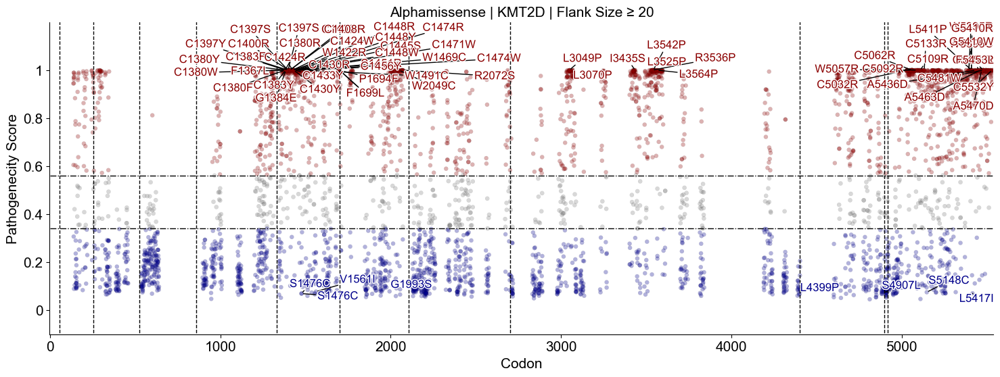

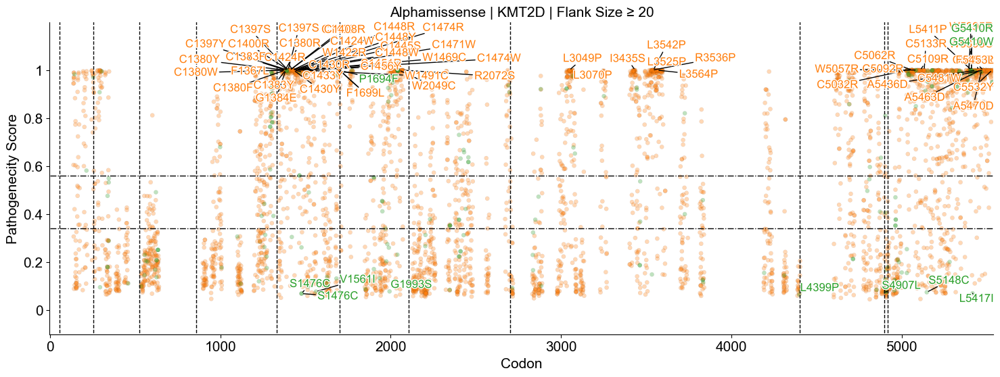

In [94]:
for fs in [0,4,10,15,20]:
    df_merged = df_merged_all[df_merged_all['flank_size'] >= fs].reset_index(drop=True)
    

    gene = 'KMT2D'

    bbb1 = df_merged[(df_merged['am_pathogenicity'] >= .9999) & (df_merged['status'] == True)]
    bbb2 = df_merged[(df_merged['am_pathogenicity'] <= .036) & (df_merged['status'] == False)]
    bbb3 = df_merged[(df_merged['class'] == 1) & (df_merged['am_pathogenicity'] >= .06) & (df_merged['am_pathogenicity'] <= .08) ]
    # top_2 = df_merged['HGVSp_h'].value_counts().index.to_list()[:2]
    # bbb3 = df_merged[df_merged['HGVSp_h'].isin(top_2)]
    bb2 = pd.concat((bbb1, bbb2,bbb3))

    t = list(bb2['HGVSp_h'])
    x = list(bb2['loc_h'])
    y = list(bb2['am_pathogenicity'])
    c = list(bb2['color'])

    fig, ax = plt.subplots(figsize=(18, 6))
    # 绘制散点图
    g = ax.scatter(data=df_merged, x='loc_h', y='am_pathogenicity',  c = 'color', alpha=.3, s=20, edgecolor='black', linewidths=.1)

    # 绘制参考线
    ax.plot([0, 5540], [0.56, 0.56], linewidth=1, linestyle='-.', color='black')
    ax.plot([0, 5540], [0.34, 0.34], linewidth=1, linestyle='-.', color='black')
    # ax.set_ylim(-6, 6)
    ax.set_xlim(-3, 5540)
    ax.set_ylim(-.1, 1.2)
    ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
    ax.set_xlabel("Codon", fontsize=15)
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs}", fontsize=15)
    boundaries = [
    56,    # PHD1
    252,   # PHD2
    523,   # PHD3
    857,   # PHD4
    1330,  # PHD5
    1702,  # PHD6
    2104,  # PHD7
    2700,  # PHD8
    4400,  # FYRN
    4900,  # FYRC
    4920   # SET
    ]
    for bound in boundaries:
        ax.plot([bound, bound], [-6, 6], linewidth=1, linestyle='dashed', color='black')

    texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
    ax.yaxis.set_ticks([0,.2,.4,.6,.8,1])
    ax.yaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
    adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='x', which='major', labelsize=15)
    plt.show()

    c = list(bb2['color_h2m'])

    fig, ax = plt.subplots(figsize=(18, 6))
    # 绘制散点图
    g = ax.scatter(data=df_merged, x='loc_h', y='am_pathogenicity',  c = 'color_h2m', alpha=.3, s=20, edgecolor='black', linewidths=.1)

    # 绘制参考线
    ax.plot([0, 5540], [0.56, 0.56], linewidth=1, linestyle='-.', color='black')
    ax.plot([0, 5540], [0.34, 0.34], linewidth=1, linestyle='-.', color='black')
    # ax.set_ylim(-6, 6)
    ax.set_xlim(-3, 5540)
    ax.set_ylim(-.1, 1.2)
    ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
    ax.set_xlabel("Codon", fontsize=15)
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs}", fontsize=15)
    for bound in boundaries:
        ax.plot([bound, bound], [-6, 6], linewidth=1, linestyle='dashed', color='black')

    texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
    ax.yaxis.set_ticks([0,.2,.4,.6,.8,1])
    ax.yaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
    adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='x', which='major', labelsize=15)
    plt.show()

## Neoantigen case study  

### Aggregation of the input data  
Tumore-specific T-cell antigen  

#### Human-to-mouse   
a database of human experiment-validated neoantigens  -> mouse ones -> predict MHCpan -> callculate correlation -> colored by flank size , filtered by MHC aelle.  
be presented by...  

by default, %Rank < 0.5% and %Rank < 2% thresholds are considered for detecting SBs (strong bindings) and WBs (weak bindings) for class I 

In [97]:
df_h_validated = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/neoantigen/NECID_Query.csv')
df_input = df_h_validated[['id','genesymbol','wt_aa','mut_aa_pos','mut_aa','mut_peptide',
                'antigen_len','locus','alleleA','alleleB','mut_pos_in_pep']]
df_input = df_input.drop_duplicates(subset=list(df_input.columns[1:-5])).reset_index(drop=True).dropna(subset='mut_aa_pos')
df_input['HGVSp_h'] = [''.join([x,str(int(y)),z]) for x,y,z in zip(df_input['wt_aa'],df_input['mut_aa_pos'],df_input['mut_aa'])]

read in mutation-derived T-cell antigens from database TSNAdb v2.0.  

TSNAdb v2.0 combines the predcited results of DeepHLApan, MHCflurry and NetMHCpan v4.0 for the identification of higher confidence neoantigens derived from SNV, INDEL and Fusion, respectively. Totally, 372,273 SNV-derived neoantigens, 137,130 INDEL-derived neoantigens and 11,093 Fusion-derived neoantigens are obtained. It also provides shared predicted neoantigens and 1,856 neoantigens collected from databases (dbPepNeo,NeoPeptide, NEPdb, CAPD) and literature .In these neoantigens, corresponding genes and mutations are linked to CandrisDB (cancer driver sites database) we created previously, providing more convincible information since neoantigen derived from driver genes or sites would be ideal tumor immunotherapy targets.

In [542]:
df_h_validated = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/neoantigen/validated_tsnadb2_download.txt', header=0, sep='\t')
df_h_validated = df_h_validated[['Mutation Type','Gene','Mutation','Mutant Peptide','HLA']].drop_duplicates()
df_h_validated = df_h_validated.dropna(subset ='Mutation')
df_h_validated = df_h_validated[df_h_validated['Mutation Type']!='Fusion']
df_h_validated['Mutation'] = [str(x).split('_')[1] for x in df_h_validated['Mutation']]
df_h_validated = df_h_validated[df_h_validated['Mutation Type']=='SNV']

In [543]:
import re
def split_mutation(mutation):
    parts = re.findall(r'([A-Z])(\d+)([A-Z])', mutation)
    if parts:
        return parts[0]  # 返回找到的第一个匹配组
    return ('', '', '')  # 如果没有匹配，返回空字符串

# 应用这个函数到DataFrame的列
df_h_validated[['ref_seq_h', 'start_h', 'alt_seq_h']] = df_h_validated['Mutation'].apply(lambda x: pd.Series(split_mutation(x)))
df_h_validated['end_h'] = df_h_validated['start_h']

In [544]:
df_h_validated['gene_name_h'] = df_h_validated['Gene']
df_h_validated = h2m.get_tx_batch(df_h_validated, 'h', ver=37)[0]
df_h_validated = h2m.query_batch(df_h_validated)[0]
df_h_validated = h2m.get_tx_batch(df_h_validated, 'm', ver=37)[0]
df_h_validated

There were rows that could not be processed.
There were rows that could not be processed.
No error occurs.


,Mutation Type,Gene,Mutation,Mutant Peptide,HLA,ref_seq_h,start_h,alt_seq_h,end_h,gene_name_h,tx_id_h,ref_genome_h,gene_name_m,tx_id_m
0,SNV,A2M,L760I,LVEPEGIEK,C16:01,L,760,I,760,A2M,ENST00000318602.7,GRCh37,A2m,ENSMUST00000032203.9
1,SNV,AASS,D512N,RDGNIEITVGSNMKNQIEQLGKK,NaN,D,512,N,512,AASS,ENST00000393376.1,GRCh37,Aass,ENSMUST00000031707.14
2,SNV,ABCB10,S405Y,GLYGNLIVL,A02:01,S,405,Y,405,ABCB10,ENST00000344517.4,GRCh37,Abcb10,ENSMUST00000075578.7
3,SNV,ABCC1,P1094S,ENQKAYYSSIVANRWL,NaN,P,1094,S,1094,ABCC1,ENST00000399410.3,GRCh37,Abcc1,ENSMUST00000100167.10
4,SNV,ABCC1,P1094S,YYSSIVANRWLAVRLE,NaN,P,1094,S,1094,ABCC1,ENST00000399410.3,GRCh37,Abcc1,ENSMUST00000100167.10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2579,SNV,ZNF878,T216A,ALSYLVSFQR,A11:01,T,216,A,216,ZNF878,ENST00000547628.1,GRCh37,Zfp975,ENSMUST00000107992.2
2580,SNV,ZNF878,T216A,ALSYLVSFQR,A11:01,T,216,A,216,ZNF878,ENST00000547628.1,GRCh37,Zfp976,ENSMUST00000098503.9
2581,SNV,ZNF878,T216A,ALSYLVSFQR,A11:01,T,216,A,216,ZNF878,ENST00000547628.1,GRCh37,Zfp997,ENSMUST00000238623.3
2582,SNV,ZNF878,T216A,ALSYLVSFQR,A11:01,T,216,A,216,ZNF878,ENST00000547628.1,GRCh37,Zfp998,ENSMUST00000172579.4


In [2]:
path_h_ref, path_m_ref = '/Users/kexindong/Documents/GitHub/Database/RefGenome/ncbi-2023-09-12/GCF_000001405.25_GRCh37.p13_genomic.fna.gz', '/Users/kexindong/Documents/GitHub/Database/RefGenome/mouse-2023-09-13/GCF_000001635.27_GRCm39_genomic.fna.gz'
# remember to replace the paths with yours
records_h, index_list_h = h2m.genome_loader(path_h_ref)

In [3]:
path_h_anno, path_m_anno = '/Users/kexindong/Documents/GitHub/Database/Genecode/gencode_v19_GRCh37.db', '/Users/kexindong/Documents/GitHub/Database/Genecode/gencode_vm33_GRCm39.db'
# remember to replace the paths with yours
db_h= h2m.anno_loader(path_h_anno)

In [90]:
path_h_anno, path_m_anno = '/Users/kexindong/Documents/GitHub/Database/Genecode/gencode_v19_GRCh37.db', '/Users/kexindong/Documents/GitHub/Database/Genecode/gencode_vm33_GRCm39.db'
# remember to replace the paths with yours
db_h, db_m = h2m.anno_loader(path_h_anno), h2m.anno_loader(path_m_anno)

In [10]:
import bioh2m as h2m
import pandas as pd
path_h_ref, path_m_ref = '/Users/kexindong/Documents/GitHub/Database/RefGenome/ncbi-2023-09-12/GCF_000001405.25_GRCh37.p13_genomic.fna.gz', '/Users/kexindong/Documents/GitHub/Database/RefGenome/mouse-2023-09-13/GCF_000001635.27_GRCm39_genomic.fna.gz'
# remember to replace the paths with yours
records_h, index_list_h = h2m.genome_loader(path_h_ref)
records_m, index_list_m  = h2m.genome_loader(path_m_ref)
path_h_anno, path_m_anno = '/Users/kexindong/Documents/GitHub/Database/Genecode/gencode_v19_GRCh37.db', '/Users/kexindong/Documents/GitHub/Database/Genecode/gencode_vm33_GRCm39.db'
# remember to replace the paths with yours
db_h, db_m = h2m.anno_loader(path_h_anno), h2m.anno_loader(path_m_anno)

In [545]:
df_input = df_input.rename(columns={
    'id':'ID',
    'genesymbol':'gene_name_h',
    'mut_aa':'alt_seq_h',
    'wt_aa':'ref_seq_h',
    'mut_aa_pos':'start_h'
})
df_input['end_h'] = df_input['start_h']
df_input['end_h'] = [int(x) for x in df_input['end_h']]
df_input['start_h'] = [int(x) for x in df_input['start_h']]

In [546]:
dict_of_aacr_symbol = {
    'H3F3A':'H3-3A',
    'H3F3B':'H3-3B',
    'WHSC1':'NSD1',
    'GPR124':'ADGRA2',
    'MKL1':'MRTFA',
    'PARK2':'PRKN',
    'MRE11A':'MRE11',
    'MLLT4':'AFDN',
    'CASC5': 'KNL1',
    'MEF2BNB-MEF2B':'BORCS8-MEF2B',
    'PAK7':'PAK5',
    'HIST1H1C':'H1-2',
    'HIST1H3B': 'H3C1',
    'HIST1H1E': 'H1-4',
    'HIST1H2BD': 'H2BC5',
    'HIST3H3': 'H3-4',
    'HIST1H3D': 'H3C2',
    'HIST1H3E': 'H3C3',
    'HIST1H3J': 'H3C12',
    'HIST1H2BK': 'H2BC8',
    'HIST1H3F': 'H3C4',
    'HIST1H1B': 'H1-5',
    'HIST1H1D': 'H1-3',
    'HIST1H2AC': 'H2AC1',
    'HIST1H2BJ': 'H2BC13',
    'HIST1H4E': 'H4C5',
    'FAM46C':'TENT5C',
    'WHSC1L1':'NSD3',
    'SETD8':'KMT5A',
    'LPHN3':'ADGRL3',
    'BAI3':'ADGRB3',
    'SEPT9':'NAPB',
    'BRE':'BABAM2',
    'RFWD2':'COP1',
    'TCEB1':'ELOC',
    'GBA':'GBA1',
    'PVRL4':'NECTIN4',
    'ICK':'GCKR',
    'GNB2L1':'RACK1',
    'MGEA5':'OGA',
    'DIRC2':'SLC49A4',
    'LARGE':'LARGE1',
    'TMEM173B':'STING1',
    'SEPT5':'SEPTIN5'
    }
df_h_validated['gene_name_h'] = [dict_of_aacr_symbol.get(x,x) for x in df_h_validated['gene_name_h']]

In [13]:
df_h_validated['type_h'] = 'SNP'
df_h_validated['index'] = range(len(df_h_validated))
df_result_h2m, df_fail = h2m.model_batch(df_h_validated, records_h, index_list_h, records_m, index_list_m, db_h, db_m, 37, coor='aa', show_sequence=True)

There were rows that could not be processed.


In [14]:
df_result_h2m.to_csv('/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/h2m_neoantigen_result.csv',index=False)

In [537]:
df_result_h2m = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/h2m_neoantigen_result.csv')

In [550]:
del df_p53

In [539]:
df_process

,Mutant Peptide,gene_name_h,HGVSp_h,human_9mers,mouse_9mers,index,HLA,HLA_observed,score,percentile_rank,HLA_observed_m,score_m,percentile_rank_m,class,color
0,GLYGNLIVL,ABCB10,S405Y,GLYGNLIVL,GLYGNLIVL,2,A02:01,A02:01,0.876096,0.04,Db,0.253319,0.24,both,darkred
6,GEELDPPWL,ABCC6,Q715E,GEELDPPWL,REELDLPWL,8,B18:01,B40:01,0.750505,0.13,Kk,0.179861,1.90,both,darkred
12,FLDPDLTNI,ACE,S167F,FLDPDLTNI,FLDPELTNI,10,A02:01,A02:01,0.987693,0.01,Kk,0.123866,2.70,honly,tab:orange
18,AYQSIKVRI,ACE2,D615Y,AYQSIKVRI,AYQSIKVRI,11,A24:02,A24:02,0.837559,0.04,Kd,0.917959,0.01,both,darkred
24,ESSPSIVHR,ACTG1,G366S,ESSPSIVHR,ESSPSIVHR,16,A33:03,A68:01,0.990834,0.01,Kq,0.013383,8.40,honly,tab:orange
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6894,KVCGTAFTW,ZNF611,D404G,KVCGTAFTW,NQCGKAFAC,2508,A32:01,B57:01,0.988189,0.01,Kk,0.003102,25.00,honly,tab:orange
6996,KVCGTAFTW,ZNF611,D404G,KVCGTAFTW,KQCGKAFVR,2509,A32:01,B57:01,0.988189,0.01,Kd,0.002325,12.00,honly,tab:orange
7098,KVCGTAFTW,ZNF611,D404G,KVCGTAFTW,KQCGKAFVR,2510,A32:01,B57:01,0.988189,0.01,Kd,0.002325,12.00,honly,tab:orange
7200,KVCGTAFTW,ZNF611,D404G,KVCGTAFTW,NQCGKGFAQ,2513,A32:01,B57:01,0.988189,0.01,Kq,0.001119,31.00,honly,tab:orange


In [ ]:
df_process = df_result_h2m.drop_duplicates(subset='index')
len(df_process[['HGVSp_h','gene_name_h','gene_name_m']].drop_duplicates())

In [18]:
len(df_result_h2m[['HGVSp_h','gene_name_h']].drop_duplicates())

1002

In [21]:
df_result_h2m.drop_duplicates(subset=['HGVSp_h','gene_name_h'])['class'].value_counts()

class
1    854
4    148
Name: count, dtype: int64

In [22]:
df_result_h2m.drop_duplicates(subset=['HGVSp_h','gene_name_h','tx_id_m'])['class'].value_counts()

class
1    1055
4     405
Name: count, dtype: int64

In [23]:
df_final = pd.merge(df_h_validated[['Mutant Peptide',  'HLA',
        'index']], df_result_h2m, on = 'index', how = 'left')

In [24]:
len(df_final[df_final['status']==True]['gene_name_h'].unique())

776

In [25]:
df_process = df_result_h2m.drop_duplicates(subset=['HGVSp_h','gene_name_h','tx_id_m']).reset_index(drop=True)
df_process = pd.merge(df_h_validated[['Mutant Peptide',  'HLA',
        'index']], df_process, on = 'index', how = 'left')
df_final_success = df_process[df_process['status']==True].reset_index(drop=True)
df_final_success['flank_size_left'] = df_final_success['flank_size_left'].fillna('0aa')
df_final_success['flank_size'] = [int(x[:-2])+int(y[:-2]) for x,y in zip(df_final_success['flank_size_left'], df_final_success['flank_size_right'])]

##### 9-mer splicing  

In [26]:
def find_9mers_containing_position(sequence, position):
    """
    Generate all 9-mer slices from a given DNA sequence that include a specific position.

    Args:
    sequence (str): The DNA sequence.
    position (int): The 1-based position within the sequence.

    Returns:
    list: A list of all 9-mer slices including the specified position.
    """
    # Adjust position to 0-based for easier slicing
    sequence = str(h2m.Translate(sequence))
    position = position[0]

    k_mers = [""] * 9  # 初始化一个长度为9的列表，填充空字符串
    # 计算可能的9-mer的起始位置
    start_index = position - 8

    # 为每个可能的起始位置生成一个9-mer
    for i in range(9):
        if 0 <= start_index + i <= len(sequence) - 9:  # 确保起始位置合法，且可以生成完整的9-mer
            k_mer = sequence[start_index + i: start_index + i + 9]
            k_mers[i] = k_mer
    
    # Initialize list to collect 9-mers
    
    return k_mers


In [27]:
# 使用apply函数生成每个位置的9-mer列表，并将列表作为新列添加
df_final_success['human_mouse_9mers'] = df_final_success.apply(
    lambda row: {
        'human_9mers': find_9mers_containing_position(row['new_seq_h'], row['human_p_idx']),
        'mouse_9mers': find_9mers_containing_position(row['new_seq_m'], row['mouse_p_idx'])
    }, axis=1)

In [28]:
def expand_row(row):
    return pd.DataFrame({
        'human_9mers': row['human_mouse_9mers']['human_9mers'],
        'mouse_9mers': row['human_mouse_9mers']['mouse_9mers'],
        'index':row['index'],
        'HLA':row['HLA'],
        'Mutant Peptide':row['Mutant Peptide']
    })

In [29]:
# 展开DataFrame
expanded_rows = pd.concat([expand_row(row) for index, row in df_final_success.iterrows()]).reset_index(drop=True)

In [30]:
o = expanded_rows[expanded_rows['human_9mers']==expanded_rows['Mutant Peptide']]

In [ ]:
pep_m = []
for x,row in df_final_success.iterrows():
    print(x)
    m = row['mouse_new_p_idx'][0]
    s = int(m) - int(row['mut_pos_in_pep']) + 1
    e =int(s) + int(row['antigen_len']) - 1
    pep_m.append(str(h2m.Translate(row['new_seq_m'])[s:e+1]))
df_final_success['mut_peptide_m'] = pep_m
df_final_success_final = df_final_success[['gene_name_h','gene_name_m','mut_peptide','mut_peptide_m', 'HGVSp_h','HGVSp_m', 'flank_size_left','flank_size_right','locus','alleleA','alleleB']].drop_duplicates()
df_final_success_final['matched'] = [x==y for x,y in zip(df_final_success_final['mut_peptide'], df_final_success_final['mut_peptide_m'])]
df_final_success_final = df_final_success_final.reset_index(drop=True)
df_final_success_final.drop_duplicates(subset='gene_name_h')['matched'].value_counts()
df_final_success_final.to_csv('/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/human_validated.csv',index=True)
df_final_success_final['ID'] = range(len(df_final_success_final))
len(df_final_success[df_final_success['status']==True]['mut_peptide'].unique())
df_final_success_final['alleleB'].value_counts()

##### NetMHCpan 4.2 EL  

In [247]:
df_final_success_final['ID'] = range(1, len(df_final_success_final)+1)

In [220]:
for index, x in o.iterrows():
    k = x['index']
    l = x['human_9mers']
    with open('/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/input_h.txt', 'a') as file:
        file.writelines(f'>{k}\n{l}\n')
    l = x['mouse_9mers']
    with open('/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/input_m.txt', 'a') as file:
        file.writelines(f'>{k}\n{l}\n')

In [678]:
o

,gene_name_m,gene_id_m,tx_id_m,chr_m,exon_num_m,strand_m,matcm,start_m,end_m,ref_seq_m,...,new_seq_h_ori,human_tx_idx_ori,human_p_idx_ori,human_new_p_idx_ori,dist_h,new_seq_h,human_tx_idx,human_p_idx,human_new_p_idx,index
0,Trp53,ENSMUSG00000059552.14,ENSMUST00000108658.10,chr11,10,+,True,69480028,69480028,G,...,ATGGAGGAGCCGCAGTCAGATCCTAGCGTCGAGCCCCCTCTGAGTC...,[733],[244],[244],NaN,ATGGAGGAGCCGCAGTCAGATCCTAGCGTCGAGCCCCCTCTGAGTC...,[733],[244],[244],1_00001
1,Trp53,ENSMUSG00000059552.14,ENSMUST00000108658.10,chr11,10,+,True,69480040,69480040,G,...,ATGGAGGAGCCGCAGTCAGATCCTAGCGTCGAGCCCCCTCTGAGTC...,[745],[248],[248],NaN,ATGGAGGAGCCGCAGTCAGATCCTAGCGTCGAGCCCCCTCTGAGTC...,"[744, 745]","[248, 248]",[248],1_00002
2,Trp53,ENSMUSG00000059552.14,ENSMUST00000108658.10,chr11,10,+,True,69480040,69480040,G,...,ATGGAGGAGCCGCAGTCAGATCCTAGCGTCGAGCCCCCTCTGAGTC...,[745],[248],[248],NaN,ATGGAGGAGCCGCAGTCAGATCCTAGCGTCGAGCCCCCTCTGAGTC...,"[744, 745, 746]","[248, 248, 248]",[248],1_00002
3,Trp53,ENSMUSG00000059552.14,ENSMUST00000108658.10,chr11,10,+,True,69480040,69480040,G,...,ATGGAGGAGCCGCAGTCAGATCCTAGCGTCGAGCCCCCTCTGAGTC...,[745],[248],[248],NaN,ATGGAGGAGCCGCAGTCAGATCCTAGCGTCGAGCCCCCTCTGAGTC...,"[744, 745]","[248, 248]",[248],1_00002
4,Trp53,ENSMUSG00000059552.14,ENSMUST00000108658.10,chr11,10,+,True,69480040,69480040,G,...,ATGGAGGAGCCGCAGTCAGATCCTAGCGTCGAGCCCCCTCTGAGTC...,[745],[248],[248],NaN,ATGGAGGAGCCGCAGTCAGATCCTAGCGTCGAGCCCCCTCTGAGTC...,"[744, 745, 746]","[248, 248, 248]",[248],1_00002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18188,Zzef1,ENSMUSG00000055670.15,ENSMUST00000207107.2,chr11,55,+,True,72766102,72766102,G,...,ATGGGGAACGCTCCGAGTCACAGCAGTGAAGACGAAGCGGCAGCTG...,[4633],[1544],[1544],NaN,ATGGGGAACGCTCCGAGTCACAGCAGTGAAGACGAAGCGGCAGCTG...,"[4633, 4634]","[1544, 1544]",[1544],4_17391
18189,Zzef1,ENSMUSG00000055670.15,ENSMUST00000207107.2,chr11,55,+,True,72813308,72813308,A,...,ATGGGGAACGCTCCGAGTCACAGCAGTGAAGACGAAGCGGCAGCTG...,[8731],[2910],[2910],NaN,ATGGGGAACGCTCCGAGTCACAGCAGTGAAGACGAAGCGGCAGCTG...,[8731],[2910],[2910],4_17392
18190,Zzef1,ENSMUSG00000055670.15,ENSMUST00000207107.2,chr11,55,+,True,72744151,72744151,A,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4_17393
18191,Zzz3,ENSMUSG00000039068.17,ENSMUST00000106100.9,chr3,11,+,True,152133829,152133829,G,...,ATGGCTGCTTCCCGATCTACTCGTGTTACAAGATCAACAGTGGGGT...,[864],[288],[288],NaN,ATGGCTGCTTCCCGATCTACTCGTGTTACAAGATCAACAGTGGGGT...,[864],[288],[288],4_17394


In [34]:
result_h_i = pd.read_csv(f'/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/output_h_mhci.txt', header=0, sep='\t', comment="#")

In [35]:
result_h_i['allele'] = [x[4:] for x in result_h_i['allele']]
result_h_i['allele'] = [''.join(str(x).split('*')) for x in result_h_i['allele']]

In [36]:
result_h_i_unique = result_h_i.sort_values(by='score', ascending=False).reset_index(drop=True).drop_duplicates(subset='peptide')

In [37]:
k = pd.merge(o,result_h_i_unique[['allele','peptide','score','percentile_rank']].rename(columns={'peptide':'human_9mers',
                                                                                                           'allele':'HLA_observed'}),how='left')

In [679]:
k

,ID,HGVSp_h_1,HGVSp_h_2
0,AACR-H0000009,R132H,R172H
2,AACR-H0000031,R132C,R172C
4,AACR-H0000052,R140Q,R100Q
5,AACR-H0000060,S37F,S28F
7,AACR-H0000083,D1850Tfs*33,G1824Vfs*27
...,...,...,...
13295,AACR-H0116291,G313D,G344D
13297,AACR-H0116302,Y345*,Y377*
13298,AACR-H0116304,R2008K,R2057K
13300,AACR-H0116305,T2011delinsT,T2060delinsT


In [667]:
result_m_i = pd.read_csv(f'/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/output_m_mhci.txt', header=0, sep='\t', comment="#")

In [668]:
result_m_i['allele'] = [x[4:] for x in result_m_i['allele']]

In [669]:
result_m_i['allele'] = [''.join(str(x).split('*')) for x in result_m_i['allele']]

In [ ]:
l = pd.merge(k,result_m_i[['allele','peptide','score','percentile_rank']].rename(columns={'peptide':'mouse_9mers',
                                                                                                           'allele':'HLA_observed_m',
                                                                                                           'percentile_rank':'percentile_rank_m',
                                                                                                           'score':'score_m'}),how='left')

In [ ]:
def process_mhc_result(path):
    result_h_i = pd.read_csv(f'/Users/gorkordkx/Documents/Output/h2m/neoantigen/{path}.txt', header=0, sep='\t', comment="#")

    def isin(df):
        def single(x,y):
            if 8 in list(range(int(x),int(y)+1)):
                return True
            else:
                return False
        df = df[[single(x,y) for x,y in zip(df['start'], df['end'])]]
        df = df.reset_index(drop=True)
        return df

    result_h_i = isin(result_h_i)
    result_h_i.to_csv(f'/Users/gorkordkx/Documents/Output/h2m/neoantigen/mhc{path}_result_rank.csv',index=False)
    result_h_i = result_h_i.drop_duplicates(subset = 'index').reset_index(drop=True)
    result_h_i.to_csv(f'/Users/gorkordkx/Documents/Output/h2m/neoantigen/mhc{path}_result_rank_top.csv',index=False)
    return result_h_i

In [ ]:
for fs in [0,4,10,15,20]:
    df_merged = df_merged_all[df_merged_all['flank_size'] >= fs].reset_index(drop=True)
    

    gene = 'KMT2D'

    bbb1 = df_merged[(df_merged['am_pathogenicity'] >= .9999) & (df_merged['status'] == True)]
    bbb2 = df_merged[(df_merged['am_pathogenicity'] <= .036) & (df_merged['status'] == False)]
    bbb3 = df_merged[(df_merged['class'] == 1) & (df_merged['am_pathogenicity'] >= .06) & (df_merged['am_pathogenicity'] <= .08) ]
    # top_2 = df_merged['HGVSp_h'].value_counts().index.to_list()[:2]
    # bbb3 = df_merged[df_merged['HGVSp_h'].isin(top_2)]
    bb2 = pd.concat((bbb1, bbb2,bbb3))

    t = list(bb2['HGVSp_h'])
    x = list(bb2['loc_h'])
    y = list(bb2['am_pathogenicity'])
    c = list(bb2['color'])

    fig, ax = plt.subplots(figsize=(18, 6))
    # 绘制散点图
    g = ax.scatter(data=df_merged, x='loc_h', y='am_pathogenicity',  c = 'color', alpha=.3, s=20, edgecolor='black', linewidths=.1)

    # 绘制参考线
    ax.plot([0, 5540], [0.56, 0.56], linewidth=1, linestyle='-.', color='black')
    ax.plot([0, 5540], [0.34, 0.34], linewidth=1, linestyle='-.', color='black')
    # ax.set_ylim(-6, 6)
    ax.set_xlim(-3, 5540)
    ax.set_ylim(-.1, 1.2)
    ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
    ax.set_xlabel("Codon", fontsize=15)
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs}", fontsize=15)
    boundaries = [
    56,    # PHD1
    252,   # PHD2
    523,   # PHD3
    857,   # PHD4
    1330,  # PHD5
    1702,  # PHD6
    2104,  # PHD7
    2700,  # PHD8
    4400,  # FYRN
    4900,  # FYRC
    4920   # SET
    ]
    for bound in boundaries:
        ax.plot([bound, bound], [-6, 6], linewidth=1, linestyle='dashed', color='black')

    texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
    ax.yaxis.set_ticks([0,.2,.4,.6,.8,1])
    ax.yaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
    adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='x', which='major', labelsize=15)
    plt.show()

    c = list(bb2['color_h2m'])

    fig, ax = plt.subplots(figsize=(18, 6))
    # 绘制散点图
    g = ax.scatter(data=df_merged, x='loc_h', y='am_pathogenicity',  c = 'color_h2m', alpha=.3, s=20, edgecolor='black', linewidths=.1)

    # 绘制参考线
    ax.plot([0, 5540], [0.56, 0.56], linewidth=1, linestyle='-.', color='black')
    ax.plot([0, 5540], [0.34, 0.34], linewidth=1, linestyle='-.', color='black')
    # ax.set_ylim(-6, 6)
    ax.set_xlim(-3, 5540)
    ax.set_ylim(-.1, 1.2)
    ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
    ax.set_xlabel("Codon", fontsize=15)
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs}", fontsize=15)
    for bound in boundaries:
        ax.plot([bound, bound], [-6, 6], linewidth=1, linestyle='dashed', color='black')

    texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
    ax.yaxis.set_ticks([0,.2,.4,.6,.8,1])
    ax.yaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
    adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='x', which='major', labelsize=15)
    plt.show()

In [269]:
ll = l[(l['percentile_rank_m'] <= 2) & (l['percentile_rank'] <= 2)]

In [44]:
def dict_score_class(h,m):
    if h <= 2 and m <=2:
        return 'both'
    elif m>2:
        if h<=2:
            return 'honly'
        else:
            return 'neither'
    else:
        return 'monly'
    
dict_color_class = {
    'both':'darkred',
    'honly':'tab:orange',
    'monly':'tab:blue',
    'neither':'grey'
}

In [45]:
l['class'] = [dict_score_class(h,m) for h,m in zip(l['percentile_rank'], l['percentile_rank_m'])]
l['color'] = [dict_color_class[x] for x in l['class'] ]
l = pd.merge(df_final_success[['Mutant Peptide','gene_name_h','HGVSp_h']], l, how='right')

In [57]:
l.to_csv('/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/h2m_neoantigen_result.csv',index=False)

In [681]:
l = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/h2m_neoantigen_result.csv')

In [683]:
l[l['gene_name_h']=='KRAS']

,Mutant Peptide,gene_name_h,HGVSp_h,human_9mers,mouse_9mers,index,HLA,HLA_observed,score,percentile_rank,HLA_observed_m,score_m,percentile_rank_m,class,color
3018,CGVGKSALT,KRAS,G12C,CGVGKSALT,CGVGKSALT,1548,NaN,A30:01,0.000792,29.0,Kb,0.001122,21.0,neither,grey
3019,CGVGKSALT,KRAS,G12C,CGVGKSALT,CGVGKSALT,1548,NaN,A30:01,0.000792,29.0,Db,0.000210,38.0,neither,grey
3020,CGVGKSALT,KRAS,G12C,CGVGKSALT,CGVGKSALT,1548,NaN,A30:01,0.000792,29.0,Dd,0.000210,23.0,neither,grey
3021,CGVGKSALT,KRAS,G12C,CGVGKSALT,CGVGKSALT,1548,NaN,A30:01,0.000792,29.0,Kk,0.000176,56.0,neither,grey
3022,CGVGKSALT,KRAS,G12C,CGVGKSALT,CGVGKSALT,1548,NaN,A30:01,0.000792,29.0,Kd,0.000109,46.0,neither,grey
3023,CGVGKSALT,KRAS,G12C,CGVGKSALT,CGVGKSALT,1548,NaN,A30:01,0.000792,29.0,Kq,0.000105,66.0,neither,grey
3024,GADGVGKSA,KRAS,G12D,GADGVGKSA,GADGVGKSA,1550,C08:02,B51:01,0.007365,7.1,Kk,0.024386,9.1,neither,grey
3025,GADGVGKSA,KRAS,G12D,GADGVGKSA,GADGVGKSA,1550,C08:02,B51:01,0.007365,7.1,Db,0.003017,11.0,neither,grey
3026,GADGVGKSA,KRAS,G12D,GADGVGKSA,GADGVGKSA,1550,C08:02,B51:01,0.007365,7.1,Kq,0.001132,30.0,neither,grey
3027,GADGVGKSA,KRAS,G12D,GADGVGKSA,GADGVGKSA,1550,C08:02,B51:01,0.007365,7.1,Kb,0.000336,36.0,neither,grey


In [58]:
l_identical = l[l['human_9mers']==l['mouse_9mers']]
l_identical_max = l_identical.sort_values('percentile_rank_m').drop_duplicates(subset='mouse_9mers').reset_index(drop=True)
# l_identical_minus_2 = l_identical_max[(l_identical_max['percentile_rank_m'] <= 2) & (l_identical_max['percentile_rank'] <= 2)].drop_duplicates(subset='mouse_9mers').reset_index(drop=True)

In [59]:
l_best = l.sort_values('percentile_rank_m').drop_duplicates(subset='mouse_9mers').reset_index(drop=True)
l_kb = l[l['HLA_observed_m']=='Kb'].reset_index(drop=True)

In [60]:
from scipy.stats import spearmanr
correlation, p_value = spearmanr(list(l_best['percentile_rank_m']), list(l_best['percentile_rank']))

print("Spearman correlation coefficient:", correlation)
print("P-value of the correlation:", p_value)

Spearman correlation coefficient: 0.10272552364318217
P-value of the correlation: 0.06689416686582962


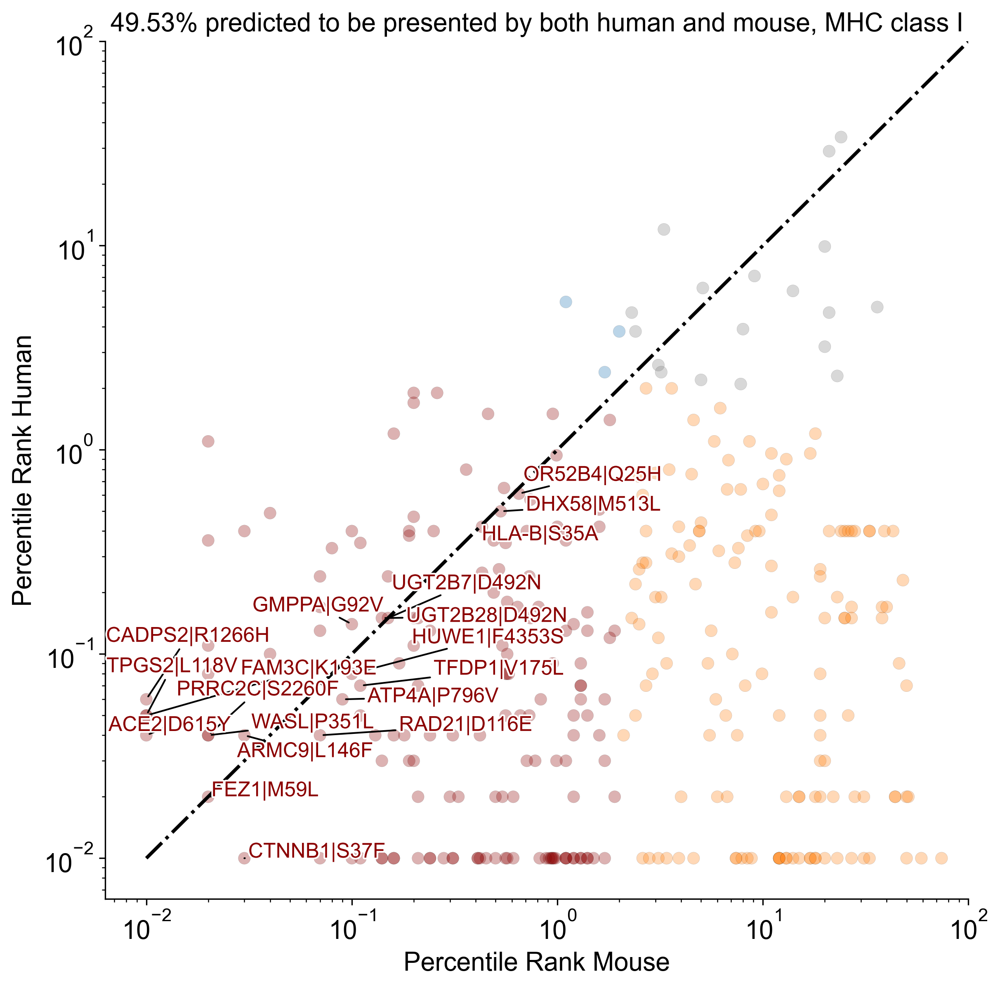

In [85]:
l_plot = l_best
bbb1 = l_plot[[abs(x-y)<=0.05 for x,y in zip(l_plot['percentile_rank_m'],l_plot['percentile_rank'])]]
bbb2 = l_plot[(l_plot['percentile_rank'] <= .01) & (l_plot['percentile_rank_m'] >= 85)]
# top_2 = df_merged['HGVSp_h'].value_counts().index.to_list()[:2]
# bbb3 = df_merged[df_merged['HGVSp_h'].isin(top_2)]
bb2 = pd.concat((bbb1, bbb2))

x = list(bb2['percentile_rank_m'])
y = list(bb2['percentile_rank'])
t = ['|'.join([x,y]) for x,y in zip(bb2['gene_name_h'], bb2['HGVSp_h'])]
c = list(bb2['color'])

fig, ax = plt.subplots(figsize=(9, 9), dpi=300)
ax.scatter(data=l_best.sort_values('percentile_rank_m').drop_duplicates(subset='mouse_9mers'), x='percentile_rank_m', y='percentile_rank', c = 'color',alpha=.3, s=50, edgecolor='black', linewidths=.1)
plt.xscale('log')
plt.yscale('log')
ax.plot([0.01, 100], [.01, 100], linewidth=2, linestyle='-.', color='black')

ax.set_xlim(0, 100)
ax.set_ylim(0, 100)
ax.set_ylabel(f"Percentile Rank Human", fontsize=15)
ax.set_xlabel("Percentile Rank Mouse", fontsize=15)

l_1 = len(l_best)
l_2 = len(l_best[l_best['class']=='both'])
per=l_2/l_1*100
ax.set_title(f"{per:.2f}% predicted to be presented by both human and mouse, MHC class I", fontsize=15)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(axis='both', which='major', labelsize=15)

texts = [ax.text(x[i],y[i],t[i], fontsize=12, color=c[i], 
         path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))

plt.savefig('/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/best_h2m.svg')
plt.show()

In [63]:
import matplotlib.pyplot as plt
import matplotlib.patheffects as PathEffects

In [87]:
l_plot = l_kb

bbb1 = l_plot[[abs(x-y)<=0.05 for x,y in zip(l_plot['percentile_rank_m'],l_plot['percentile_rank'])]]
bbb2 = l_plot[(l_plot['percentile_rank'] <= .01) & (l_plot['percentile_rank_m'] >= 85)]
# top_2 = df_merged['HGVSp_h'].value_counts().index.to_list()[:2]
# bbb3 = df_merged[df_merged['HGVSp_h'].isin(top_2)]
bb2 = pd.concat((bbb1, bbb2))

x = list(bb2['percentile_rank_m'])
y = list(bb2['percentile_rank'])
t = ['|'.join([x,y]) for x,y in zip(bb2['gene_name_h'], bb2['HGVSp_h'])]
c = list(bb2['color'])

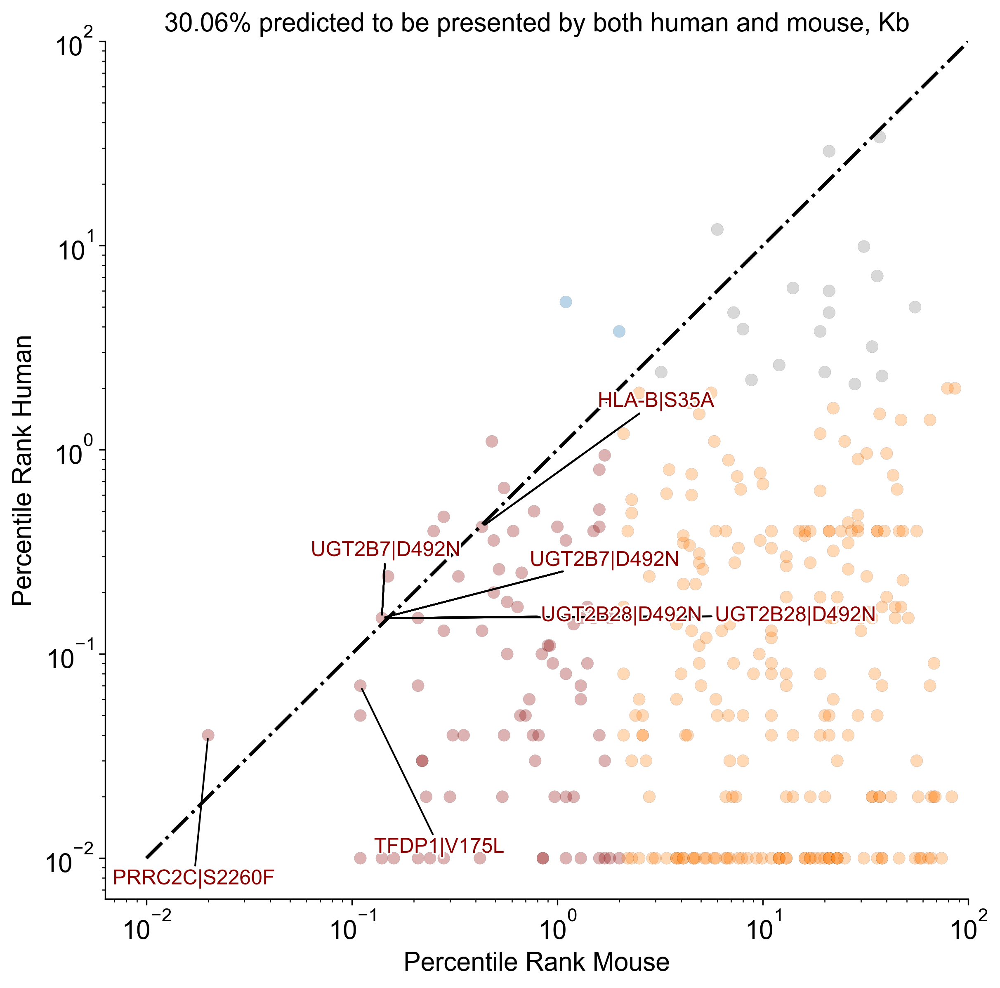

In [89]:
fig, ax = plt.subplots(figsize=(9, 9), dpi=300)
ax.scatter(data=l_plot.sort_values('percentile_rank_m').drop_duplicates(subset='mouse_9mers'), x='percentile_rank_m', y='percentile_rank', c = 'color',alpha=.3, s=50, edgecolor='black', linewidths=.1)
plt.xscale('log')
plt.yscale('log')
ax.plot([0.01, 100], [.01, 100], linewidth=2, linestyle='-.', color='black')

ax.set_xlim(0, 100)
ax.set_ylim(0, 100)
ax.set_ylabel(f"Percentile Rank Human", fontsize=15)
ax.set_xlabel("Percentile Rank Mouse", fontsize=15)

l_1 = len(l_plot)
l_2 = len(l_plot[l_plot['class']=='both'])
per=l_2/l_1*100
ax.set_title(f"{per:.2f}% predicted to be presented by both human and mouse, Kb", fontsize=15)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(axis='both', which='major', labelsize=15)

texts = [ax.text(x[i],y[i],t[i], fontsize=12, color=c[i], 
         path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))

plt.savefig('/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/kb_h2m.svg')
plt.show()

In [ ]:
l_best = l.sort_values('percentile_rank_m').drop_duplicates(subset='mouse_9mers').reset_index(drop=True)
l_kb = l[l['HLA_observed_m']=='Kb'].reset_index(drop=True)

In [ ]:
fig, ax = plt.subplots(figsize=(6, 6))
ax.scatter(data=l[(l['percentile_rank_m'] <= 2) & (l['percentile_rank'] <= 2)], x='percentile_rank_m', y='percentile_rank', alpha=.3, s=20, edgecolor='black', linewidths=.1)
plt.xscale('log')
plt.yscale('log')
ax.plot([0.01, 2], [.01, 2], linewidth=2, linestyle='-.', color='black')
plt.show()

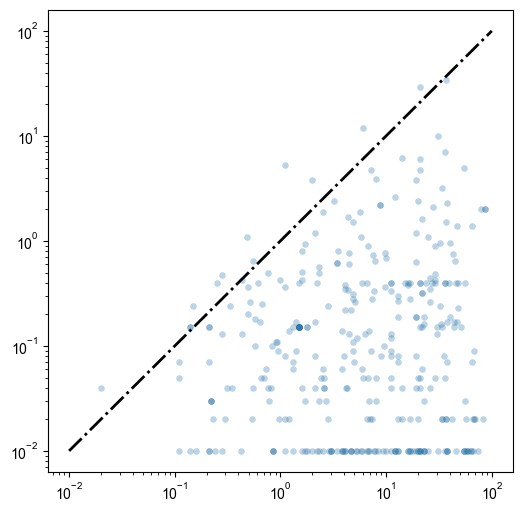

In [265]:
fig, ax = plt.subplots(figsize=(6, 6))
ax.scatter(data=l[l['HLA_observed_m'] == 'Kb'], x='percentile_rank_m', y='percentile_rank', alpha=.3, s=20, edgecolor='black', linewidths=.1)
plt.xscale('log')
plt.yscale('log')
ax.plot([0.01, 100], [.01, 100], linewidth=2, linestyle='-.', color='black')
plt.show()

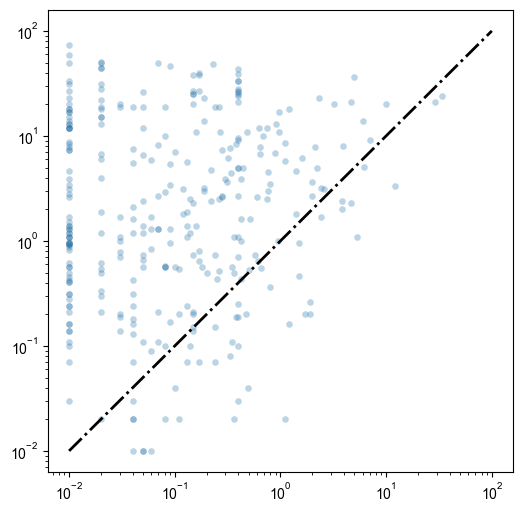

In [261]:
fig, ax = plt.subplots(figsize=(6, 6))
ax.scatter(data=l.sort_values('percentile_rank_m').drop_duplicates(subset='mouse_9mers'), x='percentile_rank', y='percentile_rank_m', alpha=.3, s=20, edgecolor='black', linewidths=.1)
plt.xscale('log')
plt.yscale('log')
ax.plot([0.01, 100], [.01, 100], linewidth=2, linestyle='-.', color='black')
plt.show()

In [139]:
def convert_to_list(input_string):
    """
    Convert a string representation of a number enclosed in brackets into a list containing the number as an integer.

    Args:
    input_string (str): The input string containing the number in brackets.

    Returns:
    list: A list containing the integer.
    """
    # Remove square brackets and convert the result to an integer
    num = int(input_string.strip("[]"))
    
    # Return the number inside a list
    return [num]

#### Mouse-to-human  
a subset of mouse-validated neoantigens -> human ones -> predict MHCpan -> calculate correlation -> colored by flank size , filtered by MHC aelle.  

#### From DMS data to mutation-derived TTA discovery -> flank_size -> splice the antigens -> propose new neoantigens  

##### read in DMS data  

In [382]:
# dms = pd.read_excel(f'/Users/kexindong/Documents/GitHub/Output/neoantigen/pnas.1613601113.sd04.xlsx',sheet_name='Table S4')
# dms.to_csv('/Users/kexindong/Documents/GitHub/Output/neoantigen/pnas.1613601113.sd04.txt', sep = '\t',index=False)

In [124]:
dms_1 = pd.read_excel('/Users/kexindong/Documents/GitHub/Output/neoantigen/mouse_dms/li_snv.xlsx', sheet_name='Sup Data File 3 SNV Oncogenes', header=1)
dms_2 = pd.read_excel('/Users/kexindong/Documents/GitHub/Output/neoantigen/mouse_dms/li_indels.xlsx', sheet_name='Sup Data File 4 INDEL Oncogenes', header=1)
dms_3 = pd.read_excel('/Users/kexindong/Documents/GitHub/Output/neoantigen/mouse_dms/niknafs.xlsx',sheet_name='Table S3', header=3)
dms_4 = pd.read_excel('/Users/kexindong/Documents/GitHub/Output/neoantigen/mouse_dms/nassar.xlsx',sheet_name='1e', header=1)

In [268]:
dms_1['source'] = 'Li 2020'
dms_2['source'] = 'Li 2020'
dms_3['source'] = 'Niknafs 2019'
dms_4['source'] = 'Nassar 2015'

In [275]:
import requests

def convert_coordinates(species, input_assembly, output_assembly, region, start, end):
    # 注意修改了URL结构，移除了region中的output_assembly部分
    url = f"https://rest.ensembl.org/map/{species}/{input_assembly}/{region}:{start}..{end}/{output_assembly}"
    headers = {'Content-Type': 'application/json'}
    
    # 发送GET请求
    response = requests.get(url, headers=headers)
    if response.status_code == 200:
        data = response.json()
        x,y = None, None
        try:
            x,y = data['mappings'][0]['mapped']['start'], data['mappings'][0]['mapped']['end']
        except:
            x,y = None, None
        return x,y
    else:
        print("Failed to retrieve data:", response.status_code)
        print(response.text)
        return None, None

In [282]:
with open('/Users/kexindong/Documents/GitHub/Output/neoantigen/bed_input.txt', 'w') as file:
    # 循环遍历数据，并写入文件
    for chr, s, e in zip(dms_4['chrom'],dms_4['start'], dms_4['stop']):
        file.write(f'{chr}   {s}  {e}\n')

In [ ]:
dms_input_1 = dms_1[['Gene symbol','Position','REF','Alt','Sample ID']]
dms_input_1.columns = ['gene_name_m','start_m','ref_seq_m','alt_seq_m','index']
dms_input_1['end_m'] =dms_input_1['start_m']
dms_input_1['index'] = [f'1_{(x+1):04}' for x in range(len(dms_input_1))]
dms_input_1['type_m'] = 'SNP'
dms_coor_1 = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/dms_1_bed.txt', sep='\t',header=0)
dms_1['Position'] = dms_coor_1['start']

In [ ]:
# 使用示例
species = 'mus_musculus'
input_assembly = 'GRCm38'
output_assembly = 'GRCm39'
list_start, list_end = [],[]
for i, x in dms_2.iterrows():
    print(f'{i}/{len(dms_2)}')
    region = str(x['Chr'])
    start = x['Start']
    end = x['End']
    tu = convert_coordinates(species, input_assembly, output_assembly, region, start, end)
    list_start.append(tu[0])
    list_end.append(tu[1])

In [256]:
# dms_coor_2 = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/neoantigen/nNsrjKlTLkU0n694.bed', sep='\t')
# dms_coor_2.columns = ['chr','start','end']
dms_2['Start'] = list_start
dms_2['End'] = list_end

In [257]:
dms_input_2 = dms_2[['Gene symbol','Start','End','Reference','Alt','Sample ID','Sequence variant type']]
dms_input_2.columns = ['gene_name_h','start_h','end_h','ref_seq_h','alt_seq_h','index', 'type_h']
dms_input_2['type_h'] = [h2m.get_type(x,y) for x,y in zip(dms_input_2['ref_seq_h'], dms_input_2['alt_seq_h'])]
dms_input_2.columns =  ['gene_name_m','start_m','end_m','ref_seq_m','alt_seq_m','index' ,'type_m']
dms_input_2['index'] = [f'2_{(x+1):04}' for x in range(len(dms_input_2))]

In [ ]:
# 使用示例
species = 'mus_musculus'
input_assembly = 'GRCm38'
output_assembly = 'GRCm39'
list_start, list_end = [],[]
for i, x in dms_3.iterrows():
    print(f'{i}/{len(dms_3)}')
    region = str(x['Chromosome'])[3:]
    start = x['Position (mm10)']
    end = x['Position (mm10)']
    tu = convert_coordinates(species, input_assembly, output_assembly, region, start, end)
    list_start.append(tu[0])
    list_end.append(tu[1])

In [ ]:
# 使用示例
species = 'mus_musculus'
input_assembly = 'GRCm38'
output_assembly = 'GRCm39'
list_start, list_end = [],[]
for i, x in dms_3.iterrows():
    print(f'{i}/{len(dms_3)}')
    region = str(x['Chromosome'])[3:]
    start = x['Position (mm10)']
    end = x['Position (mm10)']
    tu = convert_coordinates(species, input_assembly, output_assembly, region, start, end)
    list_start.append(tu[0])
    list_end.append(tu[1])

In [266]:
dms_input_3 = dms_3[['Gene Symbol','Position (mm10)','Reference Base','Alternate Base']]
# dms_coor_3 = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/neoantigen/P1xyCbSc9wkWYBBr.bed', sep='\t')
# dms_coor_3.columns = ['chr','start','end']
dms_input_3.columns = ['gene_name_m','start_m','ref_seq_m','alt_seq_m']
dms_input_3['start_m'] = list_start
dms_input_3['end_m'] = list_end
dms_input_3['index'] = [f'3_{(x+1):04}' for x in range(len(dms_input_3))]
dms_input_3['type_m'] = 'SNP'

In [ ]:
import requests
from concurrent.futures import ThreadPoolExecutor
import pandas as pd

def fetch_coordinates(data):
    url = f"https://rest.ensembl.org/map/{data['species']}/{data['input_assembly']}/{data['region']}:{data['start']}..{data['end']}/{data['output_assembly']}"
    headers = {'Content-Type': 'application/json'}
    response = requests.get(url, headers=headers)
    if response.status_code == 200:
        json_response = response.json()
        x,y = None, None
        try:
            x,y = json_response['mappings'][0]['mapped']['start'], json_response['mappings'][0]['mapped']['end']
        except:
            x,y = None, None
        return x,y
    else:
        return None, None

def process_data_frame(dms_4):
    species = 'mus_musculus'
    input_assembly = 'GRCm38'
    output_assembly = 'GRCm39'
    
    tasks = [{
        'species': species,
        'input_assembly': input_assembly,
        'output_assembly': output_assembly,
        'region': str(row['chrom'])[3:],
        'start': row['start'],
        'end': row['stop']
    } for index, row in dms_4.iterrows()]
    
    with ThreadPoolExecutor(max_workers=10) as executor:
        results = list(executor.map(fetch_coordinates, tasks))
    
    dms_4['new_start'], dms_4['new_end'] = zip(*results)
    return dms_4

# 假设dms_4是已经加载的DataFrame
dms_4_updated = process_data_frame(dms_4)
print(dms_4_updated.head())

In [290]:
dms_coor_4 = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/neoantigen/hglft_genome_21baa_bd02f0.bed', sep='\t', header=None)

In [294]:
dms_coor_4.columns = ['chr','start','end','expression','count']

In [306]:
dms_input_4 = dms_4[['gene','start','stop','ref','alt']]
dms_input_4.columns = ['gene_name_m','start_m','end_m','ref_seq_m','alt_seq_m']
dms_input_4['type_m'] = 'SNP'
dms_input_4['index'] = [f'4_{(x+1):05}' for x in range(len(dms_input_4))]
# dms_coor_4 = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/neoantigen/hglft_genome_21baa_bd02f0.bed', sep='\t')
dms_input_4['start_m'] = dms_coor_4['start']
dms_input_4['end_m'] = dms_coor_4['end']

In [307]:
dms_input_4['index'] = [f'4_{(x+1):05}' for x in range(len(dms_input_4))]
dms_input_3['index'] = [f'3_{(x+1):05}' for x in range(len(dms_input_3))]
dms_input_2['index'] = [f'2_{(x+1):05}' for x in range(len(dms_input_2))]
dms_input_1['index'] = [f'1_{(x+1):05}' for x in range(len(dms_input_1))]

In [308]:
dms_input = pd.concat([dms_input_1, dms_input_2, dms_input_3, dms_input_4]).reset_index(drop=True)
dms_input.to_csv('/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/m2h_input.csv',index=False)

In [672]:
dms_input = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/m2h_input.csv')

In [677]:
dms_input

,gene_name_m,start_m,ref_seq_m,alt_seq_m,index,end_m,type_m
0,Trp53,69480028,G,C,1_00001,69480028,SNP
1,Trp53,69480040,G,T,1_00002,69480040,SNP
2,Trp53,69481914,G,T,1_00003,69481914,SNP
3,Notch1,26356613,A,G,1_00004,26356613,SNP
4,Notch1,26371174,T,C,1_00005,26371174,SNP
...,...,...,...,...,...,...,...
17636,Zzef1,72766102,G,T,4_17391,72766102,SNP
17637,Zzef1,72813308,A,T,4_17392,72813308,SNP
17638,Zzef1,72744151,A,T,4_17393,72744151,SNP
17639,Zzz3,152133829,G,T,4_17394,152133829,SNP


In [314]:
dms = h2m.get_tx_batch(dms_input,'m')[0]

There were rows that could not be processed.


In [315]:
dms = h2m.query_batch(dms,'m2h')[0]

There were rows that could not be processed.


In [316]:
dms = h2m.get_tx_batch(dms,'h',37)[0]

No error occurs.


In [317]:
df_result = h2m.model_batch(dms, records_h, index_list_h, records_m, index_list_m, db_h, db_m, 37, direction='m2h', show_sequence=True)

There were rows that could not be processed.


In [318]:
o = df_result[0]

In [358]:
o.to_csv('/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/m2h_output.csv',index=False)

In [551]:
o = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/m2h_output.csv')

In [553]:
len(o['index'].unique())

15486

In [327]:
zip(df_final_success['flank_size_left'], df_final_success['flank_size_right'])

In [ ]:
[int(x[:-2])+int(y[:-2]) for x,y in zip(df_final_success['flank_size_left'], df_final_success['flank_size_right'])]

In [556]:
df_process = o.drop_duplicates(subset=['HGVSp_h','gene_name_h','tx_id_m']).reset_index(drop=True)
df_final_success = df_process[df_process['status']==True].reset_index(drop=True)
df_final_success = df_final_success.dropna(subset = ['flank_size_left','flank_size_right']).reset_index(drop=True)
df_final_success['flank_size_left'] = df_final_success['flank_size_left'].fillna('0aa')
df_final_success['flank_size'] = [int(x[:-2])+int(y[:-2]) for x,y in zip(df_final_success['flank_size_left'], df_final_success['flank_size_right'])]

In [557]:
df_final_success

,gene_name_m,gene_id_m,tx_id_m,chr_m,exon_num_m,strand_m,matcm,start_m,end_m,ref_seq_m,...,human_tx_idx_ori,human_p_idx_ori,human_new_p_idx_ori,dist_h,new_seq_h,human_tx_idx,human_p_idx,human_new_p_idx,index,flank_size
0,Trp53,ENSMUSG00000059552.14,ENSMUST00000108658.10,chr11,10,+,True,69480028,69480028,G,...,[733],[244],[244],NaN,ATGGAGGAGCCGCAGTCAGATCCTAGCGTCGAGCCCCCTCTGAGTC...,[733],[244],[244],1_00001,31
1,Trp53,ENSMUSG00000059552.14,ENSMUST00000108658.10,chr11,10,+,True,69480040,69480040,G,...,[745],[248],[248],NaN,ATGGAGGAGCCGCAGTCAGATCCTAGCGTCGAGCCCCCTCTGAGTC...,"[744, 745]","[248, 248]",[248],1_00002,31
2,Trp53,ENSMUSG00000059552.14,ENSMUST00000108658.10,chr11,10,+,True,69481914,69481914,G,...,[12],NaN,NaN,-280.0,AGTGGTGGGAAGTTTGGAAGTCCCTCTCTGATTGTCTTTTCCTCAA...,[12],NaN,NaN,1_00003,2
3,Notch1,ENSMUSG00000026923.16,ENSMUST00000028288.5,chr2,34,-,True,26356613,26356613,A,...,[5032],[1677],[1677],NaN,ATGCCGCCGCTCCTGGCGCCCCTGCTCTGCCTGGCGCTGCTGCCCG...,[5032],[1677],[1677],1_00004,15
4,Notch1,ENSMUSG00000026923.16,ENSMUST00000028288.5,chr2,34,-,True,26371174,26371174,T,...,[910],[303],[303],NaN,ATGCCGCCGCTCCTGGCGCCCCTGCTCTGCCTGGCGCTGCTGCCCG...,[910],[303],[303],1_00005,86
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14010,Zzef1,ENSMUSG00000055670.15,ENSMUST00000207107.2,chr11,55,+,True,72766057,72766057,G,...,[4588],[1529],[1529],NaN,ATGGGGAACGCTCCGAGTCACAGCAGTGAAGACGAAGCGGCAGCTG...,[4588],[1529],[1529],4_17390,23
14011,Zzef1,ENSMUSG00000055670.15,ENSMUST00000207107.2,chr11,55,+,True,72766102,72766102,G,...,[4633],[1544],[1544],NaN,ATGGGGAACGCTCCGAGTCACAGCAGTGAAGACGAAGCGGCAGCTG...,"[4633, 4634]","[1544, 1544]",[1544],4_17391,0
14012,Zzef1,ENSMUSG00000055670.15,ENSMUST00000207107.2,chr11,55,+,True,72813308,72813308,A,...,[8731],[2910],[2910],NaN,ATGGGGAACGCTCCGAGTCACAGCAGTGAAGACGAAGCGGCAGCTG...,[8731],[2910],[2910],4_17392,47
14013,Zzz3,ENSMUSG00000039068.17,ENSMUST00000106100.9,chr3,11,+,True,152133829,152133829,G,...,[864],[288],[288],NaN,ATGGCTGCTTCCCGATCTACTCGTGTTACAAGATCAACAGTGGGGT...,[864],[288],[288],4_17394,7


##### 9-mer splicing  

In [558]:
def find_9mers_containing_position(sequence, position):
    """
    Generate all 9-mer slices from a given DNA sequence that include a specific position.

    Args:
    sequence (str): The DNA sequence.
    position (int): The 1-based position within the sequence.

    Returns:
    list: A list of all 9-mer slices including the specified position.
    """
    # Adjust position to 0-based for easier slicing
    sequence = str(h2m.Translate(sequence))
    position = position[0]

    k_mers = [""] * 9  # 初始化一个长度为9的列表，填充空字符串
    # 计算可能的9-mer的起始位置
    start_index = position - 8

    # 为每个可能的起始位置生成一个9-mer
    for i in range(9):
        if 0 <= start_index + i <= len(sequence) - 9:  # 确保起始位置合法，且可以生成完整的9-mer
            k_mer = sequence[start_index + i: start_index + i + 9]
            k_mers[i] = k_mer
    
    # Initialize list to collect 9-mers
    
    return k_mers


In [559]:
df_final_success = df_final_success.dropna(subset=['human_new_p_idx','mouse_new_p_idx']).reset_index(drop=True)

In [ ]:
# 使用apply函数生成每个位置的9-mer列表，并将列表作为新列添加
df_final_success['human_mouse_9mers'] = df_final_success.apply(
    lambda row: {
        'human_9mers': find_9mers_containing_position(row['new_seq_h'], row['human_new_p_idx']),
        'mouse_9mers': find_9mers_containing_position(row['new_seq_m'], row['mouse_new_p_idx'])
    }, axis=1)

In [375]:
def expand_row(row):
    return pd.DataFrame({
        'human_9mers': row['human_mouse_9mers']['human_9mers'],
        'mouse_9mers': row['human_mouse_9mers']['mouse_9mers'],
        'index':row['index']
    })

In [376]:
# 展开DataFrame
expanded_rows = pd.concat([expand_row(row) for index, row in df_final_success.iterrows()]).reset_index(drop=True)

In [377]:
expanded_rows['identical'] = [x==y for x,y in zip(expanded_rows['human_9mers'], expanded_rows['mouse_9mers'])]

In [378]:
expanded_rows = expanded_rows[['*' not in x for x in expanded_rows['human_9mers']]].reset_index(drop=True)
expanded_rows = expanded_rows[['*' not in x for x in expanded_rows['mouse_9mers']]].reset_index(drop=True)

In [395]:
expanded_rows = expanded_rows[[len(x)>0 for x in expanded_rows['human_9mers']]].reset_index(drop=True)
expanded_rows = expanded_rows[[len(x)>0 for x in expanded_rows['mouse_9mers']]].reset_index(drop=True)

In [403]:
k = expanded_rows[expanded_rows['human_9mers']==expanded_rows['mouse_9mers']]

In [409]:
expanded_rows[[x[0]!='4' for x in expanded_rows['index']]]

,human_9mers,mouse_9mers,index,identical
0,MCNSSCMGA,MCNSSCMGA,1_00001,True
1,CNSSCMGAM,CNSSCMGAM,1_00001,True
2,NSSCMGAMN,NSSCMGAMN,1_00001,True
3,SSCMGAMNR,SSCMGAMNR,1_00001,True
4,SCMGAMNRR,SCMGAMNRR,1_00001,True
...,...,...,...,...
1280,DSESQKEES,DSESQKEES,3_00157,True
1281,SESQKEESA,SESQKEESA,3_00157,True
1282,ESQKEESAE,ESQKEESAE,3_00157,True
1283,SQKEESAEE,SQKEESAEE,3_00157,True


In [411]:
# database 1 and 2, identical
q=k[[x[0]!='4' for x in k['index']]]

In [413]:
for index, x in q.iterrows():
    k = x['index']
    l = x['human_9mers']
    with open('/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/m2h_input_h_sub_2.txt', 'a') as file:
        file.writelines(f'>{k}\n{l}\n')
    l = x['mouse_9mers']
    with open('/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/m2h_input_m_sub_2.txt', 'a') as file:
        file.writelines(f'>{k}\n{l}\n')

In [350]:
df_final_success

,gene_name_m,gene_id_m,tx_id_m,chr_m,exon_num_m,strand_m,matcm,start_m,end_m,ref_seq_m,...,human_p_idx_ori,human_new_p_idx_ori,dist_h,new_seq_h,human_tx_idx,human_p_idx,human_new_p_idx,index,flank_size,human_mouse_9mers
0,Trp53,ENSMUSG00000059552.14,ENSMUST00000108658.10,chr11,10,+,True,69480028,69480028,G,...,[244],[244],NaN,ATGGAGGAGCCGCAGTCAGATCCTAGCGTCGAGCCCCCTCTGAGTC...,[733],[244],[244],1_00001,31,"{'human_9mers': ['MCNSSCMGA', 'CNSSCMGAM', 'NS..."
1,Trp53,ENSMUSG00000059552.14,ENSMUST00000108658.10,chr11,10,+,True,69480040,69480040,G,...,[248],[248],NaN,ATGGAGGAGCCGCAGTCAGATCCTAGCGTCGAGCCCCCTCTGAGTC...,"[744, 745]","[248, 248]",[248],1_00002,31,"{'human_9mers': ['SCMGGMNRL', 'CMGGMNRLP', 'MG..."
2,Notch1,ENSMUSG00000026923.16,ENSMUST00000028288.5,chr2,34,-,True,26356613,26356613,A,...,[1677],[1677],NaN,ATGCCGCCGCTCCTGGCGCCCCTGCTCTGCCTGGCGCTGCTGCCCG...,[5032],[1677],[1677],1_00004,15,"{'human_9mers': ['DVRGSIVYP', 'VRGSIVYPE', 'RG..."
3,Notch1,ENSMUSG00000026923.16,ENSMUST00000028288.5,chr2,34,-,True,26371174,26371174,T,...,[303],[303],NaN,ATGCCGCCGCTCCTGGCGCCCCTGCTCTGCCTGGCGCTGCTGCCCG...,[910],[303],[303],1_00005,86,"{'human_9mers': ['VDECQLMPS', 'DECQLMPSA', 'EC..."
4,Notch1,ENSMUSG00000026923.16,ENSMUST00000028288.5,chr2,34,-,True,26371195,26371195,T,...,[296],[296],NaN,ATGCCGCCGCTCCTGGCGCCCCTGCTCTGCCTGGCGCTGCTGCCCG...,[889],[296],[296],1_00006,86,"{'human_9mers': ['GQYCTEDVG', 'QYCTEDVGE', 'YC..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13982,Zzef1,ENSMUSG00000055670.15,ENSMUST00000207107.2,chr11,55,+,True,72766057,72766057,G,...,[1529],[1529],NaN,ATGGGGAACGCTCCGAGTCACAGCAGTGAAGACGAAGCGGCAGCTG...,[4588],[1529],[1529],4_17390,23,"{'human_9mers': ['PTRRPPFTP', 'TRRPPFTPG', 'RR..."
13983,Zzef1,ENSMUSG00000055670.15,ENSMUST00000207107.2,chr11,55,+,True,72766102,72766102,G,...,[1544],[1544],NaN,ATGGGGAACGCTCCGAGTCACAGCAGTGAAGACGAAGCGGCAGCTG...,"[4633, 4634]","[1544, 1544]",[1544],4_17391,0,"{'human_9mers': ['SFRSMEEAM', 'FRSMEEAML', 'RS..."
13984,Zzef1,ENSMUSG00000055670.15,ENSMUST00000207107.2,chr11,55,+,True,72813308,72813308,A,...,[2910],[2910],NaN,ATGGGGAACGCTCCGAGTCACAGCAGTGAAGACGAAGCGGCAGCTG...,[8731],[2910],[2910],4_17392,47,"{'human_9mers': ['FFVTENRAL', 'FVTENRALE', 'VT..."
13985,Zzz3,ENSMUSG00000039068.17,ENSMUST00000106100.9,chr3,11,+,True,152133829,152133829,G,...,[288],[288],NaN,ATGGCTGCTTCCCGATCTACTCGTGTTACAAGATCAACAGTGGGGT...,[864],[288],[288],4_17394,7,"{'human_9mers': ['KIVTACLPL', 'IVTACLPLE', 'VT..."


In [414]:
result_h_i = pd.read_csv(f'/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/m2h_result_h_identical_sub.txt', header=0, sep='\t', comment="#")

In [415]:
result_h_i['allele'] = [x[4:] for x in result_h_i['allele']]
result_h_i['allele'] = [''.join(str(x).split('*')) for x in result_h_i['allele']]

In [ ]:
# result_h_i_unique = result_h_i.sort_values(by='score', ascending=False).reset_index(drop=True).drop_duplicates(subset='peptide')

In [417]:
g = pd.merge(q,result_h_i[['allele','peptide','score','percentile_rank']].rename(columns={'peptide':'human_9mers',
                                                                                                           'allele':'HLA_observed'}),how='left')

In [418]:
g

,human_9mers,mouse_9mers,index,identical,HLA_observed,score,percentile_rank
0,MCNSSCMGA,MCNSSCMGA,1_00001,True,B51:01,0.000328,28.0
1,MCNSSCMGA,MCNSSCMGA,1_00001,True,A02:01,0.000245,25.0
2,CNSSCMGAM,CNSSCMGAM,1_00001,True,B51:01,0.000082,45.0
3,CNSSCMGAM,CNSSCMGAM,1_00001,True,A02:01,0.000014,61.0
4,NSSCMGAMN,NSSCMGAMN,1_00001,True,B51:01,0.000011,75.0
...,...,...,...,...,...,...,...
1209,ESQKEESAE,ESQKEESAE,3_00157,True,A02:01,0.000007,71.0
1210,SQKEESAEE,SQKEESAEE,3_00157,True,A02:01,0.000706,16.0
1211,SQKEESAEE,SQKEESAEE,3_00157,True,B51:01,0.000080,45.0
1212,QKEESAEEL,QKEESAEEL,3_00157,True,B51:01,0.002125,14.0


In [419]:
result_m_i = pd.read_csv(f'/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/m2h_result_m_identical_sub.txt', header=0, sep='\t', comment="#")

In [420]:
result_m_i['allele'] = [x[4:] for x in result_m_i['allele']]

In [421]:
result_m_i['allele'] = [''.join(str(x).split('*')) for x in result_m_i['allele']]

In [422]:
gg = pd.merge(g,result_m_i[['allele','peptide','score','percentile_rank']].rename(columns={'peptide':'mouse_9mers',
                                                                                                           'allele':'HLA_observed_m',
                                                                                                           'percentile_rank':'percentile_rank_m',
                                                                                                           'score':'score_m'}),how='left')

In [424]:
def dict_score_class(h,m):
    if h <= 2 and m <=2:
        return 'both'
    elif m>2:
        if h<=2:
            return 'honly'
        else:
            return 'neither'
    else:
        return 'monly'
    
dict_color_class = {
    'both':'darkred',
    'honly':'tab:orange',
    'monly':'tab:blue',
    'neither':'grey'
}

In [433]:
gg['class'] = [dict_score_class(h,m) for h,m in zip(gg['percentile_rank'], gg['percentile_rank_m'])]
gg['color'] = [dict_color_class[x] for x in gg['class'] ]
gg = pd.merge(df_final_success[['gene_name_h','HGVSp_h','index']], gg, how='right')

In [440]:
gg

,gene_name_h,HGVSp_h,index,human_9mers,mouse_9mers,identical,HLA_observed,score,percentile_rank,HLA_observed_m,score_m,percentile_rank_m,class,color
0,TP53,G245A,1_00001,MCNSSCMGA,MCNSSCMGA,True,B51:01,0.000328,28.0,Kb,0.000173,47.0,neither,grey
1,TP53,G245A,1_00001,MCNSSCMGA,MCNSSCMGA,True,B51:01,0.000328,28.0,Kd,0.000076,52.0,neither,grey
2,TP53,G245A,1_00001,MCNSSCMGA,MCNSSCMGA,True,A02:01,0.000245,25.0,Kb,0.000173,47.0,neither,grey
3,TP53,G245A,1_00001,MCNSSCMGA,MCNSSCMGA,True,A02:01,0.000245,25.0,Kd,0.000076,52.0,neither,grey
4,TP53,G245A,1_00001,CNSSCMGAM,CNSSCMGAM,True,B51:01,0.000082,45.0,Kb,0.001353,19.0,neither,grey
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2423,C11orf58,E143Q,3_00157,SQKEESAEE,SQKEESAEE,True,B51:01,0.000080,45.0,Kd,0.000246,34.0,neither,grey
2424,C11orf58,E143Q,3_00157,QKEESAEEL,QKEESAEEL,True,B51:01,0.002125,14.0,Kd,0.003623,9.1,neither,grey
2425,C11orf58,E143Q,3_00157,QKEESAEEL,QKEESAEEL,True,B51:01,0.002125,14.0,Kb,0.001123,21.0,neither,grey
2426,C11orf58,E143Q,3_00157,QKEESAEEL,QKEESAEEL,True,A02:01,0.000671,17.0,Kd,0.003623,9.1,neither,grey


In [434]:
gg.to_csv('/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/m2h_neoantigen_result.csv',index=False)

In [435]:
l_identical = gg[gg['human_9mers']==gg['mouse_9mers']]
l_identical_max = gg.sort_values('percentile_rank_m').drop_duplicates(subset='mouse_9mers').reset_index(drop=True)
# l_identical_minus_2 = l_identical_max[(l_identical_max['percentile_rank_m'] <= 2) & (l_identical_max['percentile_rank'] <= 2)].drop_duplicates(subset='mouse_9mers').reset_index(drop=True)

In [506]:
l_best = gg.sort_values(['percentile_rank_m','percentile_rank']).drop_duplicates(subset=['mouse_9mers','human_9mers']).reset_index(drop=True)
# l_best = l_best.sort_values('percentile_rank').drop_duplicates(subset='human_9mers').reset_index(drop=True)
l_kb = gg[gg['HLA_observed_m']=='Kb'].reset_index(drop=True)
l_kb = l_kb.sort_values('percentile_rank').drop_duplicates(subset='human_9mers').reset_index(drop=True)

In [507]:
from scipy.stats import spearmanr
correlation, p_value = spearmanr(list(l_best['percentile_rank_m']), list(l_best['percentile_rank']))

print("Spearman correlation coefficient:", correlation)
print("P-value of the correlation:", p_value)

Spearman correlation coefficient: 0.7047927183147008
P-value of the correlation: 2.858844003223067e-92


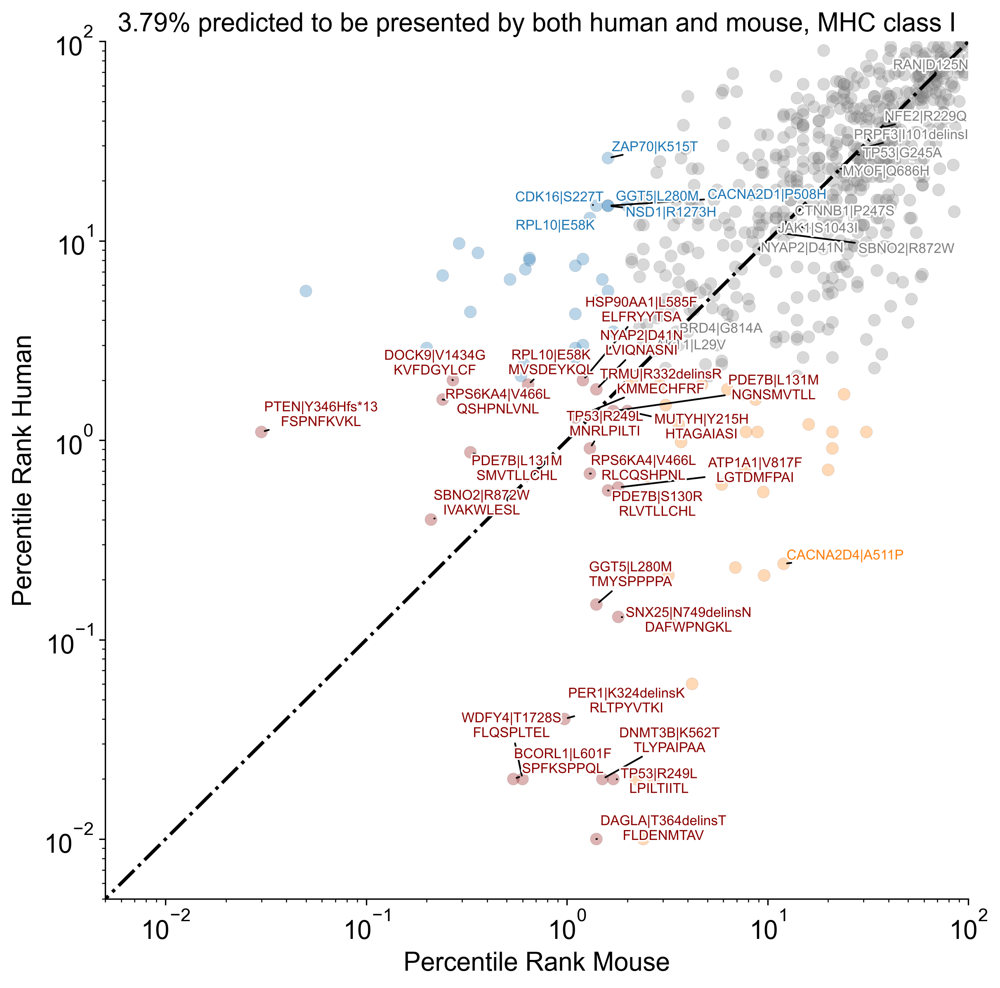

In [516]:
l_plot = l_best
bbb1 = l_plot[[abs(x-y)<=0.1 for x,y in zip(l_plot['percentile_rank_m'],l_plot['percentile_rank'])]]
bbb2 = l_plot[(l_plot['percentile_rank'] <= .5) & (l_plot['percentile_rank_m'] >= 12)]
# top_2 = df_merged['HGVSp_h'].value_counts().index.to_list()[:2]
bbb3 = l_plot[(l_plot['percentile_rank'] >= 10) & (l_plot['percentile_rank_m'] <= 2)]
bb2 = pd.concat((bbb1, bbb2,bbb3))

x = list(bb2['percentile_rank_m'])
y = list(bb2['percentile_rank'])
t = ['|'.join([x,y]) for x,y in zip(bb2['gene_name_h'], bb2['HGVSp_h'])]
c = list(bb2['color'])

bb3 = l_plot[(l_plot['percentile_rank'] <= 2) & (l_plot['percentile_rank_m'] <= 2)].reset_index(drop=True)

xx = list(bb3['percentile_rank_m'])
yy = list(bb3['percentile_rank'])
tt = [f'{x}|{y}\n{z}' for x,y,z in zip(bb3['gene_name_h'], bb3['HGVSp_h'],  bb3['human_9mers'])]
cc = list(bb3['color'])


fig, ax = plt.subplots(figsize=(9, 9), dpi=300)
ax.scatter(data=l_best.sort_values('percentile_rank_m').drop_duplicates(subset='mouse_9mers'), x='percentile_rank_m', y='percentile_rank', c = 'color',alpha=.3, s=50, edgecolor='black', linewidths=.1)
plt.xscale('log')
plt.yscale('log')
ax.plot([0, 100], [0, 100], linewidth=2, linestyle='-.', color='black')

ax.set_xlim(.005, 100)
ax.set_ylim(.005, 100)
ax.set_ylabel(f"Percentile Rank Human", fontsize=15)
ax.set_xlabel("Percentile Rank Mouse", fontsize=15)

l_1 = len(l_best)
l_2 = len(l_best[l_best['class']=='both'])
per=l_2/l_1*100
ax.set_title(f"{per:.2f}% predicted to be presented by both human and mouse, MHC class I", fontsize=15)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(axis='both', which='major', labelsize=15)

texts_1 = [ax.text(x[i],y[i],t[i], fontsize=8, color=c[i], 
         path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]

texts_2 = [ax.text(xx[i],yy[i],tt[i], fontsize=8, color=cc[i], 
         path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(xx))]
adjust_text(texts_1,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
adjust_text(texts_2,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
# plt.savefig('/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/best_h2m.svg')
plt.show()

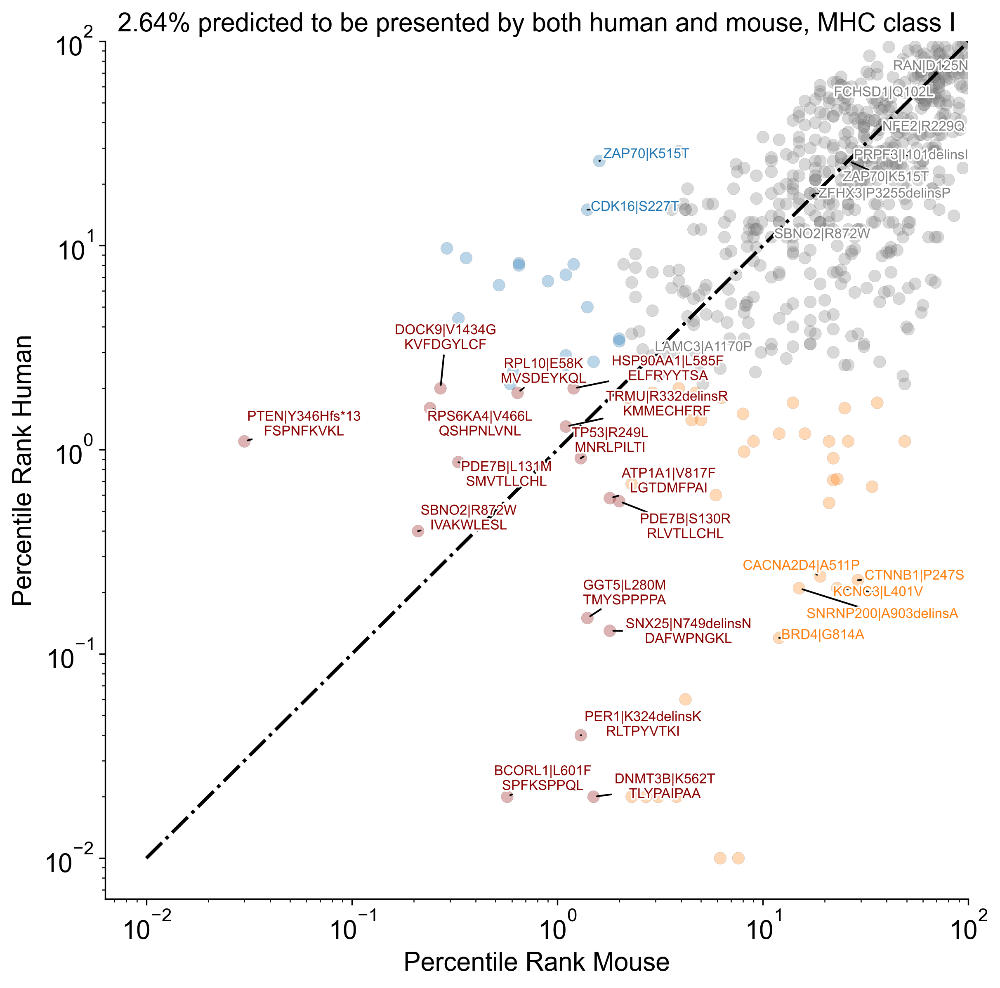

In [515]:
l_plot = l_kb
bbb1 = l_plot[[abs(x-y)<=0.1 for x,y in zip(l_plot['percentile_rank_m'],l_plot['percentile_rank'])]]
bbb2 = l_plot[(l_plot['percentile_rank'] <= .5) & (l_plot['percentile_rank_m'] >= 12)]
# top_2 = df_merged['HGVSp_h'].value_counts().index.to_list()[:2]
bbb3 = l_plot[(l_plot['percentile_rank'] >= 12) & (l_plot['percentile_rank_m'] <= 1.8)]
bb2 = pd.concat((bbb1, bbb2,bbb3))

x = list(bb2['percentile_rank_m'])
y = list(bb2['percentile_rank'])
t = ['|'.join([x,y]) for x,y in zip(bb2['gene_name_h'], bb2['HGVSp_h'])]
c = list(bb2['color'])

bb3 = l_plot[(l_plot['percentile_rank'] <= 2) & (l_plot['percentile_rank_m'] <= 2)].reset_index(drop=True)

xx = list(bb3['percentile_rank_m'])
yy = list(bb3['percentile_rank'])
tt = [f'{x}|{y}\n{z}' for x,y,z in zip(bb3['gene_name_h'], bb3['HGVSp_h'],  bb3['human_9mers'])]
cc = list(bb3['color'])


fig, ax = plt.subplots(figsize=(9, 9), dpi=300)
ax.scatter(data=l_kb.sort_values('percentile_rank_m'), x='percentile_rank_m', y='percentile_rank', c = 'color',alpha=.3, s=50, edgecolor='black', linewidths=.1)
plt.xscale('log')
plt.yscale('log')
ax.plot([0.01, 100], [.01, 100], linewidth=2, linestyle='-.', color='black')

ax.set_xlim(0, 100)
ax.set_ylim(0, 100)
ax.set_ylabel(f"Percentile Rank Human", fontsize=15)
ax.set_xlabel("Percentile Rank Mouse", fontsize=15)

l_1 = len(l_kb)
l_2 = len(l_kb[l_kb['class']=='both'])
per=l_2/l_1*100
ax.set_title(f"{per:.2f}% predicted to be presented by both human and mouse, MHC class I", fontsize=15)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(axis='both', which='major', labelsize=15)

texts_1 = [ax.text(x[i],y[i],t[i], fontsize=8, color=c[i], 
         path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]

texts_2 = [ax.text(xx[i],yy[i],tt[i], fontsize=8, color=cc[i], 
         path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(xx))]
adjust_text(texts_1,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
adjust_text(texts_2,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))

# plt.savefig('/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/best_h2m.svg')
plt.show()

In [478]:
predicted_new_neoantigens = gg[gg['color']=='darkred']

In [519]:
predicted_new_neoantigens.to_csv('/Users/kexindong/Documents/GitHub/Output/neoantigen/final_result/m2h_neoantigen_both.csv',index=False)

In [480]:
predicted_new_neoantigens = predicted_new_neoantigens.reset_index(drop=True)
predicted_new_neoantigens['reported'] = False
len(predicted_new_neoantigens['human_9mers'].unique())
predicted_new_neoantigens.loc[8,'reported'] = 'IEDB 1889473'

# Paralog  

In [4]:
paralog = pd.read_excel('/Users/kexindong/Documents/GitHub/Output/paralog/cell_report_2021.xlsx', sheet_name = 'Table_S1', header=1)
paralog = paralog.dropna().reset_index(drop=True)
x = [x.split('|') for x in paralog['paralog_pair']]
df_paralog = pd.DataFrame(x).drop_duplicates()
df_paralog.columns = ['gene1','gene2']
df_paralog_2 = df_paralog[['gene2','gene1']]
df_paralog_2.columns = ['gene1','gene2']
df_paralog = pd.concat([df_paralog,df_paralog_2])

df_paralog = df_paralog.reset_index(drop=True)
dict_paralog = dict(zip(df_paralog['gene1'],df_paralog['gene2']))

In [5]:
df_binded = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/h2m_database/database-output-final/df_result_cleaned_v3.csv')
df_binded = df_binded.drop_duplicates(subset='ID_human')
df_binded = df_binded.reset_index(drop=True)
df_binded = df_binded[df_binded['gene_name_h'].isin(dict_paralog.keys())].reset_index(drop=True)

In [6]:
df_binded = df_binded[df_binded['Database']=='AACR'].reset_index(drop=True)
df_binded = df_binded[['gene_name_h','gene_id_h','tx_id_h','start_h','end_h','ref_seq_h','alt_seq_h', 'type_h','ID_human']]

In [7]:
df_binded['gene_name_m'] = [dict_paralog[x] for x in df_binded['gene_name_h']]
df_binded['tx_id_m'] = [h2m.dict_tx_h[x][0] for x in df_binded['gene_name_m']]

In [565]:
aacr = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/h2m_database/aacr_input_original.csv')

In [566]:
set_ = set(aacr[aacr['count']>=3]['ID'])

In [568]:
len(set_)

116315

In [14]:
df_binded_run = df_binded[df_binded['ID_human'].isin(set_)].reset_index(drop=True)

In [15]:
df_binded_run['index'] = df_binded_run['ID_human']

In [16]:
df_binded_run.sort_values(by=['tx_id_h','tx_id_m'])

,gene_name_h,gene_id_h,tx_id_h,start_h,end_h,ref_seq_h,alt_seq_h,type_h,ID_human,gene_name_m,tx_id_m,index
10948,MAPK1,ENSG00000100030.10,ENST00000215832.6,22221709,22221714,CCGCCG,-,DEL,AACR-H0037787,MAPK3,ENST00000263025.4,AACR-H0037787
10949,MAPK1,ENSG00000100030.10,ENST00000215832.6,22221711,22221712,-,C,INS,AACR-H0052790,MAPK3,ENST00000263025.4,AACR-H0052790
10950,MAPK1,ENSG00000100030.10,ENST00000215832.6,22142589,22142590,-,T,INS,AACR-H0102059,MAPK3,ENST00000263025.4,AACR-H0102059
10951,MAPK1,ENSG00000100030.10,ENST00000215832.6,22162138,22162139,-,A,INS,AACR-H0100920,MAPK3,ENST00000263025.4,AACR-H0100920
10952,MAPK1,ENSG00000100030.10,ENST00000215832.6,22221708,22221709,-,CCG,INS,AACR-H0001560,MAPK3,ENST00000263025.4,AACR-H0001560
...,...,...,...,...,...,...,...,...,...,...,...,...
9225,ITGB3,ENSG00000259207.3,ENST00000559488.1,45360896,45360896,T,C,SNP,AACR-H0057442,ITGB5,ENST00000296181.4,AACR-H0057442
9226,ITGB3,ENSG00000259207.3,ENST00000559488.1,45384910,45384910,C,T,SNP,AACR-H0092886,ITGB5,ENST00000296181.4,AACR-H0092886
13211,RHOT1,ENSG00000126858.12,ENST00000580392.1,30580135,30580135,C,T,SNP,AACR-H0018250,RHOT2,ENST00000315082.4,AACR-H0018250
13213,RHOT1,ENSG00000126858.12,ENST00000580392.1,30580129,30580129,C,T,SNP,AACR-H0050059,RHOT2,ENST00000315082.4,AACR-H0050059


In [17]:
df_result, df_fail = h2m.model_batch(df_binded_run, records_h, index_list_h, records_h, index_list_h, db_h, db_h, 37, direction='h2h', memory_size=100)
df_result.to_csv('/Users/kexindong/Documents/GitHub/Output/paralog/h2h_result.csv',index=False)

There were rows that could not be processed.


In [570]:
df_result = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/paralog/h2h_result.csv')

In [590]:
df_result[df_result['status']==True]

,gene_name_h_1,gene_id_h_1,tx_id_h_1,chr_h_1,exon_num_h_1,strand_h_1,match_1,start_h_1,end_h_1,ref_seq_h_1,...,alt_seq_h_2_ori,HGVSc_h_2_ori,HGVSp_h_2_ori,start_h_2,end_h_2,ref_seq_h_2,alt_seq_h_2,HGVSc_h_2,HGVSp_h_2,index
0,IDH1,ENSG00000138413.9,ENST00000345146.2,chr2,8,-,True,209113112,209113112,C,...,T,ENST00000330062.3:c.515G>A,R172K,90631837.0,90631839.0,CCT,GTG,ENST00000330062.3:c.514_516AGG>CAC,R172H,AACR-H0000009
1,IDH1,ENSG00000138413.9,ENST00000345146.2,chr2,8,-,True,209113112,209113112,C,...,T,ENST00000330062.3:c.515G>A,R172K,90631837.0,90631839.0,CCT,ATG,ENST00000330062.3:c.514_516AGG>CAT,R172H,AACR-H0000009
2,IDH1,ENSG00000138413.9,ENST00000345146.2,chr2,8,-,True,209113113,209113113,G,...,A,ENST00000330062.3:c.514A>T,R172W,90631837.0,90631839.0,CCT,GCA,ENST00000330062.3:c.514_516AGG>TGC,R172C,AACR-H0000031
3,IDH1,ENSG00000138413.9,ENST00000345146.2,chr2,8,-,True,209113113,209113113,G,...,A,ENST00000330062.3:c.514A>T,R172W,90631837.0,90631839.0,CCT,ACA,ENST00000330062.3:c.514_516AGG>TGT,R172C,AACR-H0000031
4,IDH2,ENSG00000182054.5,ENST00000330062.3,chr15,11,-,True,90631934,90631934,C,...,T,ENST00000415913.1:c.299G>A,R100Q,209113208.0,209113208.0,C,T,ENST00000415913.1:c.299G>A,R100Q,AACR-H0000052
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19310,GATA3,ENSG00000107485.11,ENST00000346208.3,chr10,5,+,True,8111549,8111549,C,...,T,ENST00000341105.2:c.1131C>A,Y377*,128200674.0,128200674.0,G,T,ENST00000341105.2:c.1131C>A,Y377*,AACR-H0116302
19311,ARID1B,ENSG00000049618.17,ENST00000350026.5,chr6,19,+,True,157528337,157528337,G,...,A,ENST00000324856.7:c.6170G>A,R2057Q,27106558.0,27106559.0,CG,AA,ENST00000324856.7:c.6169_6170CG>AA,R2057K,AACR-H0116304
19312,ARID1B,ENSG00000049618.17,ENST00000350026.5,chr6,19,+,True,157528337,157528337,G,...,A,ENST00000324856.7:c.6170G>A,R2057Q,27106558.0,27106560.0,CGG,AAA,ENST00000324856.7:c.6169_6171CGG>AAA,R2057K,AACR-H0116304
19313,ARID1B,ENSG00000049618.17,ENST00000350026.5,chr6,19,+,True,157528347,157528347,G,...,A,ENST00000324856.7:c.6180C>A,T2060delinsT,27106569.0,27106569.0,C,A,ENST00000324856.7:c.6180C>A,T2060delinsT,AACR-H0116305


In [588]:
df_result.drop_duplicates(subset='index')['class'].value_counts()

class
0    7324
4    6014
1    2254
2     633
Name: count, dtype: int64

In [580]:
input = len(df_result.drop_duplicates(subset='index'))


In [585]:
output

10211

In [586]:
input

16225

In [584]:
output/input

0.6293374422187982

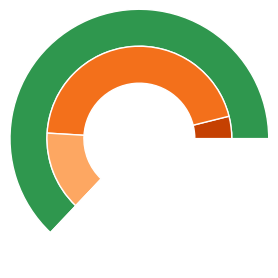

In [591]:
fig, ax = plt.subplots(figsize=(3,3), nrows = 1, ncols = 1)
output, n_0,n_1,n_2,n_3 = 7324+2254+633, 7324, 2254, 633, 0
ax.axis('equal')
mypie2, _ = ax.pie([output+n_3, input-output-n_3], radius=1.4, colors=[plt.cm.Greens(0.7),'white'], startangle=0)
plt.setp(mypie2, width=0.4, edgecolor='white')

mypie3, _ = ax.pie([n_2,n_0,n_1,n_3,input-(n_0+n_1+n_2+n_3)], radius=1, colors=[plt.cm.Oranges(0.8), plt.cm.Oranges(0.6),plt.cm.Oranges(0.4),'grey','white'], startangle=0)
plt.setp(mypie3, width=0.4, edgecolor='white')
ax.margins(0,0)

plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/database/pie_plot_paralog.pdf', bbox_inches='tight')
plt.show()

In [592]:
df_result = df_result.dropna(subset = ['flank_size_left','flank_size_right']).reset_index(drop=True)
df_result['flank_size_left'] = df_result['flank_size_left'].fillna('0aa')
df_result['flank_size'] = [int(x[:-2])+int(y[:-2]) for x,y in zip(df_result['flank_size_left'], df_result['flank_size_right'])]

In [593]:
cols_to_drop_duplicate = ['gene_name_h_1', 'gene_id_h_1', 'tx_id_h_1', 'chr_h_1', 'exon_num_h_1',
       'strand_h_1', 'match_1', 'start_h_1', 'end_h_1', 'ref_seq_h_1',
       'alt_seq_h_1', 'HGVSc_h_1', 'classification_h_1',
       'exon_h_1', 'type_h_1', 'status', 'class', 'statement',
       'flank_size_left', 'flank_size_right', 'gene_name_h_2', 'gene_id_h_2',
       'tx_id_h_2', 'chr_h_2', 'exon_num_h_2', 'strand_h_2', 'type_h_2',
       'classification_h_2', 'exon_h_2', 'start_h_2_ori', 'end_h_2_ori',
       'ref_seq_h_2_ori', 'alt_seq_h_2_ori', 'HGVSc_h_2_ori', 'HGVSp_h_2_ori',
       'start_h_2', 'end_h_2', 'ref_seq_h_2', 'alt_seq_h_2', 'HGVSc_h_2']

In [594]:
df_result['gene_name_h_1'].value_counts()

gene_name_h_1
ARID1A      904
FAT1        803
SMARCA4     759
CREBBP      730
EP300       530
           ... 
SMARCC1       1
CACNA2D3      1
PTGS2         1
KDM5C         1
PTPN2         1
Name: count, Length: 145, dtype: int64

In [595]:
df_result[df_result['gene_name_h_1']=='ARID1A']['gene_name_h_2'].value_counts()

gene_name_h_2
ARID1B    904
Name: count, dtype: int64

In [596]:
df_result[df_result['gene_name_h_1']=='SMARCA4']['class'].value_counts()

class
0    444
1    296
2     19
Name: count, dtype: int64

In [40]:
# 示例基因符号列表
gene_symbols = ["TP53", "EGFR", "BRCA1",'KIT', 'APC','KARS','ATM','KMT2D', 'SMARCA2', 'SMARCA4','IDH1', 'IDH2','ARID1A','ARID1B']

uniprot_ids = get_uniprot_ids_from_gene_symbols(gene_symbols)
for gene_symbol, uniprot_id in uniprot_ids.items():
    print(f"Gene Symbol: {gene_symbol}, UniProt ID: {uniprot_id}")

Gene Symbol: TP53, UniProt ID: P04637
Gene Symbol: EGFR, UniProt ID: P00533
Gene Symbol: BRCA1, UniProt ID: P38398
Gene Symbol: KIT, UniProt ID: P10721
Gene Symbol: APC, UniProt ID: P25054
Gene Symbol: KARS, UniProt ID: Q15046
Gene Symbol: ATM, UniProt ID: Q13315
Gene Symbol: KMT2D, UniProt ID: O14686
Gene Symbol: SMARCA2, UniProt ID: P51531
Gene Symbol: SMARCA4, UniProt ID: P51532
Gene Symbol: IDH1, UniProt ID: O75874
Gene Symbol: IDH2, UniProt ID: P48735
Gene Symbol: ARID1A, UniProt ID: O14497
Gene Symbol: ARID1B, UniProt ID: Q8NFD5


In [597]:
cols_to_drop_duplicate = ['gene_name_h_1', 'gene_id_h_1', 'tx_id_h_1', 'chr_h_1', 'exon_num_h_1',
       'strand_h_1', 'match_1', 'start_h_1', 'end_h_1', 'ref_seq_h_1',
       'alt_seq_h_1', 'HGVSc_h_1', 'classification_h_1',
       'exon_h_1', 'type_h_1', 'status', 'class', 'statement',
       'flank_size_left', 'flank_size_right', 'gene_name_h_2', 'gene_id_h_2',
       'tx_id_h_2', 'chr_h_2', 'exon_num_h_2', 'strand_h_2', 'type_h_2',
       'classification_h_2', 'exon_h_2', 'start_h_2_ori', 'end_h_2_ori',
       'ref_seq_h_2_ori', 'alt_seq_h_2_ori', 'HGVSc_h_2_ori', 'HGVSp_h_2_ori',
       'start_h_2', 'end_h_2', 'ref_seq_h_2', 'alt_seq_h_2', 'HGVSc_h_2']

In [ ]:
df_p53 = df_am[df_am['uniprot_id']=='P51532'].reset_index(drop=True)
df_p53_2 = df_am[df_am['uniprot_id']=='P51531'].reset_index(drop=True)

In [ ]:
df_p53 = df_p53.drop('uniprot_id',axis=1)
df_p53_2 = df_p53_2.drop('uniprot_id',axis=1)

In [ ]:
color_dict = {
    'pathogenic': 'darkred',
    'benign': 'darkblue',
    'ambiguous': 'grey'
}
color_dict  = color_dict.update({'DELETERIOUS':'darkblue',
                                 'TOLERATED':'darkred'})

In [603]:
# df_p53 = df_p53.drop('uniprot_id',axis=1)
df_p53.columns=['HGVSp_h_1','am_pathogenicity','am_class']
df_h2m = df_result[df_result['gene_name_h_1']=='SMARCA4'].drop_duplicates(subset='index').reset_index(drop=True)
df_h2m = df_h2m[df_h2m['classification_h_1'] == 'Missense'].reset_index(drop=True)
df_h2m = df_h2m.drop_duplicates(subset=cols_to_drop_duplicate)
df_merged_all = pd.merge(df_h2m, df_p53, how='left').dropna(subset='am_class').reset_index(drop=True)
df_merged_all['loc_h'] = [search_loc(s) for s in  df_merged_all['HGVSp_h_1']]
df_merged_all['color'] = [color_dict[x] for x in df_merged_all['am_class']]
df_merged_all['color_h2m'] = [color_dict_h2m[x] for x in df_merged_all['class']]

In [604]:
df_p53['gene_name_h_1'] = 'SMARCA4'
df_p53.columns = ['HGVSp_h_1','am_pathogenicity_1','am_class_1','gene_name_h_1']
df_p53_2['gene_name_h_2'] = 'SMARCA2'
df_p53_2.columns = ['HGVSp_h_2','am_pathogenicity_2','am_class_2','gene_name_h_2']

In [605]:
df_h2m = df_result[df_result['classification_h_1'] == 'Missense'].reset_index(drop=True)

In [606]:
df_h2m_1 = df_h2m[df_h2m['gene_name_h_1']=='SMARCA4'].reset_index(drop=True)[['gene_name_h_1','HGVSp_h_1','class','status','gene_name_h_2','HGVSp_h_2','flank_size']]
df_h2m_2 = df_h2m[df_h2m['gene_name_h_1']=='SMARCA2'].reset_index(drop=True)[['gene_name_h_1','HGVSp_h_1','class','status','gene_name_h_2','HGVSp_h_2','flank_size']]
df_h2m_2.columns = ['gene_name_h_2','HGVSp_h_2','class','status','gene_name_h_1','HGVSp_h_1','flank_size']
df_h2m = pd.concat([df_h2m_1,df_h2m_2]).reset_index(drop=True)
df_h2m

,gene_name_h_1,HGVSp_h_1,class,status,gene_name_h_2,HGVSp_h_2,flank_size
0,SMARCA4,T910M,1,True,SMARCA2,T880M,44
1,SMARCA4,R1243W,0,True,SMARCA2,R1213W,82
2,SMARCA4,R1192H,0,True,SMARCA2,R1162H,82
3,SMARCA4,R1192C,0,True,SMARCA2,R1162C,82
4,SMARCA4,E882K,0,True,SMARCA2,E852K,61
...,...,...,...,...,...,...,...
656,SMARCA4,R1445C,1,True,SMARCA2,R1370C,13
657,SMARCA4,S813L,0,True,SMARCA2,S783L,11
658,SMARCA4,F1121L,0,True,SMARCA2,F1091L,0
659,SMARCA4,D1183Y,0,True,SMARCA2,D1153Y,81


In [607]:
df_h2m = pd.merge(df_h2m, df_p53, how='left')
df_h2m = pd.merge(df_h2m, df_p53_2, how='left')

In [609]:
import matplotlib.colors as mcolors
import numpy as np

# Define the initial color dictionary
color_dict = {
    'pathogenic': 'darkred',
    'benign': 'darkblue',
    'ambiguous': 'grey'
}

# Function to blend two colors
def blend_colors(color1, color2):
    # Convert color names to RGBA
    rgb1 = np.array(mcolors.to_rgb(color1))
    rgb2 = np.array(mcolors.to_rgb(color2))
    # Calculate the average of the RGB components
    blended_rgb = (rgb1 + rgb2) / 2
    # Convert the blended RGB back to hex color code
    return mcolors.to_hex(blended_rgb)

# Create a combined color dictionary
combined_color_dict = {}
for key1 in color_dict:
    for key2 in color_dict:
        # Blend each pair of colors
        combined_color_dict[(key1, key2)] = blend_colors(color_dict[key1], color_dict[key2])

In [610]:
df_h2m['color_class'] = [color_dict_h2m[x] for x in df_h2m['class']]
df_h2m['color_score'] = df_h2m.apply(lambda row: combined_color_dict[(row['am_class_1'], row['am_class_2'])], axis=1)
df_h2m['loc_h_1'] = [search_loc(s) for s in  df_h2m['HGVSp_h_1']]
df_h2m['loc_h_2'] = [search_loc(s) for s in  df_h2m['HGVSp_h_2']]
df_h2m['color_h2m_1'] = [color_dict[x] for x in df_h2m['am_class_1']]
df_h2m['color_h2m_2'] = [color_dict[x] for x in df_h2m['am_class_2']]

In [612]:
corr, p_value = scipy.stats.spearmanr(df_h2m['am_pathogenicity_1'], df_h2m['am_pathogenicity_2'])

print("Spearman Correlation Coefficient: {:.4f}".format(corr))
print("P-value: {:.4f}".format(p_value))

Spearman Correlation Coefficient: 0.9563
P-value: 0.0000


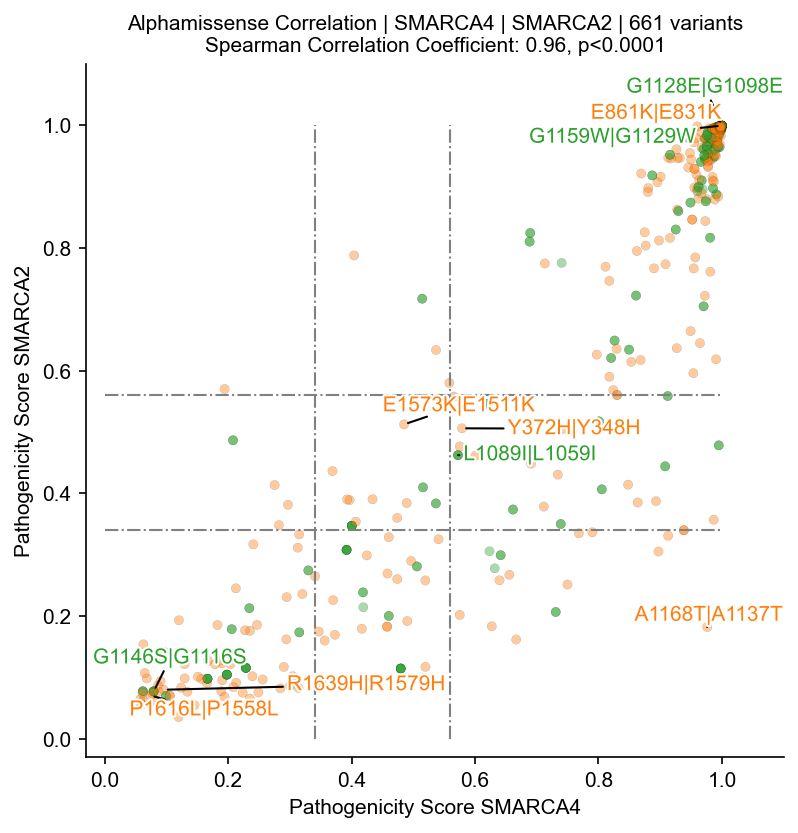

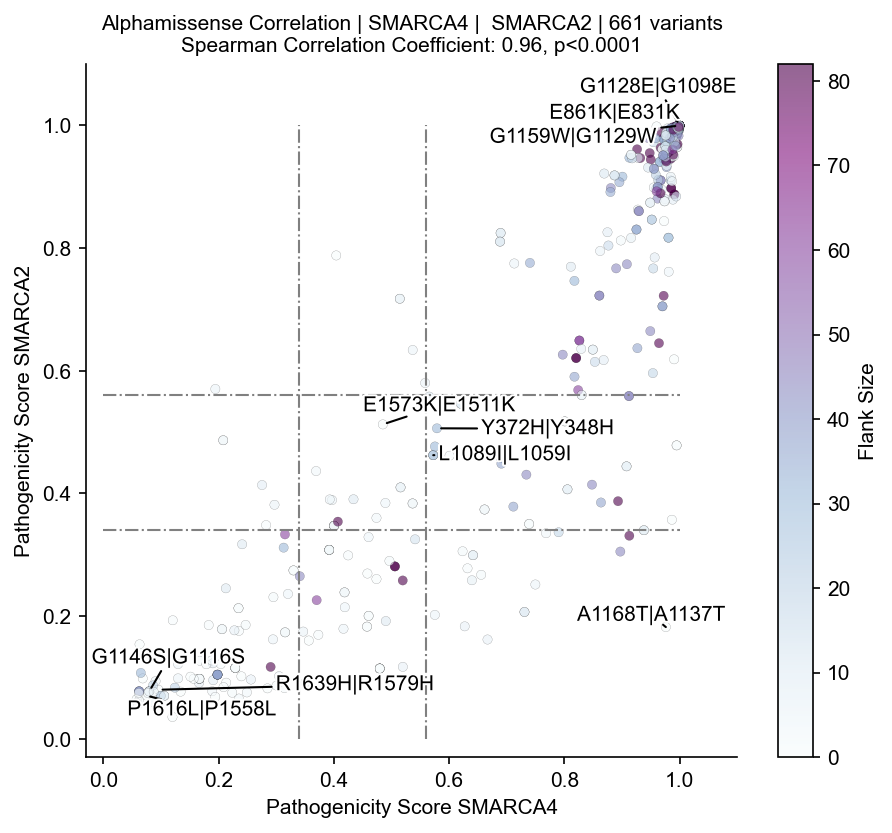

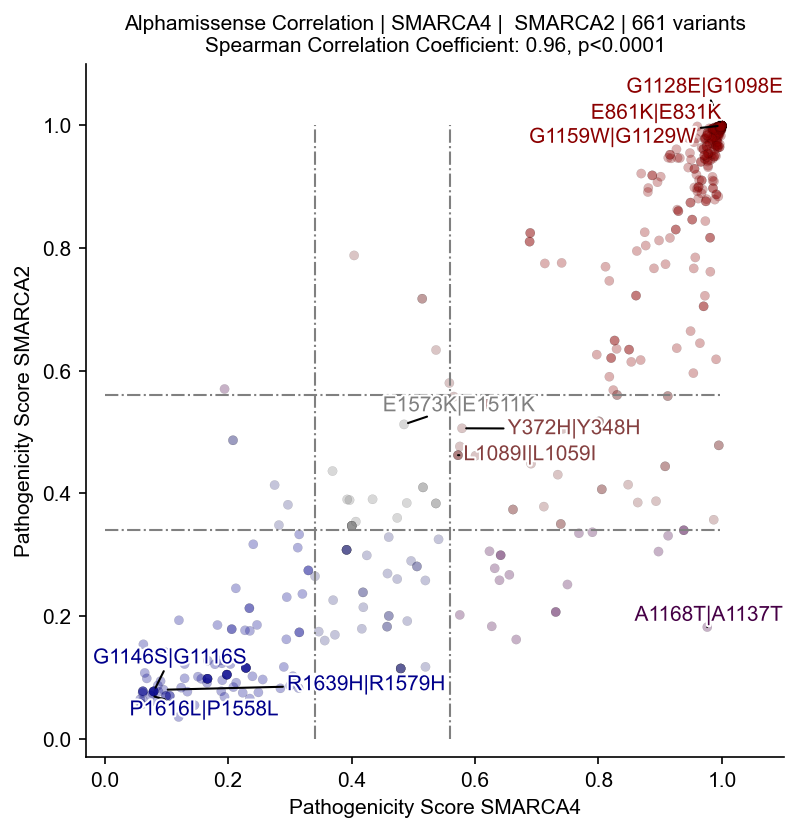

In [616]:
fig, ax = plt.subplots(figsize=(6, 6), dpi=150)
gene_1 = 'SMARCA4'
gene_2 = 'SMARCA2'

bbb1 = df_h2m[(df_h2m['am_pathogenicity_1'] >= .9997) & (df_h2m['am_pathogenicity_2'] >= .9997) &(df_h2m['status'] == True)].iloc[:3,:]
bbb2 = df_h2m[(df_h2m['am_pathogenicity_1'] >= .4) & (df_h2m['am_pathogenicity_1'] <= .6) & (df_h2m['am_pathogenicity_2'] <= .6) & (df_h2m['am_pathogenicity_2'] >= .4)].iloc[:3,:]
bbb3 = df_h2m[(df_h2m['am_pathogenicity_1'] <= .097) & (df_h2m['am_pathogenicity_2'] <= .097) &(df_h2m['status'] == True)].iloc[:3,:]
bbb4 = df_h2m[(df_h2m['am_pathogenicity_1'] <= .3) & (df_h2m['am_pathogenicity_2'] >= .8) &(df_h2m['status'] == True)].iloc[:3,:]
bbb5 = df_h2m[(df_h2m['am_pathogenicity_1'] >= .8) & (df_h2m['am_pathogenicity_2'] <= .3) &(df_h2m['status'] == True)].iloc[:3,:]

bb2 = pd.concat((bbb1, bbb2,bbb3, bbb4, bbb5))

t = [f'{x}|{y}' for x,y in zip(bb2['HGVSp_h_1'], bb2['HGVSp_h_2'])]
x = list(bb2['am_pathogenicity_1'])
y = list(bb2['am_pathogenicity_2'])
c = list(bb2['color_class'])


ax.plot([0, 1], [0.56, 0.56], linewidth=1, linestyle='-.', color='grey')
ax.plot([0, 1], [0.34, 0.34], linewidth=1, linestyle='-.', color='grey')

ax.plot( [0.56, 0.56], [0, 1],linewidth=1, linestyle='-.', color='grey')
ax.plot([0.34, 0.34], [0, 1], linewidth=1, linestyle='-.', color='grey')

ax.scatter(data=df_h2m, x='am_pathogenicity_1', y='am_pathogenicity_2', c = 'color_class', alpha=.4, s=20, edgecolor='black', linewidths=.1)

ax.set_xlim(-.03, 1.1)
ax.set_ylim(-.03, 1.1)
ax.set_ylabel(f"Pathogenicity Score {gene_2}", fontsize=10)
ax.set_xlabel(f"Pathogenicity Score {gene_1}", fontsize=10)
ax.set_title(f"Alphamissense Correlation | {gene_1} | {gene_2} | {len(df_h2m)} variants\nSpearman Correlation Coefficient: {corr:.2f}, p<0.0001", fontsize=10)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(axis='both', which='major', labelsize=10)
texts = [ax.text(x[i], y[i], t[i], fontsize=10, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/paralog/smarca_paralog_h2m_colored.pdf', bbox_inches='tight')
plt.show()


fig, ax = plt.subplots(figsize=(7, 6), dpi=150)

ax.plot([0, 1], [0.56, 0.56], linewidth=1, linestyle='-.', color='grey')
ax.plot([0, 1], [0.34, 0.34], linewidth=1, linestyle='-.', color='grey')

ax.plot( [0.56, 0.56], [0, 1],linewidth=1, linestyle='-.', color='grey')
ax.plot([0.34, 0.34], [0, 1], linewidth=1, linestyle='-.', color='grey')

g = ax.scatter(data=df_h2m, x='am_pathogenicity_1', y='am_pathogenicity_2', c = 'flank_size', alpha=.6, s=20, edgecolor='black', linewidths=.1, 
            cmap = plt.cm.BuPu)
plt.colorbar(g, label='Flank Size')

ax.set_xlim(-.03, 1.1)
ax.set_ylim(-.03, 1.1)
ax.set_ylabel(f"Pathogenicity Score {gene_2}", fontsize=10)
ax.set_xlabel(f"Pathogenicity Score {gene_1}", fontsize=10)
ax.set_title(f"Alphamissense Correlation | {gene_1} |  {gene_2} | {len(df_h2m)} variants\nSpearman Correlation Coefficient: {corr:.2f}, p<0.0001", fontsize=10)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(axis='both', which='major', labelsize=10)
texts = [ax.text(x[i], y[i], t[i], fontsize=10, color='black', path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/paralog/smarca_paralog_flank_size_colored.pdf', bbox_inches='tight')
plt.show()


fig, ax = plt.subplots(figsize=(6, 6), dpi=150)
ax.plot([0, 1], [0.56, 0.56], linewidth=1, linestyle='-.', color='grey')
ax.plot([0, 1], [0.34, 0.34], linewidth=1, linestyle='-.', color='grey')

ax.plot( [0.56, 0.56], [0, 1],linewidth=1, linestyle='-.', color='grey')
ax.plot([0.34, 0.34], [0, 1], linewidth=1, linestyle='-.', color='grey')

c = list(bb2['color_score'])
ax.scatter(data=df_h2m, x='am_pathogenicity_1', y='am_pathogenicity_2', c = 'color_score', alpha=.3, s=20, edgecolor='black', linewidths=.1)

ax.set_xlim(-.03, 1.1)
ax.set_ylim(-.03, 1.1)
ax.set_ylabel(f"Pathogenicity Score {gene_2}", fontsize=10)
ax.set_xlabel(f"Pathogenicity Score {gene_1}", fontsize=10)
ax.set_title(f"Alphamissense Correlation | {gene_1} |  {gene_2} | {len(df_h2m)} variants\nSpearman Correlation Coefficient: {corr:.2f}, p<0.0001", fontsize=10)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(axis='both', which='major', labelsize=10)
texts = [ax.text(x[i], y[i], t[i], fontsize=10, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/paralog/smarca_paralog_score_colored.pdf', bbox_inches='tight')
plt.show()

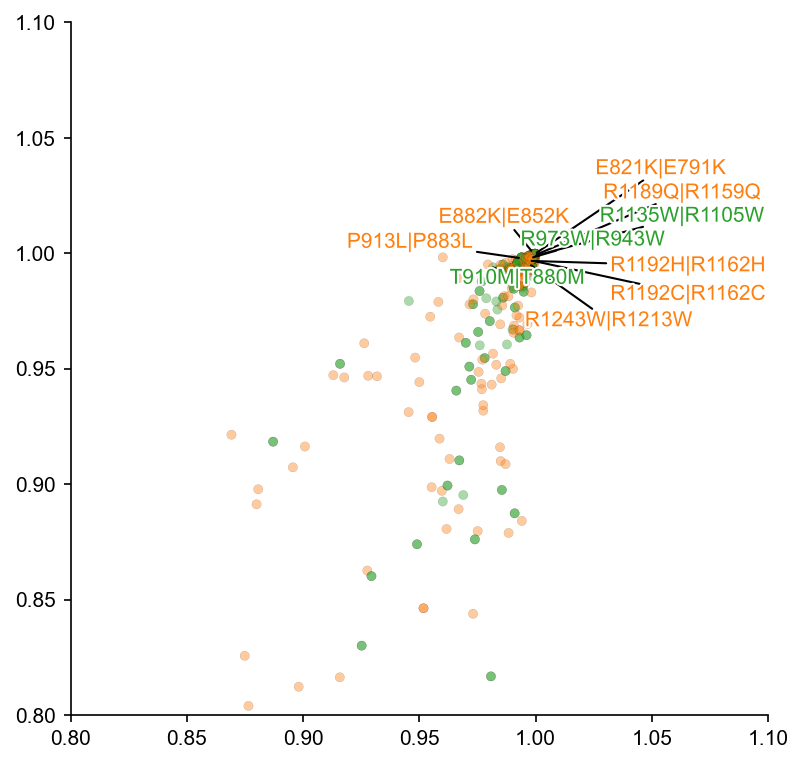

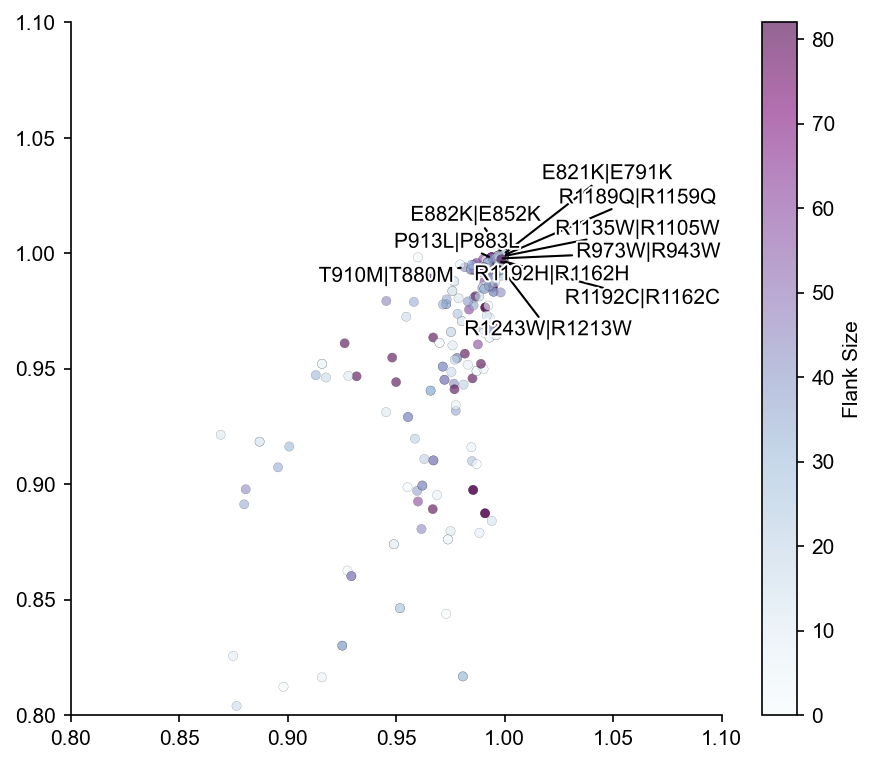

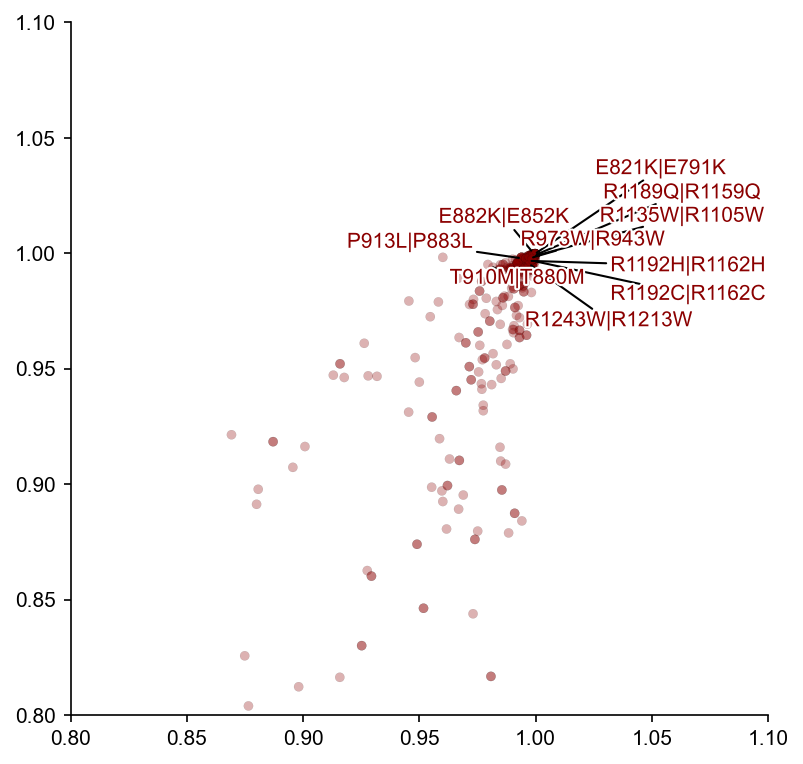

In [618]:
fig, ax = plt.subplots(figsize=(6, 6), dpi=150)
gene_1 = 'SMARCA4'
gene_2 = 'SMARCA2'

bbb1 = df_h2m[(df_h2m['am_pathogenicity_1'] >= .8) & (df_h2m['am_pathogenicity_2'] >= .8) &(df_h2m['status'] == True)].iloc[:10,:]

bb2 = bbb1

t = [f'{x}|{y}' for x,y in zip(bb2['HGVSp_h_1'], bb2['HGVSp_h_2'])]
x = list(bb2['am_pathogenicity_1'])
y = list(bb2['am_pathogenicity_2'])
c = list(bb2['color_class'])


ax.plot([0, 1], [0.56, 0.56], linewidth=1, linestyle='-.', color='grey')
ax.plot([0, 1], [0.34, 0.34], linewidth=1, linestyle='-.', color='grey')

ax.plot( [0.56, 0.56], [0, 1],linewidth=1, linestyle='-.', color='grey')
ax.plot([0.34, 0.34], [0, 1], linewidth=1, linestyle='-.', color='grey')

ax.scatter(data=df_h2m, x='am_pathogenicity_1', y='am_pathogenicity_2', c = 'color_class', alpha=.4, s=20, edgecolor='black', linewidths=.1)

ax.set_xlim(.8, 1.1)
ax.set_ylim(.8, 1.1)
ax.set_ylabel(f"", fontsize=10)
ax.set_xlabel(f"", fontsize=10)
ax.set_title(f"", fontsize=10)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(axis='both', which='major', labelsize=10)
texts = [ax.text(x[i], y[i], t[i], fontsize=10, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/paralog/smarca_paralog_h2m_colored_zoom.pdf', bbox_inches='tight')
plt.show()


fig, ax = plt.subplots(figsize=(7, 6), dpi=150)

ax.plot([0, 1], [0.56, 0.56], linewidth=1, linestyle='-.', color='grey')
ax.plot([0, 1], [0.34, 0.34], linewidth=1, linestyle='-.', color='grey')

ax.plot( [0.56, 0.56], [0, 1],linewidth=1, linestyle='-.', color='grey')
ax.plot([0.34, 0.34], [0, 1], linewidth=1, linestyle='-.', color='grey')

g = ax.scatter(data=df_h2m, x='am_pathogenicity_1', y='am_pathogenicity_2', c = 'flank_size', alpha=.6, s=20, edgecolor='black', linewidths=.1, 
            cmap = plt.cm.BuPu)
plt.colorbar(g, label='Flank Size')

ax.set_xlim(.8, 1.1)
ax.set_ylim(.8, 1.1)
ax.set_ylabel(f"", fontsize=10)
ax.set_xlabel(f"", fontsize=10)
ax.set_title(f"", fontsize=10)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(axis='both', which='major', labelsize=10)
texts = [ax.text(x[i], y[i], t[i], fontsize=10, color='black', path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/paralog/smarca_paralog_fs_colored_zoom.pdf', bbox_inches='tight')
plt.show()


fig, ax = plt.subplots(figsize=(6, 6), dpi=150)
ax.plot([0, 1], [0.56, 0.56], linewidth=1, linestyle='-.', color='grey')
ax.plot([0, 1], [0.34, 0.34], linewidth=1, linestyle='-.', color='grey')

ax.plot( [0.56, 0.56], [0, 1],linewidth=1, linestyle='-.', color='grey')
ax.plot([0.34, 0.34], [0, 1], linewidth=1, linestyle='-.', color='grey')

c = list(bb2['color_score'])
ax.scatter(data=df_h2m, x='am_pathogenicity_1', y='am_pathogenicity_2', c = 'color_score', alpha=.3, s=20, edgecolor='black', linewidths=.1)

ax.set_xlim(.8, 1.1)
ax.set_ylim(.8, 1.1)
ax.set_ylabel(f"", fontsize=10)
ax.set_xlabel(f"", fontsize=10)
ax.set_title(f"", fontsize=10)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(axis='both', which='major', labelsize=10)
texts = [ax.text(x[i], y[i], t[i], fontsize=10, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/paralog/smarca_paralog_score_colored_zoom.pdf', bbox_inches='tight')
plt.show()

In [622]:
df_merged = df_h2m

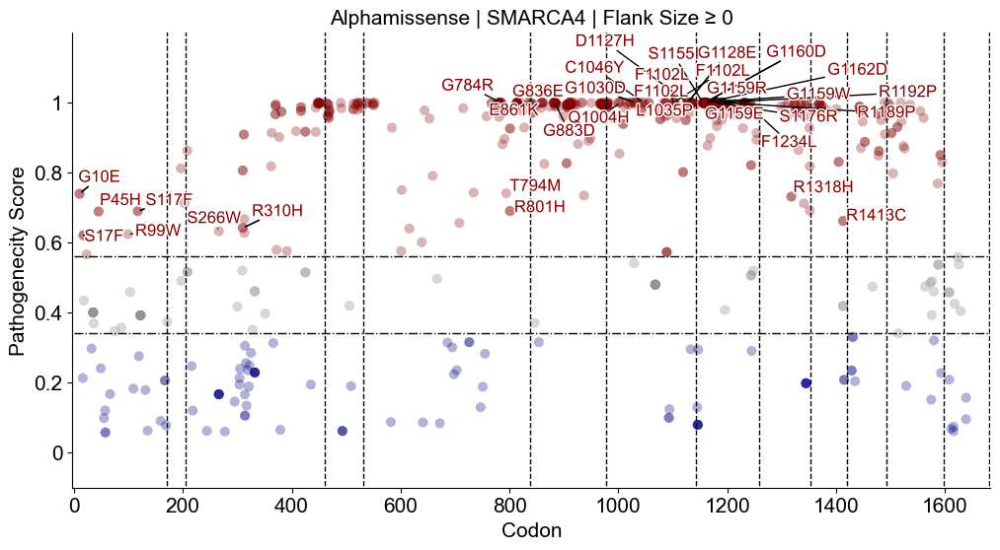

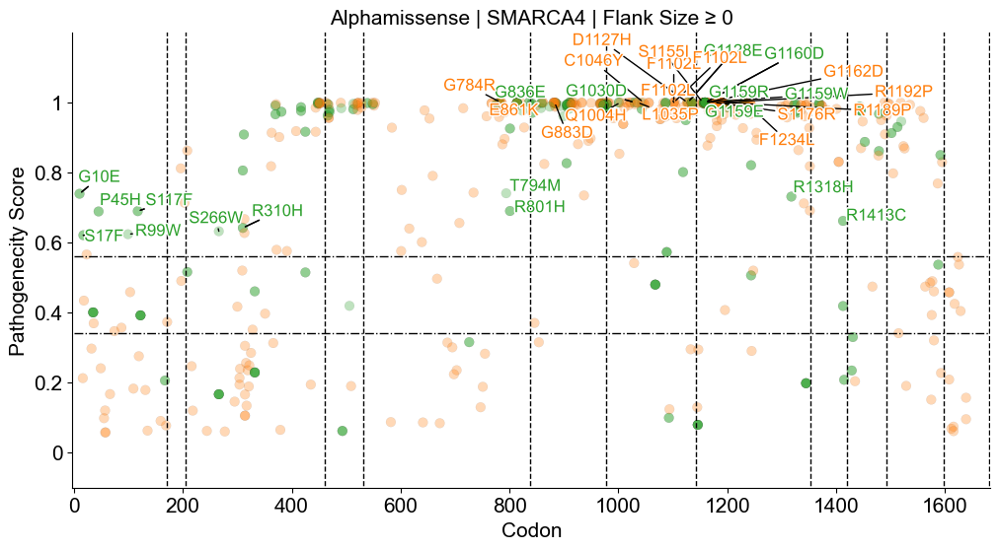

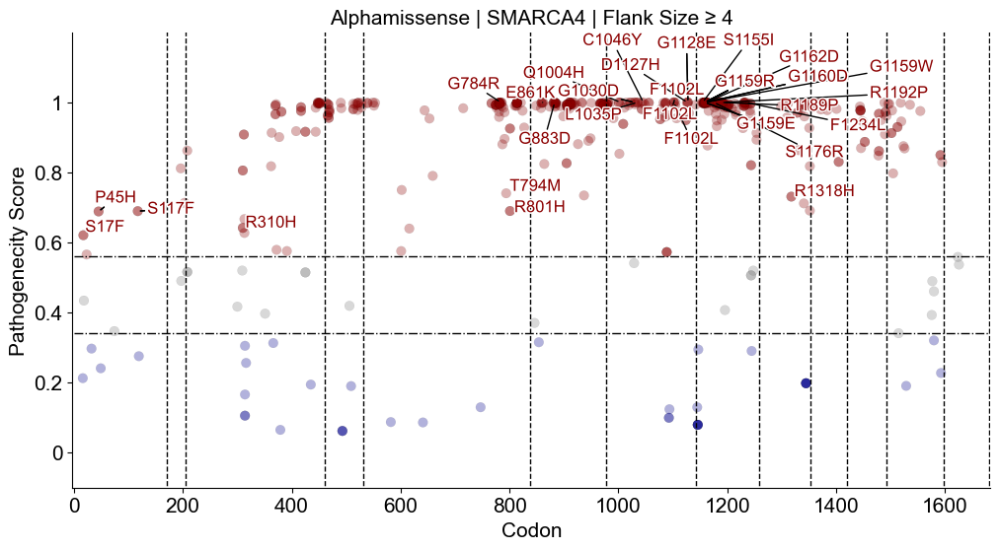

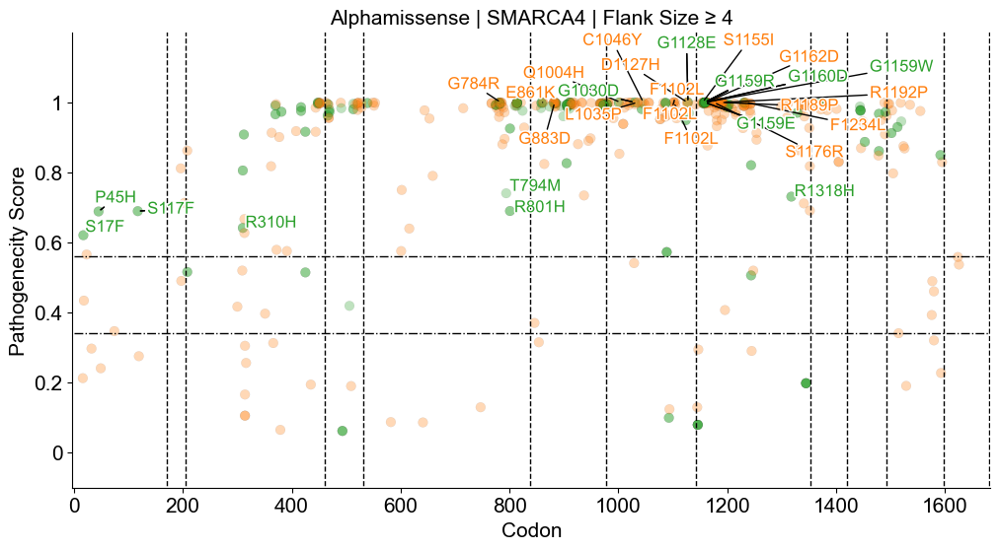

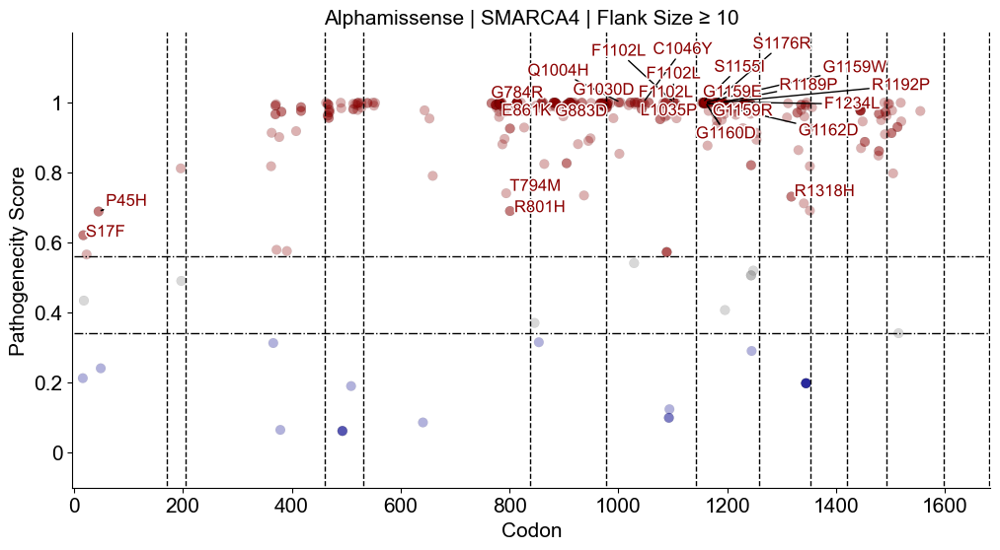

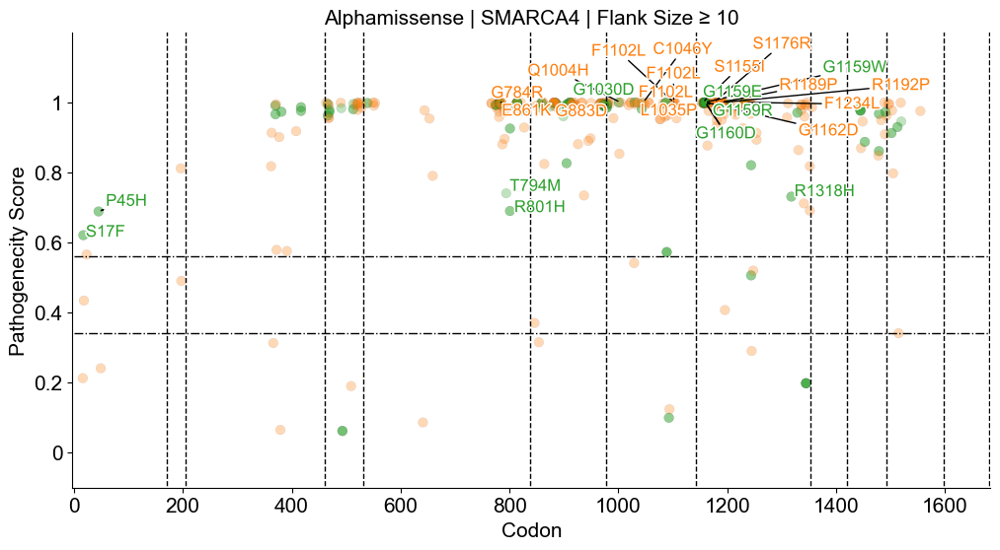

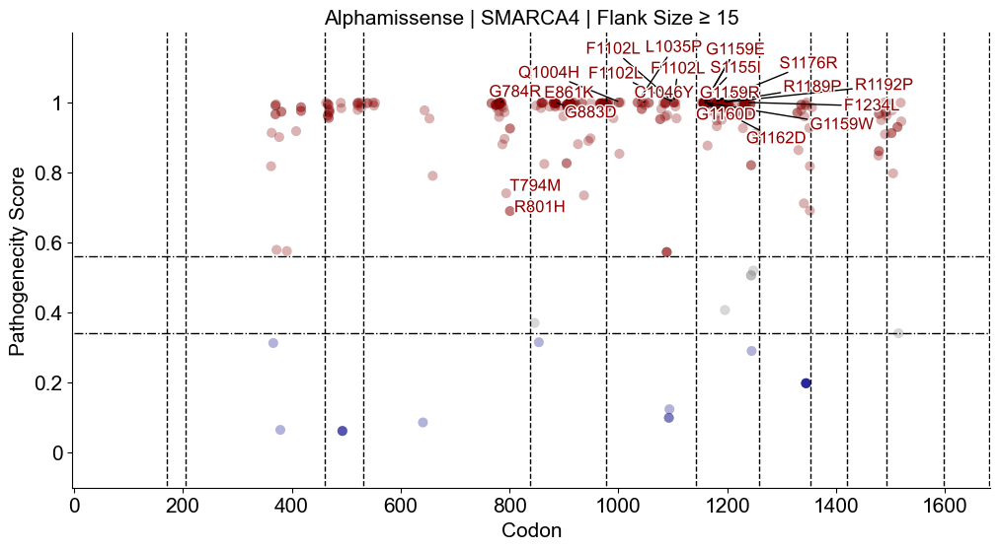

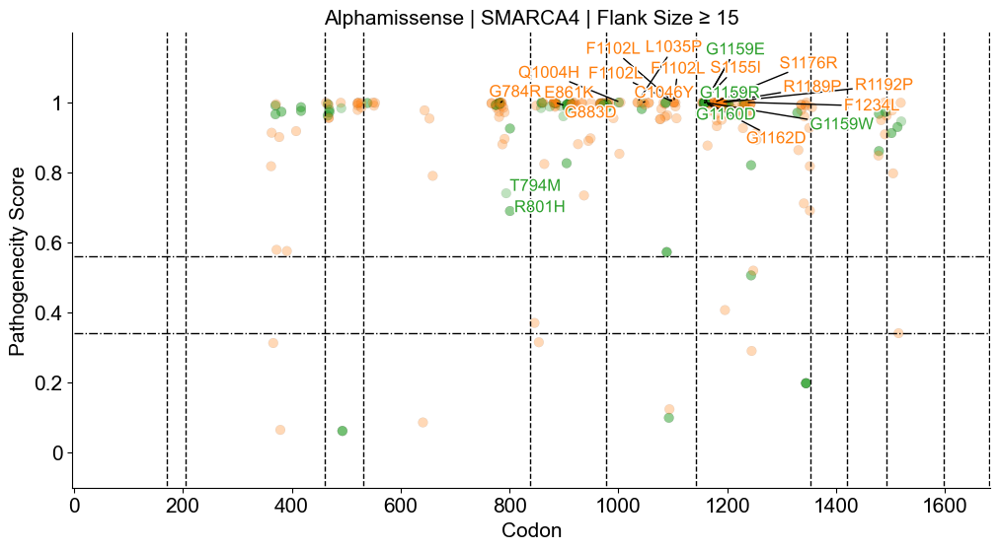

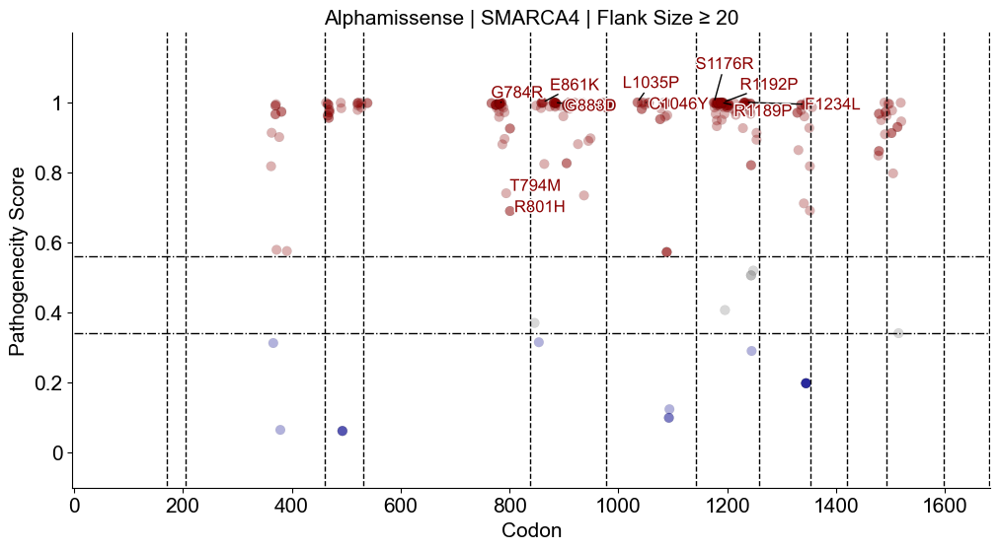

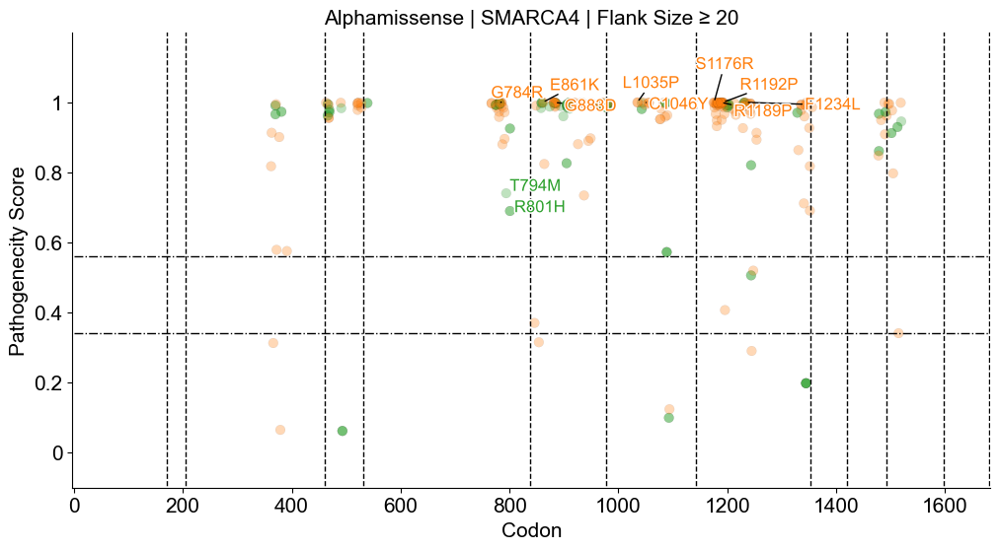

In [628]:
for fs in [0,4,10,15,20]:
    df_merged = df_h2m[df_h2m['flank_size'] >= fs].reset_index(drop=True)
    
    gene = 'SMARCA4'

    bbb1 = df_merged[(df_merged['am_pathogenicity_1'] >= .9997) & (df_merged['status'] == True)]
    bbb2 = df_merged[(df_merged['am_pathogenicity_1'] <= .045) & (df_merged['status'] == False)]
    bbb3 = df_merged[(df_merged['class'] == 1) & (df_merged['am_pathogenicity_1'] <= .8) & (df_merged['am_pathogenicity_1'] >= .6)]
    # top_2 = df_merged['HGVSp_h'].value_counts().index.to_list()[:2]
    # bbb3 = df_merged[df_merged['HGVSp_h'].isin(top_2)]
    bb2 = pd.concat((bbb1, bbb2,bbb3))

    t = list(bb2['HGVSp_h_1'])
    x = list(bb2['loc_h_1'])
    y = list(bb2['am_pathogenicity_1'])
    c = list(bb2['color_h2m_1'])


    fig, ax = plt.subplots(figsize=(12, 6))
    # 绘制散点图
    g = ax.scatter(data=df_merged, x='loc_h_1', y='am_pathogenicity_1',  c = 'color_h2m_1', alpha=.3, s=50, edgecolor='black', linewidths=.1)

    # 绘制参考线
    ax.plot([0, 1681], [0.56, 0.56], linewidth=1, linestyle='-.', color='black')
    ax.plot([0, 1681], [0.34, 0.34], linewidth=1, linestyle='-.', color='black')
    # ax.set_ylim(-6, 6)
    ax.set_xlim(-3, 1684)
    ax.set_ylim(-.1, 1.2)
    ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
    ax.set_xlabel("Codon", fontsize=15)
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs}", fontsize=15)
    boundaries = [171,205,460,532,838,977,1143,1258,1353,1420,1492,1598, 1681]
    # https://www.frontiersin.org/articles/10.3389/fcell.2022.1071786/full
    for bound in boundaries:
        ax.plot([bound, bound], [-6, 6], linewidth=1, linestyle='dashed', color='black')

    texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
    ax.yaxis.set_ticks([0,.2,.4,.6,.8,1])
    ax.yaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
    adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='x', which='major', labelsize=15)
    plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/flank_size/smarca_h_fs_{fs}_af_colored.pdf', bbox_inches='tight')
    plt.show()


    c = list(bb2['color_class'])
    fig, ax = plt.subplots(figsize=(12, 6))
    # 绘制散点图
    g = ax.scatter(data=df_merged, x='loc_h_1', y='am_pathogenicity_1',  c = 'color_class', alpha=.3, s=50, edgecolor='black', linewidths=.1)

    # 绘制参考线
    ax.plot([0, 1681], [0.56, 0.56], linewidth=1, linestyle='-.', color='black')
    ax.plot([0, 1681], [0.34, 0.34], linewidth=1, linestyle='-.', color='black')
    # ax.set_ylim(-6, 6)
    ax.set_xlim(-3, 1684)
    ax.set_ylim(-.1, 1.2)
    ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
    ax.set_xlabel("Codon", fontsize=15)
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs}", fontsize=15)
    boundaries = [171,205,460,532,838,977,1143,2358,1353,1420,1492,1598, 1681]
    for bound in boundaries:
        ax.plot([bound, bound], [-6, 6], linewidth=1, linestyle='dashed', color='black')

    texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
    ax.yaxis.set_ticks([0,.2,.4,.6,.8,1])
    ax.yaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
    adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='x', which='major', labelsize=15)
    plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/flank_size/smarca_h_fs_{fs}_h2m_colored.pdf', bbox_inches='tight')
    plt.show()

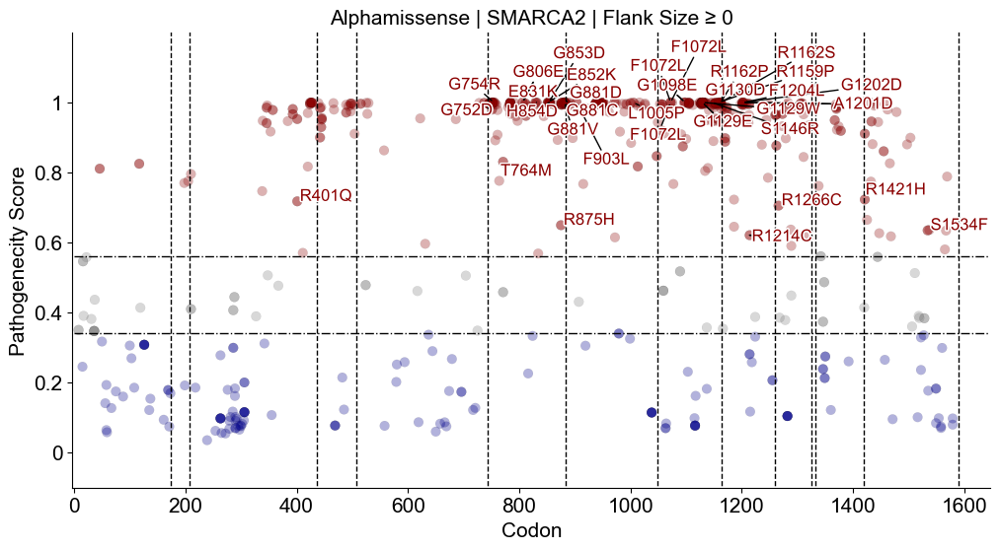

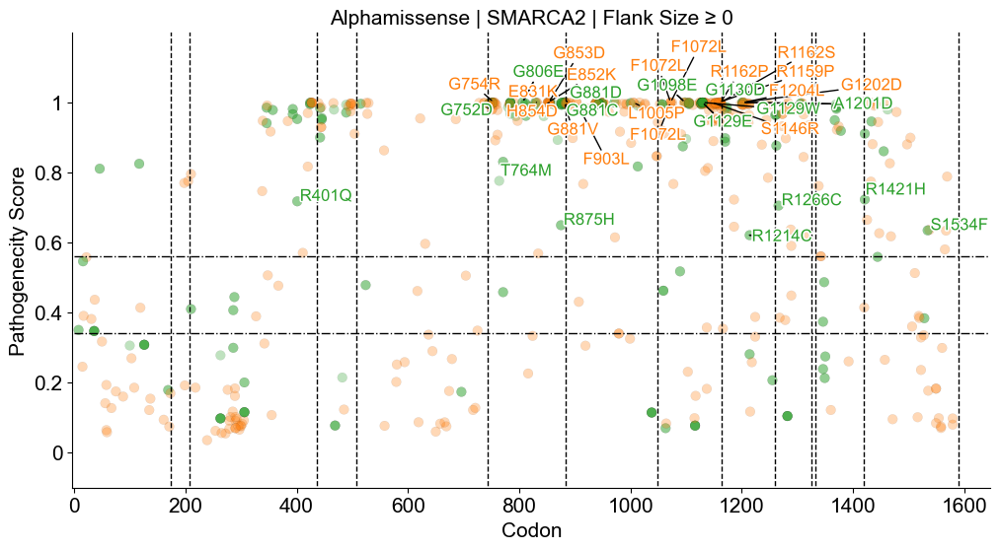

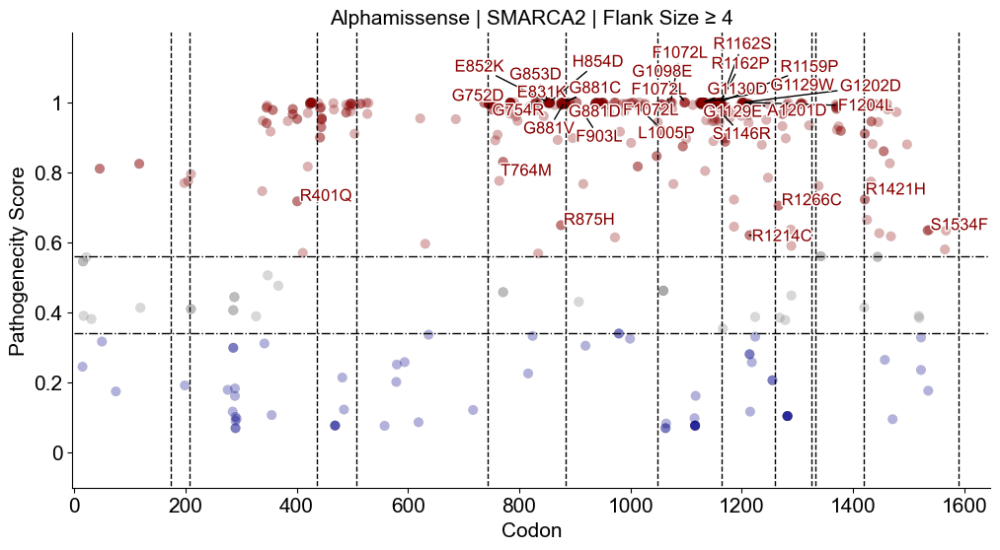

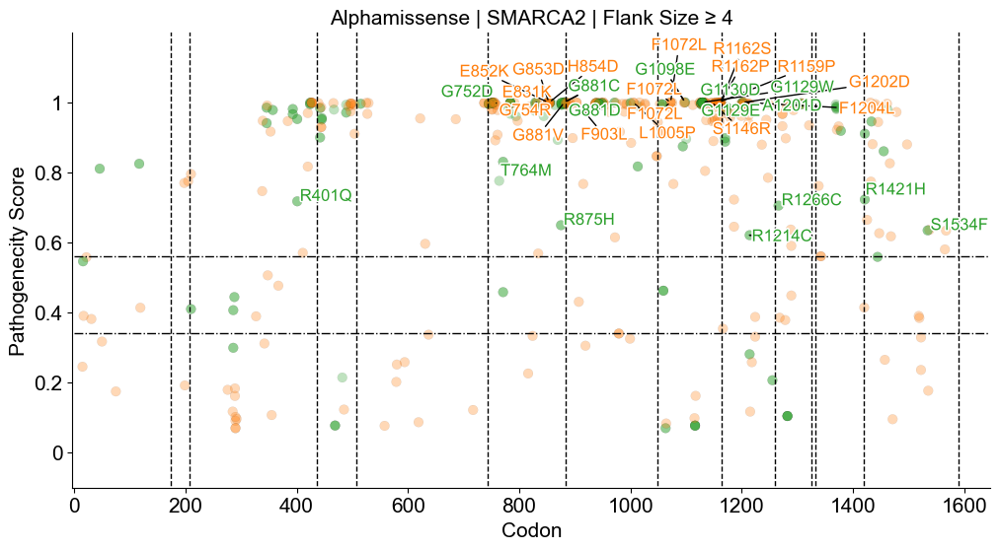

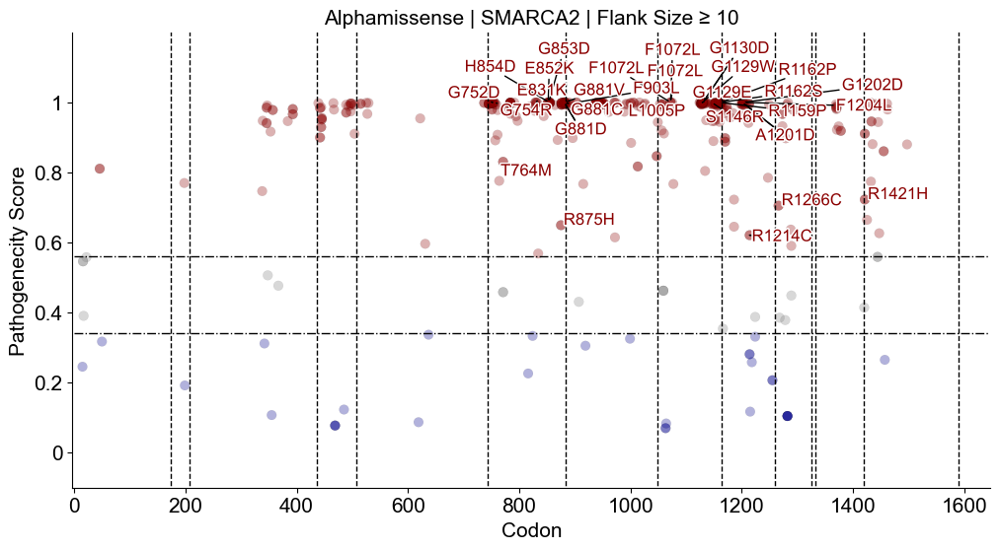

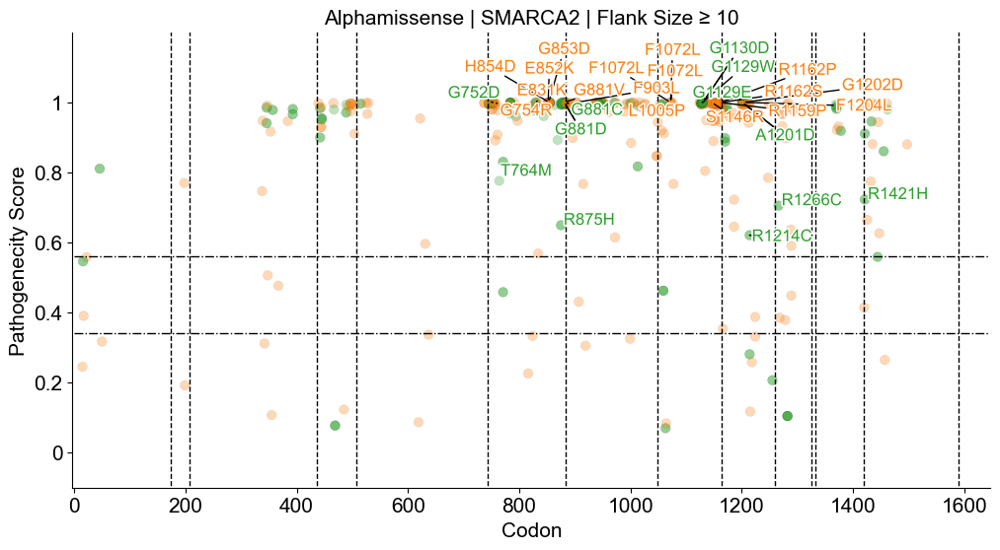

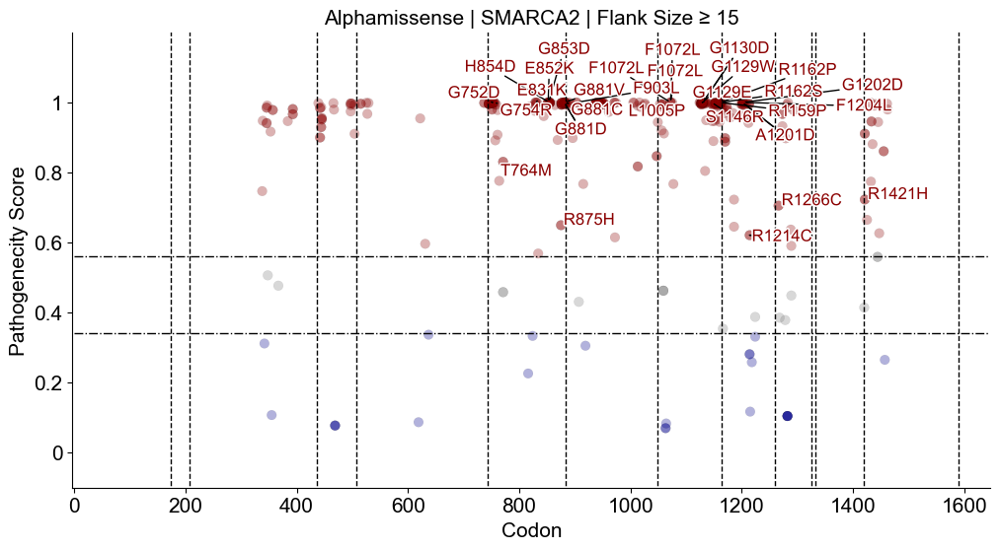

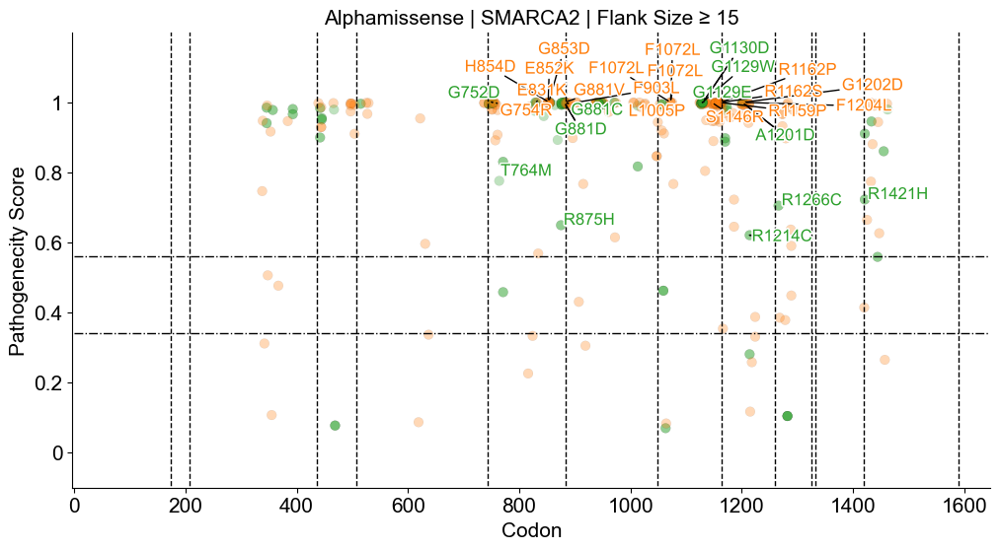

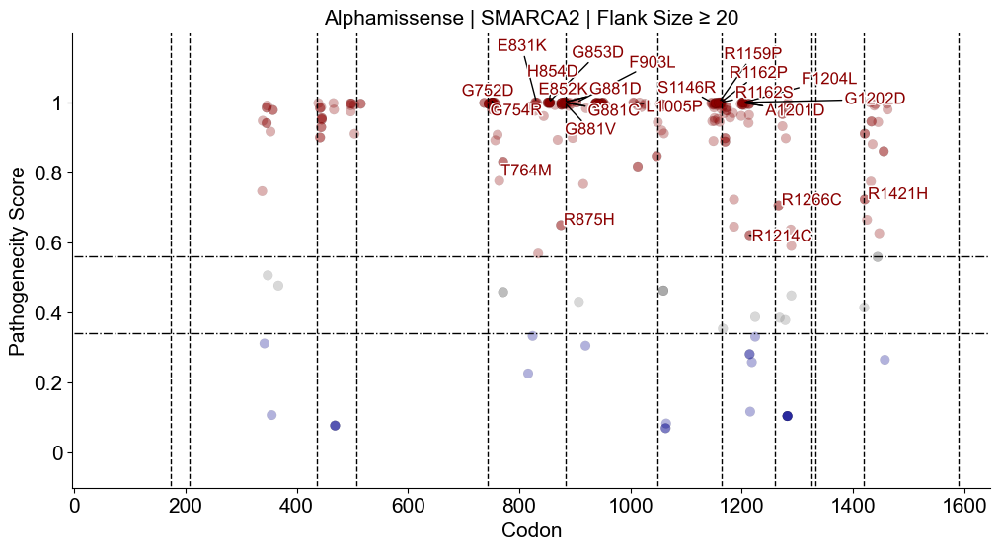

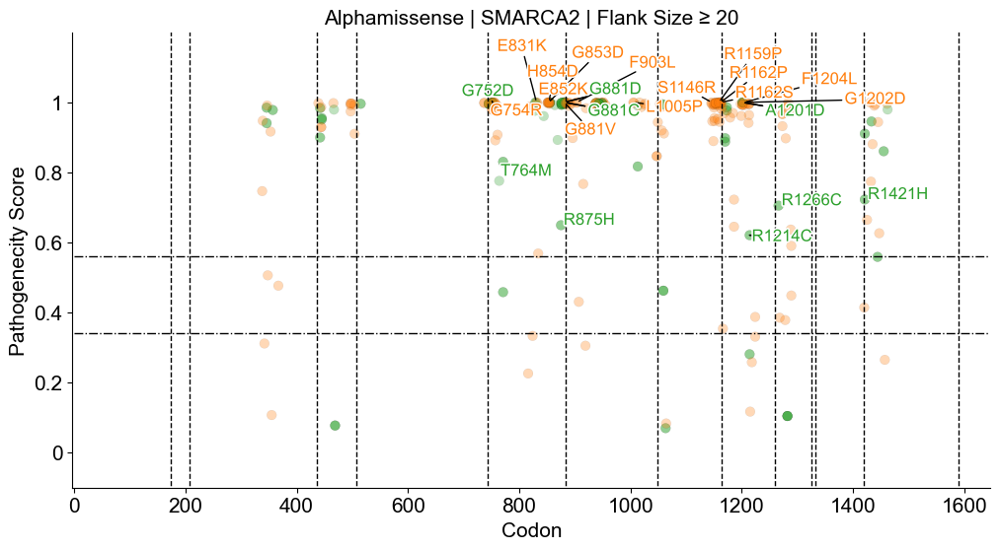

In [629]:
for fs in [0,4,10,15,20]:
    df_merged = df_h2m[df_h2m['flank_size'] >= fs].reset_index(drop=True)
    
    gene = 'SMARCA2'

    bbb1 = df_merged[(df_merged['am_pathogenicity_2'] >= .9997) & (df_merged['status'] == True)]
    bbb2 = df_merged[(df_merged['am_pathogenicity_2'] <= .045) & (df_merged['status'] == False)]
    bbb3 = df_merged[(df_merged['class'] == 1) & (df_merged['am_pathogenicity_2'] <= .8) & (df_merged['am_pathogenicity_2'] >= .6)]
    # top_2 = df_merged['HGVSp_h'].value_counts().index.to_list()[:2]
    # bbb3 = df_merged[df_merged['HGVSp_h'].isin(top_2)]
    bb2 = pd.concat((bbb1, bbb2,bbb3))

    t = list(bb2['HGVSp_h_2'])
    x = list(bb2['loc_h_2'])
    y = list(bb2['am_pathogenicity_2'])
    c = list(bb2['color_h2m_2'])


    fig, ax = plt.subplots(figsize=(12, 6))
    # 绘制散点图
    g = ax.scatter(data=df_merged, x='loc_h_2', y='am_pathogenicity_2',  c = 'color_h2m_2', alpha=.3, s=50, edgecolor='black', linewidths=.1)

    # 绘制参考线
    ax.plot([0, 1647], [0.56, 0.56], linewidth=1, linestyle='-.', color='black')
    ax.plot([0, 1647], [0.34, 0.34], linewidth=1, linestyle='-.', color='black')
    # ax.set_ylim(-6, 6)
    ax.set_xlim(-3, 1647)
    ax.set_ylim(-.1, 1.2)
    ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
    ax.set_xlabel("Codon", fontsize=15)
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs}", fontsize=15)
    boundaries = [173,207,436,508,744,883,1049,1164,1259,1326,1333,1419,1590]
    # https://www.frontiersin.org/articles/10.3389/fcell.2022.1071786/full
    for bound in boundaries:
        ax.plot([bound, bound], [-6, 6], linewidth=1, linestyle='dashed', color='black')

    texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
    ax.yaxis.set_ticks([0,.2,.4,.6,.8,1])
    ax.yaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
    adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='x', which='major', labelsize=15)
    plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/flank_size/smarca2_h_fs_{fs}_af_colored.pdf', bbox_inches='tight')
    plt.show()


    c = list(bb2['color_class'])
    fig, ax = plt.subplots(figsize=(12, 6))
    # 绘制散点图
    g = ax.scatter(data=df_merged, x='loc_h_2', y='am_pathogenicity_2',  c = 'color_class', alpha=.3, s=50, edgecolor='black', linewidths=.1)

    # 绘制参考线
    ax.plot([0, 1647], [0.56, 0.56], linewidth=1, linestyle='-.', color='black')
    ax.plot([0, 1647], [0.34, 0.34], linewidth=1, linestyle='-.', color='black')
    # ax.set_ylim(-6, 6)
    ax.set_xlim(-3, 1647)
    ax.set_ylim(-.1, 1.2)
    ax.set_ylabel(f"Pathogenecity Score", fontsize=15)
    ax.set_xlabel("Codon", fontsize=15)
    ax.set_title(f"Alphamissense | {gene} | Flank Size ≥ {fs}", fontsize=15)
    boundaries = [173,207,436,508,744,883,1049,1164,1259,1326,1333,1419,1590]
    for bound in boundaries:
        ax.plot([bound, bound], [-6, 6], linewidth=1, linestyle='dashed', color='black')

    texts = [ax.text(x[i], y[i], t[i], fontsize=12, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
    ax.yaxis.set_ticks([0,.2,.4,.6,.8,1])
    ax.yaxis.set_ticklabels([0,0.2,0.4,0.6,0.8,1], size=15, fontweight=100)
    adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='x', which='major', labelsize=15)
    plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/flank_size/smarca2_h_fs_{fs}_h2m_colored.pdf', bbox_inches='tight')
    plt.show()

In [225]:
df_h2m

,gene_name_h_1,HGVSp_h_1,class,status,gene_name_h_2,HGVSp_h_2,flank_size,am_pathogenicity_1,am_class_1,am_pathogenicity_2,am_class_2,color_class,color_score,loc_h_1,loc_h_2,color_h2m_1,color_h2m_2
0,SMARCA4,T910M,1,True,SMARCA2,T880M,44,0.9817,pathogenic,0.9940,pathogenic,tab:green,#8b0000,910,880,darkred,darkred
1,SMARCA4,R1243W,0,True,SMARCA2,R1213W,82,0.9966,pathogenic,0.9959,pathogenic,tab:orange,#8b0000,1243,1213,darkred,darkred
2,SMARCA4,R1192H,0,True,SMARCA2,R1162H,82,0.9965,pathogenic,0.9968,pathogenic,tab:orange,#8b0000,1192,1162,darkred,darkred
3,SMARCA4,R1192C,0,True,SMARCA2,R1162C,82,0.9984,pathogenic,0.9969,pathogenic,tab:orange,#8b0000,1192,1162,darkred,darkred
4,SMARCA4,E882K,0,True,SMARCA2,E852K,61,0.9993,pathogenic,0.9998,pathogenic,tab:orange,#8b0000,882,852,darkred,darkred
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
656,SMARCA4,R1445C,1,True,SMARCA2,R1370C,13,0.9759,pathogenic,0.9837,pathogenic,tab:green,#8b0000,1445,1370,darkred,darkred
657,SMARCA4,S813L,0,True,SMARCA2,S783L,11,0.9973,pathogenic,0.9950,pathogenic,tab:orange,#8b0000,813,783,darkred,darkred
658,SMARCA4,F1121L,0,True,SMARCA2,F1091L,0,0.9871,pathogenic,0.9088,pathogenic,tab:orange,#8b0000,1121,1091,darkred,darkred
659,SMARCA4,D1183Y,0,True,SMARCA2,D1153Y,81,0.9985,pathogenic,0.9975,pathogenic,tab:orange,#8b0000,1183,1153,darkred,darkred


In [226]:
df_h2m.to_csv('/Users/kexindong/Documents/GitHub/Output/paralog/smarca.csv',index=False)

## Generate base editing guides for paralogs  

In [2]:
df = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/paralog/h2h_result.csv')

In [4]:
import pegg
from pegg import base
import pandas as pd

In [5]:
path_h_ref, path_m_ref = '/Users/kexindong/Documents/GitHub/Database/RefGenome/ncbi-2023-09-12/GCF_000001405.25_GRCh37.p13_genomic.fna.gz', '/Users/kexindong/Documents/GitHub/Database/RefGenome/mouse-2023-09-13/GCF_000001635.27_GRCm39_genomic.fna.gz'
# remember to replace the paths with yours
chrom_dict, i = pegg.prime.genome_loader(path_h_ref)

In [26]:
df = df[df['status']==True].reset_index(drop=True)

In [27]:
df.columns

Index(['gene_name_h_1', 'gene_id_h_1', 'tx_id_h_1', 'chr_h_1', 'exon_num_h_1',
       'strand_h_1', 'match_1', 'start_h_1', 'end_h_1', 'ref_seq_h_1',
       'alt_seq_h_1', 'HGVSc_h_1', 'HGVSp_h_1', 'classification_h_1',
       'exon_h_1', 'type_h_1', 'status', 'class', 'statement',
       'flank_size_left', 'flank_size_right', 'gene_name_h_2', 'gene_id_h_2',
       'tx_id_h_2', 'chr_h_2', 'exon_num_h_2', 'strand_h_2', 'type_h_2',
       'classification_h_2', 'exon_h_2', 'start_h_2_ori', 'end_h_2_ori',
       'ref_seq_h_2_ori', 'alt_seq_h_2_ori', 'HGVSc_h_2_ori', 'HGVSp_h_2_ori',
       'start_h_2', 'end_h_2', 'ref_seq_h_2', 'alt_seq_h_2', 'HGVSc_h_2',
       'HGVSp_h_2', 'index'],
      dtype='object')

In [35]:
df_1 = df[
    ['gene_name_h_1', 'chr_h_1',  'start_h_1', 'end_h_1', 
     'type_h_1', 
     'ref_seq_h_1', 'alt_seq_h_1','index']
]
df_1.columns = ['Hugo_Symbol','Chromosome','Start_Position','End_Position', 'Variant_Type','Reference_Allele','Tumor_Seq_Allele2','ID']

df_2 = df[
    ['gene_name_h_2', 'chr_h_2',  'start_h_2', 'end_h_2', 
     'type_h_2', 
     'ref_seq_h_2', 'alt_seq_h_2','index']
]
df_2.columns = ['Hugo_Symbol','Chromosome','Start_Position','End_Position', 'Variant_Type','Reference_Allele','Tumor_Seq_Allele2','ID']

In [36]:
df_1['index'] = range(len(df_1))
df_2['index'] = range(len(df_2))

In [37]:
def be_amenable(df):
    set_be = {('C','T'),
              ('T','C'),
              ('A','G'),
              ('G','A'),}
    df = df[df['Variant_Type']=='SNP'].reset_index(drop=True)
    df = df[[(x,y) in set(set_be) for x,y in zip(df['Reference_Allele'],df['Tumor_Seq_Allele2'])]].reset_index(drop=True)
    return df

In [38]:
df_1 = be_amenable(df_1)
df_2 = be_amenable(df_2)

In [39]:
df_1 = df_1[df_1['index'].isin(set(df_2['index']))].reset_index(drop=True)

In [40]:
df_1['Chromosome'] = [str(x[3:]) for x in df_1['Chromosome']]
df_2['Chromosome'] = [str(x[3:]) for x in df_2['Chromosome']]
df_1['Start_Position'] = [int(x) for x in df_1['Start_Position']]
df_2['Start_Position'] = [int(x) for x in df_2['Start_Position']]
df_1['End_Position'] = [int(x) for x in df_1['End_Position']]
df_2['End_Position'] = [int(x) for x in df_2['End_Position']]

In [42]:
df_result_1 = base.run_base(df_1,'cBioPortal', chrom_dict, PAM='NGN',filtration='ABE+CBE', ideal_edit_window=[4, 8], auto_SNP_filter=True, proto_size=19,context_size=120, RE_sites=None, polyT_threshold=4, before_proto_context=5,sensor_length=40, sensor_orientation='reverse-complement', sensor=True)
df_result_2 = base.run_base(df_2,'cBioPortal', chrom_dict, PAM='NGN',filtration='ABE+CBE', ideal_edit_window=[4, 8], auto_SNP_filter=True, proto_size=19,context_size=120, RE_sites=None, polyT_threshold=4, before_proto_context=5,sensor_length=40, sensor_orientation='reverse-complement', sensor=True)

Error in mutant # 1935; Dropped from pegRNA generation
Variant Type = SNP| REF = G | ALT = A
GGGCGGATTTTGCAGATGCCAGACTTCTCTGCTATGGGCCTTATTTTCGCAATGTAGCCAAGCGGGTCTTGGAATTCAGCCCAGCTAGGCTCAAAAACCGGGCACTCCGGTGGCGGCAGGAACTCGTCACACCCCGGTTCCATGTCGGGCCTTAATGCTAAGCTGTAAAATAAGAATCACATTGTCTTTAATGACGCGCTGGTTCCTCCTACTAAAAGGCCTATGAAAATTTCATTTTCTT
GGGCGGATTTTGCAGATGCCAGACTTCTCTGCTATGGGCCTTATTTTCGCAATGTAGCCAAGCGGGTCTTGGAATTCAGCCCAGCTAGGCTCAAAAACCGGGCACTCCGGTGGCGGCAGGGACTCGTCACACCCCGGTTCCATGTCGGGCCTTAATGCTAAGCTGTAAAATAAGAATCACATTGTCTTTAATGACGCGCTGGTTCCTCCTACTAAAAGGCCTATGAAAATTTCATTTTCTT
Error in mutant # 2694; Dropped from pegRNA generation
Variant Type = SNP| REF = C | ALT = T
TGAAGGATTCCATGATAAAGACAGTTCAGGTTGGAGTTGCAGCAAAGATAAGGATGCATATAGCAGTTTTGGGTCTCGAGATTCTAGAGGAAAGCCTGGTTATTTCAGTGAACGTGGAAGTGGATCAAGGGGAAGGTAAATCTCAGCTTGTGTTTGTATACAGTAGAAATTTAGAAATTTTAATTTGGTAGGTTCTCATTCTTCATACTTTCAGTGGTCAAGCATATCTTTAACAGATTAC
TGAAGGATTCCATGATAAAGACAGTTCAGGTTGGAGTTGCAGCAAAGATAAGGATGCATATAGCAGTTTTGGGTCTCGAGATTCTAGA

In [46]:
len(df_result_1['mutation_idx'].unique())

4770

In [47]:
len(df_result_2['mutation_idx'].unique())

4793

In [44]:
df_result_1.to_csv('/Users/kexindong/Documents/GitHub/Output/paralog/h2h_be_1.csv', index = False)
df_result_2.to_csv('/Users/kexindong/Documents/GitHub/Output/paralog/h2h_be_2.csv', index = False)

In [632]:
len(df_result_2) + len(df_result_1)

52066

In [637]:
len(set(df_result_1['ID']).intersection(df_result_2['ID']))

4740

In [51]:
df_result_1.columns

Index(['mutation_idx', 'level_0', 'Hugo_Symbol', 'Chromosome',
       'Start_Position', 'End_Position', 'Variant_Type', 'Reference_Allele',
       'Tumor_Seq_Allele2', 'ID', 'seq_start', 'seq_end', 'wt_w_context',
       'alt_w_context', 'left_context', 'right_context', 'REF', 'ALT',
       'PAM_start', 'PAM_end', 'PAM', 'PAM_strand', 'Protospacer_30',
       'Protospacer', 'Protospacer_Location', 'Ideal_Edit_Window', 'Editor',
       'gRNA_id', 'OnTarget_Azimuth_Score', 'sensor_wt', 'sensor_alt',
       'sensor_orientation', 'sensor_error', 'contains_polyT_terminator'],
      dtype='object')

In [640]:
x = pd.merge(df_result_1.drop('level_0',axis=1), df_result_2.drop('level_0',axis=1), on = ['ID','Protospacer','Editor'],how = 'inner')

In [146]:
df.columns

Index(['gene_name_h_1', 'gene_id_h_1', 'tx_id_h_1', 'chr_h_1', 'exon_num_h_1',
       'strand_h_1', 'match_1', 'start_h_1', 'end_h_1', 'ref_seq_h_1',
       'alt_seq_h_1', 'HGVSc_h_1', 'HGVSp_h_1', 'classification_h_1',
       'exon_h_1', 'type_h_1', 'status', 'class', 'statement',
       'flank_size_left', 'flank_size_right', 'gene_name_h_2', 'gene_id_h_2',
       'tx_id_h_2', 'chr_h_2', 'exon_num_h_2', 'strand_h_2', 'type_h_2',
       'classification_h_2', 'exon_h_2', 'start_h_2_ori', 'end_h_2_ori',
       'ref_seq_h_2_ori', 'alt_seq_h_2_ori', 'HGVSc_h_2_ori', 'HGVSp_h_2_ori',
       'start_h_2', 'end_h_2', 'ref_seq_h_2', 'alt_seq_h_2', 'HGVSc_h_2',
       'HGVSp_h_2', 'index'],
      dtype='object')

In [642]:
k = df[['index','HGVSp_h_1','HGVSp_h_2']].drop_duplicates()
k.columns = ['ID','HGVSp_h_1','HGVSp_h_2']

In [643]:
x = pd.merge(x, k, on = 'ID',how = 'left')

In [644]:
import requests

def fetch_protein_id(species, identifier, is_symbol=True, grch37=False):
    base_url = "https://grch37.rest.ensembl.org" if grch37 else "https://rest.ensembl.org"
    endpoint = "/lookup/symbol" if is_symbol else "/lookup/id"
    url = f"{base_url}{endpoint}/{species}/{identifier}?expand=1;content-type=application/json"
    headers = {"Content-Type": "application/json"}
    
    response = requests.get(url, headers=headers)
    if response.status_code == 200:
        data = response.json()
        if "Transcript" in data:
            for transcript in data["Transcript"]:
                if "Translation" in transcript:
                    return transcript["Translation"]["id"]
        return None
    else:
        print(f"Error: {response.status_code}")
        return None

# Example usage for GRCh37
protein_id = fetch_protein_id("homo_sapiens", "BRAF", is_symbol=True, grch37=True)
print("Protein Ensembl ID:", protein_id)


Protein Ensembl ID: ENSP00000419060


In [650]:
y = pd.DataFrame({'Hugo_Symbol_x':list(x_l['Hugo_Symbol_x'].unique())})
y['p_id_1']= [fetch_protein_id("homo_sapiens", x, is_symbol=True, grch37=True) for x in y['Hugo_Symbol_x']]

In [651]:
yy = pd.DataFrame({'Hugo_Symbol_y':list(x_l['Hugo_Symbol_y'].unique())})
yy['p_id_2']= [fetch_protein_id("homo_sapiens", x, is_symbol=True, grch37=True) for x in yy['Hugo_Symbol_y']]

In [652]:
x_l = x[['Hugo_Symbol_x','HGVSp_h_1','Hugo_Symbol_y','HGVSp_h_2','Protospacer']].drop_duplicates()
x_l = pd.merge(pd.merge(x_l, y, how = 'left'), yy, how = 'left')
x_l = x_l[['Hugo_Symbol_x','p_id_1','HGVSp_h_1','Hugo_Symbol_y','p_id_2','HGVSp_h_2']]
x_l.columns = ['Hugo_Symbol_1','p_id_1','HGVSp_h_1','Hugo_Symbol_2','p_id_2','HGVSp_h_2']

In [653]:
# x_ll = x_l[['*' not in x for x in x_l['HGVSp_h_1']]].reset_index(drop=True)
x_ll = x_l[['delins' not in x for x in x_l['HGVSp_h_1']]].reset_index(drop=True)

In [654]:
# 示例基因符号列表
dict_gene = dict()
gene_symbols = list(x_ll['Hugo_Symbol_1'].unique()) + list(x_ll['Hugo_Symbol_2'].unique())

uniprot_ids = get_uniprot_ids_from_gene_symbols(gene_symbols)
for gene_symbol, uniprot_id in uniprot_ids.items():
    dict_gene.update({uniprot_id:gene_symbol})

In [655]:
df_am.columns

Index(['uniprot_id', 'protein_variant', 'am_pathogenicity', 'am_class'], dtype='object')

In [656]:
df_am = df_am[df_am['uniprot_id'].isin(dict_gene.keys())].reset_index(drop=True)

In [657]:
df_am['uniprot_id'] = [dict_gene[x] for x in df_am['uniprot_id']]

In [658]:
df_am_1 = df_am.copy()
df_am_1.columns=['Hugo_Symbol_1','HGVSp_h_1','am_pathogenicity_1','am_class_1']
df_am.columns =['Hugo_Symbol_2','HGVSp_h_2','am_pathogenicity_2','am_class_2']

In [659]:
df_plot = pd.merge(pd.merge(x_ll, df_am_1, how = 'inner'),df_am, how = 'inner').drop_duplicates().reset_index(drop=True)

In [660]:
df_h2m = df_plot
# df_h2m['color_class'] = [color_dict_h2m[x] for x in df_h2m['class']]
df_h2m['color_score'] = df_h2m.apply(lambda row: combined_color_dict[(row['am_class_1'], row['am_class_2'])], axis=1)

In [661]:
bb2

,gene_name_h_1,HGVSp_h_1,class,status,gene_name_h_2,HGVSp_h_2,flank_size,am_pathogenicity_1,am_class_1,am_pathogenicity_2,am_class_2,color_class,color_score,loc_h_1,loc_h_2,color_h2m_1,color_h2m_2
4,SMARCA4,E882K,0,True,SMARCA2,E852K,61,0.9993,pathogenic,0.9998,pathogenic,tab:orange,#8b0000,882,852,darkred,darkred
18,SMARCA4,E861K,0,True,SMARCA2,E831K,61,0.9997,pathogenic,0.9997,pathogenic,tab:orange,#8b0000,861,831,darkred,darkred
65,SMARCA4,G1232D,0,True,SMARCA2,G1202D,82,0.9990,pathogenic,0.9997,pathogenic,tab:orange,#8b0000,1232,1202,darkred,darkred
83,SMARCA4,G911D,1,True,SMARCA2,G881D,44,0.9996,pathogenic,0.9999,pathogenic,tab:green,#8b0000,911,881,darkred,darkred
84,SMARCA4,G911D,1,True,SMARCA2,G881D,44,0.9996,pathogenic,0.9999,pathogenic,tab:green,#8b0000,911,881,darkred,darkred
129,SMARCA4,G782D,1,True,SMARCA2,G752D,35,0.9993,pathogenic,0.9997,pathogenic,tab:green,#8b0000,782,752,darkred,darkred
130,SMARCA4,G782D,1,True,SMARCA2,G752D,35,0.9993,pathogenic,0.9997,pathogenic,tab:green,#8b0000,782,752,darkred,darkred
147,SMARCA4,F933L,0,True,SMARCA2,F903L,44,0.9996,pathogenic,0.9998,pathogenic,tab:orange,#8b0000,933,903,darkred,darkred
156,SMARCA4,S1176R,0,True,SMARCA2,S1146R,82,0.9997,pathogenic,0.9997,pathogenic,tab:orange,#8b0000,1176,1146,darkred,darkred
169,SMARCA4,G911V,0,True,SMARCA2,G881V,44,0.9993,pathogenic,0.9997,pathogenic,tab:orange,#8b0000,911,881,darkred,darkred


In [665]:
corr, p_value = scipy.stats.spearmanr(df_h2m['am_pathogenicity_1'], df_h2m['am_pathogenicity_2'])

print("Spearman Correlation Coefficient: {:.4f}".format(corr))
print("P-value: {:.4f}".format(p_value))

Spearman Correlation Coefficient: 0.8484
P-value: 0.0000


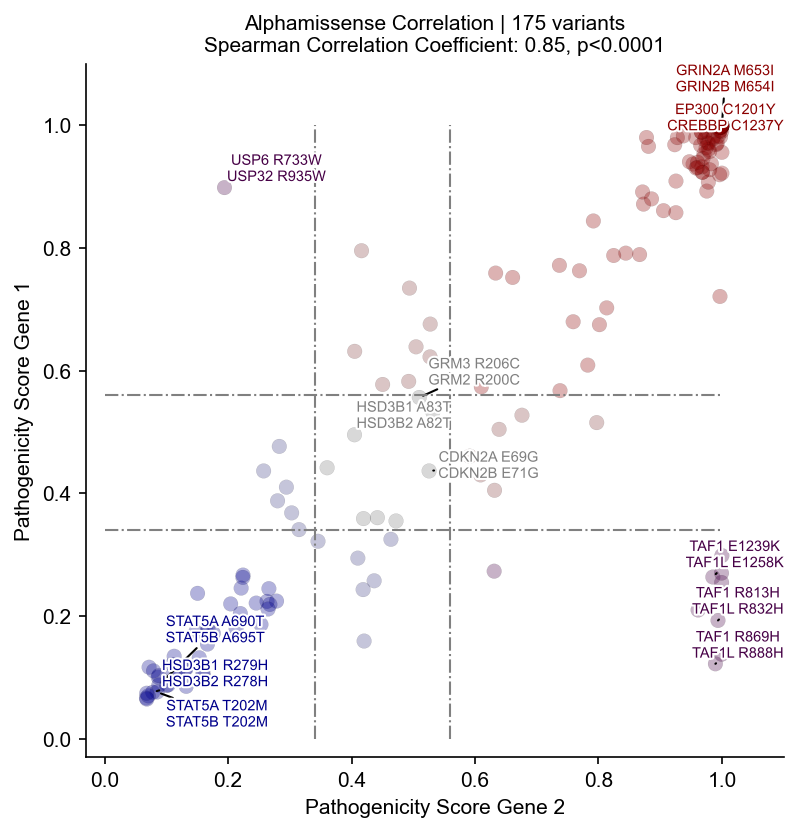

In [666]:
bbb1 = df_h2m[(df_h2m['am_pathogenicity_1'] >= .9997) & (df_h2m['am_pathogenicity_2'] >= .9997)].iloc[:2,:]
bbb2 = df_h2m[(df_h2m['am_pathogenicity_1'] >= .4) & (df_h2m['am_pathogenicity_1'] <= .6) & (df_h2m['am_pathogenicity_2'] <= .6) & (df_h2m['am_pathogenicity_2'] >= .4)].iloc[:3,:]
bbb3 = df_h2m[(df_h2m['am_pathogenicity_1'] <= .097) & (df_h2m['am_pathogenicity_2'] <= .097) ].iloc[:3,:]
bbb4 = df_h2m[(df_h2m['am_pathogenicity_1'] <= .3) & (df_h2m['am_pathogenicity_2'] >= .8)].iloc[:3,:]
bbb5 = df_h2m[(df_h2m['am_pathogenicity_1'] >= .8) & (df_h2m['am_pathogenicity_2'] <= .3)].iloc[:3,:]

bb2 = pd.concat((bbb1, bbb2,bbb3, bbb4, bbb5))

t = [f'{p} {x}\n{q} {y}' for p,q,x,y in zip(bb2['Hugo_Symbol_1'], bb2['Hugo_Symbol_2'],bb2['HGVSp_h_1'], bb2['HGVSp_h_2'])]
x = list(bb2['am_pathogenicity_1'])
y = list(bb2['am_pathogenicity_2'])



fig, ax = plt.subplots(figsize=(6, 6), dpi=150)
ax.plot([0, 1], [0.56, 0.56], linewidth=1, linestyle='-.', color='grey')
ax.plot([0, 1], [0.34, 0.34], linewidth=1, linestyle='-.', color='grey')

ax.plot( [0.56, 0.56], [0, 1],linewidth=1, linestyle='-.', color='grey')
ax.plot([0.34, 0.34], [0, 1], linewidth=1, linestyle='-.', color='grey')

c = list(bb2['color_score'])
ax.scatter(data=df_h2m, x='am_pathogenicity_1', y='am_pathogenicity_2', c = 'color_score', alpha=.3, s=50, edgecolor='black', linewidths=.1)

ax.set_xlim(-.03, 1.1)
ax.set_ylim(-.03, 1.1)
ax.set_ylabel(f"Pathogenicity Score Gene 1", fontsize=10)
ax.set_xlabel(f"Pathogenicity Score Gene 2", fontsize=10)
ax.set_title(f"Alphamissense Correlation Between Paralogous Mutations", fontsize=10)
ax.set_title(f"Alphamissense Correlation | {len(df_h2m)} variants\nSpearman Correlation Coefficient: {corr:.2f}, p<0.0001", fontsize=10)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(axis='both', which='major', labelsize=10)
texts = [ax.text(x[i], y[i], t[i], fontsize=7, color=c[i], path_effects=[PathEffects.withStroke(linewidth=2, foreground="w")]) for i in range(len(x))]
adjust_text(texts,only_move={'texts':'xy'}, ax=ax, arrowprops=dict(arrowstyle="-", linewidth=1, alpha=1, color='black'))
plt.savefig(f'/Users/kexindong/Documents/GitHub/Output/h2m_database/figures/flank_size/double_hit.pdf', bbox_inches='tight')
plt.show()

In [ ]:
for _,x in x_ll.iterrows():
    name = x['p_id_1']
    o = x['HGVSp_h_1']
    p = o[0]
    loc = o[1:-1]
    q = o[-1]
    if q=='*':
        q = '.'
    print(f'{name}\t{loc}\t{p}\t{q}')

In [133]:
x_l.to_csv('/Users/kexindong/Documents/GitHub/Output/paralog/h2h_be_double_hit.csv',index=False)

In [647]:
x_l = pd.read_csv('/Users/kexindong/Documents/GitHub/Output/paralog/h2h_be_double_hit.csv')

In [648]:
x_l

,Hugo_Symbol_1,p_id_1,HGVSp_h_1,Hugo_Symbol_2,p_id_2,HGVSp_h_2
0,CDKN2A,ENSP00000307101,W110*,CDKN2B,ENSP00000276925,W112*
1,PTPN11,ENSP00000376376,E69K,PTPN6,ENSP00000443393,E67K
2,SMARCA4,ENSP00000343896,R1192H,SMARCA2,ENSP00000392081,R1162H
3,SMARCA4,ENSP00000343896,R1192H,SMARCA2,ENSP00000392081,R1162H
4,SMARCA4,ENSP00000343896,R1192H,SMARCA2,ENSP00000392081,R1162H
...,...,...,...,...,...,...
749,GRIN2A,ENSP00000379818,I814T,GRIN2B,ENSP00000477455,I815T
750,GRIN2A,ENSP00000379818,I814T,GRIN2B,ENSP00000477455,I815T
751,BIRC3,ENSP00000263464,A279V,BIRC2,ENSP00000432410,A293V
752,BIRC3,ENSP00000263464,R52H,BIRC2,ENSP00000432410,R69H


## 32 gene pairs, 216 mutations, 754 base editing guides are founded. 

In [ ]:
df_result_2.columns

Index(['mutation_idx', 'Hugo_Symbol', 'Chromosome', 'Start_Position',
       'End_Position', 'Variant_Type', 'Reference_Allele', 'Tumor_Seq_Allele2',
       'seq_start', 'seq_end', 'wt_w_context', 'alt_w_context', 'left_context',
       'right_context', 'REF', 'ALT', 'PAM_start', 'PAM_end', 'PAM',
       'PAM_strand', 'Protospacer_30', 'Protospacer', 'Protospacer_Location',
       'Ideal_Edit_Window', 'Editor', 'gRNA_id', 'OnTarget_Azimuth_Score',
       'sensor_wt', 'sensor_alt', 'sensor_orientation', 'sensor_error',
       'contains_polyT_terminator'],
      dtype='object')

In [ ]:
df['HGVSp_x'] = ['R172G','R172G', 'R1192C','G1194R']
df['HGVSp_y'] = ['R132G','R132G','R1162C','G1164R']
df.to_csv('/Users/gorkordkx/Documents/Output/h2m/paralogues/para_begg_design_overlapped.csv', index = False)

In [ ]:
df

,Hugo_Symbol_x,Chromosome_x,Start_Position_x,End_Position_x,Variant_Type_x,Reference_Allele_x,Tumor_Seq_Allele2_x,Protospacer,Editor,Hugo_Symbol_y,Chromosome_y,Start_Position_y,End_Position_y,Variant_Type_y,Reference_Allele_y,Tumor_Seq_Allele2_y,HGVSp_x,HGVSp_y
0,IDH2,15,90631839,90631839,SNP,T,C,GAGGCACGCCCATGGCGACC,ABE,IDH2,15,90631839,90631839,SNP,T,C,R172G,R132G
1,IDH2,15,90631839,90631839,SNP,T,C,GCCATTGGCAGGCACGCCCA,ABE,IDH2,15,90631839,90631839,SNP,T,C,R172G,R132G
2,SMARCA4,19,11143993,11143993,SNP,C,T,GCGCATCGGGCAGCAGAACG,CBE,SMARCA2,9,2115849,2115849,SNP,C,T,R1192C,R1162C
3,SMARCA4,19,11143999,11143999,SNP,G,A,GCTCGTTCTGCTGCCCGATG,CBE,SMARCA2,9,2115855,2115855,SNP,G,A,G1194R,G1164R
